In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import maxentep
import numpy as np
import scipy.stats as ss
plt.style.use('seaborn-darkgrid')
import warnings
import seaborn as sns
warnings.filterwarnings('ignore')
import tensorflow as tf
import networkx as nx
from keras.callbacks import ReduceLROnPlateau

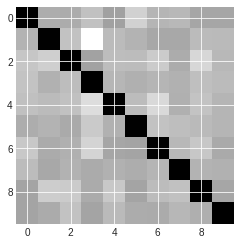

In [2]:
# Make up some population area and mobility network
np.random.seed(0)
M = 10
patches=[f'patch {i}' for i in range(M)]
population = np.round(np.random.normal(loc=500000, scale=300000, size=(M,)))
area = np.maximum(300, np.round(np.random.normal(loc=2000, scale=1000, size=(M,)), 0))
# defining a fully connected mobility matrix
dense_mobility_matrix = np.round(np.abs(np.random.normal(loc=100, scale=50, size=(M,M))))
# setting diagonal values to be dominant
dense_mobility_matrix_diag = np.round(np.abs(np.random.normal(loc=100000, scale=3000, size=(M))))
np.fill_diagonal(dense_mobility_matrix, dense_mobility_matrix_diag)
dense_mobility_matrix_norm = dense_mobility_matrix / np.sum(dense_mobility_matrix, axis=1, keepdims=True)
plt.imshow(np.log(dense_mobility_matrix))
compartments = ['E', 'A', 'I', 'R']
full_compartments = ['S'] + compartments
true_node = 1
infections_compartments = [1,2]
C = len(compartments)

In [3]:
def gen_ref_traj(graph, beta_A = 0.025, beta_I=0.05, alpha =1/3, gamma=1/2, mu=1/7, M=10, C=4, timesteps=100,
                 mobility_matrix=dense_mobility_matrix, population=None, area= None, true_node=None):
    # sparsify mobility matrix for sparse graphs
    sparsed_mobility_matrix = maxentep.sparse_graph_mobility(graph, mobility_matrix)
    tmat = maxentep.TransitionMatrix(compartments, [1,2])
    tmat.add_transition('E', 'A', 1/alpha, 0) # calling this alpha
    tmat.add_transition('E', 'I', 1/gamma, 0) # calling this gamma
    tmat.add_transition('A', 'R',1/mu, 0) # mu
    tmat.add_transition('I', 'R', 1/mu, 0) # mu
    infect_fxn = maxentep.contact_infection_func(infections_compartments, area=area)
    model = maxentep.MetaModel(infect_fxn, timesteps, populations=np.array(population))
    # starting fractions probabilities
    start = np.zeros((M,C)) #anywhere
    # Assume starting from Node true_node
    initial_exposed = 1/population[true_node]
    start[true_node,0] = initial_exposed
    sparsed_mobility_matrix_norm = sparsed_mobility_matrix / np.sum(sparsed_mobility_matrix, axis=1, keepdims=True)
    ref_traj = model(sparsed_mobility_matrix_norm, tmat.value, start, np.array([beta_A,beta_I]))[0]
    ref_traj = ref_traj[tf.newaxis, ...]
    return ref_traj



If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



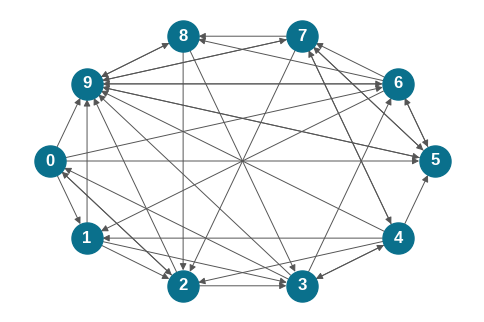

In [4]:
M=10
p = 0.4
graph = maxentep.gen_random_graph(M,p)
maxentep.draw_graph(graph, dpi =100)
maxentep.graph_degree(graph)
ref_traj = gen_ref_traj(graph, timesteps=250, population=population,
                          area=area, true_node=true_node)
# maxentep.patch_quantile(ref_traj, patch_names = patches, figsize=(10, 6), alpha=0.5, names=['S','E','A','I','R'])

In [19]:
def gen_restraints(ref_traj, prior=None, start=None, end=None):
    if prior:
        prior = maxentep.Laplace(1)
    else:
        prior = maxentep.EmptyPrior()
    restrained_patches = np.random.choice(M, number_of_restrained_patches, replace=False)
    # Visualizing restraints
    restrained_patch = restrained_patches[0]
    restraints, plot_fxns_list = maxentep.compartment_restrainer(restrained_patches, restrained_compartments,
                                                                 ref_traj, prior, npoints = npoints, noise=0.05, start_time=start, end_time=end)
    plt.figure()
    plt.plot(ref_traj[0,:,restrained_patch,:], linestyle='--')
    for i,pf in enumerate(plot_fxns_list[0]):
        pf(plt.gca(), 0)
    plt.title('Observables in the ref traj')
    plt.tight_layout()
    return restraints, plot_fxns_list, restrained_patches

In [7]:
def compare_patches(ref_traj, trajs,weights_dict, method, restrained_patches,plot_fxns_list,
                    *args, figsize=(10, 6), patch_names=None, ** kw_args):
    '''does traj_quantile for trajectories of shape [ntrajs, time, patches, compartments]
    '''
    weights = weights_dict[method]
    NP = trajs.shape[2]
    nrow = int(np.floor(np.sqrt(NP)))
    ncol = int(np.ceil(NP / nrow))
    print(f'Plotting {NP} patches in a {nrow} x {ncol} grid')
    fig, ax = plt.subplots(nrow, ncol, sharex=True,
                           sharey=True, figsize=figsize)
    if method =='unbiased':
        fig.suptitle('{}'.format(method), fontsize=30,y=1.03)
    else:
        fig.suptitle('{} (Patches restrained: {}, Points restrained in each patch: {}, Compartments restrained: {})'
                     .format(method,len(restrained_patches),npoints*number_of_restrained_compartments,restrained_compartments_names)
                     , fontsize=26,y=1.03)
    for i in range(nrow):
        for j in range(ncol):
            if i * ncol + j == NP:
                break
#             traj_quantile(trajs[:,:,i * ncol + j,:], weights=weights, names=full_compartments, ax=axs[0,i])
            ax[i,j].plot(ref_traj[0,:,i * ncol + j,:], linestyle='--')
            if method == 'unbiased':
                maxentep.traj_quantile(trajs[:, :, i * ncol + j, :], *args, ax=ax[i, j],
                              add_legend=i == 0 and j == ncol - 1, **kw_args)
            elif method == 'biased':
                maxentep.traj_quantile(trajs[:, :, i * ncol + j, :],weights= weights, *args, ax=ax[i, j],
                              add_legend=i == 0 and j == ncol - 1, **kw_args)
            elif method == 'hyper-biased':
                maxentep.traj_quantile(hme_model.trajs[:, :, i * ncol + j, :],weights= weights, *args, ax=ax[i, j],
                              add_legend=i == 0 and j == ncol - 1, **kw_args)
            elif method == 'regression':
                ax[i,j].plot(rtraj[p,:,i * ncol + j,:])
#             ax[i, j].set_ylim(0, 1)
            if i * ncol + j in restrained_patches and method != 'unbiased':
                for _,pf in enumerate(plot_fxns_list[restrained_patches.tolist().index(i * ncol + j)]):
                    pf(ax[i,j],0, color='C3')
                ax[i,j].spines['bottom'].set_color('y')
                ax[i,j].spines['top'].set_color('y') 
                ax[i,j].spines['right'].set_color('y')
                ax[i,j].spines['left'].set_color('y')
                ax[i,j].spines['left'].set_linewidth(2)
                ax[i,j].spines['top'].set_linewidth(2)
                ax[i,j].spines['right'].set_linewidth(2)
                ax[i,j].spines['bottom'].set_linewidth(2)
#             plt.tight_layout()
            if patch_names is None:
                ax[i, j].text(trajs.shape[1] // 2, 0.8,
                              f'Patch {i * ncol + j}')
            else:
                patch_names = patch_names
                ax[i, j].set_title(patch_names[i * ncol + j])

            if j == 0 and i == nrow // 2:
                ax[i, j].set_ylabel('Fraction')
            if i == nrow - 1 and j == ncol // 2:
                ax[i, j].set_xlabel('Time')
            if j >= NP % ncol:
                ax[nrow-1, j].set_visible(False)
    plt.tight_layout()

def compare_to_ref(ref_traj, trajs, weights, *args, method = None, figsize=(18, 18), patch_names=None, ** kw_args):
    '''does traj_quantile for trajectories of shape [ntrajs, time, patches, compartments] and compares to a ref_traj
    '''
    #     weights = weights_dict[method]
    NP = trajs.shape[2]
    nrow = int(np.floor(np.sqrt(NP)))
    ncol = int(np.ceil(NP / nrow))
    print(f'Plotting {NP} patches in a {nrow} x {ncol} grid')
    fig, ax = plt.subplots(nrow, ncol, sharex=True,
                           sharey=True, figsize=figsize)
    if method =='unbiased':
        fig.suptitle('{}'.format(method), fontsize=30,y=1.06)
    else:
        fig.suptitle('{} (Patches restrained: {}, Points restrained in each patch: {}, Compartments restrained: {})'
                     .format(method,len(restrained_patches),npoints*number_of_restrained_compartments,restrained_compartments_names)
                     , fontsize=26,y=1.002)
    for i in range(nrow):
        for j in range(ncol):
            if i * ncol + j == NP:
                break
    #             traj_quantile(trajs[:,:,i * ncol + j,:], weights=weights, names=full_compartments, ax=axs[0,i])
            ax[i,j].plot(ref_traj[0,:,i * ncol + j,:], linestyle='--')
            if method == 'unbiased':
                maxentep.traj_quantile(trajs[:, :, i * ncol + j, :], *args, ax=ax[i, j],
                              add_legend=i == 0 and j == ncol - 1, **kw_args)
            elif method == 'biased':
                maxentep.traj_quantile(trajs[:, :, i * ncol + j, :],weights= weights, *args, ax=ax[i, j],
                              add_legend=i == 0 and j == ncol - 1, **kw_args)
            elif method == 'hyper-biased':
                maxentep.traj_quantile(hme_model.trajs[:, :, i * ncol + j, :],weights= weights, *args, ax=ax[i, j],
                              add_legend=i == 0 and j == ncol - 1, **kw_args)
            elif method == 'regression':
                ax[i,j].plot(rtraj[p,:,i * ncol + j,:])
            if patch_names is None:
                ax[i, j].text(trajs.shape[1] // 2, 0.8,
                              f'Patch {i * ncol + j}')
            else:
                patch_names = patch_names
                ax[i, j].set_title(patch_names[i * ncol + j])

            if j == 0 and i == nrow // 2:
                ax[i, j].set_ylabel('Fraction')
            if i == nrow - 1 and j == ncol // 2:
                ax[i, j].set_xlabel('Time')
            if j >= NP % ncol:
                ax[nrow-1, j].set_visible(False)
    plt.tight_layout()

In [8]:
def gen_samples(graph, mobility_matrix=dense_mobility_matrix, timesteps =250, area = area, populations = population):
    # sparsify mobility matrix for sparse graphs
    sparsed_mobility_matrix = maxentep.sparse_graph_mobility(graph, mobility_matrix)
    tmat = maxentep.TransitionMatrix(compartments, infections_compartments)
    tmat.add_transition('E', 'A', 2, 2) # call this alpha
    tmat.add_transition('E', 'I', 2, 2) # call this gamma
    tmat.add_transition('A', 'R',6, 2) # mu
    tmat.add_transition('I', 'R', 6, 2)
    hyper_pram = maxentep.ParameterHypers()
    hyper_pram.beta_low = [0.005]*2
    hyper_pram.beta_high = [0.08]*2
    hyper_pram.beta_var = [0.1]*2
    hyper_pram.start_high = 2e-5
    hyper_pram.start_var = 0.5
    hyper_pram.R_var = 100
    hyper_pram.beta_start = 0.005
    hyper_pram.start_mean = 8e-6
    hyper_pram.start_scale = 1e-7
    start_logits = np.zeros((M))
    param_model = maxentep.MetaParameterJoint(start_logits, sparsed_mobility_matrix , tmat, name='unbiased_model',
                                              hypers = hyper_pram, n_infectious_compartments=2)
    import tqdm
    N = 512
    batches = 16
    total_batches = N * batches
    outs = []
    infect = maxentep.contact_infection_func(infections_compartments, area = area)
    model = maxentep.MetaModel(infect, timesteps, populations = population)
    prior_prams = []
    for b in tqdm.tqdm(range(batches)):
        ps = param_model.sample(N)
        prior_prams.append(ps)
        outs.append(model(*ps))
    trajs = np.concatenate(outs, axis=0)
    return trajs


100%|██████████| 16/16 [00:29<00:00,  1.84s/it]


Plotting 10 patches in a 3 x 4 grid


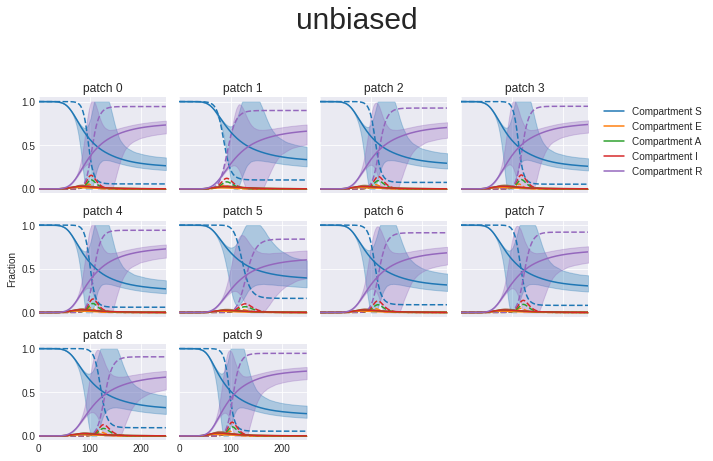

In [9]:
trajs = gen_samples(graph, timesteps =250, area = area, populations = population)
compare_to_ref(ref_traj, trajs, weights=None, method='unbiased', patch_names = patches,
               figsize=(10, 6), alpha=0.3, names=full_compartments)

Restraints are set in this time range: [50, 140]
94 0.060526345 0.06414982108450948
129 0.025288874 0.027670269230635904
115 0.102938935 0.10661500713745017
122 0.05409801 0.06027690450306112
101 0.12538746 0.1351934024754253
52 3.627295e-05 3.738127831120565e-05
101 0.2300982 0.2420768278389585
129 0.88566124 0.884189451287708
73 0.0019299182 0.001936252302774779
115 0.68437445 0.6934692995339979
101 0.026568275 0.023304788758502726
108 0.07782537 0.07119601310549376
129 0.0881324 0.08998385120077407
94 0.007362717 0.00725295747075258
80 0.00046842598 0.0004745998822374222
94 0.008130729 0.008428015458618206
80 0.0004984267 0.00047265201505788815
115 0.28731808 0.29710980210286014
122 0.53963 0.5179527981367968
59 6.629977e-06 6.40139221531094e-06
115 0.13817373 0.13054389095856492
66 0.00016673133 0.0001671662112555147
59 4.760682e-05 4.584640774596699e-05
136 0.02879754 0.031019292103052282
108 0.11409525 0.10671980677655979
94 0.027473612 0.027840454352355794
136 0.8602635 0.844383

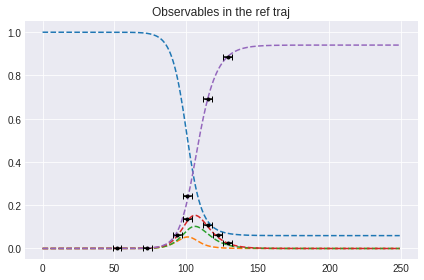

In [10]:
npoints = 5
number_of_restrained_patches = 5
restrained_compartments = [3,4] #(infected patch and recovered)
number_of_restrained_compartments = len(restrained_compartments) 
restrained_compartments_names = [full_compartments[m] for m in restrained_compartments]
restrained_compartments_names = " ".join(restrained_compartments_names)
restraints, plot_fxns_list, restrained_patches = gen_restraints(ref_traj, prior=False, start=50, end=140)

<AxesSubplot:ylabel='Count'>

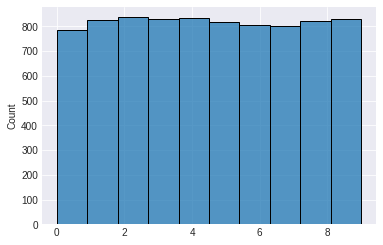

In [11]:
prior_exposed_patch = maxentep.exposed_finder(trajs)
sns.histplot(x=prior_exposed_patch, label='Prior',
            color='C0',bins=M)

In [12]:
def maxent_fit(trajs, restraints):
    me_model = maxentep.MaxentModel(restraints)
    from tensorflow import keras
    optimizer=keras.optimizers.Adam(lr=1e-1) 
    me_model.compile(optimizer=optimizer, loss='mean_squared_error')
    reduce_lr = ReduceLROnPlateau(monitor='loss', factor=0.9,
                              patience=10, min_lr=0)
    me_history = me_model.fit(trajs, batch_size=trajs.shape[0], epochs=1000, callbacks=[reduce_lr])
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,4))
    ax[0].plot(me_history.history['loss'])
    ax[0].set_yscale('log')
    ax[0].set_title('loss')
#     ax[1].show()
    ax[1].plot(me_history.history['weight-entropy'])
    ax[1].set_title('weight-entropy')
    return me_model

Epoch 1/1000
1/1 [==============================] - 0s 2ms/step - loss: 14.8735 - weight-entropy: 9.0109
Epoch 2/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.0169 - weight-entropy: 6.7858
Epoch 3/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.5876 - weight-entropy: 5.4580
Epoch 4/1000
1/1 [==============================] - 0s 903us/step - loss: 9.8687 - weight-entropy: 4.5075
Epoch 5/1000
1/1 [==============================] - 0s 948us/step - loss: 10.0627 - weight-entropy: 3.7616
Epoch 6/1000
1/1 [==============================] - 0s 816us/step - loss: 10.2247 - weight-entropy: 3.1656
Epoch 7/1000
1/1 [==============================] - 0s 902us/step - loss: 10.3639 - weight-entropy: 2.6980
Epoch 8/1000
1/1 [==============================] - 0s 734us/step - loss: 10.4785 - weight-entropy: 2.3402
Epoch 9/1000
1/1 [==============================] - 0s 879us/step - loss: 10.5669 - weight-entropy: 2.0723
Epoch 10/1000
1/1 [===========================

1/1 [==============================] - 0s 824us/step - loss: 6.2105 - weight-entropy: 0.4978
Epoch 78/1000
1/1 [==============================] - 0s 637us/step - loss: 6.1998 - weight-entropy: 0.5080
Epoch 79/1000
1/1 [==============================] - 0s 864us/step - loss: 6.1880 - weight-entropy: 0.5193
Epoch 80/1000
1/1 [==============================] - 0s 825us/step - loss: 6.1751 - weight-entropy: 0.5318
Epoch 81/1000
1/1 [==============================] - 0s 701us/step - loss: 6.1611 - weight-entropy: 0.5455
Epoch 82/1000
1/1 [==============================] - 0s 837us/step - loss: 6.1456 - weight-entropy: 0.5606
Epoch 83/1000
1/1 [==============================] - 0s 688us/step - loss: 6.1285 - weight-entropy: 0.5770
Epoch 84/1000
1/1 [==============================] - 0s 814us/step - loss: 6.1096 - weight-entropy: 0.5950
Epoch 85/1000
1/1 [==============================] - 0s 836us/step - loss: 6.0889 - weight-entropy: 0.6146
Epoch 86/1000
1/1 [==============================] 

1/1 [==============================] - 0s 848us/step - loss: 3.5739 - weight-entropy: 0.6258
Epoch 154/1000
1/1 [==============================] - 0s 824us/step - loss: 3.5711 - weight-entropy: 0.6279
Epoch 155/1000
1/1 [==============================] - 0s 816us/step - loss: 3.5683 - weight-entropy: 0.6301
Epoch 156/1000
1/1 [==============================] - 0s 878us/step - loss: 3.5655 - weight-entropy: 0.6325
Epoch 157/1000
1/1 [==============================] - 0s 832us/step - loss: 3.5626 - weight-entropy: 0.6351
Epoch 158/1000
1/1 [==============================] - 0s 815us/step - loss: 3.5597 - weight-entropy: 0.6378
Epoch 159/1000
1/1 [==============================] - 0s 807us/step - loss: 3.5567 - weight-entropy: 0.6407
Epoch 160/1000
1/1 [==============================] - 0s 797us/step - loss: 3.5536 - weight-entropy: 0.6437
Epoch 161/1000
1/1 [==============================] - 0s 818us/step - loss: 3.5505 - weight-entropy: 0.6469
Epoch 162/1000
1/1 [=======================

1/1 [==============================] - 0s 706us/step - loss: 2.2539 - weight-entropy: 1.7819
Epoch 230/1000
1/1 [==============================] - 0s 934us/step - loss: 2.2098 - weight-entropy: 1.7910
Epoch 231/1000
1/1 [==============================] - 0s 733us/step - loss: 2.1676 - weight-entropy: 1.7970
Epoch 232/1000
1/1 [==============================] - 0s 908us/step - loss: 2.1276 - weight-entropy: 1.7999
Epoch 233/1000
1/1 [==============================] - 0s 795us/step - loss: 2.0898 - weight-entropy: 1.8001
Epoch 234/1000
1/1 [==============================] - 0s 822us/step - loss: 2.0543 - weight-entropy: 1.7978
Epoch 235/1000
1/1 [==============================] - 0s 746us/step - loss: 2.0212 - weight-entropy: 1.7932
Epoch 236/1000
1/1 [==============================] - 0s 703us/step - loss: 1.9904 - weight-entropy: 1.7867
Epoch 237/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.9619 - weight-entropy: 1.7785
Epoch 238/1000
1/1 [=========================

1/1 [==============================] - 0s 938us/step - loss: 1.5980 - weight-entropy: 1.3756
Epoch 306/1000
1/1 [==============================] - 0s 934us/step - loss: 1.5966 - weight-entropy: 1.3740
Epoch 307/1000
1/1 [==============================] - 0s 903us/step - loss: 1.5953 - weight-entropy: 1.3725
Epoch 308/1000
1/1 [==============================] - 0s 696us/step - loss: 1.5940 - weight-entropy: 1.3711
Epoch 309/1000
1/1 [==============================] - 0s 887us/step - loss: 1.5927 - weight-entropy: 1.3697
Epoch 310/1000
1/1 [==============================] - 0s 895us/step - loss: 1.5914 - weight-entropy: 1.3683
Epoch 311/1000
1/1 [==============================] - 0s 893us/step - loss: 1.5900 - weight-entropy: 1.3669
Epoch 312/1000
1/1 [==============================] - 0s 679us/step - loss: 1.5887 - weight-entropy: 1.3657
Epoch 313/1000
1/1 [==============================] - 0s 719us/step - loss: 1.5874 - weight-entropy: 1.3644
Epoch 314/1000
1/1 [=======================

1/1 [==============================] - 0s 794us/step - loss: 1.0545 - weight-entropy: 1.4528
Epoch 382/1000
1/1 [==============================] - 0s 797us/step - loss: 1.0102 - weight-entropy: 1.4418
Epoch 383/1000
1/1 [==============================] - 0s 706us/step - loss: 0.9655 - weight-entropy: 1.4244
Epoch 384/1000
1/1 [==============================] - 0s 803us/step - loss: 0.9220 - weight-entropy: 1.3993
Epoch 385/1000
1/1 [==============================] - 0s 633us/step - loss: 0.8813 - weight-entropy: 1.3662
Epoch 386/1000
1/1 [==============================] - 0s 654us/step - loss: 0.8451 - weight-entropy: 1.3252
Epoch 387/1000
1/1 [==============================] - 0s 938us/step - loss: 0.8145 - weight-entropy: 1.2772
Epoch 388/1000
1/1 [==============================] - 0s 907us/step - loss: 0.7901 - weight-entropy: 1.2239
Epoch 389/1000
1/1 [==============================] - 0s 840us/step - loss: 0.7719 - weight-entropy: 1.1672
Epoch 390/1000
1/1 [=======================

1/1 [==============================] - 0s 823us/step - loss: 0.7397 - weight-entropy: 0.9640
Epoch 458/1000
1/1 [==============================] - 0s 815us/step - loss: 0.7396 - weight-entropy: 0.9654
Epoch 459/1000
1/1 [==============================] - 0s 804us/step - loss: 0.7395 - weight-entropy: 0.9665
Epoch 460/1000
1/1 [==============================] - 0s 812us/step - loss: 0.7394 - weight-entropy: 0.9675
Epoch 461/1000
1/1 [==============================] - 0s 816us/step - loss: 0.7394 - weight-entropy: 0.9683
Epoch 462/1000
1/1 [==============================] - 0s 634us/step - loss: 0.7393 - weight-entropy: 0.9689
Epoch 463/1000
1/1 [==============================] - 0s 637us/step - loss: 0.7392 - weight-entropy: 0.9694
Epoch 464/1000
1/1 [==============================] - 0s 817us/step - loss: 0.7391 - weight-entropy: 0.9698
Epoch 465/1000
1/1 [==============================] - 0s 655us/step - loss: 0.7390 - weight-entropy: 0.9700
Epoch 466/1000
1/1 [=======================

Epoch 533/1000
1/1 [==============================] - 0s 830us/step - loss: 0.7309 - weight-entropy: 0.9910
Epoch 534/1000
1/1 [==============================] - 0s 802us/step - loss: 0.7307 - weight-entropy: 0.9917
Epoch 535/1000
1/1 [==============================] - 0s 619us/step - loss: 0.7306 - weight-entropy: 0.9924
Epoch 536/1000
1/1 [==============================] - 0s 826us/step - loss: 0.7304 - weight-entropy: 0.9931
Epoch 537/1000
1/1 [==============================] - 0s 806us/step - loss: 0.7303 - weight-entropy: 0.9937
Epoch 538/1000
1/1 [==============================] - 0s 813us/step - loss: 0.7302 - weight-entropy: 0.9944
Epoch 539/1000
1/1 [==============================] - 0s 814us/step - loss: 0.7300 - weight-entropy: 0.9951
Epoch 540/1000
1/1 [==============================] - 0s 818us/step - loss: 0.7299 - weight-entropy: 0.9957
Epoch 541/1000
1/1 [==============================] - 0s 820us/step - loss: 0.7297 - weight-entropy: 0.9964
Epoch 542/1000
1/1 [========

1/1 [==============================] - 0s 837us/step - loss: 0.7168 - weight-entropy: 1.0494
Epoch 609/1000
1/1 [==============================] - 0s 654us/step - loss: 0.7166 - weight-entropy: 1.0504
Epoch 610/1000
1/1 [==============================] - 0s 654us/step - loss: 0.7163 - weight-entropy: 1.0513
Epoch 611/1000
1/1 [==============================] - 0s 819us/step - loss: 0.7161 - weight-entropy: 1.0523
Epoch 612/1000
1/1 [==============================] - 0s 816us/step - loss: 0.7158 - weight-entropy: 1.0532
Epoch 613/1000
1/1 [==============================] - 0s 655us/step - loss: 0.7156 - weight-entropy: 1.0542
Epoch 614/1000
1/1 [==============================] - 0s 862us/step - loss: 0.7153 - weight-entropy: 1.0551
Epoch 615/1000
1/1 [==============================] - 0s 883us/step - loss: 0.7151 - weight-entropy: 1.0561
Epoch 616/1000
1/1 [==============================] - 0s 835us/step - loss: 0.7148 - weight-entropy: 1.0571
Epoch 617/1000
1/1 [=======================

1/1 [==============================] - 0s 829us/step - loss: 0.6921 - weight-entropy: 1.1364
Epoch 685/1000
1/1 [==============================] - 0s 635us/step - loss: 0.6917 - weight-entropy: 1.1378
Epoch 686/1000
1/1 [==============================] - 0s 656us/step - loss: 0.6912 - weight-entropy: 1.1392
Epoch 687/1000
1/1 [==============================] - 0s 673us/step - loss: 0.6908 - weight-entropy: 1.1406
Epoch 688/1000
1/1 [==============================] - 0s 650us/step - loss: 0.6904 - weight-entropy: 1.1420
Epoch 689/1000
1/1 [==============================] - 0s 818us/step - loss: 0.6899 - weight-entropy: 1.1434
Epoch 690/1000
1/1 [==============================] - 0s 679us/step - loss: 0.6895 - weight-entropy: 1.1449
Epoch 691/1000
1/1 [==============================] - 0s 795us/step - loss: 0.6890 - weight-entropy: 1.1463
Epoch 692/1000
1/1 [==============================] - 0s 932us/step - loss: 0.6885 - weight-entropy: 1.1478
Epoch 693/1000
1/1 [=======================

1/1 [==============================] - 0s 783us/step - loss: 0.6424 - weight-entropy: 1.2833
Epoch 761/1000
1/1 [==============================] - 0s 824us/step - loss: 0.6414 - weight-entropy: 1.2862
Epoch 762/1000
1/1 [==============================] - 0s 810us/step - loss: 0.6403 - weight-entropy: 1.2891
Epoch 763/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.6393 - weight-entropy: 1.2921
Epoch 764/1000
1/1 [==============================] - 0s 808us/step - loss: 0.6382 - weight-entropy: 1.2951
Epoch 765/1000
1/1 [==============================] - 0s 645us/step - loss: 0.6371 - weight-entropy: 1.2982
Epoch 766/1000
1/1 [==============================] - 0s 834us/step - loss: 0.6360 - weight-entropy: 1.3013
Epoch 767/1000
1/1 [==============================] - 0s 652us/step - loss: 0.6349 - weight-entropy: 1.3045
Epoch 768/1000
1/1 [==============================] - 0s 874us/step - loss: 0.6337 - weight-entropy: 1.3077
Epoch 769/1000
1/1 [=========================

1/1 [==============================] - 0s 619us/step - loss: 0.4916 - weight-entropy: 1.6188
Epoch 837/1000
1/1 [==============================] - 0s 612us/step - loss: 0.4890 - weight-entropy: 1.6215
Epoch 838/1000
1/1 [==============================] - 0s 668us/step - loss: 0.4864 - weight-entropy: 1.6241
Epoch 839/1000
1/1 [==============================] - 0s 826us/step - loss: 0.4838 - weight-entropy: 1.6266
Epoch 840/1000
1/1 [==============================] - 0s 690us/step - loss: 0.4812 - weight-entropy: 1.6288
Epoch 841/1000
1/1 [==============================] - 0s 691us/step - loss: 0.4787 - weight-entropy: 1.6310
Epoch 842/1000
1/1 [==============================] - 0s 660us/step - loss: 0.4761 - weight-entropy: 1.6330
Epoch 843/1000
1/1 [==============================] - 0s 825us/step - loss: 0.4735 - weight-entropy: 1.6349
Epoch 844/1000
1/1 [==============================] - 0s 640us/step - loss: 0.4709 - weight-entropy: 1.6367
Epoch 845/1000
1/1 [=======================

Epoch 912/1000
1/1 [==============================] - 0s 837us/step - loss: 0.2670 - weight-entropy: 1.6648
Epoch 913/1000
1/1 [==============================] - 0s 695us/step - loss: 0.2666 - weight-entropy: 1.6658
Epoch 914/1000
1/1 [==============================] - 0s 828us/step - loss: 0.2662 - weight-entropy: 1.6669
Epoch 915/1000
1/1 [==============================] - 0s 802us/step - loss: 0.2658 - weight-entropy: 1.6681
Epoch 916/1000
1/1 [==============================] - 0s 802us/step - loss: 0.2654 - weight-entropy: 1.6693
Epoch 917/1000
1/1 [==============================] - 0s 648us/step - loss: 0.2651 - weight-entropy: 1.6704
Epoch 918/1000
1/1 [==============================] - 0s 858us/step - loss: 0.2648 - weight-entropy: 1.6715
Epoch 919/1000
1/1 [==============================] - 0s 671us/step - loss: 0.2646 - weight-entropy: 1.6726
Epoch 920/1000
1/1 [==============================] - 0s 711us/step - loss: 0.2644 - weight-entropy: 1.6737
Epoch 921/1000
1/1 [========

1/1 [==============================] - 0s 797us/step - loss: 0.2504 - weight-entropy: 1.7181
Epoch 988/1000
1/1 [==============================] - 0s 815us/step - loss: 0.2502 - weight-entropy: 1.7186
Epoch 989/1000
1/1 [==============================] - 0s 884us/step - loss: 0.2500 - weight-entropy: 1.7191
Epoch 990/1000
1/1 [==============================] - 0s 802us/step - loss: 0.2497 - weight-entropy: 1.7196
Epoch 991/1000
1/1 [==============================] - 0s 645us/step - loss: 0.2495 - weight-entropy: 1.7202
Epoch 992/1000
1/1 [==============================] - 0s 636us/step - loss: 0.2493 - weight-entropy: 1.7207
Epoch 993/1000
1/1 [==============================] - 0s 623us/step - loss: 0.2491 - weight-entropy: 1.7212
Epoch 994/1000
1/1 [==============================] - 0s 678us/step - loss: 0.2489 - weight-entropy: 1.7218
Epoch 995/1000
1/1 [==============================] - 0s 793us/step - loss: 0.2487 - weight-entropy: 1.7223
Epoch 996/1000
1/1 [=======================

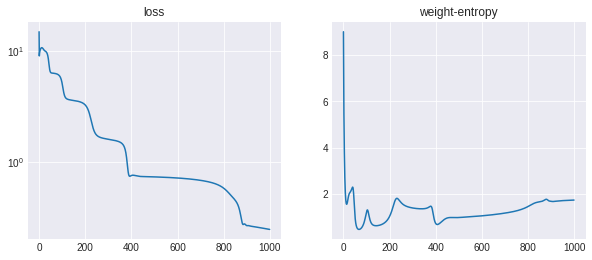

In [13]:
me_model = maxent_fit(trajs, restraints)

Plotting 10 patches in a 3 x 4 grid


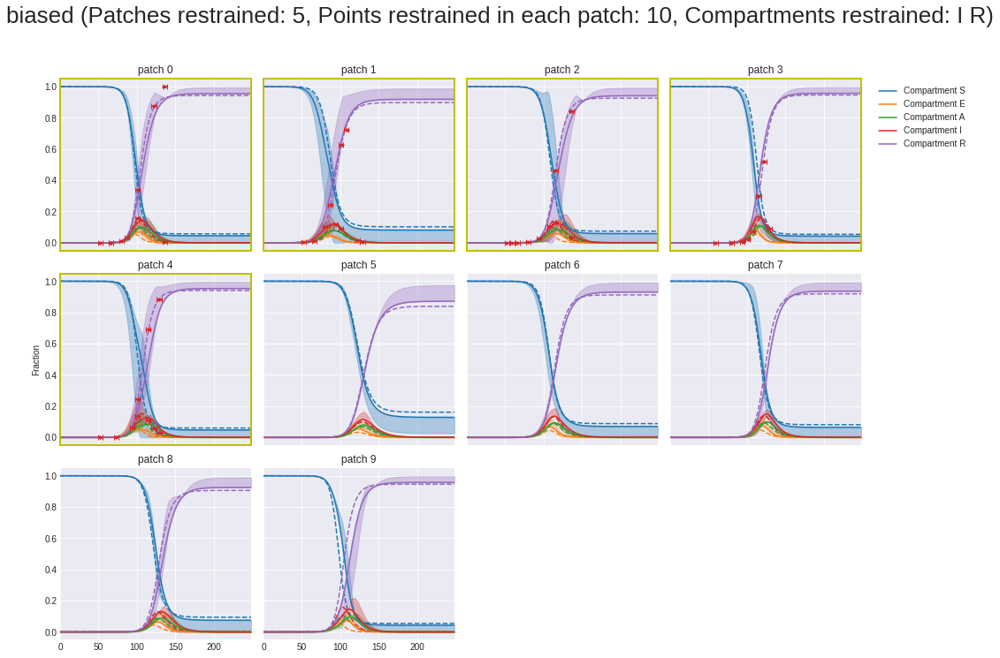

In [14]:
weights_dict = {'unbiased':None, 'biased':me_model.traj_weights}
compare_patches(ref_traj, trajs, weights_dict,'biased', restrained_patches, plot_fxns_list,
                patch_names = patches, figsize=(15, 10), alpha=0.3, names=full_compartments)

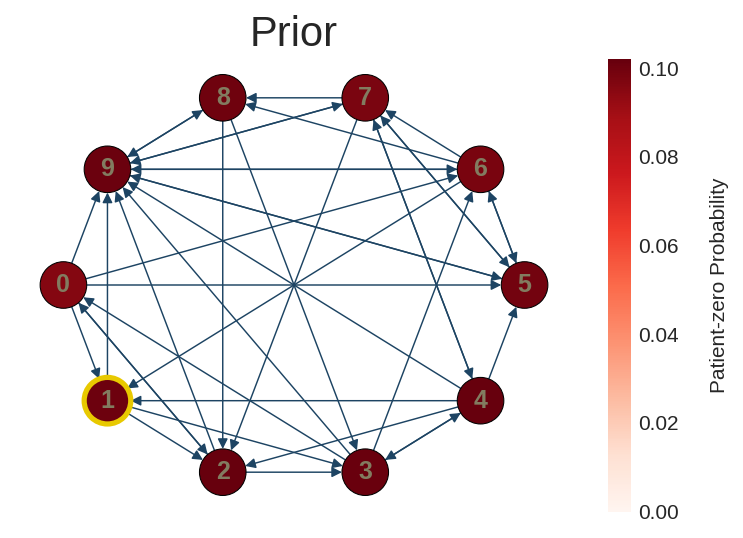

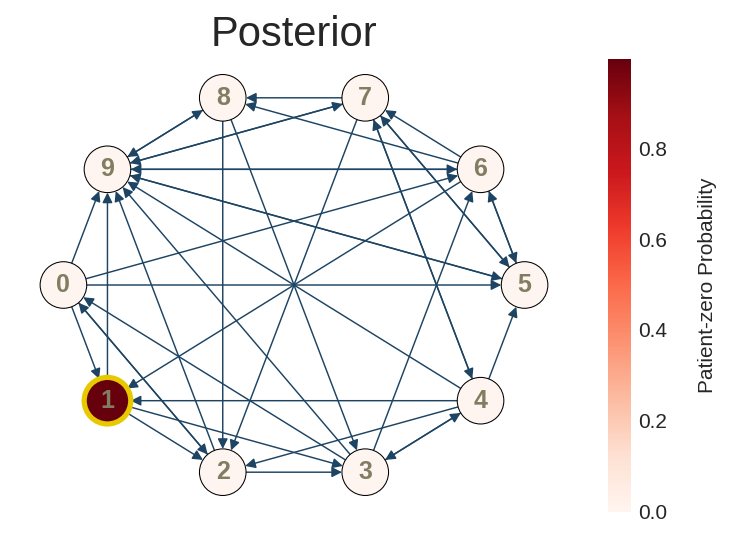

In [16]:
me_w = me_model.traj_weights
exposed_prob = maxentep.weighted_exposed_prob_finder(
                            prior_exposed_patch, M)
weighted_exposed_prob = maxentep.weighted_exposed_prob_finder(
                            prior_exposed_patch, M, weights=me_w)
maxentep.draw_graph(graph, weights=exposed_prob, title='Prior', heatmap=True, true_origin=true_node)
fig, ax = plt.subplots()
maxentep.draw_graph(graph, weights=weighted_exposed_prob, title='Posterior', heatmap=True, true_origin=true_node)

In [17]:
traj_loss = maxentep.traj_loss(ref_traj, trajs, me_w)
p0_loss = maxentep.p0_loss(trajs,me_w, true_node)
# posterior_exposed_prob = maxentep.weighted_exposed_prob_finder(prior_exposed_patch, M, weights = me_w)
print(f'P0 cross-entropy : {p0_loss:.3f}, Traj KL : {traj_loss:.3f}')
print('Top 5 posterior probabilities for P0: \n', sorted(zip(weighted_exposed_prob, patches), reverse=True)[:5])

P0 cross-entropy : 0.002, Traj KL : 0.007
Top 5 posterior probabilities for P0: 
 [(0.9981752022993345, 'patch 1'), (0.001423243726784317, 'patch 6'), (0.00021464238257986546, 'patch 5'), (0.00010370581204440149, 'patch 0'), (8.225940570117936e-05, 'patch 9')]



If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



100%|██████████| 16/16 [00:28<00:00,  1.81s/it]


Restraints are set in this time range: [50, 140]
94 0.121943556 0.12399766553321727
73 0.004778512 0.004928240639860628
136 0.0051633627 0.005304577717737597
101 0.1526289 0.15027962377628787
66 0.0012560984 0.0012607090376556644
87 0.07089609 0.06991537199400698
129 0.9203712 0.8088447685114957
80 0.020256534 0.020487063558926513
66 0.0013903391 0.001437361359998841
108 0.6742217 0.6757645234972083
73 4.2212287e-05 4.335191798695191e-05
52 6.265617e-07 5.560339994316369e-07
122 0.055721436 0.05476409335344655
108 0.014261239 0.014212791260279292
136 0.093764186 0.09928027309333946
101 0.008261711 0.007635880444653009
59 2.7323788e-06 2.76650187493296e-06
73 4.5905563e-05 4.732705685904774e-05
115 0.05719712 0.062491485993872775
122 0.124710366 0.12100988947802964
66 0.0023770833 0.0024803632215450204
59 0.0006097186 0.0006181593101084129
115 0.039187353 0.03728460221919099
108 0.08119091 0.08246892117532625
80 0.031213941 0.03249618745183426
129 0.93001956 0.930265670704505
66 0.00262

1/1 [==============================] - 0s 928us/step - loss: 32.6496 - weight-entropy: 1.1798
Epoch 60/1000
1/1 [==============================] - 0s 700us/step - loss: 32.5510 - weight-entropy: 1.1829
Epoch 61/1000
1/1 [==============================] - 0s 706us/step - loss: 32.4542 - weight-entropy: 1.1865
Epoch 62/1000
1/1 [==============================] - 0s 903us/step - loss: 32.3592 - weight-entropy: 1.1904
Epoch 63/1000
1/1 [==============================] - 0s 712us/step - loss: 32.2654 - weight-entropy: 1.1948
Epoch 64/1000
1/1 [==============================] - 0s 891us/step - loss: 32.1728 - weight-entropy: 1.1996
Epoch 65/1000
1/1 [==============================] - 0s 903us/step - loss: 32.0813 - weight-entropy: 1.2048
Epoch 66/1000
1/1 [==============================] - 0s 899us/step - loss: 31.9912 - weight-entropy: 1.2105
Epoch 67/1000
1/1 [==============================] - 0s 1ms/step - loss: 31.9021 - weight-entropy: 1.2165
Epoch 68/1000
1/1 [=========================

1/1 [==============================] - 0s 716us/step - loss: 26.1338 - weight-entropy: 1.9090
Epoch 135/1000
1/1 [==============================] - 0s 711us/step - loss: 26.0674 - weight-entropy: 1.9192
Epoch 136/1000
1/1 [==============================] - 0s 1ms/step - loss: 26.0011 - weight-entropy: 1.9293
Epoch 137/1000
1/1 [==============================] - 0s 949us/step - loss: 25.9348 - weight-entropy: 1.9391
Epoch 138/1000
1/1 [==============================] - 0s 738us/step - loss: 25.8682 - weight-entropy: 1.9487
Epoch 139/1000
1/1 [==============================] - 0s 1ms/step - loss: 25.8015 - weight-entropy: 1.9581
Epoch 140/1000
1/1 [==============================] - 0s 715us/step - loss: 25.7337 - weight-entropy: 1.9672
Epoch 141/1000
1/1 [==============================] - 0s 879us/step - loss: 25.6658 - weight-entropy: 1.9761
Epoch 142/1000
1/1 [==============================] - 0s 725us/step - loss: 25.5967 - weight-entropy: 1.9848
Epoch 143/1000
1/1 [==================

1/1 [==============================] - 0s 1ms/step - loss: 10.2474 - weight-entropy: 1.9844
Epoch 210/1000
1/1 [==============================] - 0s 992us/step - loss: 10.1050 - weight-entropy: 1.9412
Epoch 211/1000
1/1 [==============================] - 0s 896us/step - loss: 9.9781 - weight-entropy: 1.8991
Epoch 212/1000
1/1 [==============================] - 0s 890us/step - loss: 9.8647 - weight-entropy: 1.8590
Epoch 213/1000
1/1 [==============================] - 0s 888us/step - loss: 9.7632 - weight-entropy: 1.8214
Epoch 214/1000
1/1 [==============================] - 0s 913us/step - loss: 9.6717 - weight-entropy: 1.7867
Epoch 215/1000
1/1 [==============================] - 0s 890us/step - loss: 9.5890 - weight-entropy: 1.7550
Epoch 216/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.5137 - weight-entropy: 1.7266
Epoch 217/1000
1/1 [==============================] - 0s 740us/step - loss: 9.4444 - weight-entropy: 1.7014
Epoch 218/1000
1/1 [=========================

1/1 [==============================] - 0s 721us/step - loss: 2.3217 - weight-entropy: 1.1381
Epoch 286/1000
1/1 [==============================] - 0s 921us/step - loss: 2.3091 - weight-entropy: 1.1390
Epoch 287/1000
1/1 [==============================] - 0s 709us/step - loss: 2.2967 - weight-entropy: 1.1413
Epoch 288/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.2844 - weight-entropy: 1.1448
Epoch 289/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.2724 - weight-entropy: 1.1495
Epoch 290/1000
1/1 [==============================] - 0s 973us/step - loss: 2.2605 - weight-entropy: 1.1552
Epoch 291/1000
1/1 [==============================] - 0s 719us/step - loss: 2.2488 - weight-entropy: 1.1617
Epoch 292/1000
1/1 [==============================] - 0s 698us/step - loss: 2.2374 - weight-entropy: 1.1692
Epoch 293/1000
1/1 [==============================] - 0s 698us/step - loss: 2.2262 - weight-entropy: 1.1774
Epoch 294/1000
1/1 [===========================

1/1 [==============================] - 0s 816us/step - loss: 1.8028 - weight-entropy: 1.8738
Epoch 362/1000
1/1 [==============================] - 0s 642us/step - loss: 1.7990 - weight-entropy: 1.8777
Epoch 363/1000
1/1 [==============================] - 0s 801us/step - loss: 1.7953 - weight-entropy: 1.8815
Epoch 364/1000
1/1 [==============================] - 0s 821us/step - loss: 1.7915 - weight-entropy: 1.8852
Epoch 365/1000
1/1 [==============================] - 0s 663us/step - loss: 1.7878 - weight-entropy: 1.8888
Epoch 366/1000
1/1 [==============================] - 0s 646us/step - loss: 1.7842 - weight-entropy: 1.8923
Epoch 367/1000
1/1 [==============================] - 0s 639us/step - loss: 1.7805 - weight-entropy: 1.8956
Epoch 368/1000
1/1 [==============================] - 0s 661us/step - loss: 1.7768 - weight-entropy: 1.8989
Epoch 369/1000
1/1 [==============================] - 0s 658us/step - loss: 1.7732 - weight-entropy: 1.9021
Epoch 370/1000
1/1 [=======================

Epoch 437/1000
1/1 [==============================] - 0s 829us/step - loss: 1.5494 - weight-entropy: 2.0855
Epoch 438/1000
1/1 [==============================] - 0s 856us/step - loss: 1.5462 - weight-entropy: 2.0884
Epoch 439/1000
1/1 [==============================] - 0s 832us/step - loss: 1.5430 - weight-entropy: 2.0914
Epoch 440/1000
1/1 [==============================] - 0s 899us/step - loss: 1.5398 - weight-entropy: 2.0943
Epoch 441/1000
1/1 [==============================] - 0s 847us/step - loss: 1.5366 - weight-entropy: 2.0973
Epoch 442/1000
1/1 [==============================] - 0s 861us/step - loss: 1.5334 - weight-entropy: 2.1004
Epoch 443/1000
1/1 [==============================] - 0s 851us/step - loss: 1.5301 - weight-entropy: 2.1034
Epoch 444/1000
1/1 [==============================] - 0s 847us/step - loss: 1.5269 - weight-entropy: 2.1064
Epoch 445/1000
1/1 [==============================] - 0s 846us/step - loss: 1.5237 - weight-entropy: 2.1095
Epoch 446/1000
1/1 [========

1/1 [==============================] - 0s 644us/step - loss: 1.1885 - weight-entropy: 2.4896
Epoch 513/1000
1/1 [==============================] - 0s 880us/step - loss: 1.1768 - weight-entropy: 2.5032
Epoch 514/1000
1/1 [==============================] - 0s 810us/step - loss: 1.1644 - weight-entropy: 2.5176
Epoch 515/1000
1/1 [==============================] - 0s 808us/step - loss: 1.1513 - weight-entropy: 2.5327
Epoch 516/1000
1/1 [==============================] - 0s 851us/step - loss: 1.1373 - weight-entropy: 2.5487
Epoch 517/1000
1/1 [==============================] - 0s 650us/step - loss: 1.1225 - weight-entropy: 2.5655
Epoch 518/1000
1/1 [==============================] - 0s 632us/step - loss: 1.1066 - weight-entropy: 2.5833
Epoch 519/1000
1/1 [==============================] - 0s 636us/step - loss: 1.0897 - weight-entropy: 2.6020
Epoch 520/1000
1/1 [==============================] - 0s 648us/step - loss: 1.0716 - weight-entropy: 2.6218
Epoch 521/1000
1/1 [=======================

1/1 [==============================] - 0s 813us/step - loss: 0.5319 - weight-entropy: 3.5183
Epoch 589/1000
1/1 [==============================] - 0s 820us/step - loss: 0.5294 - weight-entropy: 3.5321
Epoch 590/1000
1/1 [==============================] - 0s 806us/step - loss: 0.5270 - weight-entropy: 3.5454
Epoch 591/1000
1/1 [==============================] - 0s 659us/step - loss: 0.5248 - weight-entropy: 3.5583
Epoch 592/1000
1/1 [==============================] - 0s 654us/step - loss: 0.5227 - weight-entropy: 3.5708
Epoch 593/1000
1/1 [==============================] - 0s 813us/step - loss: 0.5206 - weight-entropy: 3.5828
Epoch 594/1000
1/1 [==============================] - 0s 821us/step - loss: 0.5187 - weight-entropy: 3.5945
Epoch 595/1000
1/1 [==============================] - 0s 666us/step - loss: 0.5168 - weight-entropy: 3.6057
Epoch 596/1000
1/1 [==============================] - 0s 841us/step - loss: 0.5151 - weight-entropy: 3.6165
Epoch 597/1000
1/1 [=======================

Epoch 664/1000
1/1 [==============================] - 0s 816us/step - loss: 0.4194 - weight-entropy: 3.8448
Epoch 665/1000
1/1 [==============================] - 0s 641us/step - loss: 0.4181 - weight-entropy: 3.8476
Epoch 666/1000
1/1 [==============================] - 0s 826us/step - loss: 0.4169 - weight-entropy: 3.8504
Epoch 667/1000
1/1 [==============================] - 0s 813us/step - loss: 0.4156 - weight-entropy: 3.8532
Epoch 668/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.4144 - weight-entropy: 3.8561
Epoch 669/1000
1/1 [==============================] - 0s 894us/step - loss: 0.4131 - weight-entropy: 3.8589
Epoch 670/1000
1/1 [==============================] - 0s 901us/step - loss: 0.4119 - weight-entropy: 3.8617
Epoch 671/1000
1/1 [==============================] - 0s 669us/step - loss: 0.4106 - weight-entropy: 3.8646
Epoch 672/1000
1/1 [==============================] - 0s 840us/step - loss: 0.4094 - weight-entropy: 3.8674
Epoch 673/1000
1/1 [==========

1/1 [==============================] - 0s 864us/step - loss: 0.3333 - weight-entropy: 4.0504
Epoch 740/1000
1/1 [==============================] - 0s 646us/step - loss: 0.3323 - weight-entropy: 4.0531
Epoch 741/1000
1/1 [==============================] - 0s 828us/step - loss: 0.3313 - weight-entropy: 4.0558
Epoch 742/1000
1/1 [==============================] - 0s 835us/step - loss: 0.3302 - weight-entropy: 4.0585
Epoch 743/1000
1/1 [==============================] - 0s 803us/step - loss: 0.3292 - weight-entropy: 4.0612
Epoch 744/1000
1/1 [==============================] - 0s 809us/step - loss: 0.3282 - weight-entropy: 4.0639
Epoch 745/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3271 - weight-entropy: 4.0666
Epoch 746/1000
1/1 [==============================] - 0s 803us/step - loss: 0.3261 - weight-entropy: 4.0693
Epoch 747/1000
1/1 [==============================] - 0s 886us/step - loss: 0.3251 - weight-entropy: 4.0720
Epoch 748/1000
1/1 [=========================

1/1 [==============================] - 0s 649us/step - loss: 0.2630 - weight-entropy: 4.2515
Epoch 816/1000
1/1 [==============================] - 0s 660us/step - loss: 0.2622 - weight-entropy: 4.2540
Epoch 817/1000
1/1 [==============================] - 0s 651us/step - loss: 0.2614 - weight-entropy: 4.2566
Epoch 818/1000
1/1 [==============================] - 0s 841us/step - loss: 0.2606 - weight-entropy: 4.2591
Epoch 819/1000
1/1 [==============================] - 0s 897us/step - loss: 0.2598 - weight-entropy: 4.2617
Epoch 820/1000
1/1 [==============================] - 0s 850us/step - loss: 0.2590 - weight-entropy: 4.2642
Epoch 821/1000
1/1 [==============================] - 0s 658us/step - loss: 0.2582 - weight-entropy: 4.2668
Epoch 822/1000
1/1 [==============================] - 0s 609us/step - loss: 0.2575 - weight-entropy: 4.2693
Epoch 823/1000
1/1 [==============================] - 0s 636us/step - loss: 0.2567 - weight-entropy: 4.2719
Epoch 824/1000
1/1 [=======================

1/1 [==============================] - 0s 654us/step - loss: 0.2105 - weight-entropy: 4.4356
Epoch 892/1000
1/1 [==============================] - 0s 812us/step - loss: 0.2100 - weight-entropy: 4.4379
Epoch 893/1000
1/1 [==============================] - 0s 647us/step - loss: 0.2094 - weight-entropy: 4.4402
Epoch 894/1000
1/1 [==============================] - 0s 651us/step - loss: 0.2088 - weight-entropy: 4.4424
Epoch 895/1000
1/1 [==============================] - 0s 815us/step - loss: 0.2082 - weight-entropy: 4.4446
Epoch 896/1000
1/1 [==============================] - 0s 810us/step - loss: 0.2077 - weight-entropy: 4.4469
Epoch 897/1000
1/1 [==============================] - 0s 643us/step - loss: 0.2071 - weight-entropy: 4.4491
Epoch 898/1000
1/1 [==============================] - 0s 833us/step - loss: 0.2066 - weight-entropy: 4.4514
Epoch 899/1000
1/1 [==============================] - 0s 622us/step - loss: 0.2060 - weight-entropy: 4.4536
Epoch 900/1000
1/1 [=======================

1/1 [==============================] - 0s 813us/step - loss: 0.1739 - weight-entropy: 4.5936
Epoch 968/1000
1/1 [==============================] - 0s 673us/step - loss: 0.1735 - weight-entropy: 4.5955
Epoch 969/1000
1/1 [==============================] - 0s 805us/step - loss: 0.1731 - weight-entropy: 4.5974
Epoch 970/1000
1/1 [==============================] - 0s 818us/step - loss: 0.1727 - weight-entropy: 4.5993
Epoch 971/1000
1/1 [==============================] - 0s 641us/step - loss: 0.1723 - weight-entropy: 4.6011
Epoch 972/1000
1/1 [==============================] - 0s 854us/step - loss: 0.1719 - weight-entropy: 4.6030
Epoch 973/1000
1/1 [==============================] - 0s 644us/step - loss: 0.1715 - weight-entropy: 4.6049
Epoch 974/1000
1/1 [==============================] - 0s 801us/step - loss: 0.1711 - weight-entropy: 4.6067
Epoch 975/1000
1/1 [==============================] - 0s 622us/step - loss: 0.1707 - weight-entropy: 4.6086
Epoch 976/1000
1/1 [=======================

100%|██████████| 16/16 [00:28<00:00,  1.78s/it]


Restraints are set in this time range: [50, 140]
101 0.012935178 0.012417395216931732
136 0.067106634 0.06632388218522607
115 0.106966004 0.10587080681261095
52 9.1071996e-07 8.311121560710971e-07
73 6.019681e-05 6.427238440350334e-05
52 9.4525177e-07 7.908249210138281e-07
115 0.16724709 0.16476911051481305
73 6.551336e-05 6.896477342117824e-05
122 0.3886118 0.3839810833960565
101 0.014964907 0.014920663987074036
136 0.08902817 0.08803726335020658
108 0.0068346327 0.006522604662228569
80 6.757613e-05 6.189562171968655e-05
101 0.0025502532 0.002436898077327542
87 0.00024384623 0.00024679820274601855
52 3.536713e-07 3.3795556898197547e-07
66 5.478319e-06 4.8648557751648995e-06
122 0.06703037 0.06837600175103822
87 0.0002873072 0.00030490289971391634
108 0.010226631 0.010259793577863408
80 0.06191402 0.06134029415160286
122 0.015312849 0.015462470629312823
52 0.0014257828 0.001531888340277826
129 0.0075291465 0.007651436243990587
59 0.003970702 0.003734814213163582
94 0.4376872 0.43441735

1/1 [==============================] - 0s 840us/step - loss: 3.9227 - weight-entropy: 2.9860
Epoch 60/1000
1/1 [==============================] - 0s 810us/step - loss: 3.7324 - weight-entropy: 2.8443
Epoch 61/1000
1/1 [==============================] - 0s 842us/step - loss: 3.6275 - weight-entropy: 2.7641
Epoch 62/1000
1/1 [==============================] - 0s 849us/step - loss: 3.4448 - weight-entropy: 2.7164
Epoch 63/1000
1/1 [==============================] - 0s 836us/step - loss: 3.2256 - weight-entropy: 2.6851
Epoch 64/1000
1/1 [==============================] - 0s 818us/step - loss: 3.0270 - weight-entropy: 2.6633
Epoch 65/1000
1/1 [==============================] - 0s 807us/step - loss: 2.8631 - weight-entropy: 2.6475
Epoch 66/1000
1/1 [==============================] - 0s 874us/step - loss: 2.7259 - weight-entropy: 2.6355
Epoch 67/1000
1/1 [==============================] - 0s 817us/step - loss: 2.6044 - weight-entropy: 2.6260
Epoch 68/1000
1/1 [==============================] 

1/1 [==============================] - 0s 828us/step - loss: 0.9466 - weight-entropy: 2.5069
Epoch 136/1000
1/1 [==============================] - 0s 798us/step - loss: 0.9408 - weight-entropy: 2.5056
Epoch 137/1000
1/1 [==============================] - 0s 840us/step - loss: 0.9351 - weight-entropy: 2.5051
Epoch 138/1000
1/1 [==============================] - 0s 897us/step - loss: 0.9295 - weight-entropy: 2.5052
Epoch 139/1000
1/1 [==============================] - 0s 806us/step - loss: 0.9240 - weight-entropy: 2.5058
Epoch 140/1000
1/1 [==============================] - 0s 846us/step - loss: 0.9185 - weight-entropy: 2.5068
Epoch 141/1000
1/1 [==============================] - 0s 917us/step - loss: 0.9131 - weight-entropy: 2.5080
Epoch 142/1000
1/1 [==============================] - 0s 834us/step - loss: 0.9078 - weight-entropy: 2.5090
Epoch 143/1000
1/1 [==============================] - 0s 684us/step - loss: 0.9025 - weight-entropy: 2.5098
Epoch 144/1000
1/1 [=======================

Epoch 211/1000
1/1 [==============================] - 0s 833us/step - loss: 0.6508 - weight-entropy: 2.4832
Epoch 212/1000
1/1 [==============================] - 0s 799us/step - loss: 0.6481 - weight-entropy: 2.4831
Epoch 213/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.6455 - weight-entropy: 2.4831
Epoch 214/1000
1/1 [==============================] - 0s 814us/step - loss: 0.6428 - weight-entropy: 2.4830
Epoch 215/1000
1/1 [==============================] - 0s 803us/step - loss: 0.6402 - weight-entropy: 2.4830
Epoch 216/1000
1/1 [==============================] - 0s 823us/step - loss: 0.6376 - weight-entropy: 2.4829
Epoch 217/1000
1/1 [==============================] - 0s 651us/step - loss: 0.6351 - weight-entropy: 2.4828
Epoch 218/1000
1/1 [==============================] - 0s 829us/step - loss: 0.6325 - weight-entropy: 2.4828
Epoch 219/1000
1/1 [==============================] - 0s 823us/step - loss: 0.6299 - weight-entropy: 2.4828
Epoch 220/1000
1/1 [==========

1/1 [==============================] - 0s 819us/step - loss: 0.4899 - weight-entropy: 2.5113
Epoch 287/1000
1/1 [==============================] - 0s 803us/step - loss: 0.4882 - weight-entropy: 2.5121
Epoch 288/1000
1/1 [==============================] - 0s 618us/step - loss: 0.4864 - weight-entropy: 2.5129
Epoch 289/1000
1/1 [==============================] - 0s 631us/step - loss: 0.4847 - weight-entropy: 2.5137
Epoch 290/1000
1/1 [==============================] - 0s 820us/step - loss: 0.4830 - weight-entropy: 2.5145
Epoch 291/1000
1/1 [==============================] - 0s 874us/step - loss: 0.4812 - weight-entropy: 2.5153
Epoch 292/1000
1/1 [==============================] - 0s 694us/step - loss: 0.4795 - weight-entropy: 2.5161
Epoch 293/1000
1/1 [==============================] - 0s 840us/step - loss: 0.4778 - weight-entropy: 2.5169
Epoch 294/1000
1/1 [==============================] - 0s 815us/step - loss: 0.4761 - weight-entropy: 2.5178
Epoch 295/1000
1/1 [=======================

1/1 [==============================] - 0s 651us/step - loss: 0.3749 - weight-entropy: 2.5892
Epoch 363/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3736 - weight-entropy: 2.5904
Epoch 364/1000
1/1 [==============================] - 0s 842us/step - loss: 0.3722 - weight-entropy: 2.5916
Epoch 365/1000
1/1 [==============================] - 0s 664us/step - loss: 0.3709 - weight-entropy: 2.5928
Epoch 366/1000
1/1 [==============================] - 0s 670us/step - loss: 0.3696 - weight-entropy: 2.5940
Epoch 367/1000
1/1 [==============================] - 0s 674us/step - loss: 0.3683 - weight-entropy: 2.5952
Epoch 368/1000
1/1 [==============================] - 0s 645us/step - loss: 0.3670 - weight-entropy: 2.5964
Epoch 369/1000
1/1 [==============================] - 0s 648us/step - loss: 0.3657 - weight-entropy: 2.5976
Epoch 370/1000
1/1 [==============================] - 0s 654us/step - loss: 0.3645 - weight-entropy: 2.5988
Epoch 371/1000
1/1 [=========================

1/1 [==============================] - 0s 799us/step - loss: 0.2862 - weight-entropy: 2.6824
Epoch 439/1000
1/1 [==============================] - 0s 788us/step - loss: 0.2852 - weight-entropy: 2.6836
Epoch 440/1000
1/1 [==============================] - 0s 801us/step - loss: 0.2842 - weight-entropy: 2.6847
Epoch 441/1000
1/1 [==============================] - 0s 874us/step - loss: 0.2832 - weight-entropy: 2.6859
Epoch 442/1000
1/1 [==============================] - 0s 813us/step - loss: 0.2822 - weight-entropy: 2.6871
Epoch 443/1000
1/1 [==============================] - 0s 795us/step - loss: 0.2812 - weight-entropy: 2.6882
Epoch 444/1000
1/1 [==============================] - 0s 798us/step - loss: 0.2802 - weight-entropy: 2.6894
Epoch 445/1000
1/1 [==============================] - 0s 801us/step - loss: 0.2792 - weight-entropy: 2.6906
Epoch 446/1000
1/1 [==============================] - 0s 948us/step - loss: 0.2782 - weight-entropy: 2.6917
Epoch 447/1000
1/1 [=======================

1/1 [==============================] - 0s 915us/step - loss: 0.2194 - weight-entropy: 2.7609
Epoch 515/1000
1/1 [==============================] - 0s 853us/step - loss: 0.2187 - weight-entropy: 2.7618
Epoch 516/1000
1/1 [==============================] - 0s 871us/step - loss: 0.2179 - weight-entropy: 2.7626
Epoch 517/1000
1/1 [==============================] - 0s 810us/step - loss: 0.2172 - weight-entropy: 2.7635
Epoch 518/1000
1/1 [==============================] - 0s 833us/step - loss: 0.2165 - weight-entropy: 2.7643
Epoch 519/1000
1/1 [==============================] - 0s 652us/step - loss: 0.2158 - weight-entropy: 2.7652
Epoch 520/1000
1/1 [==============================] - 0s 819us/step - loss: 0.2151 - weight-entropy: 2.7660
Epoch 521/1000
1/1 [==============================] - 0s 833us/step - loss: 0.2143 - weight-entropy: 2.7669
Epoch 522/1000
1/1 [==============================] - 0s 813us/step - loss: 0.2136 - weight-entropy: 2.7677
Epoch 523/1000
1/1 [=======================

1/1 [==============================] - 0s 818us/step - loss: 0.1733 - weight-entropy: 2.8169
Epoch 591/1000
1/1 [==============================] - 0s 823us/step - loss: 0.1728 - weight-entropy: 2.8175
Epoch 592/1000
1/1 [==============================] - 0s 808us/step - loss: 0.1723 - weight-entropy: 2.8182
Epoch 593/1000
1/1 [==============================] - 0s 820us/step - loss: 0.1718 - weight-entropy: 2.8188
Epoch 594/1000
1/1 [==============================] - 0s 811us/step - loss: 0.1713 - weight-entropy: 2.8194
Epoch 595/1000
1/1 [==============================] - 0s 820us/step - loss: 0.1708 - weight-entropy: 2.8201
Epoch 596/1000
1/1 [==============================] - 0s 648us/step - loss: 0.1703 - weight-entropy: 2.8207
Epoch 597/1000
1/1 [==============================] - 0s 804us/step - loss: 0.1699 - weight-entropy: 2.8214
Epoch 598/1000
1/1 [==============================] - 0s 813us/step - loss: 0.1694 - weight-entropy: 2.8220
Epoch 599/1000
1/1 [=======================

Epoch 666/1000
1/1 [==============================] - 0s 802us/step - loss: 0.1418 - weight-entropy: 2.8637
Epoch 667/1000
1/1 [==============================] - 0s 638us/step - loss: 0.1414 - weight-entropy: 2.8643
Epoch 668/1000
1/1 [==============================] - 0s 824us/step - loss: 0.1411 - weight-entropy: 2.8649
Epoch 669/1000
1/1 [==============================] - 0s 847us/step - loss: 0.1407 - weight-entropy: 2.8655
Epoch 670/1000
1/1 [==============================] - 0s 808us/step - loss: 0.1404 - weight-entropy: 2.8661
Epoch 671/1000
1/1 [==============================] - 0s 860us/step - loss: 0.1400 - weight-entropy: 2.8667
Epoch 672/1000
1/1 [==============================] - 0s 629us/step - loss: 0.1397 - weight-entropy: 2.8673
Epoch 673/1000
1/1 [==============================] - 0s 669us/step - loss: 0.1393 - weight-entropy: 2.8678
Epoch 674/1000
1/1 [==============================] - 0s 641us/step - loss: 0.1390 - weight-entropy: 2.8684
Epoch 675/1000
1/1 [========

1/1 [==============================] - 0s 867us/step - loss: 0.1187 - weight-entropy: 2.9056
Epoch 742/1000
1/1 [==============================] - 0s 655us/step - loss: 0.1184 - weight-entropy: 2.9061
Epoch 743/1000
1/1 [==============================] - 0s 856us/step - loss: 0.1181 - weight-entropy: 2.9066
Epoch 744/1000
1/1 [==============================] - 0s 658us/step - loss: 0.1179 - weight-entropy: 2.9071
Epoch 745/1000
1/1 [==============================] - 0s 651us/step - loss: 0.1176 - weight-entropy: 2.9076
Epoch 746/1000
1/1 [==============================] - 0s 653us/step - loss: 0.1173 - weight-entropy: 2.9081
Epoch 747/1000
1/1 [==============================] - 0s 649us/step - loss: 0.1171 - weight-entropy: 2.9086
Epoch 748/1000
1/1 [==============================] - 0s 698us/step - loss: 0.1168 - weight-entropy: 2.9091
Epoch 749/1000
1/1 [==============================] - 0s 643us/step - loss: 0.1165 - weight-entropy: 2.9096
Epoch 750/1000
1/1 [=======================

1/1 [==============================] - 0s 804us/step - loss: 0.1000 - weight-entropy: 2.9401
Epoch 818/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0998 - weight-entropy: 2.9405
Epoch 819/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0996 - weight-entropy: 2.9409
Epoch 820/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0994 - weight-entropy: 2.9413
Epoch 821/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0991 - weight-entropy: 2.9417
Epoch 822/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0989 - weight-entropy: 2.9420
Epoch 823/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0987 - weight-entropy: 2.9424
Epoch 824/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0985 - weight-entropy: 2.9428
Epoch 825/1000
1/1 [==============================] - 0s 836us/step - loss: 0.0983 - weight-entropy: 2.9432
Epoch 826/1000
1/1 [=======================

1/1 [==============================] - 0s 886us/step - loss: 0.0846 - weight-entropy: 2.9660
Epoch 894/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0844 - weight-entropy: 2.9663
Epoch 895/1000
1/1 [==============================] - 0s 883us/step - loss: 0.0842 - weight-entropy: 2.9666
Epoch 896/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0841 - weight-entropy: 2.9668
Epoch 897/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0839 - weight-entropy: 2.9671
Epoch 898/1000
1/1 [==============================] - 0s 830us/step - loss: 0.0837 - weight-entropy: 2.9674
Epoch 899/1000
1/1 [==============================] - 0s 787us/step - loss: 0.0835 - weight-entropy: 2.9677
Epoch 900/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0833 - weight-entropy: 2.9680
Epoch 901/1000
1/1 [==============================] - 0s 914us/step - loss: 0.0832 - weight-entropy: 2.9683
Epoch 902/1000
1/1 [=======================

1/1 [==============================] - 0s 634us/step - loss: 0.0717 - weight-entropy: 2.9853
Epoch 970/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0715 - weight-entropy: 2.9855
Epoch 971/1000
1/1 [==============================] - 0s 869us/step - loss: 0.0714 - weight-entropy: 2.9857
Epoch 972/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0712 - weight-entropy: 2.9859
Epoch 973/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0711 - weight-entropy: 2.9861
Epoch 974/1000
1/1 [==============================] - 0s 889us/step - loss: 0.0709 - weight-entropy: 2.9864
Epoch 975/1000
1/1 [==============================] - 0s 934us/step - loss: 0.0707 - weight-entropy: 2.9866
Epoch 976/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0706 - weight-entropy: 2.9868
Epoch 977/1000
1/1 [==============================] - 0s 660us/step - loss: 0.0704 - weight-entropy: 2.9870
Epoch 978/1000
1/1 [=======================

100%|██████████| 16/16 [00:28<00:00,  1.78s/it]


Restraints are set in this time range: [50, 140]
129 0.13929784 0.1406958143253908
122 0.14743471 0.15110750412482157
108 0.029850127 0.03149599536167583
66 7.098144e-06 7.466636391814927e-06
94 0.0022530663 0.0023554065788817893
59 1.5232139e-06 1.70171450764042e-06
122 0.30887786 0.2998556805425004
94 0.0024261696 0.0023618757986601895
108 0.035879243 0.03854795887005725
129 0.56056553 0.544077762544477
122 0.10688836 0.1019821600007585
115 0.063314624 0.06411396058260926
94 0.0032983604 0.0034336462348317754
101 0.010292618 0.01099248911917796
87 0.0009361591 0.000931928510406712
73 6.6608874e-05 7.116358012155039e-05
108 0.041214593 0.04098116269440616
136 0.6262616 0.6681725222290177
122 0.2482334 0.2525252360142637
94 0.0039330246 0.004044454441417884
108 0.020384371 0.019278549730330725
87 0.00038908925 0.0003896634432371278
129 0.14788815 0.13791883519461665
136 0.1027861 0.10601509352981653
73 2.2012171e-05 2.360248685666691e-05
94 0.0016823364 0.001764436771228976
52 2.316685

1/1 [==============================] - 0s 854us/step - loss: 0.6686 - weight-entropy: 2.3004
Epoch 61/1000
1/1 [==============================] - 0s 801us/step - loss: 0.6568 - weight-entropy: 2.3203
Epoch 62/1000
1/1 [==============================] - 0s 860us/step - loss: 0.6425 - weight-entropy: 2.3337
Epoch 63/1000
1/1 [==============================] - 0s 806us/step - loss: 0.6271 - weight-entropy: 2.3420
Epoch 64/1000
1/1 [==============================] - 0s 808us/step - loss: 0.6121 - weight-entropy: 2.3472
Epoch 65/1000
1/1 [==============================] - 0s 862us/step - loss: 0.5984 - weight-entropy: 2.3518
Epoch 66/1000
1/1 [==============================] - 0s 807us/step - loss: 0.5860 - weight-entropy: 2.3579
Epoch 67/1000
1/1 [==============================] - 0s 798us/step - loss: 0.5747 - weight-entropy: 2.3671
Epoch 68/1000
1/1 [==============================] - 0s 804us/step - loss: 0.5644 - weight-entropy: 2.3802
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 820us/step - loss: 0.1438 - weight-entropy: 3.8913
Epoch 137/1000
1/1 [==============================] - 0s 868us/step - loss: 0.1412 - weight-entropy: 3.8935
Epoch 138/1000
1/1 [==============================] - 0s 845us/step - loss: 0.1386 - weight-entropy: 3.8956
Epoch 139/1000
1/1 [==============================] - 0s 841us/step - loss: 0.1360 - weight-entropy: 3.8977
Epoch 140/1000
1/1 [==============================] - 0s 832us/step - loss: 0.1336 - weight-entropy: 3.9000
Epoch 141/1000
1/1 [==============================] - 0s 815us/step - loss: 0.1312 - weight-entropy: 3.9024
Epoch 142/1000
1/1 [==============================] - 0s 831us/step - loss: 0.1288 - weight-entropy: 3.9052
Epoch 143/1000
1/1 [==============================] - 0s 876us/step - loss: 0.1265 - weight-entropy: 3.9081
Epoch 144/1000
1/1 [==============================] - 0s 810us/step - loss: 0.1243 - weight-entropy: 3.9112
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 844us/step - loss: 0.0451 - weight-entropy: 4.2739
Epoch 213/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0445 - weight-entropy: 4.2778
Epoch 214/1000
1/1 [==============================] - 0s 896us/step - loss: 0.0440 - weight-entropy: 4.2817
Epoch 215/1000
1/1 [==============================] - 0s 921us/step - loss: 0.0434 - weight-entropy: 4.2856
Epoch 216/1000
1/1 [==============================] - 0s 869us/step - loss: 0.0429 - weight-entropy: 4.2894
Epoch 217/1000
1/1 [==============================] - 0s 895us/step - loss: 0.0424 - weight-entropy: 4.2931
Epoch 218/1000
1/1 [==============================] - 0s 845us/step - loss: 0.0419 - weight-entropy: 4.2968
Epoch 219/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0414 - weight-entropy: 4.3004
Epoch 220/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0409 - weight-entropy: 4.3040
Epoch 221/1000
1/1 [=======================

Epoch 288/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0204 - weight-entropy: 4.4518
Epoch 289/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0202 - weight-entropy: 4.4528
Epoch 290/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0200 - weight-entropy: 4.4539
Epoch 291/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0198 - weight-entropy: 4.4549
Epoch 292/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0197 - weight-entropy: 4.4559
Epoch 293/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0195 - weight-entropy: 4.4568
Epoch 294/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0193 - weight-entropy: 4.4578
Epoch 295/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0191 - weight-entropy: 4.4587
Epoch 296/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0190 - weight-entropy: 4.4596
Epoch 297/1000
1/1 [========

1/1 [==============================] - 0s 826us/step - loss: 0.0105 - weight-entropy: 4.4845
Epoch 364/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0104 - weight-entropy: 4.4845
Epoch 365/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0103 - weight-entropy: 4.4845
Epoch 366/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0102 - weight-entropy: 4.4846
Epoch 367/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0102 - weight-entropy: 4.4846
Epoch 368/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0101 - weight-entropy: 4.4846
Epoch 369/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0100 - weight-entropy: 4.4846
Epoch 370/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0099 - weight-entropy: 4.4846
Epoch 371/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0098 - weight-entropy: 4.4846
Epoch 372/1000
1/1 [=======================

Epoch 439/1000
1/1 [==============================] - 0s 831us/step - loss: 0.0053 - weight-entropy: 4.4778
Epoch 440/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0053 - weight-entropy: 4.4777
Epoch 441/1000
1/1 [==============================] - 0s 790us/step - loss: 0.0052 - weight-entropy: 4.4775
Epoch 442/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0052 - weight-entropy: 4.4774
Epoch 443/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0051 - weight-entropy: 4.4772
Epoch 444/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0051 - weight-entropy: 4.4771
Epoch 445/1000
1/1 [==============================] - 0s 894us/step - loss: 0.0050 - weight-entropy: 4.4770
Epoch 446/1000
1/1 [==============================] - 0s 843us/step - loss: 0.0050 - weight-entropy: 4.4768
Epoch 447/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0049 - weight-entropy: 4.4767
Epoch 448/1000
1/1 [========

1/1 [==============================] - 0s 671us/step - loss: 0.0026 - weight-entropy: 4.4678
Epoch 515/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0026 - weight-entropy: 4.4676
Epoch 516/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0025 - weight-entropy: 4.4675
Epoch 517/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0025 - weight-entropy: 4.4674
Epoch 518/1000
1/1 [==============================] - 0s 621us/step - loss: 0.0025 - weight-entropy: 4.4673
Epoch 519/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0025 - weight-entropy: 4.4672
Epoch 520/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0024 - weight-entropy: 4.4671
Epoch 521/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0024 - weight-entropy: 4.4670
Epoch 522/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0024 - weight-entropy: 4.4668
Epoch 523/1000
1/1 [=========================

1/1 [==============================] - 0s 851us/step - loss: 0.0012 - weight-entropy: 4.4607
Epoch 591/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0012 - weight-entropy: 4.4607
Epoch 592/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0012 - weight-entropy: 4.4606
Epoch 593/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0012 - weight-entropy: 4.4605
Epoch 594/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0011 - weight-entropy: 4.4604
Epoch 595/1000
1/1 [==============================] - 0s 657us/step - loss: 0.0011 - weight-entropy: 4.4604
Epoch 596/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0011 - weight-entropy: 4.4603
Epoch 597/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0011 - weight-entropy: 4.4602
Epoch 598/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0011 - weight-entropy: 4.4602
Epoch 599/1000
1/1 [=======================

Epoch 664/1000
1/1 [==============================] - 0s 797us/step - loss: 6.0270e-04 - weight-entropy: 4.4572
Epoch 665/1000
1/1 [==============================] - 0s 832us/step - loss: 5.9844e-04 - weight-entropy: 4.4571
Epoch 666/1000
1/1 [==============================] - 0s 823us/step - loss: 5.9420e-04 - weight-entropy: 4.4571
Epoch 667/1000
1/1 [==============================] - 0s 818us/step - loss: 5.9000e-04 - weight-entropy: 4.4571
Epoch 668/1000
1/1 [==============================] - 0s 851us/step - loss: 5.8581e-04 - weight-entropy: 4.4571
Epoch 669/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.8166e-04 - weight-entropy: 4.4570
Epoch 670/1000
1/1 [==============================] - 0s 852us/step - loss: 5.7754e-04 - weight-entropy: 4.4570
Epoch 671/1000
1/1 [==============================] - 0s 616us/step - loss: 5.7385e-04 - weight-entropy: 4.4570
Epoch 672/1000
1/1 [==============================] - 0s 645us/step - loss: 5.7019e-04 - weight-entropy: 4

1/1 [==============================] - 0s 683us/step - loss: 4.1103e-04 - weight-entropy: 4.4559
Epoch 738/1000
1/1 [==============================] - 0s 811us/step - loss: 4.0958e-04 - weight-entropy: 4.4559
Epoch 739/1000
1/1 [==============================] - 0s 649us/step - loss: 4.0813e-04 - weight-entropy: 4.4559
Epoch 740/1000
1/1 [==============================] - 0s 882us/step - loss: 4.0670e-04 - weight-entropy: 4.4559
Epoch 741/1000
1/1 [==============================] - 0s 701us/step - loss: 4.0526e-04 - weight-entropy: 4.4559
Epoch 742/1000
1/1 [==============================] - 0s 873us/step - loss: 4.0383e-04 - weight-entropy: 4.4559
Epoch 743/1000
1/1 [==============================] - 0s 825us/step - loss: 4.0240e-04 - weight-entropy: 4.4559
Epoch 744/1000
1/1 [==============================] - 0s 815us/step - loss: 4.0098e-04 - weight-entropy: 4.4558
Epoch 745/1000
1/1 [==============================] - 0s 989us/step - loss: 3.9956e-04 - weight-entropy: 4.4558
Epoch 7

1/1 [==============================] - 0s 867us/step - loss: 3.3815e-04 - weight-entropy: 4.4554
Epoch 811/1000
1/1 [==============================] - 0s 826us/step - loss: 3.3755e-04 - weight-entropy: 4.4554
Epoch 812/1000
1/1 [==============================] - 0s 838us/step - loss: 3.3695e-04 - weight-entropy: 4.4554
Epoch 813/1000
1/1 [==============================] - 0s 820us/step - loss: 3.3635e-04 - weight-entropy: 4.4554
Epoch 814/1000
1/1 [==============================] - 0s 829us/step - loss: 3.3575e-04 - weight-entropy: 4.4554
Epoch 815/1000
1/1 [==============================] - 0s 807us/step - loss: 3.3516e-04 - weight-entropy: 4.4554
Epoch 816/1000
1/1 [==============================] - 0s 843us/step - loss: 3.3456e-04 - weight-entropy: 4.4554
Epoch 817/1000
1/1 [==============================] - 0s 846us/step - loss: 3.3396e-04 - weight-entropy: 4.4554
Epoch 818/1000
1/1 [==============================] - 0s 831us/step - loss: 3.3337e-04 - weight-entropy: 4.4554
Epoch 8

1/1 [==============================] - 0s 804us/step - loss: 3.0672e-04 - weight-entropy: 4.4552
Epoch 884/1000
1/1 [==============================] - 0s 800us/step - loss: 3.0644e-04 - weight-entropy: 4.4552
Epoch 885/1000
1/1 [==============================] - 0s 801us/step - loss: 3.0617e-04 - weight-entropy: 4.4552
Epoch 886/1000
1/1 [==============================] - 0s 858us/step - loss: 3.0589e-04 - weight-entropy: 4.4552
Epoch 887/1000
1/1 [==============================] - 0s 863us/step - loss: 3.0562e-04 - weight-entropy: 4.4552
Epoch 888/1000
1/1 [==============================] - 0s 833us/step - loss: 3.0534e-04 - weight-entropy: 4.4552
Epoch 889/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0507e-04 - weight-entropy: 4.4552
Epoch 890/1000
1/1 [==============================] - 0s 826us/step - loss: 3.0479e-04 - weight-entropy: 4.4552
Epoch 891/1000
1/1 [==============================] - 0s 831us/step - loss: 3.0454e-04 - weight-entropy: 4.4552
Epoch 892

1/1 [==============================] - 0s 828us/step - loss: 2.9237e-04 - weight-entropy: 4.4551
Epoch 957/1000
1/1 [==============================] - 0s 807us/step - loss: 2.9224e-04 - weight-entropy: 4.4551
Epoch 958/1000
1/1 [==============================] - 0s 873us/step - loss: 2.9210e-04 - weight-entropy: 4.4551
Epoch 959/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9197e-04 - weight-entropy: 4.4551
Epoch 960/1000
1/1 [==============================] - 0s 822us/step - loss: 2.9183e-04 - weight-entropy: 4.4551
Epoch 961/1000
1/1 [==============================] - 0s 808us/step - loss: 2.9171e-04 - weight-entropy: 4.4551
Epoch 962/1000
1/1 [==============================] - 0s 783us/step - loss: 2.9159e-04 - weight-entropy: 4.4551
Epoch 963/1000
1/1 [==============================] - 0s 807us/step - loss: 2.9148e-04 - weight-entropy: 4.4551
Epoch 964/1000
1/1 [==============================] - 0s 821us/step - loss: 2.9136e-04 - weight-entropy: 4.4551
Epoch 965

100%|██████████| 16/16 [00:28<00:00,  1.77s/it]


Restraints are set in this time range: [50, 140]
94 0.1080315 0.10372144684761037
73 0.0040393616 0.004355790844173925
52 6.137776e-05 6.481325631744245e-05
122 0.031410675 0.02988948851408285
129 0.014154805 0.015027610471426119
94 0.1775562 0.1696720704943441
122 0.8720436 0.923833697596776
115 0.7898496 0.8203283997027996
52 6.3139174e-05 6.280643447783605e-05
73 0.0044692596 0.0050285082570810345
115 0.14723408 0.14590425196570203
94 0.009223884 0.009061855358839816
59 6.804055e-06 6.7076349852841475e-06
101 0.03214533 0.0332501912057785
108 0.08757918 0.08733741601454637
115 0.3209195 0.3283722766962467
129 0.7555723 0.7854254069826021
52 1.3700421e-06 1.3776271522135798e-06
122 0.5687247 0.5993763217275115
94 0.010178594 0.01016738468344425
115 0.05270281 0.0527937361618506
129 0.12960307 0.12357456177634613
66 1.4856203e-05 1.5516546505394966e-05
87 0.00069231406 0.0007510036641985944
80 0.00020334567 0.0002032071146855355
52 9.650389e-07 9.517121068051077e-07
59 4.014085e-06 4.

1/1 [==============================] - 0s 808us/step - loss: 42.6926 - weight-entropy: 0.1198
Epoch 60/1000
1/1 [==============================] - 0s 840us/step - loss: 42.6172 - weight-entropy: 0.1205
Epoch 61/1000
1/1 [==============================] - 0s 799us/step - loss: 42.5437 - weight-entropy: 0.1212
Epoch 62/1000
1/1 [==============================] - 0s 793us/step - loss: 42.4726 - weight-entropy: 0.1220
Epoch 63/1000
1/1 [==============================] - 0s 798us/step - loss: 42.4029 - weight-entropy: 0.1227
Epoch 64/1000
1/1 [==============================] - 0s 1ms/step - loss: 42.3352 - weight-entropy: 0.1235
Epoch 65/1000
1/1 [==============================] - 0s 880us/step - loss: 42.2694 - weight-entropy: 0.1243
Epoch 66/1000
1/1 [==============================] - 0s 891us/step - loss: 42.2110 - weight-entropy: 0.1250
Epoch 67/1000
1/1 [==============================] - 0s 822us/step - loss: 42.1543 - weight-entropy: 0.1257
Epoch 68/1000
1/1 [=========================

1/1 [==============================] - 0s 866us/step - loss: 40.1386 - weight-entropy: 0.1714
Epoch 135/1000
1/1 [==============================] - 0s 672us/step - loss: 40.1193 - weight-entropy: 0.1721
Epoch 136/1000
1/1 [==============================] - 0s 663us/step - loss: 40.1004 - weight-entropy: 0.1728
Epoch 137/1000
1/1 [==============================] - 0s 651us/step - loss: 40.0819 - weight-entropy: 0.1736
Epoch 138/1000
1/1 [==============================] - 0s 671us/step - loss: 40.0627 - weight-entropy: 0.1743
Epoch 139/1000
1/1 [==============================] - 0s 861us/step - loss: 40.0442 - weight-entropy: 0.1751
Epoch 140/1000
1/1 [==============================] - 0s 665us/step - loss: 40.0254 - weight-entropy: 0.1758
Epoch 141/1000
1/1 [==============================] - 0s 645us/step - loss: 40.0065 - weight-entropy: 0.1766
Epoch 142/1000
1/1 [==============================] - 0s 688us/step - loss: 39.9881 - weight-entropy: 0.1773
Epoch 143/1000
1/1 [==============

1/1 [==============================] - 0s 866us/step - loss: 38.7904 - weight-entropy: 0.2517
Epoch 210/1000
1/1 [==============================] - 0s 643us/step - loss: 38.7723 - weight-entropy: 0.2533
Epoch 211/1000
1/1 [==============================] - 0s 834us/step - loss: 38.7541 - weight-entropy: 0.2550
Epoch 212/1000
1/1 [==============================] - 0s 820us/step - loss: 38.7363 - weight-entropy: 0.2567
Epoch 213/1000
1/1 [==============================] - 0s 665us/step - loss: 38.7180 - weight-entropy: 0.2584
Epoch 214/1000
1/1 [==============================] - 0s 834us/step - loss: 38.6998 - weight-entropy: 0.2601
Epoch 215/1000
1/1 [==============================] - 0s 833us/step - loss: 38.6816 - weight-entropy: 0.2619
Epoch 216/1000
1/1 [==============================] - 0s 805us/step - loss: 38.6633 - weight-entropy: 0.2637
Epoch 217/1000
1/1 [==============================] - 0s 854us/step - loss: 38.6447 - weight-entropy: 0.2655
Epoch 218/1000
1/1 [==============

1/1 [==============================] - 0s 812us/step - loss: 36.8366 - weight-entropy: 0.5475
Epoch 285/1000
1/1 [==============================] - 0s 624us/step - loss: 36.7825 - weight-entropy: 0.5577
Epoch 286/1000
1/1 [==============================] - 0s 821us/step - loss: 36.7264 - weight-entropy: 0.5683
Epoch 287/1000
1/1 [==============================] - 0s 848us/step - loss: 36.6673 - weight-entropy: 0.5793
Epoch 288/1000
1/1 [==============================] - 0s 626us/step - loss: 36.6057 - weight-entropy: 0.5909
Epoch 289/1000
1/1 [==============================] - 0s 806us/step - loss: 36.5417 - weight-entropy: 0.6029
Epoch 290/1000
1/1 [==============================] - 0s 664us/step - loss: 36.4739 - weight-entropy: 0.6156
Epoch 291/1000
1/1 [==============================] - 0s 817us/step - loss: 36.4026 - weight-entropy: 0.6288
Epoch 292/1000
1/1 [==============================] - 0s 646us/step - loss: 36.3281 - weight-entropy: 0.6426
Epoch 293/1000
1/1 [==============

1/1 [==============================] - 0s 690us/step - loss: 23.8663 - weight-entropy: 0.6469
Epoch 360/1000
1/1 [==============================] - 0s 839us/step - loss: 23.8314 - weight-entropy: 0.6416
Epoch 361/1000
1/1 [==============================] - 0s 910us/step - loss: 23.7976 - weight-entropy: 0.6366
Epoch 362/1000
1/1 [==============================] - 0s 1ms/step - loss: 23.7644 - weight-entropy: 0.6319
Epoch 363/1000
1/1 [==============================] - 0s 940us/step - loss: 23.7322 - weight-entropy: 0.6275
Epoch 364/1000
1/1 [==============================] - 0s 688us/step - loss: 23.7003 - weight-entropy: 0.6234
Epoch 365/1000
1/1 [==============================] - 0s 691us/step - loss: 23.6693 - weight-entropy: 0.6195
Epoch 366/1000
1/1 [==============================] - 0s 799us/step - loss: 23.6389 - weight-entropy: 0.6159
Epoch 367/1000
1/1 [==============================] - 0s 808us/step - loss: 23.6093 - weight-entropy: 0.6125
Epoch 368/1000
1/1 [================

1/1 [==============================] - 0s 816us/step - loss: 21.5107 - weight-entropy: 0.7595
Epoch 435/1000
1/1 [==============================] - 0s 658us/step - loss: 21.4502 - weight-entropy: 0.7722
Epoch 436/1000
1/1 [==============================] - 0s 1ms/step - loss: 21.3871 - weight-entropy: 0.7857
Epoch 437/1000
1/1 [==============================] - 0s 637us/step - loss: 21.3207 - weight-entropy: 0.8001
Epoch 438/1000
1/1 [==============================] - 0s 819us/step - loss: 21.2510 - weight-entropy: 0.8154
Epoch 439/1000
1/1 [==============================] - 0s 649us/step - loss: 21.1777 - weight-entropy: 0.8317
Epoch 440/1000
1/1 [==============================] - 0s 682us/step - loss: 21.1002 - weight-entropy: 0.8490
Epoch 441/1000
1/1 [==============================] - 0s 844us/step - loss: 21.0185 - weight-entropy: 0.8675
Epoch 442/1000
1/1 [==============================] - 0s 841us/step - loss: 20.9317 - weight-entropy: 0.8872
Epoch 443/1000
1/1 [================

1/1 [==============================] - 0s 751us/step - loss: 11.8863 - weight-entropy: 2.0633
Epoch 510/1000
1/1 [==============================] - 0s 693us/step - loss: 11.8651 - weight-entropy: 2.0648
Epoch 511/1000
1/1 [==============================] - 0s 866us/step - loss: 11.8443 - weight-entropy: 2.0662
Epoch 512/1000
1/1 [==============================] - 0s 911us/step - loss: 11.8241 - weight-entropy: 2.0677
Epoch 513/1000
1/1 [==============================] - 0s 935us/step - loss: 11.8042 - weight-entropy: 2.0692
Epoch 514/1000
1/1 [==============================] - 0s 721us/step - loss: 11.7848 - weight-entropy: 2.0707
Epoch 515/1000
1/1 [==============================] - 0s 799us/step - loss: 11.7658 - weight-entropy: 2.0723
Epoch 516/1000
1/1 [==============================] - 0s 1ms/step - loss: 11.7472 - weight-entropy: 2.0739
Epoch 517/1000
1/1 [==============================] - 0s 989us/step - loss: 11.7290 - weight-entropy: 2.0755
Epoch 518/1000
1/1 [================

1/1 [==============================] - 0s 905us/step - loss: 10.8008 - weight-entropy: 2.2278
Epoch 585/1000
1/1 [==============================] - 0s 2ms/step - loss: 10.7884 - weight-entropy: 2.2307
Epoch 586/1000
1/1 [==============================] - 0s 734us/step - loss: 10.7759 - weight-entropy: 2.2336
Epoch 587/1000
1/1 [==============================] - 0s 955us/step - loss: 10.7635 - weight-entropy: 2.2366
Epoch 588/1000
1/1 [==============================] - 0s 728us/step - loss: 10.7510 - weight-entropy: 2.2395
Epoch 589/1000
1/1 [==============================] - 0s 953us/step - loss: 10.7385 - weight-entropy: 2.2425
Epoch 590/1000
1/1 [==============================] - 0s 911us/step - loss: 10.7261 - weight-entropy: 2.2455
Epoch 591/1000
1/1 [==============================] - 0s 717us/step - loss: 10.7135 - weight-entropy: 2.2486
Epoch 592/1000
1/1 [==============================] - 0s 808us/step - loss: 10.7010 - weight-entropy: 2.2516
Epoch 593/1000
1/1 [================

1/1 [==============================] - 0s 744us/step - loss: 9.7741 - weight-entropy: 2.5053
Epoch 660/1000
1/1 [==============================] - 0s 701us/step - loss: 9.7583 - weight-entropy: 2.5098
Epoch 661/1000
1/1 [==============================] - 0s 920us/step - loss: 9.7422 - weight-entropy: 2.5143
Epoch 662/1000
1/1 [==============================] - 0s 911us/step - loss: 9.7261 - weight-entropy: 2.5187
Epoch 663/1000
1/1 [==============================] - 0s 718us/step - loss: 9.7100 - weight-entropy: 2.5233
Epoch 664/1000
1/1 [==============================] - 0s 727us/step - loss: 9.6937 - weight-entropy: 2.5278
Epoch 665/1000
1/1 [==============================] - 0s 698us/step - loss: 9.6774 - weight-entropy: 2.5323
Epoch 666/1000
1/1 [==============================] - 0s 697us/step - loss: 9.6610 - weight-entropy: 2.5369
Epoch 667/1000
1/1 [==============================] - 0s 699us/step - loss: 9.6445 - weight-entropy: 2.5414
Epoch 668/1000
1/1 [=======================

1/1 [==============================] - 0s 826us/step - loss: 8.3204 - weight-entropy: 2.8471
Epoch 736/1000
1/1 [==============================] - 0s 802us/step - loss: 8.2979 - weight-entropy: 2.8511
Epoch 737/1000
1/1 [==============================] - 0s 835us/step - loss: 8.2752 - weight-entropy: 2.8550
Epoch 738/1000
1/1 [==============================] - 0s 811us/step - loss: 8.2525 - weight-entropy: 2.8590
Epoch 739/1000
1/1 [==============================] - 0s 822us/step - loss: 8.2297 - weight-entropy: 2.8629
Epoch 740/1000
1/1 [==============================] - 0s 812us/step - loss: 8.2068 - weight-entropy: 2.8668
Epoch 741/1000
1/1 [==============================] - 0s 836us/step - loss: 8.1836 - weight-entropy: 2.8707
Epoch 742/1000
1/1 [==============================] - 0s 822us/step - loss: 8.1605 - weight-entropy: 2.8746
Epoch 743/1000
1/1 [==============================] - 0s 806us/step - loss: 8.1372 - weight-entropy: 2.8784
Epoch 744/1000
1/1 [=======================

Epoch 811/1000
1/1 [==============================] - 0s 808us/step - loss: 4.8440 - weight-entropy: 2.9974
Epoch 812/1000
1/1 [==============================] - 0s 793us/step - loss: 4.7011 - weight-entropy: 2.9689
Epoch 813/1000
1/1 [==============================] - 0s 791us/step - loss: 4.5561 - weight-entropy: 2.9344
Epoch 814/1000
1/1 [==============================] - 0s 809us/step - loss: 4.4113 - weight-entropy: 2.8930
Epoch 815/1000
1/1 [==============================] - 0s 651us/step - loss: 4.2694 - weight-entropy: 2.8445
Epoch 816/1000
1/1 [==============================] - 0s 639us/step - loss: 4.1337 - weight-entropy: 2.7885
Epoch 817/1000
1/1 [==============================] - 0s 797us/step - loss: 4.0072 - weight-entropy: 2.7252
Epoch 818/1000
1/1 [==============================] - 0s 630us/step - loss: 3.8930 - weight-entropy: 2.6552
Epoch 819/1000
1/1 [==============================] - 0s 828us/step - loss: 3.7935 - weight-entropy: 2.5796
Epoch 820/1000
1/1 [========

1/1 [==============================] - 0s 809us/step - loss: 3.3996 - weight-entropy: 2.0745
Epoch 887/1000
1/1 [==============================] - 0s 754us/step - loss: 3.3978 - weight-entropy: 2.0720
Epoch 888/1000
1/1 [==============================] - 0s 813us/step - loss: 3.3961 - weight-entropy: 2.0694
Epoch 889/1000
1/1 [==============================] - 0s 845us/step - loss: 3.3944 - weight-entropy: 2.0669
Epoch 890/1000
1/1 [==============================] - 0s 836us/step - loss: 3.3927 - weight-entropy: 2.0644
Epoch 891/1000
1/1 [==============================] - 0s 822us/step - loss: 3.3910 - weight-entropy: 2.0620
Epoch 892/1000
1/1 [==============================] - 0s 820us/step - loss: 3.3894 - weight-entropy: 2.0597
Epoch 893/1000
1/1 [==============================] - 0s 840us/step - loss: 3.3877 - weight-entropy: 2.0576
Epoch 894/1000
1/1 [==============================] - 0s 838us/step - loss: 3.3861 - weight-entropy: 2.0556
Epoch 895/1000
1/1 [=======================

1/1 [==============================] - 0s 855us/step - loss: 3.2863 - weight-entropy: 2.0701
Epoch 963/1000
1/1 [==============================] - 0s 618us/step - loss: 3.2849 - weight-entropy: 2.0704
Epoch 964/1000
1/1 [==============================] - 0s 679us/step - loss: 3.2836 - weight-entropy: 2.0707
Epoch 965/1000
1/1 [==============================] - 0s 685us/step - loss: 3.2822 - weight-entropy: 2.0709
Epoch 966/1000
1/1 [==============================] - 0s 648us/step - loss: 3.2809 - weight-entropy: 2.0712
Epoch 967/1000
1/1 [==============================] - 0s 837us/step - loss: 3.2795 - weight-entropy: 2.0715
Epoch 968/1000
1/1 [==============================] - 0s 875us/step - loss: 3.2782 - weight-entropy: 2.0718
Epoch 969/1000
1/1 [==============================] - 0s 812us/step - loss: 3.2769 - weight-entropy: 2.0721
Epoch 970/1000
1/1 [==============================] - 0s 827us/step - loss: 3.2755 - weight-entropy: 2.0725
Epoch 971/1000
1/1 [=======================

100%|██████████| 16/16 [00:28<00:00,  1.79s/it]


Restraints are set in this time range: [50, 140]
87 0.0006801695 0.000689765422982916
115 0.03892773 0.035073916380799
136 0.09231545 0.09264126619909134
80 0.0001852764 0.00018556961294146008
59 3.321622e-06 3.2690061780827514e-06
73 5.5348075e-05 5.3016092094625724e-05
115 0.07224661 0.06843559803630607
87 0.00078993395 0.0006741706503067149
101 0.009616849 0.009540932424349382
108 0.028441975 0.028746805792113972
59 7.24199e-05 7.321115925564033e-05
129 0.02905053 0.03096026064626873
108 0.15267672 0.1548309664020469
122 0.062039085 0.05943318367405617
101 0.11439339 0.10878828047670837
94 0.06274259 0.06359652445131753
136 0.9158487 0.8163191106804609
115 0.65161544 0.6138775396524278
66 0.0003128489 0.0003125684915323077
101 0.18840034 0.2024375340766765
129 0.048455216 0.04595346303664665
122 0.08883287 0.0869945735440747
115 0.12916684 0.12034616584295443
66 0.00027056716 0.00028656428155784253
73 0.0009260775 0.0008465702774223176
94 0.040938936 0.0432530030324184
87 0.01293350

Epoch 60/1000
1/1 [==============================] - 0s 704us/step - loss: 8.4703 - weight-entropy: 2.5094
Epoch 61/1000
1/1 [==============================] - 0s 926us/step - loss: 8.2263 - weight-entropy: 2.5742
Epoch 62/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.9275 - weight-entropy: 2.6398
Epoch 63/1000
1/1 [==============================] - 0s 713us/step - loss: 7.5771 - weight-entropy: 2.7025
Epoch 64/1000
1/1 [==============================] - 0s 784us/step - loss: 7.1629 - weight-entropy: 2.7633
Epoch 65/1000
1/1 [==============================] - 0s 941us/step - loss: 6.6523 - weight-entropy: 2.8252
Epoch 66/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.0212 - weight-entropy: 2.8767
Epoch 67/1000
1/1 [==============================] - 0s 693us/step - loss: 5.3277 - weight-entropy: 2.8715
Epoch 68/1000
1/1 [==============================] - 0s 906us/step - loss: 4.7428 - weight-entropy: 2.7518
Epoch 69/1000
1/1 [======================

1/1 [==============================] - 0s 908us/step - loss: 2.2092 - weight-entropy: 2.3218
Epoch 137/1000
1/1 [==============================] - 0s 934us/step - loss: 2.1564 - weight-entropy: 2.4047
Epoch 138/1000
1/1 [==============================] - 0s 949us/step - loss: 2.1001 - weight-entropy: 2.4958
Epoch 139/1000
1/1 [==============================] - 0s 688us/step - loss: 2.0428 - weight-entropy: 2.5916
Epoch 140/1000
1/1 [==============================] - 0s 700us/step - loss: 1.9877 - weight-entropy: 2.6851
Epoch 141/1000
1/1 [==============================] - 0s 930us/step - loss: 1.9346 - weight-entropy: 2.7671
Epoch 142/1000
1/1 [==============================] - 0s 972us/step - loss: 1.8771 - weight-entropy: 2.8297
Epoch 143/1000
1/1 [==============================] - 0s 901us/step - loss: 1.8082 - weight-entropy: 2.8698
Epoch 144/1000
1/1 [==============================] - 0s 922us/step - loss: 1.7327 - weight-entropy: 2.8900
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 680us/step - loss: 0.3947 - weight-entropy: 4.2697
Epoch 213/1000
1/1 [==============================] - 0s 680us/step - loss: 0.3901 - weight-entropy: 4.2805
Epoch 214/1000
1/1 [==============================] - 0s 898us/step - loss: 0.3855 - weight-entropy: 4.2918
Epoch 215/1000
1/1 [==============================] - 0s 881us/step - loss: 0.3809 - weight-entropy: 4.3033
Epoch 216/1000
1/1 [==============================] - 0s 897us/step - loss: 0.3766 - weight-entropy: 4.3148
Epoch 217/1000
1/1 [==============================] - 0s 961us/step - loss: 0.3725 - weight-entropy: 4.3261
Epoch 218/1000
1/1 [==============================] - 0s 700us/step - loss: 0.3685 - weight-entropy: 4.3369
Epoch 219/1000
1/1 [==============================] - 0s 728us/step - loss: 0.3648 - weight-entropy: 4.3472
Epoch 220/1000
1/1 [==============================] - 0s 686us/step - loss: 0.3613 - weight-entropy: 4.3570
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 695us/step - loss: 0.2111 - weight-entropy: 4.6258
Epoch 289/1000
1/1 [==============================] - 0s 689us/step - loss: 0.2097 - weight-entropy: 4.6285
Epoch 290/1000
1/1 [==============================] - 0s 700us/step - loss: 0.2083 - weight-entropy: 4.6311
Epoch 291/1000
1/1 [==============================] - 0s 919us/step - loss: 0.2069 - weight-entropy: 4.6336
Epoch 292/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2056 - weight-entropy: 4.6362
Epoch 293/1000
1/1 [==============================] - 0s 906us/step - loss: 0.2043 - weight-entropy: 4.6386
Epoch 294/1000
1/1 [==============================] - 0s 919us/step - loss: 0.2030 - weight-entropy: 4.6411
Epoch 295/1000
1/1 [==============================] - 0s 718us/step - loss: 0.2017 - weight-entropy: 4.6435
Epoch 296/1000
1/1 [==============================] - 0s 720us/step - loss: 0.2004 - weight-entropy: 4.6459
Epoch 297/1000
1/1 [=========================

1/1 [==============================] - 0s 716us/step - loss: 0.1381 - weight-entropy: 4.7858
Epoch 365/1000
1/1 [==============================] - 0s 774us/step - loss: 0.1374 - weight-entropy: 4.7876
Epoch 366/1000
1/1 [==============================] - 0s 947us/step - loss: 0.1368 - weight-entropy: 4.7894
Epoch 367/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.1361 - weight-entropy: 4.7912
Epoch 368/1000
1/1 [==============================] - 0s 715us/step - loss: 0.1355 - weight-entropy: 4.7929
Epoch 369/1000
1/1 [==============================] - 0s 711us/step - loss: 0.1349 - weight-entropy: 4.7947
Epoch 370/1000
1/1 [==============================] - 0s 925us/step - loss: 0.1343 - weight-entropy: 4.7965
Epoch 371/1000
1/1 [==============================] - 0s 876us/step - loss: 0.1336 - weight-entropy: 4.7983
Epoch 372/1000
1/1 [==============================] - 0s 639us/step - loss: 0.1330 - weight-entropy: 4.8001
Epoch 373/1000
1/1 [=========================

1/1 [==============================] - 0s 932us/step - loss: 0.1007 - weight-entropy: 4.9155
Epoch 441/1000
1/1 [==============================] - 0s 946us/step - loss: 0.1003 - weight-entropy: 4.9172
Epoch 442/1000
1/1 [==============================] - 0s 962us/step - loss: 0.0999 - weight-entropy: 4.9188
Epoch 443/1000
1/1 [==============================] - 0s 677us/step - loss: 0.0996 - weight-entropy: 4.9205
Epoch 444/1000
1/1 [==============================] - 0s 727us/step - loss: 0.0992 - weight-entropy: 4.9221
Epoch 445/1000
1/1 [==============================] - 0s 942us/step - loss: 0.0988 - weight-entropy: 4.9237
Epoch 446/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0985 - weight-entropy: 4.9254
Epoch 447/1000
1/1 [==============================] - 0s 727us/step - loss: 0.0981 - weight-entropy: 4.9270
Epoch 448/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0978 - weight-entropy: 4.9286
Epoch 449/1000
1/1 [=======================

1/1 [==============================] - 0s 843us/step - loss: 0.0773 - weight-entropy: 5.0325
Epoch 517/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0771 - weight-entropy: 5.0339
Epoch 518/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0768 - weight-entropy: 5.0353
Epoch 519/1000
1/1 [==============================] - 0s 703us/step - loss: 0.0766 - weight-entropy: 5.0367
Epoch 520/1000
1/1 [==============================] - 0s 937us/step - loss: 0.0763 - weight-entropy: 5.0381
Epoch 521/1000
1/1 [==============================] - 0s 753us/step - loss: 0.0761 - weight-entropy: 5.0395
Epoch 522/1000
1/1 [==============================] - 0s 906us/step - loss: 0.0758 - weight-entropy: 5.0409
Epoch 523/1000
1/1 [==============================] - 0s 912us/step - loss: 0.0756 - weight-entropy: 5.0423
Epoch 524/1000
1/1 [==============================] - 0s 695us/step - loss: 0.0753 - weight-entropy: 5.0436
Epoch 525/1000
1/1 [=========================

1/1 [==============================] - 0s 901us/step - loss: 0.0609 - weight-entropy: 5.1273
Epoch 593/1000
1/1 [==============================] - 0s 850us/step - loss: 0.0608 - weight-entropy: 5.1284
Epoch 594/1000
1/1 [==============================] - 0s 652us/step - loss: 0.0606 - weight-entropy: 5.1294
Epoch 595/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0604 - weight-entropy: 5.1305
Epoch 596/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0602 - weight-entropy: 5.1316
Epoch 597/1000
1/1 [==============================] - 0s 693us/step - loss: 0.0600 - weight-entropy: 5.1327
Epoch 598/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0599 - weight-entropy: 5.1337
Epoch 599/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0597 - weight-entropy: 5.1348
Epoch 600/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0595 - weight-entropy: 5.1358
Epoch 601/1000
1/1 [=======================

1/1 [==============================] - 0s 815us/step - loss: 0.0488 - weight-entropy: 5.1976
Epoch 669/1000
1/1 [==============================] - 0s 850us/step - loss: 0.0487 - weight-entropy: 5.1984
Epoch 670/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0486 - weight-entropy: 5.1992
Epoch 671/1000
1/1 [==============================] - 0s 864us/step - loss: 0.0484 - weight-entropy: 5.1999
Epoch 672/1000
1/1 [==============================] - 0s 709us/step - loss: 0.0483 - weight-entropy: 5.2007
Epoch 673/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0482 - weight-entropy: 5.2014
Epoch 674/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0480 - weight-entropy: 5.2022
Epoch 675/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0479 - weight-entropy: 5.2030
Epoch 676/1000
1/1 [==============================] - 0s 860us/step - loss: 0.0477 - weight-entropy: 5.2037
Epoch 677/1000
1/1 [=======================

1/1 [==============================] - 0s 810us/step - loss: 0.0396 - weight-entropy: 5.2468
Epoch 745/1000
1/1 [==============================] - 0s 717us/step - loss: 0.0394 - weight-entropy: 5.2473
Epoch 746/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0393 - weight-entropy: 5.2478
Epoch 747/1000
1/1 [==============================] - 0s 797us/step - loss: 0.0392 - weight-entropy: 5.2484
Epoch 748/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0391 - weight-entropy: 5.2489
Epoch 749/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0390 - weight-entropy: 5.2494
Epoch 750/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0389 - weight-entropy: 5.2499
Epoch 751/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0388 - weight-entropy: 5.2504
Epoch 752/1000
1/1 [==============================] - 0s 732us/step - loss: 0.0387 - weight-entropy: 5.2509
Epoch 753/1000
1/1 [=======================

1/1 [==============================] - 0s 871us/step - loss: 0.0322 - weight-entropy: 5.2793
Epoch 821/1000
1/1 [==============================] - 0s 710us/step - loss: 0.0322 - weight-entropy: 5.2797
Epoch 822/1000
1/1 [==============================] - 0s 898us/step - loss: 0.0321 - weight-entropy: 5.2800
Epoch 823/1000
1/1 [==============================] - 0s 908us/step - loss: 0.0320 - weight-entropy: 5.2803
Epoch 824/1000
1/1 [==============================] - 0s 667us/step - loss: 0.0319 - weight-entropy: 5.2807
Epoch 825/1000
1/1 [==============================] - 0s 780us/step - loss: 0.0318 - weight-entropy: 5.2810
Epoch 826/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0317 - weight-entropy: 5.2813
Epoch 827/1000
1/1 [==============================] - 0s 992us/step - loss: 0.0317 - weight-entropy: 5.2816
Epoch 828/1000
1/1 [==============================] - 0s 928us/step - loss: 0.0316 - weight-entropy: 5.2820
Epoch 829/1000
1/1 [=======================

1/1 [==============================] - 0s 643us/step - loss: 0.0264 - weight-entropy: 5.2994
Epoch 897/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0263 - weight-entropy: 5.2996
Epoch 898/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0262 - weight-entropy: 5.2998
Epoch 899/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0261 - weight-entropy: 5.3000
Epoch 900/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0261 - weight-entropy: 5.3002
Epoch 901/1000
1/1 [==============================] - 0s 631us/step - loss: 0.0260 - weight-entropy: 5.3004
Epoch 902/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0259 - weight-entropy: 5.3006
Epoch 903/1000
1/1 [==============================] - 0s 831us/step - loss: 0.0259 - weight-entropy: 5.3008
Epoch 904/1000
1/1 [==============================] - 0s 616us/step - loss: 0.0258 - weight-entropy: 5.3010
Epoch 905/1000
1/1 [=======================

1/1 [==============================] - 0s 687us/step - loss: 0.0215 - weight-entropy: 5.3106
Epoch 973/1000
1/1 [==============================] - 0s 634us/step - loss: 0.0215 - weight-entropy: 5.3108
Epoch 974/1000
1/1 [==============================] - 0s 617us/step - loss: 0.0214 - weight-entropy: 5.3109
Epoch 975/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0214 - weight-entropy: 5.3109
Epoch 976/1000
1/1 [==============================] - 0s 625us/step - loss: 0.0213 - weight-entropy: 5.3110
Epoch 977/1000
1/1 [==============================] - 0s 625us/step - loss: 0.0212 - weight-entropy: 5.3111
Epoch 978/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0212 - weight-entropy: 5.3112
Epoch 979/1000
1/1 [==============================] - 0s 794us/step - loss: 0.0211 - weight-entropy: 5.3113
Epoch 980/1000
1/1 [==============================] - 0s 926us/step - loss: 0.0211 - weight-entropy: 5.3114
Epoch 981/1000
1/1 [=======================

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
101 0.0529972 0.05290439611553698
66 5.4677592e-05 5.646689413673296e-05
136 0.026767354 0.0270893179882425
122 0.11100953 0.11332462259894978
73 0.00024064521 0.00023254071662150345
108 0.20178238 0.1972961441391825
73 0.00024213464 0.0002497615769324032
66 5.38627e-05 5.308391208201329e-05
94 0.017994097 0.018186558653615955
80 0.0010572573 0.001091885407184888
122 0.050183885 0.04916439132488528
73 0.0029773784 0.002848748987464136
129 0.024883613 0.024704974140235505
108 0.12919149 0.12672376621685855
87 0.028779332 0.029296646410957063
108 0.4860324 0.48251918873011673
122 0.7975097 0.7755860513426602
115 0.6769981 0.6177704694777166
129 0.86102134 0.8880662463870157
73 0.0034922794 0.003674860343662205
52 8.459828e-05 8.623335982239638e-05
108 0.115599394 0.11329114652993433
129 0.016448384 0.017003830756193498
115 0.06885858 0.07007579226566336
66 0.0013093186 0.0013767708959852756
73 0.0055495156 0.005409961775101123
136 0.908769

1/1 [==============================] - 0s 823us/step - loss: 8.0159 - weight-entropy: 0.6099
Epoch 61/1000
1/1 [==============================] - 0s 615us/step - loss: 7.9866 - weight-entropy: 0.6232
Epoch 62/1000
1/1 [==============================] - 0s 826us/step - loss: 7.9573 - weight-entropy: 0.6372
Epoch 63/1000
1/1 [==============================] - 0s 656us/step - loss: 7.9282 - weight-entropy: 0.6517
Epoch 64/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.8990 - weight-entropy: 0.6670
Epoch 65/1000
1/1 [==============================] - 0s 809us/step - loss: 7.8698 - weight-entropy: 0.6830
Epoch 66/1000
1/1 [==============================] - 0s 615us/step - loss: 7.8433 - weight-entropy: 0.6981
Epoch 67/1000
1/1 [==============================] - 0s 817us/step - loss: 7.8168 - weight-entropy: 0.7139
Epoch 68/1000
1/1 [==============================] - 0s 633us/step - loss: 7.7900 - weight-entropy: 0.7304
Epoch 69/1000
1/1 [==============================] - 

1/1 [==============================] - 0s 729us/step - loss: 4.9919 - weight-entropy: 2.4257
Epoch 137/1000
1/1 [==============================] - 0s 812us/step - loss: 4.9226 - weight-entropy: 2.4640
Epoch 138/1000
1/1 [==============================] - 0s 850us/step - loss: 4.8500 - weight-entropy: 2.5001
Epoch 139/1000
1/1 [==============================] - 0s 837us/step - loss: 4.7756 - weight-entropy: 2.5326
Epoch 140/1000
1/1 [==============================] - 0s 855us/step - loss: 4.7019 - weight-entropy: 2.5599
Epoch 141/1000
1/1 [==============================] - 0s 650us/step - loss: 4.6318 - weight-entropy: 2.5803
Epoch 142/1000
1/1 [==============================] - 0s 647us/step - loss: 4.5687 - weight-entropy: 2.5923
Epoch 143/1000
1/1 [==============================] - 0s 604us/step - loss: 4.5158 - weight-entropy: 2.5952
Epoch 144/1000
1/1 [==============================] - 0s 935us/step - loss: 4.4749 - weight-entropy: 2.5892
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 896us/step - loss: 1.4509 - weight-entropy: 1.5245
Epoch 213/1000
1/1 [==============================] - 0s 608us/step - loss: 1.4446 - weight-entropy: 1.5041
Epoch 214/1000
1/1 [==============================] - 0s 612us/step - loss: 1.4387 - weight-entropy: 1.4859
Epoch 215/1000
1/1 [==============================] - 0s 629us/step - loss: 1.4331 - weight-entropy: 1.4696
Epoch 216/1000
1/1 [==============================] - 0s 818us/step - loss: 1.4277 - weight-entropy: 1.4552
Epoch 217/1000
1/1 [==============================] - 0s 798us/step - loss: 1.4225 - weight-entropy: 1.4424
Epoch 218/1000
1/1 [==============================] - 0s 621us/step - loss: 1.4175 - weight-entropy: 1.4313
Epoch 219/1000
1/1 [==============================] - 0s 616us/step - loss: 1.4125 - weight-entropy: 1.4216
Epoch 220/1000
1/1 [==============================] - 0s 638us/step - loss: 1.4077 - weight-entropy: 1.4133
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 647us/step - loss: 1.1435 - weight-entropy: 1.5897
Epoch 289/1000
1/1 [==============================] - 0s 646us/step - loss: 1.1403 - weight-entropy: 1.5929
Epoch 290/1000
1/1 [==============================] - 0s 664us/step - loss: 1.1371 - weight-entropy: 1.5960
Epoch 291/1000
1/1 [==============================] - 0s 648us/step - loss: 1.1338 - weight-entropy: 1.5992
Epoch 292/1000
1/1 [==============================] - 0s 651us/step - loss: 1.1306 - weight-entropy: 1.6024
Epoch 293/1000
1/1 [==============================] - 0s 621us/step - loss: 1.1274 - weight-entropy: 1.6056
Epoch 294/1000
1/1 [==============================] - 0s 979us/step - loss: 1.1242 - weight-entropy: 1.6088
Epoch 295/1000
1/1 [==============================] - 0s 826us/step - loss: 1.1210 - weight-entropy: 1.6120
Epoch 296/1000
1/1 [==============================] - 0s 850us/step - loss: 1.1178 - weight-entropy: 1.6153
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 1ms/step - loss: 0.8994 - weight-entropy: 1.9685
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.8958 - weight-entropy: 1.9782
Epoch 366/1000
1/1 [==============================] - 0s 836us/step - loss: 0.8923 - weight-entropy: 1.9880
Epoch 367/1000
1/1 [==============================] - 0s 657us/step - loss: 0.8888 - weight-entropy: 1.9980
Epoch 368/1000
1/1 [==============================] - 0s 626us/step - loss: 0.8852 - weight-entropy: 2.0082
Epoch 369/1000
1/1 [==============================] - 0s 618us/step - loss: 0.8817 - weight-entropy: 2.0187
Epoch 370/1000
1/1 [==============================] - 0s 645us/step - loss: 0.8781 - weight-entropy: 2.0292
Epoch 371/1000
1/1 [==============================] - 0s 645us/step - loss: 0.8746 - weight-entropy: 2.0400
Epoch 372/1000
1/1 [==============================] - 0s 652us/step - loss: 0.8711 - weight-entropy: 2.0508
Epoch 373/1000
1/1 [===========================

1/1 [==============================] - 0s 808us/step - loss: 0.6713 - weight-entropy: 2.4540
Epoch 441/1000
1/1 [==============================] - 0s 797us/step - loss: 0.6687 - weight-entropy: 2.4583
Epoch 442/1000
1/1 [==============================] - 0s 805us/step - loss: 0.6661 - weight-entropy: 2.4626
Epoch 443/1000
1/1 [==============================] - 0s 802us/step - loss: 0.6635 - weight-entropy: 2.4669
Epoch 444/1000
1/1 [==============================] - 0s 628us/step - loss: 0.6609 - weight-entropy: 2.4711
Epoch 445/1000
1/1 [==============================] - 0s 822us/step - loss: 0.6583 - weight-entropy: 2.4754
Epoch 446/1000
1/1 [==============================] - 0s 809us/step - loss: 0.6557 - weight-entropy: 2.4797
Epoch 447/1000
1/1 [==============================] - 0s 618us/step - loss: 0.6531 - weight-entropy: 2.4840
Epoch 448/1000
1/1 [==============================] - 0s 816us/step - loss: 0.6505 - weight-entropy: 2.4883
Epoch 449/1000
1/1 [=======================

1/1 [==============================] - 0s 901us/step - loss: 0.4984 - weight-entropy: 2.7543
Epoch 517/1000
1/1 [==============================] - 0s 690us/step - loss: 0.4965 - weight-entropy: 2.7573
Epoch 518/1000
1/1 [==============================] - 0s 683us/step - loss: 0.4947 - weight-entropy: 2.7603
Epoch 519/1000
1/1 [==============================] - 0s 937us/step - loss: 0.4928 - weight-entropy: 2.7632
Epoch 520/1000
1/1 [==============================] - 0s 932us/step - loss: 0.4910 - weight-entropy: 2.7662
Epoch 521/1000
1/1 [==============================] - 0s 902us/step - loss: 0.4892 - weight-entropy: 2.7691
Epoch 522/1000
1/1 [==============================] - 0s 720us/step - loss: 0.4874 - weight-entropy: 2.7720
Epoch 523/1000
1/1 [==============================] - 0s 709us/step - loss: 0.4856 - weight-entropy: 2.7748
Epoch 524/1000
1/1 [==============================] - 0s 886us/step - loss: 0.4838 - weight-entropy: 2.7777
Epoch 525/1000
1/1 [=======================

1/1 [==============================] - 0s 726us/step - loss: 0.3754 - weight-entropy: 2.9426
Epoch 593/1000
1/1 [==============================] - 0s 884us/step - loss: 0.3739 - weight-entropy: 2.9449
Epoch 594/1000
1/1 [==============================] - 0s 709us/step - loss: 0.3724 - weight-entropy: 2.9472
Epoch 595/1000
1/1 [==============================] - 0s 922us/step - loss: 0.3709 - weight-entropy: 2.9496
Epoch 596/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3694 - weight-entropy: 2.9519
Epoch 597/1000
1/1 [==============================] - 0s 812us/step - loss: 0.3679 - weight-entropy: 2.9542
Epoch 598/1000
1/1 [==============================] - 0s 810us/step - loss: 0.3664 - weight-entropy: 2.9566
Epoch 599/1000
1/1 [==============================] - 0s 828us/step - loss: 0.3649 - weight-entropy: 2.9589
Epoch 600/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3634 - weight-entropy: 2.9613
Epoch 601/1000
1/1 [===========================

1/1 [==============================] - 0s 799us/step - loss: 0.2597 - weight-entropy: 3.1276
Epoch 669/1000
1/1 [==============================] - 0s 676us/step - loss: 0.2582 - weight-entropy: 3.1299
Epoch 670/1000
1/1 [==============================] - 0s 837us/step - loss: 0.2567 - weight-entropy: 3.1322
Epoch 671/1000
1/1 [==============================] - 0s 889us/step - loss: 0.2551 - weight-entropy: 3.1345
Epoch 672/1000
1/1 [==============================] - 0s 887us/step - loss: 0.2536 - weight-entropy: 3.1368
Epoch 673/1000
1/1 [==============================] - 0s 823us/step - loss: 0.2521 - weight-entropy: 3.1391
Epoch 674/1000
1/1 [==============================] - 0s 803us/step - loss: 0.2506 - weight-entropy: 3.1413
Epoch 675/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2491 - weight-entropy: 3.1435
Epoch 676/1000
1/1 [==============================] - 0s 792us/step - loss: 0.2476 - weight-entropy: 3.1457
Epoch 677/1000
1/1 [=========================

1/1 [==============================] - 0s 834us/step - loss: 0.1810 - weight-entropy: 3.2353
Epoch 745/1000
1/1 [==============================] - 0s 705us/step - loss: 0.1805 - weight-entropy: 3.2367
Epoch 746/1000
1/1 [==============================] - 0s 815us/step - loss: 0.1800 - weight-entropy: 3.2381
Epoch 747/1000
1/1 [==============================] - 0s 854us/step - loss: 0.1795 - weight-entropy: 3.2394
Epoch 748/1000
1/1 [==============================] - 0s 813us/step - loss: 0.1789 - weight-entropy: 3.2409
Epoch 749/1000
1/1 [==============================] - 0s 809us/step - loss: 0.1784 - weight-entropy: 3.2423
Epoch 750/1000
1/1 [==============================] - 0s 821us/step - loss: 0.1780 - weight-entropy: 3.2437
Epoch 751/1000
1/1 [==============================] - 0s 809us/step - loss: 0.1775 - weight-entropy: 3.2452
Epoch 752/1000
1/1 [==============================] - 0s 632us/step - loss: 0.1770 - weight-entropy: 3.2467
Epoch 753/1000
1/1 [=======================

1/1 [==============================] - 0s 802us/step - loss: 0.1502 - weight-entropy: 3.3500
Epoch 821/1000
1/1 [==============================] - 0s 697us/step - loss: 0.1499 - weight-entropy: 3.3515
Epoch 822/1000
1/1 [==============================] - 0s 885us/step - loss: 0.1496 - weight-entropy: 3.3530
Epoch 823/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.1492 - weight-entropy: 3.3545
Epoch 824/1000
1/1 [==============================] - 0s 807us/step - loss: 0.1489 - weight-entropy: 3.3560
Epoch 825/1000
1/1 [==============================] - 0s 651us/step - loss: 0.1486 - weight-entropy: 3.3575
Epoch 826/1000
1/1 [==============================] - 0s 824us/step - loss: 0.1482 - weight-entropy: 3.3590
Epoch 827/1000
1/1 [==============================] - 0s 648us/step - loss: 0.1479 - weight-entropy: 3.3605
Epoch 828/1000
1/1 [==============================] - 0s 825us/step - loss: 0.1476 - weight-entropy: 3.3620
Epoch 829/1000
1/1 [=========================

1/1 [==============================] - 0s 826us/step - loss: 0.1272 - weight-entropy: 3.4576
Epoch 897/1000
1/1 [==============================] - 0s 865us/step - loss: 0.1269 - weight-entropy: 3.4589
Epoch 898/1000
1/1 [==============================] - 0s 837us/step - loss: 0.1266 - weight-entropy: 3.4603
Epoch 899/1000
1/1 [==============================] - 0s 646us/step - loss: 0.1264 - weight-entropy: 3.4616
Epoch 900/1000
1/1 [==============================] - 0s 809us/step - loss: 0.1261 - weight-entropy: 3.4629
Epoch 901/1000
1/1 [==============================] - 0s 611us/step - loss: 0.1258 - weight-entropy: 3.4642
Epoch 902/1000
1/1 [==============================] - 0s 793us/step - loss: 0.1256 - weight-entropy: 3.4655
Epoch 903/1000
1/1 [==============================] - 0s 817us/step - loss: 0.1253 - weight-entropy: 3.4668
Epoch 904/1000
1/1 [==============================] - 0s 823us/step - loss: 0.1250 - weight-entropy: 3.4681
Epoch 905/1000
1/1 [=======================

1/1 [==============================] - 0s 836us/step - loss: 0.1076 - weight-entropy: 3.5528
Epoch 973/1000
1/1 [==============================] - 0s 816us/step - loss: 0.1073 - weight-entropy: 3.5540
Epoch 974/1000
1/1 [==============================] - 0s 947us/step - loss: 0.1071 - weight-entropy: 3.5552
Epoch 975/1000
1/1 [==============================] - 0s 837us/step - loss: 0.1068 - weight-entropy: 3.5564
Epoch 976/1000
1/1 [==============================] - 0s 883us/step - loss: 0.1066 - weight-entropy: 3.5576
Epoch 977/1000
1/1 [==============================] - 0s 858us/step - loss: 0.1063 - weight-entropy: 3.5588
Epoch 978/1000
1/1 [==============================] - 0s 837us/step - loss: 0.1061 - weight-entropy: 3.5600
Epoch 979/1000
1/1 [==============================] - 0s 890us/step - loss: 0.1059 - weight-entropy: 3.5611
Epoch 980/1000
1/1 [==============================] - 0s 791us/step - loss: 0.1056 - weight-entropy: 3.5623
Epoch 981/1000
1/1 [=======================

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
73 0.11614101 0.10989839105817399
122 0.0024750766 0.002362989770220371
136 0.00047886785 0.00048274337470787
80 0.14928542 0.1608506901404468
129 0.0010873883 0.0010586066948800156
80 0.42868233 0.4595815906546751
122 0.9353671 0.9114502573466797
52 0.005977814 0.006594096432306452
115 0.9285811 0.9240751934747705
129 0.93834716 1.000000000000001
52 1.202454e-05 1.2523783554126325e-05
73 0.00058202195 0.0006258441682224065
94 0.015791157 0.016196725948007452
115 0.121436514 0.12415447026935453
80 0.001875491 0.001972920181856326
66 0.00019348998 0.00019305380833000373
136 0.8002949 0.7733463708333419
59 5.148904e-05 5.403110072795176e-05
52 1.33816675e-05 1.3542035177643201e-05
129 0.69939554 0.7019760268324969
87 8.678873e-06 8.107698710218527e-06
52 4.057708e-09 4.041036520233866e-09
115 0.002442662 0.002483763873499406
80 1.9911774e-06 1.8573514717587402e-06
66 9.6420244e-08 1.0493759613916383e-07
115 0.0026734937 0.00262700414645926

1/1 [==============================] - 0s 798us/step - loss: 0.1331 - weight-entropy: 3.4950
Epoch 61/1000
1/1 [==============================] - 0s 633us/step - loss: 0.1228 - weight-entropy: 3.5494
Epoch 62/1000
1/1 [==============================] - 0s 843us/step - loss: 0.1144 - weight-entropy: 3.6197
Epoch 63/1000
1/1 [==============================] - 0s 848us/step - loss: 0.1072 - weight-entropy: 3.7068
Epoch 64/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0995 - weight-entropy: 3.8066
Epoch 65/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0919 - weight-entropy: 3.9118
Epoch 66/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0867 - weight-entropy: 4.0122
Epoch 67/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0833 - weight-entropy: 4.0974
Epoch 68/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0787 - weight-entropy: 4.1615
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 872us/step - loss: 0.0136 - weight-entropy: 4.5137
Epoch 137/1000
1/1 [==============================] - 0s 922us/step - loss: 0.0133 - weight-entropy: 4.5133
Epoch 138/1000
1/1 [==============================] - 0s 756us/step - loss: 0.0131 - weight-entropy: 4.5125
Epoch 139/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0128 - weight-entropy: 4.5114
Epoch 140/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0126 - weight-entropy: 4.5105
Epoch 141/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0124 - weight-entropy: 4.5100
Epoch 142/1000
1/1 [==============================] - 0s 740us/step - loss: 0.0122 - weight-entropy: 4.5092
Epoch 143/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0119 - weight-entropy: 4.5078
Epoch 144/1000
1/1 [==============================] - 0s 705us/step - loss: 0.0117 - weight-entropy: 4.5062
Epoch 145/1000
1/1 [===========================

1/1 [==============================] - 0s 888us/step - loss: 0.0032 - weight-entropy: 4.5053
Epoch 213/1000
1/1 [==============================] - 0s 719us/step - loss: 0.0032 - weight-entropy: 4.5053
Epoch 214/1000
1/1 [==============================] - 0s 726us/step - loss: 0.0031 - weight-entropy: 4.5052
Epoch 215/1000
1/1 [==============================] - 0s 721us/step - loss: 0.0030 - weight-entropy: 4.5052
Epoch 216/1000
1/1 [==============================] - 0s 730us/step - loss: 0.0030 - weight-entropy: 4.5051
Epoch 217/1000
1/1 [==============================] - 0s 885us/step - loss: 0.0029 - weight-entropy: 4.5050
Epoch 218/1000
1/1 [==============================] - 0s 949us/step - loss: 0.0029 - weight-entropy: 4.5050
Epoch 219/1000
1/1 [==============================] - 0s 725us/step - loss: 0.0028 - weight-entropy: 4.5049
Epoch 220/1000
1/1 [==============================] - 0s 715us/step - loss: 0.0028 - weight-entropy: 4.5049
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 670us/step - loss: 6.8338e-04 - weight-entropy: 4.5036
Epoch 288/1000
1/1 [==============================] - 0s 889us/step - loss: 6.6862e-04 - weight-entropy: 4.5036
Epoch 289/1000
1/1 [==============================] - 0s 683us/step - loss: 6.5416e-04 - weight-entropy: 4.5036
Epoch 290/1000
1/1 [==============================] - 0s 696us/step - loss: 6.3999e-04 - weight-entropy: 4.5036
Epoch 291/1000
1/1 [==============================] - 0s 831us/step - loss: 6.2611e-04 - weight-entropy: 4.5036
Epoch 292/1000
1/1 [==============================] - 0s 687us/step - loss: 6.1252e-04 - weight-entropy: 4.5036
Epoch 293/1000
1/1 [==============================] - 0s 895us/step - loss: 5.9919e-04 - weight-entropy: 4.5036
Epoch 294/1000
1/1 [==============================] - 0s 715us/step - loss: 5.8614e-04 - weight-entropy: 4.5036
Epoch 295/1000
1/1 [==============================] - 0s 890us/step - loss: 5.7336e-04 - weight-entropy: 4.5036
Epoch 2

1/1 [==============================] - 0s 968us/step - loss: 1.5256e-04 - weight-entropy: 4.5037
Epoch 361/1000
1/1 [==============================] - 0s 995us/step - loss: 1.4998e-04 - weight-entropy: 4.5037
Epoch 362/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.4743e-04 - weight-entropy: 4.5037
Epoch 363/1000
1/1 [==============================] - 0s 953us/step - loss: 1.4493e-04 - weight-entropy: 4.5037
Epoch 364/1000
1/1 [==============================] - 0s 716us/step - loss: 1.4271e-04 - weight-entropy: 4.5037
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.4053e-04 - weight-entropy: 4.5037
Epoch 366/1000
1/1 [==============================] - 0s 680us/step - loss: 1.3837e-04 - weight-entropy: 4.5037
Epoch 367/1000
1/1 [==============================] - 0s 935us/step - loss: 1.3625e-04 - weight-entropy: 4.5037
Epoch 368/1000
1/1 [==============================] - 0s 710us/step - loss: 1.3417e-04 - weight-entropy: 4.5037
Epoch 369/1

1/1 [==============================] - 0s 746us/step - loss: 6.0538e-05 - weight-entropy: 4.5038
Epoch 434/1000
1/1 [==============================] - 0s 759us/step - loss: 6.0019e-05 - weight-entropy: 4.5038
Epoch 435/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.9505e-05 - weight-entropy: 4.5038
Epoch 436/1000
1/1 [==============================] - 0s 970us/step - loss: 5.8995e-05 - weight-entropy: 4.5038
Epoch 437/1000
1/1 [==============================] - 0s 807us/step - loss: 5.8488e-05 - weight-entropy: 4.5038
Epoch 438/1000
1/1 [==============================] - 0s 757us/step - loss: 5.7986e-05 - weight-entropy: 4.5038
Epoch 439/1000
1/1 [==============================] - 0s 760us/step - loss: 5.7488e-05 - weight-entropy: 4.5038
Epoch 440/1000
1/1 [==============================] - 0s 775us/step - loss: 5.6993e-05 - weight-entropy: 4.5038
Epoch 441/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.6503e-05 - weight-entropy: 4.5038
Epoch 442/1

1/1 [==============================] - 0s 704us/step - loss: 3.7885e-05 - weight-entropy: 4.5039
Epoch 507/1000
1/1 [==============================] - 0s 699us/step - loss: 3.7719e-05 - weight-entropy: 4.5039
Epoch 508/1000
1/1 [==============================] - 0s 712us/step - loss: 3.7553e-05 - weight-entropy: 4.5039
Epoch 509/1000
1/1 [==============================] - 0s 770us/step - loss: 3.7389e-05 - weight-entropy: 4.5039
Epoch 510/1000
1/1 [==============================] - 0s 723us/step - loss: 3.7226e-05 - weight-entropy: 4.5039
Epoch 511/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.7062e-05 - weight-entropy: 4.5039
Epoch 512/1000
1/1 [==============================] - 0s 862us/step - loss: 3.6899e-05 - weight-entropy: 4.5039
Epoch 513/1000
1/1 [==============================] - 0s 831us/step - loss: 3.6753e-05 - weight-entropy: 4.5039
Epoch 514/1000
1/1 [==============================] - 0s 755us/step - loss: 3.6607e-05 - weight-entropy: 4.5039
Epoch 515

1/1 [==============================] - 0s 923us/step - loss: 3.0015e-05 - weight-entropy: 4.5039
Epoch 580/1000
1/1 [==============================] - 0s 676us/step - loss: 2.9947e-05 - weight-entropy: 4.5039
Epoch 581/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9880e-05 - weight-entropy: 4.5039
Epoch 582/1000
1/1 [==============================] - 0s 674us/step - loss: 2.9812e-05 - weight-entropy: 4.5039
Epoch 583/1000
1/1 [==============================] - 0s 882us/step - loss: 2.9751e-05 - weight-entropy: 4.5039
Epoch 584/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9692e-05 - weight-entropy: 4.5039
Epoch 585/1000
1/1 [==============================] - 0s 934us/step - loss: 2.9631e-05 - weight-entropy: 4.5039
Epoch 586/1000
1/1 [==============================] - 0s 716us/step - loss: 2.9570e-05 - weight-entropy: 4.5039
Epoch 587/1000
1/1 [==============================] - 0s 680us/step - loss: 2.9510e-05 - weight-entropy: 4.5039
Epoch 588/1

1/1 [==============================] - 0s 970us/step - loss: 2.6726e-05 - weight-entropy: 4.5039
Epoch 653/1000
1/1 [==============================] - 0s 750us/step - loss: 2.6698e-05 - weight-entropy: 4.5039
Epoch 654/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6671e-05 - weight-entropy: 4.5039
Epoch 655/1000
1/1 [==============================] - 0s 731us/step - loss: 2.6643e-05 - weight-entropy: 4.5039
Epoch 656/1000
1/1 [==============================] - 0s 709us/step - loss: 2.6615e-05 - weight-entropy: 4.5039
Epoch 657/1000
1/1 [==============================] - 0s 696us/step - loss: 2.6587e-05 - weight-entropy: 4.5039
Epoch 658/1000
1/1 [==============================] - 0s 693us/step - loss: 2.6559e-05 - weight-entropy: 4.5039
Epoch 659/1000
1/1 [==============================] - 0s 676us/step - loss: 2.6532e-05 - weight-entropy: 4.5039
Epoch 660/1000
1/1 [==============================] - 0s 708us/step - loss: 2.6504e-05 - weight-entropy: 4.5039
Epoch 661

1/1 [==============================] - 0s 880us/step - loss: 2.5231e-05 - weight-entropy: 4.5039
Epoch 726/1000
1/1 [==============================] - 0s 806us/step - loss: 2.5218e-05 - weight-entropy: 4.5039
Epoch 727/1000
1/1 [==============================] - 0s 696us/step - loss: 2.5205e-05 - weight-entropy: 4.5039
Epoch 728/1000
1/1 [==============================] - 0s 910us/step - loss: 2.5191e-05 - weight-entropy: 4.5039
Epoch 729/1000
1/1 [==============================] - 0s 944us/step - loss: 2.5178e-05 - weight-entropy: 4.5039
Epoch 730/1000
1/1 [==============================] - 0s 895us/step - loss: 2.5164e-05 - weight-entropy: 4.5039
Epoch 731/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.5150e-05 - weight-entropy: 4.5039
Epoch 732/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.5137e-05 - weight-entropy: 4.5039
Epoch 733/1000
1/1 [==============================] - 0s 707us/step - loss: 2.5125e-05 - weight-entropy: 4.5039
Epoch 734/1

1/1 [==============================] - 0s 1ms/step - loss: 2.4521e-05 - weight-entropy: 4.5039
Epoch 799/1000
1/1 [==============================] - 0s 923us/step - loss: 2.4514e-05 - weight-entropy: 4.5039
Epoch 800/1000
1/1 [==============================] - 0s 721us/step - loss: 2.4507e-05 - weight-entropy: 4.5039
Epoch 801/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.4500e-05 - weight-entropy: 4.5039
Epoch 802/1000
1/1 [==============================] - 0s 888us/step - loss: 2.4494e-05 - weight-entropy: 4.5039
Epoch 803/1000
1/1 [==============================] - 0s 698us/step - loss: 2.4487e-05 - weight-entropy: 4.5039
Epoch 804/1000
1/1 [==============================] - 0s 906us/step - loss: 2.4482e-05 - weight-entropy: 4.5039
Epoch 805/1000
1/1 [==============================] - 0s 893us/step - loss: 2.4475e-05 - weight-entropy: 4.5039
Epoch 806/1000
1/1 [==============================] - 0s 721us/step - loss: 2.4470e-05 - weight-entropy: 4.5039
Epoch 807/1

1/1 [==============================] - 0s 1ms/step - loss: 2.4176e-05 - weight-entropy: 4.5039
Epoch 872/1000
1/1 [==============================] - 0s 987us/step - loss: 2.4172e-05 - weight-entropy: 4.5040
Epoch 873/1000
1/1 [==============================] - 0s 727us/step - loss: 2.4169e-05 - weight-entropy: 4.5040
Epoch 874/1000
1/1 [==============================] - 0s 840us/step - loss: 2.4166e-05 - weight-entropy: 4.5040
Epoch 875/1000
1/1 [==============================] - 0s 907us/step - loss: 2.4163e-05 - weight-entropy: 4.5040
Epoch 876/1000
1/1 [==============================] - 0s 916us/step - loss: 2.4160e-05 - weight-entropy: 4.5040
Epoch 877/1000
1/1 [==============================] - 0s 807us/step - loss: 2.4156e-05 - weight-entropy: 4.5040
Epoch 878/1000
1/1 [==============================] - 0s 862us/step - loss: 2.4154e-05 - weight-entropy: 4.5040
Epoch 879/1000
1/1 [==============================] - 0s 914us/step - loss: 2.4150e-05 - weight-entropy: 4.5039
Epoch 880

1/1 [==============================] - 0s 722us/step - loss: 2.4008e-05 - weight-entropy: 4.5040
Epoch 945/1000
1/1 [==============================] - 0s 714us/step - loss: 2.4006e-05 - weight-entropy: 4.5040
Epoch 946/1000
1/1 [==============================] - 0s 695us/step - loss: 2.4005e-05 - weight-entropy: 4.5040
Epoch 947/1000
1/1 [==============================] - 0s 939us/step - loss: 2.4003e-05 - weight-entropy: 4.5040
Epoch 948/1000
1/1 [==============================] - 0s 906us/step - loss: 2.4001e-05 - weight-entropy: 4.5040
Epoch 949/1000
1/1 [==============================] - 0s 688us/step - loss: 2.4000e-05 - weight-entropy: 4.5040
Epoch 950/1000
1/1 [==============================] - 0s 691us/step - loss: 2.3999e-05 - weight-entropy: 4.5040
Epoch 951/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.3997e-05 - weight-entropy: 4.5040
Epoch 952/1000
1/1 [==============================] - 0s 901us/step - loss: 2.3995e-05 - weight-entropy: 4.5040
Epoch 953

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
136 0.0055557094 0.005759707167417019
129 0.012638393 0.013507270696997614
122 0.028172104 0.029209372302471025
66 0.001344817 0.001394491917796478
80 0.017331326 0.01771394488131432
122 0.8792302 0.9106444011574981
115 0.8050371 0.8353043255512705
101 0.4315982 0.4437474535707175
94 0.20320897 0.1910673662671265
108 0.65910345 0.6426123661736056
108 0.10952908 0.10033715584151792
94 0.029348437 0.028230686941063714
80 0.0037686003 0.0038769197295177703
87 0.010989728 0.010383295131168034
52 3.2831675e-05 3.331769244175762e-05
108 0.26042178 0.250369681884921
101 0.11748772 0.11671303888208777
66 0.00047063973 0.0004667156709579065
52 3.9804534e-05 3.998853985624855e-05
129 0.76016754 0.6776423497763543
73 9.82514e-05 0.00010278135782639267
122 0.08558654 0.07822517803162256
108 0.030923894 0.03109212927680608
87 0.0013809864 0.0013452721195278483
101 0.013331218 0.011792429130726475
136 0.54316604 0.5706626495905835
59 6.6392104e-06 6.4

1/1 [==============================] - 0s 624us/step - loss: 0.1444 - weight-entropy: 3.7896
Epoch 61/1000
1/1 [==============================] - 0s 705us/step - loss: 0.1339 - weight-entropy: 3.8574
Epoch 62/1000
1/1 [==============================] - 0s 874us/step - loss: 0.1291 - weight-entropy: 3.9232
Epoch 63/1000
1/1 [==============================] - 0s 642us/step - loss: 0.1239 - weight-entropy: 3.9905
Epoch 64/1000
1/1 [==============================] - 0s 798us/step - loss: 0.1138 - weight-entropy: 4.0628
Epoch 65/1000
1/1 [==============================] - 0s 861us/step - loss: 0.1014 - weight-entropy: 4.1410
Epoch 66/1000
1/1 [==============================] - 0s 625us/step - loss: 0.0927 - weight-entropy: 4.2227
Epoch 67/1000
1/1 [==============================] - 0s 860us/step - loss: 0.0886 - weight-entropy: 4.3036
Epoch 68/1000
1/1 [==============================] - 0s 922us/step - loss: 0.0842 - weight-entropy: 4.3801
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 802us/step - loss: 0.0112 - weight-entropy: 5.2998
Epoch 137/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0110 - weight-entropy: 5.2979
Epoch 138/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0108 - weight-entropy: 5.2956
Epoch 139/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0106 - weight-entropy: 5.2934
Epoch 140/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0104 - weight-entropy: 5.2917
Epoch 141/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0102 - weight-entropy: 5.2906
Epoch 142/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0100 - weight-entropy: 5.2895
Epoch 143/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0099 - weight-entropy: 5.2880
Epoch 144/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0097 - weight-entropy: 5.2863
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 807us/step - loss: 0.0026 - weight-entropy: 5.2884
Epoch 213/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0025 - weight-entropy: 5.2884
Epoch 214/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0025 - weight-entropy: 5.2884
Epoch 215/1000
1/1 [==============================] - 0s 795us/step - loss: 0.0024 - weight-entropy: 5.2884
Epoch 216/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0024 - weight-entropy: 5.2885
Epoch 217/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0024 - weight-entropy: 5.2885
Epoch 218/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0023 - weight-entropy: 5.2885
Epoch 219/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0023 - weight-entropy: 5.2885
Epoch 220/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0022 - weight-entropy: 5.2885
Epoch 221/1000
1/1 [===========================

Epoch 287/1000
1/1 [==============================] - 0s 860us/step - loss: 5.4197e-04 - weight-entropy: 5.2898
Epoch 288/1000
1/1 [==============================] - 0s 862us/step - loss: 5.3033e-04 - weight-entropy: 5.2898
Epoch 289/1000
1/1 [==============================] - 0s 850us/step - loss: 5.1894e-04 - weight-entropy: 5.2898
Epoch 290/1000
1/1 [==============================] - 0s 835us/step - loss: 5.0779e-04 - weight-entropy: 5.2899
Epoch 291/1000
1/1 [==============================] - 0s 853us/step - loss: 4.9686e-04 - weight-entropy: 5.2899
Epoch 292/1000
1/1 [==============================] - 0s 972us/step - loss: 4.8615e-04 - weight-entropy: 5.2899
Epoch 293/1000
1/1 [==============================] - 0s 848us/step - loss: 4.7568e-04 - weight-entropy: 5.2899
Epoch 294/1000
1/1 [==============================] - 0s 793us/step - loss: 4.6541e-04 - weight-entropy: 5.2899
Epoch 295/1000
1/1 [==============================] - 0s 799us/step - loss: 4.5536e-04 - weight-entropy:

1/1 [==============================] - 0s 983us/step - loss: 1.4504e-04 - weight-entropy: 5.2905
Epoch 361/1000
1/1 [==============================] - 0s 811us/step - loss: 1.4293e-04 - weight-entropy: 5.2906
Epoch 362/1000
1/1 [==============================] - 0s 809us/step - loss: 1.4105e-04 - weight-entropy: 5.2906
Epoch 363/1000
1/1 [==============================] - 0s 826us/step - loss: 1.3919e-04 - weight-entropy: 5.2906
Epoch 364/1000
1/1 [==============================] - 0s 812us/step - loss: 1.3736e-04 - weight-entropy: 5.2906
Epoch 365/1000
1/1 [==============================] - 0s 800us/step - loss: 1.3556e-04 - weight-entropy: 5.2906
Epoch 366/1000
1/1 [==============================] - 0s 807us/step - loss: 1.3377e-04 - weight-entropy: 5.2906
Epoch 367/1000
1/1 [==============================] - 0s 803us/step - loss: 1.3201e-04 - weight-entropy: 5.2906
Epoch 368/1000
1/1 [==============================] - 0s 804us/step - loss: 1.3027e-04 - weight-entropy: 5.2906
Epoch 3

1/1 [==============================] - 0s 623us/step - loss: 6.9962e-05 - weight-entropy: 5.2908
Epoch 434/1000
1/1 [==============================] - 0s 642us/step - loss: 6.9501e-05 - weight-entropy: 5.2908
Epoch 435/1000
1/1 [==============================] - 0s 636us/step - loss: 6.9043e-05 - weight-entropy: 5.2908
Epoch 436/1000
1/1 [==============================] - 0s 845us/step - loss: 6.8588e-05 - weight-entropy: 5.2908
Epoch 437/1000
1/1 [==============================] - 0s 655us/step - loss: 6.8136e-05 - weight-entropy: 5.2908
Epoch 438/1000
1/1 [==============================] - 0s 625us/step - loss: 6.7686e-05 - weight-entropy: 5.2908
Epoch 439/1000
1/1 [==============================] - 0s 828us/step - loss: 6.7239e-05 - weight-entropy: 5.2908
Epoch 440/1000
1/1 [==============================] - 0s 816us/step - loss: 6.6794e-05 - weight-entropy: 5.2908
Epoch 441/1000
1/1 [==============================] - 0s 803us/step - loss: 6.6351e-05 - weight-entropy: 5.2908
Epoch 4

1/1 [==============================] - 0s 654us/step - loss: 4.7630e-05 - weight-entropy: 5.2909
Epoch 507/1000
1/1 [==============================] - 0s 664us/step - loss: 4.7452e-05 - weight-entropy: 5.2909
Epoch 508/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.7274e-05 - weight-entropy: 5.2909
Epoch 509/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.7097e-05 - weight-entropy: 5.2909
Epoch 510/1000
1/1 [==============================] - 0s 833us/step - loss: 4.6937e-05 - weight-entropy: 5.2909
Epoch 511/1000
1/1 [==============================] - 0s 813us/step - loss: 4.6779e-05 - weight-entropy: 5.2909
Epoch 512/1000
1/1 [==============================] - 0s 621us/step - loss: 4.6620e-05 - weight-entropy: 5.2909
Epoch 513/1000
1/1 [==============================] - 0s 621us/step - loss: 4.6463e-05 - weight-entropy: 5.2909
Epoch 514/1000
1/1 [==============================] - 0s 631us/step - loss: 4.6305e-05 - weight-entropy: 5.2909
Epoch 515/1

1/1 [==============================] - 0s 807us/step - loss: 3.9268e-05 - weight-entropy: 5.2909
Epoch 580/1000
1/1 [==============================] - 0s 648us/step - loss: 3.9200e-05 - weight-entropy: 5.2909
Epoch 581/1000
1/1 [==============================] - 0s 657us/step - loss: 3.9132e-05 - weight-entropy: 5.2909
Epoch 582/1000
1/1 [==============================] - 0s 665us/step - loss: 3.9064e-05 - weight-entropy: 5.2909
Epoch 583/1000
1/1 [==============================] - 0s 643us/step - loss: 3.8996e-05 - weight-entropy: 5.2909
Epoch 584/1000
1/1 [==============================] - 0s 829us/step - loss: 3.8929e-05 - weight-entropy: 5.2909
Epoch 585/1000
1/1 [==============================] - 0s 846us/step - loss: 3.8861e-05 - weight-entropy: 5.2909
Epoch 586/1000
1/1 [==============================] - 0s 655us/step - loss: 3.8793e-05 - weight-entropy: 5.2909
Epoch 587/1000
1/1 [==============================] - 0s 812us/step - loss: 3.8726e-05 - weight-entropy: 5.2909
Epoch 5

1/1 [==============================] - 0s 902us/step - loss: 3.5682e-05 - weight-entropy: 5.2909
Epoch 653/1000
1/1 [==============================] - 0s 693us/step - loss: 3.5650e-05 - weight-entropy: 5.2909
Epoch 654/1000
1/1 [==============================] - 0s 910us/step - loss: 3.5619e-05 - weight-entropy: 5.2909
Epoch 655/1000
1/1 [==============================] - 0s 684us/step - loss: 3.5587e-05 - weight-entropy: 5.2909
Epoch 656/1000
1/1 [==============================] - 0s 703us/step - loss: 3.5555e-05 - weight-entropy: 5.2909
Epoch 657/1000
1/1 [==============================] - 0s 673us/step - loss: 3.5523e-05 - weight-entropy: 5.2909
Epoch 658/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.5492e-05 - weight-entropy: 5.2909
Epoch 659/1000
1/1 [==============================] - 0s 880us/step - loss: 3.5460e-05 - weight-entropy: 5.2909
Epoch 660/1000
1/1 [==============================] - 0s 709us/step - loss: 3.5431e-05 - weight-entropy: 5.2909
Epoch 661

1/1 [==============================] - 0s 724us/step - loss: 3.4020e-05 - weight-entropy: 5.2909
Epoch 726/1000
1/1 [==============================] - 0s 736us/step - loss: 3.4004e-05 - weight-entropy: 5.2909
Epoch 727/1000
1/1 [==============================] - 0s 920us/step - loss: 3.3988e-05 - weight-entropy: 5.2909
Epoch 728/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.3973e-05 - weight-entropy: 5.2909
Epoch 729/1000
1/1 [==============================] - 0s 715us/step - loss: 3.3957e-05 - weight-entropy: 5.2909
Epoch 730/1000
1/1 [==============================] - 0s 696us/step - loss: 3.3943e-05 - weight-entropy: 5.2909
Epoch 731/1000
1/1 [==============================] - 0s 907us/step - loss: 3.3930e-05 - weight-entropy: 5.2909
Epoch 732/1000
1/1 [==============================] - 0s 933us/step - loss: 3.3915e-05 - weight-entropy: 5.2909
Epoch 733/1000
1/1 [==============================] - 0s 875us/step - loss: 3.3901e-05 - weight-entropy: 5.2909
Epoch 734

1/1 [==============================] - 0s 1ms/step - loss: 3.3223e-05 - weight-entropy: 5.2909
Epoch 799/1000
1/1 [==============================] - 0s 694us/step - loss: 3.3215e-05 - weight-entropy: 5.2909
Epoch 800/1000
1/1 [==============================] - 0s 895us/step - loss: 3.3208e-05 - weight-entropy: 5.2909
Epoch 801/1000
1/1 [==============================] - 0s 885us/step - loss: 3.3201e-05 - weight-entropy: 5.2909
Epoch 802/1000
1/1 [==============================] - 0s 899us/step - loss: 3.3194e-05 - weight-entropy: 5.2909
Epoch 803/1000
1/1 [==============================] - 0s 718us/step - loss: 3.3187e-05 - weight-entropy: 5.2909
Epoch 804/1000
1/1 [==============================] - 0s 709us/step - loss: 3.3180e-05 - weight-entropy: 5.2909
Epoch 805/1000
1/1 [==============================] - 0s 890us/step - loss: 3.3173e-05 - weight-entropy: 5.2909
Epoch 806/1000
1/1 [==============================] - 0s 893us/step - loss: 3.3166e-05 - weight-entropy: 5.2909
Epoch 807

1/1 [==============================] - 0s 902us/step - loss: 3.2837e-05 - weight-entropy: 5.2909
Epoch 872/1000
1/1 [==============================] - 0s 846us/step - loss: 3.2833e-05 - weight-entropy: 5.2909
Epoch 873/1000
1/1 [==============================] - 0s 891us/step - loss: 3.2829e-05 - weight-entropy: 5.2909
Epoch 874/1000
1/1 [==============================] - 0s 721us/step - loss: 3.2826e-05 - weight-entropy: 5.2909
Epoch 875/1000
1/1 [==============================] - 0s 684us/step - loss: 3.2822e-05 - weight-entropy: 5.2909
Epoch 876/1000
1/1 [==============================] - 0s 2ms/step - loss: 3.2819e-05 - weight-entropy: 5.2909
Epoch 877/1000
1/1 [==============================] - 0s 909us/step - loss: 3.2815e-05 - weight-entropy: 5.2909
Epoch 878/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.2812e-05 - weight-entropy: 5.2909
Epoch 879/1000
1/1 [==============================] - 0s 920us/step - loss: 3.2808e-05 - weight-entropy: 5.2909
Epoch 880/1

1/1 [==============================] - 0s 836us/step - loss: 3.2647e-05 - weight-entropy: 5.2909
Epoch 945/1000
1/1 [==============================] - 0s 853us/step - loss: 3.2645e-05 - weight-entropy: 5.2909
Epoch 946/1000
1/1 [==============================] - 0s 828us/step - loss: 3.2644e-05 - weight-entropy: 5.2909
Epoch 947/1000
1/1 [==============================] - 0s 639us/step - loss: 3.2642e-05 - weight-entropy: 5.2909
Epoch 948/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.2640e-05 - weight-entropy: 5.2909
Epoch 949/1000
1/1 [==============================] - 0s 822us/step - loss: 3.2638e-05 - weight-entropy: 5.2909
Epoch 950/1000
1/1 [==============================] - 0s 831us/step - loss: 3.2637e-05 - weight-entropy: 5.2909
Epoch 951/1000
1/1 [==============================] - 0s 635us/step - loss: 3.2635e-05 - weight-entropy: 5.2909
Epoch 952/1000
1/1 [==============================] - 0s 656us/step - loss: 3.2633e-05 - weight-entropy: 5.2909
Epoch 953

100%|██████████| 16/16 [00:28<00:00,  1.79s/it]


Restraints are set in this time range: [50, 140]
52 0.00015928056 0.0001530497712419269
80 0.03329117 0.03433171503744742
108 0.07983301 0.07658541754750722
59 0.00065292406 0.0006358944488944737
129 0.0078762695 0.007847474017397776
101 0.56887746 0.5319749564981793
52 0.0001660209 0.00017552776706289012
129 0.9240498 0.9400587005735208
66 0.0028251193 0.0029344741038128557
108 0.7533559 0.7241837578565704
59 0.018927244 0.01864178618200166
122 0.0023128954 0.002054196906657459
94 0.056270808 0.0615197473673996
115 0.005232019 0.005130963672086631
136 0.00045537876 0.00040260159632767245
129 0.9406938 0.9459334037039284
94 0.81553894 0.7987277592687638
66 0.077382155 0.07582112771414996
80 0.45257562 0.411164308332719
122 0.9379007 0.9052695089843478
129 0.05478796 0.05353430017697269
52 4.473892e-05 4.557064246667935e-05
136 0.03305221 0.03380796448326231
66 0.0005860094 0.0006142064756378396
122 0.0803795 0.08347747549605934
52 5.1160423e-05 5.178245246622004e-05
80 0.007775646 0.00

1/1 [==============================] - 0s 872us/step - loss: 0.6502 - weight-entropy: 3.2520
Epoch 61/1000
1/1 [==============================] - 0s 991us/step - loss: 0.6489 - weight-entropy: 3.2904
Epoch 62/1000
1/1 [==============================] - 0s 715us/step - loss: 0.6363 - weight-entropy: 3.3228
Epoch 63/1000
1/1 [==============================] - 0s 716us/step - loss: 0.6120 - weight-entropy: 3.3504
Epoch 64/1000
1/1 [==============================] - 0s 703us/step - loss: 0.5855 - weight-entropy: 3.3703
Epoch 65/1000
1/1 [==============================] - 0s 730us/step - loss: 0.5672 - weight-entropy: 3.3814
Epoch 66/1000
1/1 [==============================] - 0s 697us/step - loss: 0.5589 - weight-entropy: 3.3892
Epoch 67/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.5529 - weight-entropy: 3.4042
Epoch 68/1000
1/1 [==============================] - 0s 714us/step - loss: 0.5411 - weight-entropy: 3.4342
Epoch 69/1000
1/1 [==============================] - 

1/1 [==============================] - 0s 804us/step - loss: 0.0820 - weight-entropy: 4.6742
Epoch 137/1000
1/1 [==============================] - 0s 653us/step - loss: 0.0809 - weight-entropy: 4.6793
Epoch 138/1000
1/1 [==============================] - 0s 865us/step - loss: 0.0798 - weight-entropy: 4.6844
Epoch 139/1000
1/1 [==============================] - 0s 673us/step - loss: 0.0787 - weight-entropy: 4.6896
Epoch 140/1000
1/1 [==============================] - 0s 650us/step - loss: 0.0776 - weight-entropy: 4.6948
Epoch 141/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0766 - weight-entropy: 4.7000
Epoch 142/1000
1/1 [==============================] - 0s 794us/step - loss: 0.0756 - weight-entropy: 4.7053
Epoch 143/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0746 - weight-entropy: 4.7106
Epoch 144/1000
1/1 [==============================] - 0s 630us/step - loss: 0.0737 - weight-entropy: 4.7161
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 951us/step - loss: 0.0382 - weight-entropy: 4.9286
Epoch 213/1000
1/1 [==============================] - 0s 858us/step - loss: 0.0378 - weight-entropy: 4.9297
Epoch 214/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0375 - weight-entropy: 4.9308
Epoch 215/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0372 - weight-entropy: 4.9319
Epoch 216/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0369 - weight-entropy: 4.9330
Epoch 217/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0366 - weight-entropy: 4.9340
Epoch 218/1000
1/1 [==============================] - 0s 656us/step - loss: 0.0363 - weight-entropy: 4.9350
Epoch 219/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0360 - weight-entropy: 4.9360
Epoch 220/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0357 - weight-entropy: 4.9370
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 808us/step - loss: 0.0205 - weight-entropy: 4.9609
Epoch 289/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0203 - weight-entropy: 4.9609
Epoch 290/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0201 - weight-entropy: 4.9608
Epoch 291/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0200 - weight-entropy: 4.9608
Epoch 292/1000
1/1 [==============================] - 0s 895us/step - loss: 0.0198 - weight-entropy: 4.9607
Epoch 293/1000
1/1 [==============================] - 0s 858us/step - loss: 0.0196 - weight-entropy: 4.9607
Epoch 294/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0195 - weight-entropy: 4.9606
Epoch 295/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0193 - weight-entropy: 4.9605
Epoch 296/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0192 - weight-entropy: 4.9604
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0106 - weight-entropy: 4.9490
Epoch 365/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0105 - weight-entropy: 4.9488
Epoch 366/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0104 - weight-entropy: 4.9486
Epoch 367/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0104 - weight-entropy: 4.9484
Epoch 368/1000
1/1 [==============================] - 0s 650us/step - loss: 0.0103 - weight-entropy: 4.9482
Epoch 369/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0102 - weight-entropy: 4.9480
Epoch 370/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0101 - weight-entropy: 4.9478
Epoch 371/1000
1/1 [==============================] - 0s 840us/step - loss: 0.0100 - weight-entropy: 4.9476
Epoch 372/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0099 - weight-entropy: 4.9474
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 806us/step - loss: 0.0053 - weight-entropy: 4.9351
Epoch 440/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0052 - weight-entropy: 4.9350
Epoch 441/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0052 - weight-entropy: 4.9348
Epoch 442/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0051 - weight-entropy: 4.9347
Epoch 443/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0051 - weight-entropy: 4.9345
Epoch 444/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0050 - weight-entropy: 4.9343
Epoch 445/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0050 - weight-entropy: 4.9342
Epoch 446/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0049 - weight-entropy: 4.9340
Epoch 447/1000
1/1 [==============================] - 0s 838us/step - loss: 0.0049 - weight-entropy: 4.9339
Epoch 448/1000
1/1 [=======================

Epoch 515/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0025 - weight-entropy: 4.9255
Epoch 516/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0024 - weight-entropy: 4.9254
Epoch 517/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0024 - weight-entropy: 4.9253
Epoch 518/1000
1/1 [==============================] - 0s 870us/step - loss: 0.0024 - weight-entropy: 4.9252
Epoch 519/1000
1/1 [==============================] - 0s 777us/step - loss: 0.0024 - weight-entropy: 4.9251
Epoch 520/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0023 - weight-entropy: 4.9250
Epoch 521/1000
1/1 [==============================] - 0s 866us/step - loss: 0.0023 - weight-entropy: 4.9249
Epoch 522/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0023 - weight-entropy: 4.9248
Epoch 523/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0023 - weight-entropy: 4.9247
Epoch 524/1000
1/1 [========

1/1 [==============================] - 0s 675us/step - loss: 0.0011 - weight-entropy: 4.9200
Epoch 591/1000
1/1 [==============================] - 0s 640us/step - loss: 0.0011 - weight-entropy: 4.9199
Epoch 592/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0011 - weight-entropy: 4.9199
Epoch 593/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0011 - weight-entropy: 4.9198
Epoch 594/1000
1/1 [==============================] - 0s 712us/step - loss: 0.0011 - weight-entropy: 4.9198
Epoch 595/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0011 - weight-entropy: 4.9197
Epoch 596/1000
1/1 [==============================] - 0s 838us/step - loss: 0.0010 - weight-entropy: 4.9197
Epoch 597/1000
1/1 [==============================] - 0s 863us/step - loss: 0.0010 - weight-entropy: 4.9196
Epoch 598/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0010 - weight-entropy: 4.9196
Epoch 599/1000
1/1 [=======================

1/1 [==============================] - 0s 840us/step - loss: 5.4970e-04 - weight-entropy: 4.9174
Epoch 664/1000
1/1 [==============================] - 0s 829us/step - loss: 5.4568e-04 - weight-entropy: 4.9174
Epoch 665/1000
1/1 [==============================] - 0s 843us/step - loss: 5.4168e-04 - weight-entropy: 4.9174
Epoch 666/1000
1/1 [==============================] - 0s 836us/step - loss: 5.3771e-04 - weight-entropy: 4.9174
Epoch 667/1000
1/1 [==============================] - 0s 656us/step - loss: 5.3377e-04 - weight-entropy: 4.9173
Epoch 668/1000
1/1 [==============================] - 0s 843us/step - loss: 5.2986e-04 - weight-entropy: 4.9173
Epoch 669/1000
1/1 [==============================] - 0s 994us/step - loss: 5.2597e-04 - weight-entropy: 4.9173
Epoch 670/1000
1/1 [==============================] - 0s 842us/step - loss: 5.2212e-04 - weight-entropy: 4.9173
Epoch 671/1000
1/1 [==============================] - 0s 821us/step - loss: 5.1866e-04 - weight-entropy: 4.9173
Epoch 6

1/1 [==============================] - 0s 819us/step - loss: 3.6584e-04 - weight-entropy: 4.9165
Epoch 737/1000
1/1 [==============================] - 0s 823us/step - loss: 3.6438e-04 - weight-entropy: 4.9165
Epoch 738/1000
1/1 [==============================] - 0s 627us/step - loss: 3.6292e-04 - weight-entropy: 4.9165
Epoch 739/1000
1/1 [==============================] - 0s 631us/step - loss: 3.6147e-04 - weight-entropy: 4.9165
Epoch 740/1000
1/1 [==============================] - 0s 906us/step - loss: 3.6001e-04 - weight-entropy: 4.9165
Epoch 741/1000
1/1 [==============================] - 0s 986us/step - loss: 3.5857e-04 - weight-entropy: 4.9165
Epoch 742/1000
1/1 [==============================] - 0s 694us/step - loss: 3.5713e-04 - weight-entropy: 4.9165
Epoch 743/1000
1/1 [==============================] - 0s 678us/step - loss: 3.5584e-04 - weight-entropy: 4.9165
Epoch 744/1000
1/1 [==============================] - 0s 656us/step - loss: 3.5455e-04 - weight-entropy: 4.9165
Epoch 7

1/1 [==============================] - 0s 1ms/step - loss: 2.9545e-04 - weight-entropy: 4.9162
Epoch 810/1000
1/1 [==============================] - 0s 823us/step - loss: 2.9479e-04 - weight-entropy: 4.9162
Epoch 811/1000
1/1 [==============================] - 0s 633us/step - loss: 2.9420e-04 - weight-entropy: 4.9162
Epoch 812/1000
1/1 [==============================] - 0s 643us/step - loss: 2.9361e-04 - weight-entropy: 4.9162
Epoch 813/1000
1/1 [==============================] - 0s 693us/step - loss: 2.9303e-04 - weight-entropy: 4.9162
Epoch 814/1000
1/1 [==============================] - 0s 630us/step - loss: 2.9244e-04 - weight-entropy: 4.9162
Epoch 815/1000
1/1 [==============================] - 0s 647us/step - loss: 2.9185e-04 - weight-entropy: 4.9162
Epoch 816/1000
1/1 [==============================] - 0s 612us/step - loss: 2.9127e-04 - weight-entropy: 4.9162
Epoch 817/1000
1/1 [==============================] - 0s 652us/step - loss: 2.9068e-04 - weight-entropy: 4.9162
Epoch 818

1/1 [==============================] - 0s 895us/step - loss: 2.6445e-04 - weight-entropy: 4.9161
Epoch 883/1000
1/1 [==============================] - 0s 903us/step - loss: 2.6419e-04 - weight-entropy: 4.9161
Epoch 884/1000
1/1 [==============================] - 0s 801us/step - loss: 2.6392e-04 - weight-entropy: 4.9161
Epoch 885/1000
1/1 [==============================] - 0s 805us/step - loss: 2.6366e-04 - weight-entropy: 4.9161
Epoch 886/1000
1/1 [==============================] - 0s 794us/step - loss: 2.6339e-04 - weight-entropy: 4.9161
Epoch 887/1000
1/1 [==============================] - 0s 789us/step - loss: 2.6312e-04 - weight-entropy: 4.9161
Epoch 888/1000
1/1 [==============================] - 0s 804us/step - loss: 2.6286e-04 - weight-entropy: 4.9161
Epoch 889/1000
1/1 [==============================] - 0s 994us/step - loss: 2.6259e-04 - weight-entropy: 4.9160
Epoch 890/1000
1/1 [==============================] - 0s 799us/step - loss: 2.6233e-04 - weight-entropy: 4.9160
Epoch 8

1/1 [==============================] - 0s 792us/step - loss: 2.5053e-04 - weight-entropy: 4.9160
Epoch 956/1000
1/1 [==============================] - 0s 789us/step - loss: 2.5040e-04 - weight-entropy: 4.9160
Epoch 957/1000
1/1 [==============================] - 0s 797us/step - loss: 2.5027e-04 - weight-entropy: 4.9160
Epoch 958/1000
1/1 [==============================] - 0s 845us/step - loss: 2.5015e-04 - weight-entropy: 4.9160
Epoch 959/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.5002e-04 - weight-entropy: 4.9160
Epoch 960/1000
1/1 [==============================] - 0s 787us/step - loss: 2.4989e-04 - weight-entropy: 4.9160
Epoch 961/1000
1/1 [==============================] - 0s 809us/step - loss: 2.4978e-04 - weight-entropy: 4.9160
Epoch 962/1000
1/1 [==============================] - 0s 624us/step - loss: 2.4966e-04 - weight-entropy: 4.9160
Epoch 963/1000
1/1 [==============================] - 0s 812us/step - loss: 2.4955e-04 - weight-entropy: 4.9160
Epoch 964

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
73 0.006029292 0.005993548152807184
80 0.021580208 0.021627376035376008
122 0.023061583 0.021174002771726572
66 0.0015809137 0.0015088185544523006
59 0.00040302324 0.00039679700486787634
115 0.8340704 0.8071806480483408
87 0.08760301 0.09017627828405105
66 0.0017397503 0.0018019957007341712
59 0.00043668124 0.0004491175389967209
80 0.025473172 0.026552925384035354
122 0.1401365 0.14763876855164887
59 6.5256245e-06 6.300829543159092e-06
87 0.0020913605 0.0021475781881933327
94 0.008172193 0.007544033640260543
73 0.0001222473 0.00012029543451565363
108 0.116118096 0.11045503914508953
73 0.00012564297 0.0001220559006726456
129 0.75135314 0.7489432282081248
94 0.009000453 0.008875014208804932
66 2.8850362e-05 2.755095791034048e-05
115 0.09024837 0.09007684854572323
59 0.00024991157 0.000277573915903705
73 0.0030444893 0.0028877906977027717
80 0.009901525 0.009710366121505096
129 0.024991686 0.025665601950690876
87 0.040478323 0.0396368005899

1/1 [==============================] - 0s 785us/step - loss: 9.7856 - weight-entropy: 2.1516
Epoch 60/1000
1/1 [==============================] - 0s 827us/step - loss: 9.5315 - weight-entropy: 2.3635
Epoch 61/1000
1/1 [==============================] - 0s 840us/step - loss: 9.2912 - weight-entropy: 2.5586
Epoch 62/1000
1/1 [==============================] - 0s 831us/step - loss: 9.1221 - weight-entropy: 2.6948
Epoch 63/1000
1/1 [==============================] - 0s 798us/step - loss: 9.0483 - weight-entropy: 2.7603
Epoch 64/1000
1/1 [==============================] - 0s 824us/step - loss: 9.0371 - weight-entropy: 2.7807
Epoch 65/1000
1/1 [==============================] - 0s 798us/step - loss: 9.0360 - weight-entropy: 2.7858
Epoch 66/1000
1/1 [==============================] - 0s 802us/step - loss: 9.0044 - weight-entropy: 2.7914
Epoch 67/1000
1/1 [==============================] - 0s 872us/step - loss: 8.9199 - weight-entropy: 2.8058
Epoch 68/1000
1/1 [==============================] 

1/1 [==============================] - 0s 828us/step - loss: 6.6383 - weight-entropy: 3.0224
Epoch 136/1000
1/1 [==============================] - 0s 808us/step - loss: 6.6218 - weight-entropy: 3.0329
Epoch 137/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.6052 - weight-entropy: 3.0423
Epoch 138/1000
1/1 [==============================] - 0s 810us/step - loss: 6.5881 - weight-entropy: 3.0506
Epoch 139/1000
1/1 [==============================] - 0s 808us/step - loss: 6.5710 - weight-entropy: 3.0585
Epoch 140/1000
1/1 [==============================] - 0s 663us/step - loss: 6.5540 - weight-entropy: 3.0668
Epoch 141/1000
1/1 [==============================] - 0s 864us/step - loss: 6.5371 - weight-entropy: 3.0761
Epoch 142/1000
1/1 [==============================] - 0s 821us/step - loss: 6.5200 - weight-entropy: 3.0869
Epoch 143/1000
1/1 [==============================] - 0s 843us/step - loss: 6.5027 - weight-entropy: 3.0989
Epoch 144/1000
1/1 [=========================

1/1 [==============================] - 0s 628us/step - loss: 0.4311 - weight-entropy: 4.4481
Epoch 212/1000
1/1 [==============================] - 0s 818us/step - loss: 0.4174 - weight-entropy: 4.4881
Epoch 213/1000
1/1 [==============================] - 0s 829us/step - loss: 0.4053 - weight-entropy: 4.5278
Epoch 214/1000
1/1 [==============================] - 0s 835us/step - loss: 0.3946 - weight-entropy: 4.5664
Epoch 215/1000
1/1 [==============================] - 0s 865us/step - loss: 0.3853 - weight-entropy: 4.6033
Epoch 216/1000
1/1 [==============================] - 0s 678us/step - loss: 0.3774 - weight-entropy: 4.6379
Epoch 217/1000
1/1 [==============================] - 0s 664us/step - loss: 0.3707 - weight-entropy: 4.6701
Epoch 218/1000
1/1 [==============================] - 0s 807us/step - loss: 0.3650 - weight-entropy: 4.6995
Epoch 219/1000
1/1 [==============================] - 0s 794us/step - loss: 0.3603 - weight-entropy: 4.7260
Epoch 220/1000
1/1 [=======================

Epoch 287/1000
1/1 [==============================] - 0s 623us/step - loss: 0.1915 - weight-entropy: 5.1114
Epoch 288/1000
1/1 [==============================] - 0s 631us/step - loss: 0.1901 - weight-entropy: 5.1140
Epoch 289/1000
1/1 [==============================] - 0s 824us/step - loss: 0.1887 - weight-entropy: 5.1166
Epoch 290/1000
1/1 [==============================] - 0s 827us/step - loss: 0.1874 - weight-entropy: 5.1190
Epoch 291/1000
1/1 [==============================] - 0s 819us/step - loss: 0.1860 - weight-entropy: 5.1214
Epoch 292/1000
1/1 [==============================] - 0s 817us/step - loss: 0.1847 - weight-entropy: 5.1238
Epoch 293/1000
1/1 [==============================] - 0s 793us/step - loss: 0.1833 - weight-entropy: 5.1261
Epoch 294/1000
1/1 [==============================] - 0s 809us/step - loss: 0.1820 - weight-entropy: 5.1285
Epoch 295/1000
1/1 [==============================] - 0s 808us/step - loss: 0.1807 - weight-entropy: 5.1308
Epoch 296/1000
1/1 [========

1/1 [==============================] - 0s 813us/step - loss: 0.1193 - weight-entropy: 5.2352
Epoch 363/1000
1/1 [==============================] - 0s 809us/step - loss: 0.1186 - weight-entropy: 5.2363
Epoch 364/1000
1/1 [==============================] - 0s 622us/step - loss: 0.1180 - weight-entropy: 5.2374
Epoch 365/1000
1/1 [==============================] - 0s 623us/step - loss: 0.1175 - weight-entropy: 5.2385
Epoch 366/1000
1/1 [==============================] - 0s 820us/step - loss: 0.1169 - weight-entropy: 5.2396
Epoch 367/1000
1/1 [==============================] - 0s 808us/step - loss: 0.1163 - weight-entropy: 5.2407
Epoch 368/1000
1/1 [==============================] - 0s 814us/step - loss: 0.1157 - weight-entropy: 5.2418
Epoch 369/1000
1/1 [==============================] - 0s 845us/step - loss: 0.1151 - weight-entropy: 5.2429
Epoch 370/1000
1/1 [==============================] - 0s 830us/step - loss: 0.1146 - weight-entropy: 5.2439
Epoch 371/1000
1/1 [=======================

1/1 [==============================] - 0s 663us/step - loss: 0.0855 - weight-entropy: 5.3122
Epoch 439/1000
1/1 [==============================] - 0s 635us/step - loss: 0.0852 - weight-entropy: 5.3132
Epoch 440/1000
1/1 [==============================] - 0s 658us/step - loss: 0.0849 - weight-entropy: 5.3141
Epoch 441/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0846 - weight-entropy: 5.3151
Epoch 442/1000
1/1 [==============================] - 0s 702us/step - loss: 0.0842 - weight-entropy: 5.3160
Epoch 443/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0839 - weight-entropy: 5.3170
Epoch 444/1000
1/1 [==============================] - 0s 618us/step - loss: 0.0836 - weight-entropy: 5.3179
Epoch 445/1000
1/1 [==============================] - 0s 682us/step - loss: 0.0833 - weight-entropy: 5.3189
Epoch 446/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0830 - weight-entropy: 5.3198
Epoch 447/1000
1/1 [=======================

1/1 [==============================] - 0s 793us/step - loss: 0.0653 - weight-entropy: 5.3748
Epoch 515/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0650 - weight-entropy: 5.3754
Epoch 516/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0648 - weight-entropy: 5.3761
Epoch 517/1000
1/1 [==============================] - 0s 877us/step - loss: 0.0646 - weight-entropy: 5.3767
Epoch 518/1000
1/1 [==============================] - 0s 840us/step - loss: 0.0644 - weight-entropy: 5.3774
Epoch 519/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0642 - weight-entropy: 5.3780
Epoch 520/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0640 - weight-entropy: 5.3787
Epoch 521/1000
1/1 [==============================] - 0s 857us/step - loss: 0.0638 - weight-entropy: 5.3793
Epoch 522/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0636 - weight-entropy: 5.3799
Epoch 523/1000
1/1 [=======================

Epoch 590/1000
1/1 [==============================] - 0s 621us/step - loss: 0.0515 - weight-entropy: 5.4136
Epoch 591/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0513 - weight-entropy: 5.4139
Epoch 592/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0512 - weight-entropy: 5.4143
Epoch 593/1000
1/1 [==============================] - 0s 631us/step - loss: 0.0510 - weight-entropy: 5.4147
Epoch 594/1000
1/1 [==============================] - 0s 623us/step - loss: 0.0509 - weight-entropy: 5.4150
Epoch 595/1000
1/1 [==============================] - 0s 637us/step - loss: 0.0507 - weight-entropy: 5.4154
Epoch 596/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0506 - weight-entropy: 5.4158
Epoch 597/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0504 - weight-entropy: 5.4161
Epoch 598/1000
1/1 [==============================] - 0s 857us/step - loss: 0.0503 - weight-entropy: 5.4165
Epoch 599/1000
1/1 [========

1/1 [==============================] - 0s 812us/step - loss: 0.0415 - weight-entropy: 5.4337
Epoch 666/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0414 - weight-entropy: 5.4339
Epoch 667/1000
1/1 [==============================] - 0s 634us/step - loss: 0.0413 - weight-entropy: 5.4341
Epoch 668/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0412 - weight-entropy: 5.4342
Epoch 669/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0411 - weight-entropy: 5.4344
Epoch 670/1000
1/1 [==============================] - 0s 625us/step - loss: 0.0410 - weight-entropy: 5.4346
Epoch 671/1000
1/1 [==============================] - 0s 627us/step - loss: 0.0408 - weight-entropy: 5.4347
Epoch 672/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0407 - weight-entropy: 5.4349
Epoch 673/1000
1/1 [==============================] - 0s 640us/step - loss: 0.0406 - weight-entropy: 5.4351
Epoch 674/1000
1/1 [=======================

1/1 [==============================] - 0s 733us/step - loss: 0.0338 - weight-entropy: 5.4422
Epoch 742/1000
1/1 [==============================] - 0s 931us/step - loss: 0.0337 - weight-entropy: 5.4423
Epoch 743/1000
1/1 [==============================] - 0s 729us/step - loss: 0.0336 - weight-entropy: 5.4423
Epoch 744/1000
1/1 [==============================] - 0s 922us/step - loss: 0.0335 - weight-entropy: 5.4424
Epoch 745/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0334 - weight-entropy: 5.4424
Epoch 746/1000
1/1 [==============================] - 0s 736us/step - loss: 0.0334 - weight-entropy: 5.4425
Epoch 747/1000
1/1 [==============================] - 0s 712us/step - loss: 0.0333 - weight-entropy: 5.4425
Epoch 748/1000
1/1 [==============================] - 0s 702us/step - loss: 0.0332 - weight-entropy: 5.4426
Epoch 749/1000
1/1 [==============================] - 0s 736us/step - loss: 0.0331 - weight-entropy: 5.4426
Epoch 750/1000
1/1 [=========================

1/1 [==============================] - 0s 752us/step - loss: 0.0277 - weight-entropy: 5.4439
Epoch 818/1000
1/1 [==============================] - 0s 895us/step - loss: 0.0276 - weight-entropy: 5.4439
Epoch 819/1000
1/1 [==============================] - 0s 726us/step - loss: 0.0276 - weight-entropy: 5.4439
Epoch 820/1000
1/1 [==============================] - 0s 723us/step - loss: 0.0275 - weight-entropy: 5.4439
Epoch 821/1000
1/1 [==============================] - 0s 890us/step - loss: 0.0274 - weight-entropy: 5.4439
Epoch 822/1000
1/1 [==============================] - 0s 699us/step - loss: 0.0274 - weight-entropy: 5.4439
Epoch 823/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0273 - weight-entropy: 5.4439
Epoch 824/1000
1/1 [==============================] - 0s 878us/step - loss: 0.0272 - weight-entropy: 5.4439
Epoch 825/1000
1/1 [==============================] - 0s 923us/step - loss: 0.0271 - weight-entropy: 5.4439
Epoch 826/1000
1/1 [=======================

1/1 [==============================] - 0s 671us/step - loss: 0.0228 - weight-entropy: 5.4425
Epoch 894/1000
1/1 [==============================] - 0s 677us/step - loss: 0.0228 - weight-entropy: 5.4424
Epoch 895/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0227 - weight-entropy: 5.4424
Epoch 896/1000
1/1 [==============================] - 0s 711us/step - loss: 0.0226 - weight-entropy: 5.4424
Epoch 897/1000
1/1 [==============================] - 0s 665us/step - loss: 0.0226 - weight-entropy: 5.4423
Epoch 898/1000
1/1 [==============================] - 0s 670us/step - loss: 0.0225 - weight-entropy: 5.4423
Epoch 899/1000
1/1 [==============================] - 0s 682us/step - loss: 0.0225 - weight-entropy: 5.4423
Epoch 900/1000
1/1 [==============================] - 0s 877us/step - loss: 0.0224 - weight-entropy: 5.4422
Epoch 901/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0223 - weight-entropy: 5.4422
Epoch 902/1000
1/1 [=======================

1/1 [==============================] - 0s 781us/step - loss: 0.0188 - weight-entropy: 5.4399
Epoch 970/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0188 - weight-entropy: 5.4398
Epoch 971/1000
1/1 [==============================] - 0s 777us/step - loss: 0.0187 - weight-entropy: 5.4398
Epoch 972/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0187 - weight-entropy: 5.4398
Epoch 973/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0186 - weight-entropy: 5.4397
Epoch 974/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0186 - weight-entropy: 5.4397
Epoch 975/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0185 - weight-entropy: 5.4396
Epoch 976/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0185 - weight-entropy: 5.4396
Epoch 977/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0184 - weight-entropy: 5.4396
Epoch 978/1000
1/1 [=======================

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
73 0.078823075 0.07435541109980294
101 0.045275044 0.04753146051532813
87 0.123916686 0.12299495515563494
108 0.022453608 0.02256139003053434
136 0.0011030206 0.0011005325771800737
122 0.9078793 0.9114709417039019
108 0.8667145 0.8496713080166635
66 0.05028179 0.05038380289849664
87 0.5204324 0.5062810237713475
94 0.699834 0.7477062923241511
94 0.048260782 0.047401857045102094
108 0.13901941 0.15667649044902526
101 0.103915945 0.10873015375349514
129 0.032985996 0.03390644080173821
136 0.015482118 0.014617481093962945
80 0.0064729257 0.006461501996978166
59 0.00014030219 0.000149782859840114
136 0.89108706 0.9696551978762605
108 0.39304373 0.3808126994934072
66 0.00051401596 0.0004998764333070191
52 1.4044459e-05 1.5392719894421647e-05
115 0.07720324 0.072285816053897
59 4.6227222e-05 4.722775372588457e-05
87 0.0039240145 0.00393217776926205
66 0.00014977895 0.00015833091798376703
66 0.00019412025 0.00020245201752205037
73 0.00062566256 

1/1 [==============================] - 0s 809us/step - loss: 0.1104 - weight-entropy: 4.2800
Epoch 61/1000
1/1 [==============================] - 0s 804us/step - loss: 0.1036 - weight-entropy: 4.3161
Epoch 62/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0967 - weight-entropy: 4.3561
Epoch 63/1000
1/1 [==============================] - 0s 897us/step - loss: 0.0913 - weight-entropy: 4.3975
Epoch 64/1000
1/1 [==============================] - 0s 851us/step - loss: 0.0881 - weight-entropy: 4.4374
Epoch 65/1000
1/1 [==============================] - 0s 871us/step - loss: 0.0860 - weight-entropy: 4.4738
Epoch 66/1000
1/1 [==============================] - 0s 884us/step - loss: 0.0834 - weight-entropy: 4.5053
Epoch 67/1000
1/1 [==============================] - 0s 853us/step - loss: 0.0796 - weight-entropy: 4.5316
Epoch 68/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0752 - weight-entropy: 4.5534
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 811us/step - loss: 0.0135 - weight-entropy: 5.1163
Epoch 137/1000
1/1 [==============================] - 0s 616us/step - loss: 0.0132 - weight-entropy: 5.1150
Epoch 138/1000
1/1 [==============================] - 0s 882us/step - loss: 0.0130 - weight-entropy: 5.1139
Epoch 139/1000
1/1 [==============================] - 0s 682us/step - loss: 0.0128 - weight-entropy: 5.1128
Epoch 140/1000
1/1 [==============================] - 0s 836us/step - loss: 0.0126 - weight-entropy: 5.1116
Epoch 141/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0124 - weight-entropy: 5.1104
Epoch 142/1000
1/1 [==============================] - 0s 654us/step - loss: 0.0122 - weight-entropy: 5.1091
Epoch 143/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0119 - weight-entropy: 5.1078
Epoch 144/1000
1/1 [==============================] - 0s 650us/step - loss: 0.0117 - weight-entropy: 5.1066
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 1ms/step - loss: 0.0035 - weight-entropy: 5.0879
Epoch 213/1000
1/1 [==============================] - 0s 686us/step - loss: 0.0034 - weight-entropy: 5.0878
Epoch 214/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0034 - weight-entropy: 5.0876
Epoch 215/1000
1/1 [==============================] - 0s 720us/step - loss: 0.0033 - weight-entropy: 5.0875
Epoch 216/1000
1/1 [==============================] - 0s 909us/step - loss: 0.0032 - weight-entropy: 5.0873
Epoch 217/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0032 - weight-entropy: 5.0872
Epoch 218/1000
1/1 [==============================] - 0s 919us/step - loss: 0.0031 - weight-entropy: 5.0870
Epoch 219/1000
1/1 [==============================] - 0s 735us/step - loss: 0.0031 - weight-entropy: 5.0869
Epoch 220/1000
1/1 [==============================] - 0s 692us/step - loss: 0.0030 - weight-entropy: 5.0868
Epoch 221/1000
1/1 [=========================

1/1 [==============================] - 0s 749us/step - loss: 8.3927e-04 - weight-entropy: 5.0810
Epoch 288/1000
1/1 [==============================] - 0s 723us/step - loss: 8.2311e-04 - weight-entropy: 5.0810
Epoch 289/1000
1/1 [==============================] - 0s 889us/step - loss: 8.0725e-04 - weight-entropy: 5.0809
Epoch 290/1000
1/1 [==============================] - 0s 903us/step - loss: 7.9169e-04 - weight-entropy: 5.0809
Epoch 291/1000
1/1 [==============================] - 0s 982us/step - loss: 7.7641e-04 - weight-entropy: 5.0808
Epoch 292/1000
1/1 [==============================] - 0s 713us/step - loss: 7.6143e-04 - weight-entropy: 5.0808
Epoch 293/1000
1/1 [==============================] - 0s 999us/step - loss: 7.4673e-04 - weight-entropy: 5.0807
Epoch 294/1000
1/1 [==============================] - 0s 901us/step - loss: 7.3230e-04 - weight-entropy: 5.0807
Epoch 295/1000
1/1 [==============================] - 0s 893us/step - loss: 7.1815e-04 - weight-entropy: 5.0806
Epoch 2

1/1 [==============================] - 0s 915us/step - loss: 2.3024e-04 - weight-entropy: 5.0788
Epoch 361/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.2723e-04 - weight-entropy: 5.0788
Epoch 362/1000
1/1 [==============================] - 0s 935us/step - loss: 2.2427e-04 - weight-entropy: 5.0788
Epoch 363/1000
1/1 [==============================] - 0s 926us/step - loss: 2.2134e-04 - weight-entropy: 5.0788
Epoch 364/1000
1/1 [==============================] - 0s 907us/step - loss: 2.1845e-04 - weight-entropy: 5.0788
Epoch 365/1000
1/1 [==============================] - 0s 711us/step - loss: 2.1559e-04 - weight-entropy: 5.0787
Epoch 366/1000
1/1 [==============================] - 0s 916us/step - loss: 2.1277e-04 - weight-entropy: 5.0787
Epoch 367/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0999e-04 - weight-entropy: 5.0787
Epoch 368/1000
1/1 [==============================] - 0s 725us/step - loss: 2.0724e-04 - weight-entropy: 5.0787
Epoch 369/1

1/1 [==============================] - 0s 819us/step - loss: 1.0956e-04 - weight-entropy: 5.0782
Epoch 434/1000
1/1 [==============================] - 0s 892us/step - loss: 1.0876e-04 - weight-entropy: 5.0782
Epoch 435/1000
1/1 [==============================] - 0s 710us/step - loss: 1.0796e-04 - weight-entropy: 5.0782
Epoch 436/1000
1/1 [==============================] - 0s 718us/step - loss: 1.0717e-04 - weight-entropy: 5.0782
Epoch 437/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.0638e-04 - weight-entropy: 5.0782
Epoch 438/1000
1/1 [==============================] - 0s 712us/step - loss: 1.0560e-04 - weight-entropy: 5.0782
Epoch 439/1000
1/1 [==============================] - 0s 937us/step - loss: 1.0491e-04 - weight-entropy: 5.0782
Epoch 440/1000
1/1 [==============================] - 0s 700us/step - loss: 1.0421e-04 - weight-entropy: 5.0782
Epoch 441/1000
1/1 [==============================] - 0s 670us/step - loss: 1.0352e-04 - weight-entropy: 5.0782
Epoch 442

1/1 [==============================] - 0s 1ms/step - loss: 7.4536e-05 - weight-entropy: 5.0780
Epoch 507/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.4256e-05 - weight-entropy: 5.0780
Epoch 508/1000
1/1 [==============================] - 0s 932us/step - loss: 7.3977e-05 - weight-entropy: 5.0780
Epoch 509/1000
1/1 [==============================] - 0s 711us/step - loss: 7.3727e-05 - weight-entropy: 5.0780
Epoch 510/1000
1/1 [==============================] - 0s 895us/step - loss: 7.3478e-05 - weight-entropy: 5.0780
Epoch 511/1000
1/1 [==============================] - 0s 693us/step - loss: 7.3228e-05 - weight-entropy: 5.0780
Epoch 512/1000
1/1 [==============================] - 0s 721us/step - loss: 7.2980e-05 - weight-entropy: 5.0780
Epoch 513/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.2732e-05 - weight-entropy: 5.0780
Epoch 514/1000
1/1 [==============================] - 0s 838us/step - loss: 7.2484e-05 - weight-entropy: 5.0780
Epoch 515/100

1/1 [==============================] - 0s 700us/step - loss: 6.1541e-05 - weight-entropy: 5.0779
Epoch 580/1000
1/1 [==============================] - 0s 703us/step - loss: 6.1434e-05 - weight-entropy: 5.0779
Epoch 581/1000
1/1 [==============================] - 0s 690us/step - loss: 6.1327e-05 - weight-entropy: 5.0779
Epoch 582/1000
1/1 [==============================] - 0s 913us/step - loss: 6.1221e-05 - weight-entropy: 5.0779
Epoch 583/1000
1/1 [==============================] - 0s 713us/step - loss: 6.1113e-05 - weight-entropy: 5.0779
Epoch 584/1000
1/1 [==============================] - 0s 934us/step - loss: 6.1007e-05 - weight-entropy: 5.0779
Epoch 585/1000
1/1 [==============================] - 0s 704us/step - loss: 6.0900e-05 - weight-entropy: 5.0779
Epoch 586/1000
1/1 [==============================] - 0s 725us/step - loss: 6.0793e-05 - weight-entropy: 5.0779
Epoch 587/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.0687e-05 - weight-entropy: 5.0779
Epoch 588

1/1 [==============================] - 0s 927us/step - loss: 5.5941e-05 - weight-entropy: 5.0778
Epoch 653/1000
1/1 [==============================] - 0s 707us/step - loss: 5.5891e-05 - weight-entropy: 5.0778
Epoch 654/1000
1/1 [==============================] - 0s 702us/step - loss: 5.5841e-05 - weight-entropy: 5.0778
Epoch 655/1000
1/1 [==============================] - 0s 993us/step - loss: 5.5792e-05 - weight-entropy: 5.0778
Epoch 656/1000
1/1 [==============================] - 0s 924us/step - loss: 5.5741e-05 - weight-entropy: 5.0778
Epoch 657/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.5691e-05 - weight-entropy: 5.0778
Epoch 658/1000
1/1 [==============================] - 0s 704us/step - loss: 5.5641e-05 - weight-entropy: 5.0778
Epoch 659/1000
1/1 [==============================] - 0s 895us/step - loss: 5.5596e-05 - weight-entropy: 5.0778
Epoch 660/1000
1/1 [==============================] - 0s 727us/step - loss: 5.5551e-05 - weight-entropy: 5.0778
Epoch 661

1/1 [==============================] - 0s 650us/step - loss: 5.3342e-05 - weight-entropy: 5.0778
Epoch 726/1000
1/1 [==============================] - 0s 648us/step - loss: 5.3318e-05 - weight-entropy: 5.0778
Epoch 727/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.3294e-05 - weight-entropy: 5.0778
Epoch 728/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.3268e-05 - weight-entropy: 5.0778
Epoch 729/1000
1/1 [==============================] - 0s 839us/step - loss: 5.3247e-05 - weight-entropy: 5.0778
Epoch 730/1000
1/1 [==============================] - 0s 820us/step - loss: 5.3225e-05 - weight-entropy: 5.0778
Epoch 731/1000
1/1 [==============================] - 0s 812us/step - loss: 5.3202e-05 - weight-entropy: 5.0778
Epoch 732/1000
1/1 [==============================] - 0s 817us/step - loss: 5.3180e-05 - weight-entropy: 5.0778
Epoch 733/1000
1/1 [==============================] - 0s 826us/step - loss: 5.3158e-05 - weight-entropy: 5.0778
Epoch 734/1

1/1 [==============================] - 0s 811us/step - loss: 5.2096e-05 - weight-entropy: 5.0778
Epoch 799/1000
1/1 [==============================] - 0s 821us/step - loss: 5.2086e-05 - weight-entropy: 5.0778
Epoch 800/1000
1/1 [==============================] - 0s 808us/step - loss: 5.2074e-05 - weight-entropy: 5.0778
Epoch 801/1000
1/1 [==============================] - 0s 639us/step - loss: 5.2063e-05 - weight-entropy: 5.0778
Epoch 802/1000
1/1 [==============================] - 0s 815us/step - loss: 5.2052e-05 - weight-entropy: 5.0778
Epoch 803/1000
1/1 [==============================] - 0s 803us/step - loss: 5.2042e-05 - weight-entropy: 5.0778
Epoch 804/1000
1/1 [==============================] - 0s 816us/step - loss: 5.2031e-05 - weight-entropy: 5.0778
Epoch 805/1000
1/1 [==============================] - 0s 635us/step - loss: 5.2019e-05 - weight-entropy: 5.0778
Epoch 806/1000
1/1 [==============================] - 0s 806us/step - loss: 5.2007e-05 - weight-entropy: 5.0778
Epoch 8

1/1 [==============================] - 0s 809us/step - loss: 5.1492e-05 - weight-entropy: 5.0778
Epoch 872/1000
1/1 [==============================] - 0s 816us/step - loss: 5.1487e-05 - weight-entropy: 5.0778
Epoch 873/1000
1/1 [==============================] - 0s 841us/step - loss: 5.1482e-05 - weight-entropy: 5.0778
Epoch 874/1000
1/1 [==============================] - 0s 665us/step - loss: 5.1476e-05 - weight-entropy: 5.0778
Epoch 875/1000
1/1 [==============================] - 0s 814us/step - loss: 5.1470e-05 - weight-entropy: 5.0778
Epoch 876/1000
1/1 [==============================] - 0s 817us/step - loss: 5.1465e-05 - weight-entropy: 5.0778
Epoch 877/1000
1/1 [==============================] - 0s 990us/step - loss: 5.1459e-05 - weight-entropy: 5.0778
Epoch 878/1000
1/1 [==============================] - 0s 819us/step - loss: 5.1454e-05 - weight-entropy: 5.0778
Epoch 879/1000
1/1 [==============================] - 0s 649us/step - loss: 5.1448e-05 - weight-entropy: 5.0778
Epoch 8

1/1 [==============================] - 0s 798us/step - loss: 5.1196e-05 - weight-entropy: 5.0778
Epoch 945/1000
1/1 [==============================] - 0s 857us/step - loss: 5.1193e-05 - weight-entropy: 5.0778
Epoch 946/1000
1/1 [==============================] - 0s 820us/step - loss: 5.1191e-05 - weight-entropy: 5.0778
Epoch 947/1000
1/1 [==============================] - 0s 973us/step - loss: 5.1189e-05 - weight-entropy: 5.0778
Epoch 948/1000
1/1 [==============================] - 0s 793us/step - loss: 5.1186e-05 - weight-entropy: 5.0778
Epoch 949/1000
1/1 [==============================] - 0s 813us/step - loss: 5.1182e-05 - weight-entropy: 5.0778
Epoch 950/1000
1/1 [==============================] - 0s 813us/step - loss: 5.1180e-05 - weight-entropy: 5.0778
Epoch 951/1000
1/1 [==============================] - 0s 880us/step - loss: 5.1178e-05 - weight-entropy: 5.0778
Epoch 952/1000
1/1 [==============================] - 0s 793us/step - loss: 5.1176e-05 - weight-entropy: 5.0778
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
94 0.12316656 0.1236972663929459
108 0.10715079 0.11888861605887859
129 0.011602561 0.012173195937218774
73 0.0050905324 0.005068741073991696
52 7.6015654e-05 7.69747114318728e-05
136 0.93244773 0.9142277962489798
66 0.0013882199 0.0015096238973605486
59 0.00033280253 0.0003054948015659759
122 0.88682175 0.8396300976383574
101 0.45160034 0.4675315893524826
101 0.14992502 0.14101489711638374
129 0.014215959 0.013101887448611543
80 0.014332506 0.014546678906844608
73 0.003974074 0.003908995628407551
94 0.10728474 0.10621531963041568
136 0.9272521 0.9548122715198999
80 0.016761279 0.017803121394501353
108 0.62951434 0.61010072268423
59 0.00026482035 0.0002635791799180279
129 0.9101175 0.9278351890206827
101 0.008007398 0.008171121024176761
66 1.3161113e-05 1.3094057153747267e-05
115 0.03972039 0.03832056945340626
122 0.06776709 0.06984666606690623
59 3.0856156e-06 3.0652956795427154e-06
136 0.44849703 0.48866044151827326
122 0.16270779 0.15

1/1 [==============================] - 0s 813us/step - loss: 0.1692 - weight-entropy: 3.7733
Epoch 61/1000
1/1 [==============================] - 0s 676us/step - loss: 0.1525 - weight-entropy: 3.8311
Epoch 62/1000
1/1 [==============================] - 0s 798us/step - loss: 0.1353 - weight-entropy: 3.9024
Epoch 63/1000
1/1 [==============================] - 0s 830us/step - loss: 0.1265 - weight-entropy: 3.9776
Epoch 64/1000
1/1 [==============================] - 0s 641us/step - loss: 0.1297 - weight-entropy: 4.0429
Epoch 65/1000
1/1 [==============================] - 0s 655us/step - loss: 0.1336 - weight-entropy: 4.0898
Epoch 66/1000
1/1 [==============================] - 0s 805us/step - loss: 0.1243 - weight-entropy: 4.1201
Epoch 67/1000
1/1 [==============================] - 0s 633us/step - loss: 0.1088 - weight-entropy: 4.1378
Epoch 68/1000
1/1 [==============================] - 0s 902us/step - loss: 0.1008 - weight-entropy: 4.1496
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 1ms/step - loss: 0.0175 - weight-entropy: 5.0594
Epoch 137/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0172 - weight-entropy: 5.0604
Epoch 138/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0168 - weight-entropy: 5.0612
Epoch 139/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0166 - weight-entropy: 5.0621
Epoch 140/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0163 - weight-entropy: 5.0633
Epoch 141/1000
1/1 [==============================] - 0s 854us/step - loss: 0.0160 - weight-entropy: 5.0648
Epoch 142/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0157 - weight-entropy: 5.0662
Epoch 143/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0154 - weight-entropy: 5.0673
Epoch 144/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0151 - weight-entropy: 5.0682
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 821us/step - loss: 0.0046 - weight-entropy: 5.0879
Epoch 213/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0046 - weight-entropy: 5.0880
Epoch 214/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0045 - weight-entropy: 5.0881
Epoch 215/1000
1/1 [==============================] - 0s 850us/step - loss: 0.0044 - weight-entropy: 5.0882
Epoch 216/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0043 - weight-entropy: 5.0883
Epoch 217/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0043 - weight-entropy: 5.0883
Epoch 218/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0042 - weight-entropy: 5.0884
Epoch 219/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0041 - weight-entropy: 5.0885
Epoch 220/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0041 - weight-entropy: 5.0886
Epoch 221/1000
1/1 [=========================

1/1 [==============================] - 0s 806us/step - loss: 0.0013 - weight-entropy: 5.0919
Epoch 289/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0013 - weight-entropy: 5.0919
Epoch 290/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0013 - weight-entropy: 5.0920
Epoch 291/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0013 - weight-entropy: 5.0920
Epoch 292/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0012 - weight-entropy: 5.0920
Epoch 293/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0012 - weight-entropy: 5.0921
Epoch 294/1000
1/1 [==============================] - 0s 838us/step - loss: 0.0012 - weight-entropy: 5.0921
Epoch 295/1000
1/1 [==============================] - 0s 859us/step - loss: 0.0012 - weight-entropy: 5.0921
Epoch 296/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0012 - weight-entropy: 5.0922
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 814us/step - loss: 4.2127e-04 - weight-entropy: 5.0936
Epoch 362/1000
1/1 [==============================] - 0s 831us/step - loss: 4.1582e-04 - weight-entropy: 5.0937
Epoch 363/1000
1/1 [==============================] - 0s 828us/step - loss: 4.1044e-04 - weight-entropy: 5.0937
Epoch 364/1000
1/1 [==============================] - 0s 828us/step - loss: 4.0513e-04 - weight-entropy: 5.0937
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.9989e-04 - weight-entropy: 5.0937
Epoch 366/1000
1/1 [==============================] - 0s 816us/step - loss: 3.9472e-04 - weight-entropy: 5.0937
Epoch 367/1000
1/1 [==============================] - 0s 859us/step - loss: 3.9011e-04 - weight-entropy: 5.0937
Epoch 368/1000
1/1 [==============================] - 0s 828us/step - loss: 3.8557e-04 - weight-entropy: 5.0938
Epoch 369/1000
1/1 [==============================] - 0s 635us/step - loss: 3.8108e-04 - weight-entropy: 5.0938
Epoch 370

1/1 [==============================] - 0s 813us/step - loss: 2.0410e-04 - weight-entropy: 5.0944
Epoch 435/1000
1/1 [==============================] - 0s 812us/step - loss: 2.0266e-04 - weight-entropy: 5.0944
Epoch 436/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0122e-04 - weight-entropy: 5.0944
Epoch 437/1000
1/1 [==============================] - 0s 810us/step - loss: 1.9980e-04 - weight-entropy: 5.0944
Epoch 438/1000
1/1 [==============================] - 0s 829us/step - loss: 1.9852e-04 - weight-entropy: 5.0944
Epoch 439/1000
1/1 [==============================] - 0s 813us/step - loss: 1.9725e-04 - weight-entropy: 5.0944
Epoch 440/1000
1/1 [==============================] - 0s 854us/step - loss: 1.9600e-04 - weight-entropy: 5.0944
Epoch 441/1000
1/1 [==============================] - 0s 639us/step - loss: 1.9474e-04 - weight-entropy: 5.0944
Epoch 442/1000
1/1 [==============================] - 0s 656us/step - loss: 1.9350e-04 - weight-entropy: 5.0945
Epoch 443

1/1 [==============================] - 0s 651us/step - loss: 1.4100e-04 - weight-entropy: 5.0947
Epoch 508/1000
1/1 [==============================] - 0s 826us/step - loss: 1.4049e-04 - weight-entropy: 5.0947
Epoch 509/1000
1/1 [==============================] - 0s 802us/step - loss: 1.3999e-04 - weight-entropy: 5.0947
Epoch 510/1000
1/1 [==============================] - 0s 791us/step - loss: 1.3948e-04 - weight-entropy: 5.0947
Epoch 511/1000
1/1 [==============================] - 0s 817us/step - loss: 1.3898e-04 - weight-entropy: 5.0947
Epoch 512/1000
1/1 [==============================] - 0s 796us/step - loss: 1.3848e-04 - weight-entropy: 5.0947
Epoch 513/1000
1/1 [==============================] - 0s 852us/step - loss: 1.3797e-04 - weight-entropy: 5.0947
Epoch 514/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3748e-04 - weight-entropy: 5.0947
Epoch 515/1000
1/1 [==============================] - 0s 826us/step - loss: 1.3698e-04 - weight-entropy: 5.0947
Epoch 516

1/1 [==============================] - 0s 649us/step - loss: 1.1600e-04 - weight-entropy: 5.0949
Epoch 581/1000
1/1 [==============================] - 0s 628us/step - loss: 1.1578e-04 - weight-entropy: 5.0949
Epoch 582/1000
1/1 [==============================] - 0s 794us/step - loss: 1.1557e-04 - weight-entropy: 5.0949
Epoch 583/1000
1/1 [==============================] - 0s 817us/step - loss: 1.1536e-04 - weight-entropy: 5.0949
Epoch 584/1000
1/1 [==============================] - 0s 967us/step - loss: 1.1514e-04 - weight-entropy: 5.0949
Epoch 585/1000
1/1 [==============================] - 0s 790us/step - loss: 1.1493e-04 - weight-entropy: 5.0949
Epoch 586/1000
1/1 [==============================] - 0s 797us/step - loss: 1.1474e-04 - weight-entropy: 5.0949
Epoch 587/1000
1/1 [==============================] - 0s 785us/step - loss: 1.1455e-04 - weight-entropy: 5.0949
Epoch 588/1000
1/1 [==============================] - 0s 783us/step - loss: 1.1435e-04 - weight-entropy: 5.0949
Epoch 5

1/1 [==============================] - 0s 1ms/step - loss: 1.0526e-04 - weight-entropy: 5.0949
Epoch 654/1000
1/1 [==============================] - 0s 993us/step - loss: 1.0516e-04 - weight-entropy: 5.0949
Epoch 655/1000
1/1 [==============================] - 0s 644us/step - loss: 1.0506e-04 - weight-entropy: 5.0949
Epoch 656/1000
1/1 [==============================] - 0s 797us/step - loss: 1.0497e-04 - weight-entropy: 5.0949
Epoch 657/1000
1/1 [==============================] - 0s 657us/step - loss: 1.0488e-04 - weight-entropy: 5.0949
Epoch 658/1000
1/1 [==============================] - 0s 625us/step - loss: 1.0479e-04 - weight-entropy: 5.0949
Epoch 659/1000
1/1 [==============================] - 0s 662us/step - loss: 1.0470e-04 - weight-entropy: 5.0949
Epoch 660/1000
1/1 [==============================] - 0s 819us/step - loss: 1.0461e-04 - weight-entropy: 5.0949
Epoch 661/1000
1/1 [==============================] - 0s 664us/step - loss: 1.0452e-04 - weight-entropy: 5.0950
Epoch 662

1/1 [==============================] - 0s 829us/step - loss: 1.0030e-04 - weight-entropy: 5.0950
Epoch 727/1000
1/1 [==============================] - 0s 798us/step - loss: 1.0026e-04 - weight-entropy: 5.0950
Epoch 728/1000
1/1 [==============================] - 0s 631us/step - loss: 1.0021e-04 - weight-entropy: 5.0950
Epoch 729/1000
1/1 [==============================] - 0s 808us/step - loss: 1.0017e-04 - weight-entropy: 5.0950
Epoch 730/1000
1/1 [==============================] - 0s 830us/step - loss: 1.0012e-04 - weight-entropy: 5.0950
Epoch 731/1000
1/1 [==============================] - 0s 836us/step - loss: 1.0008e-04 - weight-entropy: 5.0950
Epoch 732/1000
1/1 [==============================] - 0s 824us/step - loss: 1.0004e-04 - weight-entropy: 5.0950
Epoch 733/1000
1/1 [==============================] - 0s 841us/step - loss: 9.9993e-05 - weight-entropy: 5.0950
Epoch 734/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.9948e-05 - weight-entropy: 5.0950
Epoch 735

1/1 [==============================] - 0s 643us/step - loss: 9.7930e-05 - weight-entropy: 5.0950
Epoch 800/1000
1/1 [==============================] - 0s 805us/step - loss: 9.7908e-05 - weight-entropy: 5.0950
Epoch 801/1000
1/1 [==============================] - 0s 665us/step - loss: 9.7886e-05 - weight-entropy: 5.0950
Epoch 802/1000
1/1 [==============================] - 0s 838us/step - loss: 9.7864e-05 - weight-entropy: 5.0950
Epoch 803/1000
1/1 [==============================] - 0s 641us/step - loss: 9.7844e-05 - weight-entropy: 5.0950
Epoch 804/1000
1/1 [==============================] - 0s 988us/step - loss: 9.7821e-05 - weight-entropy: 5.0950
Epoch 805/1000
1/1 [==============================] - 0s 647us/step - loss: 9.7799e-05 - weight-entropy: 5.0950
Epoch 806/1000
1/1 [==============================] - 0s 838us/step - loss: 9.7778e-05 - weight-entropy: 5.0950
Epoch 807/1000
1/1 [==============================] - 0s 816us/step - loss: 9.7759e-05 - weight-entropy: 5.0950
Epoch 8

1/1 [==============================] - 0s 848us/step - loss: 9.6778e-05 - weight-entropy: 5.0950
Epoch 873/1000
1/1 [==============================] - 0s 826us/step - loss: 9.6765e-05 - weight-entropy: 5.0950
Epoch 874/1000
1/1 [==============================] - 0s 977us/step - loss: 9.6754e-05 - weight-entropy: 5.0950
Epoch 875/1000
1/1 [==============================] - 0s 825us/step - loss: 9.6745e-05 - weight-entropy: 5.0950
Epoch 876/1000
1/1 [==============================] - 0s 811us/step - loss: 9.6734e-05 - weight-entropy: 5.0950
Epoch 877/1000
1/1 [==============================] - 0s 856us/step - loss: 9.6724e-05 - weight-entropy: 5.0950
Epoch 878/1000
1/1 [==============================] - 0s 796us/step - loss: 9.6715e-05 - weight-entropy: 5.0950
Epoch 879/1000
1/1 [==============================] - 0s 812us/step - loss: 9.6705e-05 - weight-entropy: 5.0950
Epoch 880/1000
1/1 [==============================] - 0s 797us/step - loss: 9.6695e-05 - weight-entropy: 5.0950
Epoch 8

1/1 [==============================] - 0s 643us/step - loss: 9.6213e-05 - weight-entropy: 5.0950
Epoch 946/1000
1/1 [==============================] - 0s 800us/step - loss: 9.6208e-05 - weight-entropy: 5.0950
Epoch 947/1000
1/1 [==============================] - 0s 640us/step - loss: 9.6202e-05 - weight-entropy: 5.0950
Epoch 948/1000
1/1 [==============================] - 0s 784us/step - loss: 9.6198e-05 - weight-entropy: 5.0950
Epoch 949/1000
1/1 [==============================] - 0s 785us/step - loss: 9.6193e-05 - weight-entropy: 5.0950
Epoch 950/1000
1/1 [==============================] - 0s 667us/step - loss: 9.6188e-05 - weight-entropy: 5.0950
Epoch 951/1000
1/1 [==============================] - 0s 798us/step - loss: 9.6183e-05 - weight-entropy: 5.0950
Epoch 952/1000
1/1 [==============================] - 0s 881us/step - loss: 9.6178e-05 - weight-entropy: 5.0950
Epoch 953/1000
1/1 [==============================] - 0s 804us/step - loss: 9.6172e-05 - weight-entropy: 5.0950
Epoch 9

100%|██████████| 16/16 [00:28<00:00,  1.77s/it]


Restraints are set in this time range: [50, 140]
59 3.1583063e-06 3.4127479978350338e-06
129 0.120232336 0.11859816902486713
87 0.00088630326 0.0008485323585481656
94 0.0031908955 0.0032276177779480665
52 7.163004e-07 7.432260605878635e-07
136 0.62999564 0.6541257803795002
52 6.9922265e-07 6.721524210876237e-07
129 0.44662386 0.44060806663077606
59 3.1685584e-06 3.2993203557331635e-06
115 0.111103475 0.10944623805502034
52 0.0048609576 0.0049013242715359034
80 0.14901039 0.1562218230009188
73 0.11387481 0.1062400031002295
94 0.061539184 0.0642407763260981
115 0.0058646477 0.0058616546010025194
73 0.19587947 0.1766713337499391
115 0.9278718 0.8711055206949607
129 0.93808043 0.9554230539441112
66 0.06832504 0.06934365594831438
52 0.0058257957 0.005768469435080899
80 0.0005432555 0.0005384087259362098
94 0.008638948 0.007941130028709512
52 1.4462122e-06 1.420413114659717e-06
122 0.137709 0.13130262684872449
87 0.002222359 0.002245378172816313
87 0.0023628825 0.002260932919580766
73 0.0001

1/1 [==============================] - 0s 789us/step - loss: 0.2279 - weight-entropy: 3.7853
Epoch 61/1000
1/1 [==============================] - 0s 812us/step - loss: 0.1922 - weight-entropy: 4.2915
Epoch 62/1000
1/1 [==============================] - 0s 813us/step - loss: 0.2619 - weight-entropy: 4.3545
Epoch 63/1000
1/1 [==============================] - 0s 818us/step - loss: 0.1211 - weight-entropy: 4.2374
Epoch 64/1000
1/1 [==============================] - 0s 810us/step - loss: 0.2634 - weight-entropy: 3.8282
Epoch 65/1000
1/1 [==============================] - 0s 791us/step - loss: 0.1090 - weight-entropy: 4.2228
Epoch 66/1000
1/1 [==============================] - 0s 841us/step - loss: 0.1812 - weight-entropy: 4.3517
Epoch 67/1000
1/1 [==============================] - 0s 819us/step - loss: 0.1723 - weight-entropy: 4.3524
Epoch 68/1000
1/1 [==============================] - 0s 803us/step - loss: 0.1214 - weight-entropy: 4.2682
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 859us/step - loss: 0.0384 - weight-entropy: 4.2387
Epoch 137/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0317 - weight-entropy: 4.2032
Epoch 138/1000
1/1 [==============================] - 0s 794us/step - loss: 0.0363 - weight-entropy: 4.1047
Epoch 139/1000
1/1 [==============================] - 0s 624us/step - loss: 0.0293 - weight-entropy: 4.1585
Epoch 140/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0336 - weight-entropy: 4.2283
Epoch 141/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0285 - weight-entropy: 4.1922
Epoch 142/1000
1/1 [==============================] - 0s 785us/step - loss: 0.0323 - weight-entropy: 4.1170
Epoch 143/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0269 - weight-entropy: 4.1715
Epoch 144/1000
1/1 [==============================] - 0s 840us/step - loss: 0.0301 - weight-entropy: 4.2213
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 844us/step - loss: 0.0092 - weight-entropy: 4.2503
Epoch 213/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0091 - weight-entropy: 4.2532
Epoch 214/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0090 - weight-entropy: 4.2541
Epoch 215/1000
1/1 [==============================] - 0s 831us/step - loss: 0.0088 - weight-entropy: 4.2515
Epoch 216/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0087 - weight-entropy: 4.2549
Epoch 217/1000
1/1 [==============================] - 0s 668us/step - loss: 0.0086 - weight-entropy: 4.2542
Epoch 218/1000
1/1 [==============================] - 0s 695us/step - loss: 0.0085 - weight-entropy: 4.2530
Epoch 219/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0083 - weight-entropy: 4.2562
Epoch 220/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0082 - weight-entropy: 4.2544
Epoch 221/1000
1/1 [=========================

1/1 [==============================] - 0s 842us/step - loss: 0.0031 - weight-entropy: 4.2700
Epoch 289/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0031 - weight-entropy: 4.2704
Epoch 290/1000
1/1 [==============================] - 0s 653us/step - loss: 0.0030 - weight-entropy: 4.2702
Epoch 291/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0030 - weight-entropy: 4.2706
Epoch 292/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0029 - weight-entropy: 4.2704
Epoch 293/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0029 - weight-entropy: 4.2708
Epoch 294/1000
1/1 [==============================] - 0s 635us/step - loss: 0.0029 - weight-entropy: 4.2706
Epoch 295/1000
1/1 [==============================] - 0s 651us/step - loss: 0.0028 - weight-entropy: 4.2711
Epoch 296/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0028 - weight-entropy: 4.2707
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 653us/step - loss: 0.0013 - weight-entropy: 4.2799
Epoch 365/1000
1/1 [==============================] - 0s 657us/step - loss: 0.0012 - weight-entropy: 4.2666
Epoch 366/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0012 - weight-entropy: 4.2681
Epoch 367/1000
1/1 [==============================] - 0s 834us/step - loss: 0.0012 - weight-entropy: 4.2780
Epoch 368/1000
1/1 [==============================] - 0s 658us/step - loss: 0.0013 - weight-entropy: 4.2612
Epoch 369/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0012 - weight-entropy: 4.2801
Epoch 370/1000
1/1 [==============================] - 0s 995us/step - loss: 0.0011 - weight-entropy: 4.2652
Epoch 371/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0011 - weight-entropy: 4.2732
Epoch 372/1000
1/1 [==============================] - 0s 717us/step - loss: 0.0011 - weight-entropy: 4.2742
Epoch 373/1000
1/1 [=======================

1/1 [==============================] - 0s 804us/step - loss: 5.4961e-04 - weight-entropy: 4.2746
Epoch 438/1000
1/1 [==============================] - 0s 829us/step - loss: 5.4492e-04 - weight-entropy: 4.2746
Epoch 439/1000
1/1 [==============================] - 0s 823us/step - loss: 5.4033e-04 - weight-entropy: 4.2744
Epoch 440/1000
1/1 [==============================] - 0s 687us/step - loss: 5.3570e-04 - weight-entropy: 4.2746
Epoch 441/1000
1/1 [==============================] - 0s 698us/step - loss: 5.3115e-04 - weight-entropy: 4.2747
Epoch 442/1000
1/1 [==============================] - 0s 837us/step - loss: 5.2662e-04 - weight-entropy: 4.2744
Epoch 443/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.2211e-04 - weight-entropy: 4.2746
Epoch 444/1000
1/1 [==============================] - 0s 823us/step - loss: 5.1767e-04 - weight-entropy: 4.2747
Epoch 445/1000
1/1 [==============================] - 0s 836us/step - loss: 5.1367e-04 - weight-entropy: 4.2745
Epoch 446

1/1 [==============================] - 0s 643us/step - loss: 3.4133e-04 - weight-entropy: 4.2748
Epoch 511/1000
1/1 [==============================] - 0s 826us/step - loss: 3.3969e-04 - weight-entropy: 4.2748
Epoch 512/1000
1/1 [==============================] - 0s 931us/step - loss: 3.3804e-04 - weight-entropy: 4.2748
Epoch 513/1000
1/1 [==============================] - 0s 671us/step - loss: 3.3641e-04 - weight-entropy: 4.2748
Epoch 514/1000
1/1 [==============================] - 0s 660us/step - loss: 3.3478e-04 - weight-entropy: 4.2748
Epoch 515/1000
1/1 [==============================] - 0s 641us/step - loss: 3.3316e-04 - weight-entropy: 4.2748
Epoch 516/1000
1/1 [==============================] - 0s 607us/step - loss: 3.3154e-04 - weight-entropy: 4.2748
Epoch 517/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.2994e-04 - weight-entropy: 4.2748
Epoch 518/1000
1/1 [==============================] - 0s 819us/step - loss: 3.2833e-04 - weight-entropy: 4.2748
Epoch 519

1/1 [==============================] - 0s 673us/step - loss: 2.6267e-04 - weight-entropy: 4.2749
Epoch 584/1000
1/1 [==============================] - 0s 661us/step - loss: 2.6202e-04 - weight-entropy: 4.2749
Epoch 585/1000
1/1 [==============================] - 0s 646us/step - loss: 2.6138e-04 - weight-entropy: 4.2749
Epoch 586/1000
1/1 [==============================] - 0s 640us/step - loss: 2.6073e-04 - weight-entropy: 4.2749
Epoch 587/1000
1/1 [==============================] - 0s 637us/step - loss: 2.6008e-04 - weight-entropy: 4.2749
Epoch 588/1000
1/1 [==============================] - 0s 648us/step - loss: 2.5943e-04 - weight-entropy: 4.2749
Epoch 589/1000
1/1 [==============================] - 0s 986us/step - loss: 2.5879e-04 - weight-entropy: 4.2749
Epoch 590/1000
1/1 [==============================] - 0s 661us/step - loss: 2.5814e-04 - weight-entropy: 4.2749
Epoch 591/1000
1/1 [==============================] - 0s 639us/step - loss: 2.5756e-04 - weight-entropy: 4.2749
Epoch 5

1/1 [==============================] - 0s 657us/step - loss: 2.2998e-04 - weight-entropy: 4.2749
Epoch 657/1000
1/1 [==============================] - 0s 643us/step - loss: 2.2968e-04 - weight-entropy: 4.2749
Epoch 658/1000
1/1 [==============================] - 0s 665us/step - loss: 2.2940e-04 - weight-entropy: 4.2749
Epoch 659/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.2910e-04 - weight-entropy: 4.2749
Epoch 660/1000
1/1 [==============================] - 0s 644us/step - loss: 2.2881e-04 - weight-entropy: 4.2749
Epoch 661/1000
1/1 [==============================] - 0s 678us/step - loss: 2.2854e-04 - weight-entropy: 4.2749
Epoch 662/1000
1/1 [==============================] - 0s 653us/step - loss: 2.2828e-04 - weight-entropy: 4.2749
Epoch 663/1000
1/1 [==============================] - 0s 659us/step - loss: 2.2802e-04 - weight-entropy: 4.2749
Epoch 664/1000
1/1 [==============================] - 0s 620us/step - loss: 2.2776e-04 - weight-entropy: 4.2749
Epoch 665

1/1 [==============================] - 0s 1ms/step - loss: 2.1526e-04 - weight-entropy: 4.2749
Epoch 730/1000
1/1 [==============================] - 0s 643us/step - loss: 2.1512e-04 - weight-entropy: 4.2749
Epoch 731/1000
1/1 [==============================] - 0s 810us/step - loss: 2.1500e-04 - weight-entropy: 4.2749
Epoch 732/1000
1/1 [==============================] - 0s 802us/step - loss: 2.1487e-04 - weight-entropy: 4.2749
Epoch 733/1000
1/1 [==============================] - 0s 813us/step - loss: 2.1475e-04 - weight-entropy: 4.2749
Epoch 734/1000
1/1 [==============================] - 0s 817us/step - loss: 2.1462e-04 - weight-entropy: 4.2749
Epoch 735/1000
1/1 [==============================] - 0s 828us/step - loss: 2.1449e-04 - weight-entropy: 4.2749
Epoch 736/1000
1/1 [==============================] - 0s 816us/step - loss: 2.1437e-04 - weight-entropy: 4.2749
Epoch 737/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.1424e-04 - weight-entropy: 4.2749
Epoch 738/1

1/1 [==============================] - 0s 788us/step - loss: 2.0834e-04 - weight-entropy: 4.2749
Epoch 803/1000
1/1 [==============================] - 0s 647us/step - loss: 2.0828e-04 - weight-entropy: 4.2749
Epoch 804/1000
1/1 [==============================] - 0s 637us/step - loss: 2.0821e-04 - weight-entropy: 4.2749
Epoch 805/1000
1/1 [==============================] - 0s 640us/step - loss: 2.0815e-04 - weight-entropy: 4.2749
Epoch 806/1000
1/1 [==============================] - 0s 831us/step - loss: 2.0809e-04 - weight-entropy: 4.2749
Epoch 807/1000
1/1 [==============================] - 0s 643us/step - loss: 2.0803e-04 - weight-entropy: 4.2749
Epoch 808/1000
1/1 [==============================] - 0s 698us/step - loss: 2.0796e-04 - weight-entropy: 4.2749
Epoch 809/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0790e-04 - weight-entropy: 4.2749
Epoch 810/1000
1/1 [==============================] - 0s 820us/step - loss: 2.0783e-04 - weight-entropy: 4.2749
Epoch 811

1/1 [==============================] - 0s 728us/step - loss: 2.0499e-04 - weight-entropy: 4.2749
Epoch 876/1000
1/1 [==============================] - 0s 713us/step - loss: 2.0496e-04 - weight-entropy: 4.2749
Epoch 877/1000
1/1 [==============================] - 0s 645us/step - loss: 2.0493e-04 - weight-entropy: 4.2749
Epoch 878/1000
1/1 [==============================] - 0s 654us/step - loss: 2.0490e-04 - weight-entropy: 4.2749
Epoch 879/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0487e-04 - weight-entropy: 4.2749
Epoch 880/1000
1/1 [==============================] - 0s 642us/step - loss: 2.0484e-04 - weight-entropy: 4.2749
Epoch 881/1000
1/1 [==============================] - 0s 652us/step - loss: 2.0481e-04 - weight-entropy: 4.2749
Epoch 882/1000
1/1 [==============================] - 0s 649us/step - loss: 2.0478e-04 - weight-entropy: 4.2749
Epoch 883/1000
1/1 [==============================] - 0s 676us/step - loss: 2.0475e-04 - weight-entropy: 4.2749
Epoch 884

1/1 [==============================] - 0s 840us/step - loss: 2.0336e-04 - weight-entropy: 4.2749
Epoch 949/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0335e-04 - weight-entropy: 4.2749
Epoch 950/1000
1/1 [==============================] - 0s 895us/step - loss: 2.0333e-04 - weight-entropy: 4.2749
Epoch 951/1000
1/1 [==============================] - 0s 823us/step - loss: 2.0332e-04 - weight-entropy: 4.2749
Epoch 952/1000
1/1 [==============================] - 0s 899us/step - loss: 2.0330e-04 - weight-entropy: 4.2749
Epoch 953/1000
1/1 [==============================] - 0s 860us/step - loss: 2.0329e-04 - weight-entropy: 4.2749
Epoch 954/1000
1/1 [==============================] - 0s 864us/step - loss: 2.0327e-04 - weight-entropy: 4.2749
Epoch 955/1000
1/1 [==============================] - 0s 863us/step - loss: 2.0326e-04 - weight-entropy: 4.2749
Epoch 956/1000
1/1 [==============================] - 0s 821us/step - loss: 2.0324e-04 - weight-entropy: 4.2749
Epoch 957

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
59 1.5953803e-05 1.5497732541271024e-05
87 0.0014694965 0.0014121782670845665
66 4.9857616e-05 4.752423317065602e-05
101 0.0131834 0.014546199126155275
129 0.1204559 0.1251540915960855
94 0.006158903 0.006573145831983787
136 0.69840366 0.7143326038895623
101 0.018618466 0.018285587674159068
73 0.00020917052 0.0002096001841537397
87 0.0020077087 0.0020672839850170914
52 1.3727907e-06 1.3288761682716365e-06
136 0.04428336 0.04614693918767669
66 2.5890917e-05 2.499601791480752e-05
122 0.14459428 0.1401432088919217
94 0.0071590575 0.007632139673851931
59 6.0700827e-06 5.9785333193482575e-06
136 0.84985507 0.8410044578506978
129 0.73570067 0.7936139653727486
94 0.007900406 0.007979010561718729
108 0.103429414 0.11371408321208913
87 0.013455288 0.012417634782786556
129 0.03296207 0.03521207604667355
115 0.121868186 0.11672538699301391
136 0.014847617 0.014825453949073886
94 0.04273492 0.04466841320881747
73 0.0012459939 0.0012571817444989946
9

1/1 [==============================] - 0s 686us/step - loss: 10.2643 - weight-entropy: 1.5862
Epoch 60/1000
1/1 [==============================] - 0s 636us/step - loss: 10.2249 - weight-entropy: 1.5728
Epoch 61/1000
1/1 [==============================] - 0s 804us/step - loss: 10.1846 - weight-entropy: 1.5680
Epoch 62/1000
1/1 [==============================] - 0s 803us/step - loss: 10.1428 - weight-entropy: 1.5728
Epoch 63/1000
1/1 [==============================] - 0s 687us/step - loss: 10.0985 - weight-entropy: 1.5878
Epoch 64/1000
1/1 [==============================] - 0s 639us/step - loss: 10.0508 - weight-entropy: 1.6132
Epoch 65/1000
1/1 [==============================] - 0s 705us/step - loss: 9.9982 - weight-entropy: 1.6491
Epoch 66/1000
1/1 [==============================] - 0s 931us/step - loss: 9.9389 - weight-entropy: 1.6956
Epoch 67/1000
1/1 [==============================] - 0s 656us/step - loss: 9.8688 - weight-entropy: 1.7530
Epoch 68/1000
1/1 [==========================

1/1 [==============================] - 0s 631us/step - loss: 1.4460 - weight-entropy: 1.5815
Epoch 136/1000
1/1 [==============================] - 0s 847us/step - loss: 1.4088 - weight-entropy: 1.6763
Epoch 137/1000
1/1 [==============================] - 0s 806us/step - loss: 1.3774 - weight-entropy: 1.7778
Epoch 138/1000
1/1 [==============================] - 0s 829us/step - loss: 1.3549 - weight-entropy: 1.8792
Epoch 139/1000
1/1 [==============================] - 0s 793us/step - loss: 1.3388 - weight-entropy: 1.9737
Epoch 140/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3216 - weight-entropy: 2.0564
Epoch 141/1000
1/1 [==============================] - 0s 803us/step - loss: 1.2967 - weight-entropy: 2.1246
Epoch 142/1000
1/1 [==============================] - 0s 827us/step - loss: 1.2635 - weight-entropy: 2.1777
Epoch 143/1000
1/1 [==============================] - 0s 802us/step - loss: 1.2272 - weight-entropy: 2.2174
Epoch 144/1000
1/1 [=========================

1/1 [==============================] - 0s 759us/step - loss: 0.5283 - weight-entropy: 3.3505
Epoch 212/1000
1/1 [==============================] - 0s 725us/step - loss: 0.5237 - weight-entropy: 3.3583
Epoch 213/1000
1/1 [==============================] - 0s 890us/step - loss: 0.5192 - weight-entropy: 3.3661
Epoch 214/1000
1/1 [==============================] - 0s 708us/step - loss: 0.5147 - weight-entropy: 3.3740
Epoch 215/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.5102 - weight-entropy: 3.3821
Epoch 216/1000
1/1 [==============================] - 0s 664us/step - loss: 0.5058 - weight-entropy: 3.3902
Epoch 217/1000
1/1 [==============================] - 0s 831us/step - loss: 0.5015 - weight-entropy: 3.3985
Epoch 218/1000
1/1 [==============================] - 0s 885us/step - loss: 0.4972 - weight-entropy: 3.4068
Epoch 219/1000
1/1 [==============================] - 0s 842us/step - loss: 0.4929 - weight-entropy: 3.4152
Epoch 220/1000
1/1 [=========================

1/1 [==============================] - 0s 645us/step - loss: 0.2867 - weight-entropy: 3.9174
Epoch 288/1000
1/1 [==============================] - 0s 799us/step - loss: 0.2846 - weight-entropy: 3.9240
Epoch 289/1000
1/1 [==============================] - 0s 801us/step - loss: 0.2825 - weight-entropy: 3.9306
Epoch 290/1000
1/1 [==============================] - 0s 846us/step - loss: 0.2805 - weight-entropy: 3.9371
Epoch 291/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2785 - weight-entropy: 3.9436
Epoch 292/1000
1/1 [==============================] - 0s 825us/step - loss: 0.2765 - weight-entropy: 3.9501
Epoch 293/1000
1/1 [==============================] - 0s 645us/step - loss: 0.2745 - weight-entropy: 3.9565
Epoch 294/1000
1/1 [==============================] - 0s 630us/step - loss: 0.2725 - weight-entropy: 3.9629
Epoch 295/1000
1/1 [==============================] - 0s 814us/step - loss: 0.2706 - weight-entropy: 3.9693
Epoch 296/1000
1/1 [=========================

1/1 [==============================] - 0s 698us/step - loss: 0.1699 - weight-entropy: 4.3429
Epoch 364/1000
1/1 [==============================] - 0s 698us/step - loss: 0.1688 - weight-entropy: 4.3479
Epoch 365/1000
1/1 [==============================] - 0s 683us/step - loss: 0.1676 - weight-entropy: 4.3529
Epoch 366/1000
1/1 [==============================] - 0s 812us/step - loss: 0.1665 - weight-entropy: 4.3579
Epoch 367/1000
1/1 [==============================] - 0s 834us/step - loss: 0.1654 - weight-entropy: 4.3628
Epoch 368/1000
1/1 [==============================] - 0s 795us/step - loss: 0.1643 - weight-entropy: 4.3678
Epoch 369/1000
1/1 [==============================] - 0s 804us/step - loss: 0.1632 - weight-entropy: 4.3728
Epoch 370/1000
1/1 [==============================] - 0s 796us/step - loss: 0.1621 - weight-entropy: 4.3777
Epoch 371/1000
1/1 [==============================] - 0s 803us/step - loss: 0.1610 - weight-entropy: 4.3827
Epoch 372/1000
1/1 [=======================

1/1 [==============================] - 0s 641us/step - loss: 0.1013 - weight-entropy: 4.7016
Epoch 440/1000
1/1 [==============================] - 0s 808us/step - loss: 0.1006 - weight-entropy: 4.7059
Epoch 441/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0999 - weight-entropy: 4.7102
Epoch 442/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0992 - weight-entropy: 4.7145
Epoch 443/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0986 - weight-entropy: 4.7188
Epoch 444/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0979 - weight-entropy: 4.7230
Epoch 445/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0972 - weight-entropy: 4.7273
Epoch 446/1000
1/1 [==============================] - 0s 843us/step - loss: 0.0966 - weight-entropy: 4.7315
Epoch 447/1000
1/1 [==============================] - 0s 662us/step - loss: 0.0959 - weight-entropy: 4.7357
Epoch 448/1000
1/1 [=======================

Epoch 515/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0618 - weight-entropy: 4.9693
Epoch 516/1000
1/1 [==============================] - 0s 756us/step - loss: 0.0614 - weight-entropy: 4.9718
Epoch 517/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0610 - weight-entropy: 4.9742
Epoch 518/1000
1/1 [==============================] - 0s 630us/step - loss: 0.0607 - weight-entropy: 4.9767
Epoch 519/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0603 - weight-entropy: 4.9791
Epoch 520/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0599 - weight-entropy: 4.9815
Epoch 521/1000
1/1 [==============================] - 0s 666us/step - loss: 0.0596 - weight-entropy: 4.9838
Epoch 522/1000
1/1 [==============================] - 0s 637us/step - loss: 0.0592 - weight-entropy: 4.9861
Epoch 523/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0589 - weight-entropy: 4.9884
Epoch 524/1000
1/1 [========

1/1 [==============================] - 0s 921us/step - loss: 0.0413 - weight-entropy: 5.0834
Epoch 591/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0411 - weight-entropy: 5.0841
Epoch 592/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0409 - weight-entropy: 5.0848
Epoch 593/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0407 - weight-entropy: 5.0855
Epoch 594/1000
1/1 [==============================] - 0s 831us/step - loss: 0.0405 - weight-entropy: 5.0862
Epoch 595/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0403 - weight-entropy: 5.0869
Epoch 596/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0401 - weight-entropy: 5.0876
Epoch 597/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0399 - weight-entropy: 5.0882
Epoch 598/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0397 - weight-entropy: 5.0888
Epoch 599/1000
1/1 [=======================

1/1 [==============================] - 0s 680us/step - loss: 0.0293 - weight-entropy: 5.1123
Epoch 667/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0292 - weight-entropy: 5.1125
Epoch 668/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0291 - weight-entropy: 5.1126
Epoch 669/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0290 - weight-entropy: 5.1128
Epoch 670/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0288 - weight-entropy: 5.1129
Epoch 671/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0287 - weight-entropy: 5.1131
Epoch 672/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0286 - weight-entropy: 5.1132
Epoch 673/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0285 - weight-entropy: 5.1134
Epoch 674/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0284 - weight-entropy: 5.1135
Epoch 675/1000
1/1 [=======================

Epoch 742/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0216 - weight-entropy: 5.1179
Epoch 743/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0216 - weight-entropy: 5.1179
Epoch 744/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0215 - weight-entropy: 5.1179
Epoch 745/1000
1/1 [==============================] - 0s 786us/step - loss: 0.0214 - weight-entropy: 5.1179
Epoch 746/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0213 - weight-entropy: 5.1179
Epoch 747/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0212 - weight-entropy: 5.1179
Epoch 748/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0212 - weight-entropy: 5.1179
Epoch 749/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0211 - weight-entropy: 5.1179
Epoch 750/1000
1/1 [==============================] - 0s 635us/step - loss: 0.0210 - weight-entropy: 5.1179
Epoch 751/1000
1/1 [========

1/1 [==============================] - 0s 798us/step - loss: 0.0165 - weight-entropy: 5.1163
Epoch 818/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0164 - weight-entropy: 5.1162
Epoch 819/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0164 - weight-entropy: 5.1162
Epoch 820/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0163 - weight-entropy: 5.1161
Epoch 821/1000
1/1 [==============================] - 0s 784us/step - loss: 0.0163 - weight-entropy: 5.1161
Epoch 822/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0162 - weight-entropy: 5.1160
Epoch 823/1000
1/1 [==============================] - 0s 646us/step - loss: 0.0162 - weight-entropy: 5.1160
Epoch 824/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0161 - weight-entropy: 5.1159
Epoch 825/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0160 - weight-entropy: 5.1159
Epoch 826/1000
1/1 [=======================

1/1 [==============================] - 0s 861us/step - loss: 0.0128 - weight-entropy: 5.1122
Epoch 894/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0128 - weight-entropy: 5.1121
Epoch 895/1000
1/1 [==============================] - 0s 625us/step - loss: 0.0127 - weight-entropy: 5.1121
Epoch 896/1000
1/1 [==============================] - 0s 766us/step - loss: 0.0127 - weight-entropy: 5.1120
Epoch 897/1000
1/1 [==============================] - 0s 932us/step - loss: 0.0126 - weight-entropy: 5.1119
Epoch 898/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0126 - weight-entropy: 5.1119
Epoch 899/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0126 - weight-entropy: 5.1118
Epoch 900/1000
1/1 [==============================] - 0s 859us/step - loss: 0.0125 - weight-entropy: 5.1118
Epoch 901/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0125 - weight-entropy: 5.1117
Epoch 902/1000
1/1 [=======================

1/1 [==============================] - 0s 783us/step - loss: 0.0101 - weight-entropy: 5.1080
Epoch 970/1000
1/1 [==============================] - 0s 611us/step - loss: 0.0101 - weight-entropy: 5.1080
Epoch 971/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0100 - weight-entropy: 5.1079
Epoch 972/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0100 - weight-entropy: 5.1079
Epoch 973/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0100 - weight-entropy: 5.1078
Epoch 974/1000
1/1 [==============================] - 0s 606us/step - loss: 0.0099 - weight-entropy: 5.1078
Epoch 975/1000
1/1 [==============================] - 0s 782us/step - loss: 0.0099 - weight-entropy: 5.1077
Epoch 976/1000
1/1 [==============================] - 0s 785us/step - loss: 0.0099 - weight-entropy: 5.1077
Epoch 977/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0098 - weight-entropy: 5.1076
Epoch 978/1000
1/1 [=======================

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
129 0.014963024 0.01599221247520726
136 0.0064942813 0.005910220836191511
87 0.039158195 0.03992713159318697
73 0.0031540967 0.0028586444108646388
59 0.00021196716 0.00022318526830812071
115 0.78471047 0.749985632004194
101 0.36729282 0.3544204091289245
108 0.61381286 0.5817353483233716
66 0.0009140511 0.0009169273199140053
87 0.048581693 0.05387963039762688
94 0.0042921803 0.004204143666523799
66 1.8136125e-05 1.9389495864589278e-05
101 0.014728318 0.015823208219968184
73 7.390674e-05 7.40648254818079e-05
108 0.043582726 0.044676216335588
80 0.00032014019 0.00031924220027955305
94 0.004905435 0.004657054692337508
73 7.885929e-05 7.480869288798579e-05
52 1.0142933e-06 1.030692193915569e-06
59 4.4649464e-06 4.1592335159136805e-06
115 0.07724749 0.0699065809076075
59 0.00021596227 0.00020770246992017928
66 0.0008141953 0.0008688786046192293
52 5.6433466e-05 5.793280110364763e-05
80 0.0107964445 0.011451599483745674
66 0.00092554465 0.00096

1/1 [==============================] - 0s 825us/step - loss: 0.3203 - weight-entropy: 3.8589
Epoch 61/1000
1/1 [==============================] - 0s 793us/step - loss: 0.3128 - weight-entropy: 3.8689
Epoch 62/1000
1/1 [==============================] - 0s 799us/step - loss: 0.3060 - weight-entropy: 3.8799
Epoch 63/1000
1/1 [==============================] - 0s 798us/step - loss: 0.3000 - weight-entropy: 3.8904
Epoch 64/1000
1/1 [==============================] - 0s 823us/step - loss: 0.2938 - weight-entropy: 3.8995
Epoch 65/1000
1/1 [==============================] - 0s 786us/step - loss: 0.2874 - weight-entropy: 3.9069
Epoch 66/1000
1/1 [==============================] - 0s 622us/step - loss: 0.2811 - weight-entropy: 3.9129
Epoch 67/1000
1/1 [==============================] - 0s 636us/step - loss: 0.2754 - weight-entropy: 3.9186
Epoch 68/1000
1/1 [==============================] - 0s 683us/step - loss: 0.2700 - weight-entropy: 3.9257
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 802us/step - loss: 0.0791 - weight-entropy: 4.6026
Epoch 137/1000
1/1 [==============================] - 0s 883us/step - loss: 0.0778 - weight-entropy: 4.6150
Epoch 138/1000
1/1 [==============================] - 0s 834us/step - loss: 0.0765 - weight-entropy: 4.6273
Epoch 139/1000
1/1 [==============================] - 0s 834us/step - loss: 0.0753 - weight-entropy: 4.6395
Epoch 140/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0742 - weight-entropy: 4.6511
Epoch 141/1000
1/1 [==============================] - 0s 646us/step - loss: 0.0731 - weight-entropy: 4.6619
Epoch 142/1000
1/1 [==============================] - 0s 662us/step - loss: 0.0720 - weight-entropy: 4.6717
Epoch 143/1000
1/1 [==============================] - 0s 679us/step - loss: 0.0710 - weight-entropy: 4.6802
Epoch 144/1000
1/1 [==============================] - 0s 623us/step - loss: 0.0701 - weight-entropy: 4.6876
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 643us/step - loss: 0.0293 - weight-entropy: 4.8564
Epoch 213/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0290 - weight-entropy: 4.8573
Epoch 214/1000
1/1 [==============================] - 0s 794us/step - loss: 0.0286 - weight-entropy: 4.8583
Epoch 215/1000
1/1 [==============================] - 0s 788us/step - loss: 0.0283 - weight-entropy: 4.8591
Epoch 216/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0280 - weight-entropy: 4.8600
Epoch 217/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0277 - weight-entropy: 4.8607
Epoch 218/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0273 - weight-entropy: 4.8614
Epoch 219/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0270 - weight-entropy: 4.8621
Epoch 220/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0267 - weight-entropy: 4.8627
Epoch 221/1000
1/1 [=======================

Epoch 288/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0123 - weight-entropy: 4.8758
Epoch 289/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0122 - weight-entropy: 4.8758
Epoch 290/1000
1/1 [==============================] - 0s 781us/step - loss: 0.0120 - weight-entropy: 4.8759
Epoch 291/1000
1/1 [==============================] - 0s 884us/step - loss: 0.0119 - weight-entropy: 4.8759
Epoch 292/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0118 - weight-entropy: 4.8759
Epoch 293/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0116 - weight-entropy: 4.8760
Epoch 294/1000
1/1 [==============================] - 0s 791us/step - loss: 0.0115 - weight-entropy: 4.8760
Epoch 295/1000
1/1 [==============================] - 0s 634us/step - loss: 0.0114 - weight-entropy: 4.8761
Epoch 296/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0112 - weight-entropy: 4.8761
Epoch 297/1000
1/1 [========

1/1 [==============================] - 0s 637us/step - loss: 0.0052 - weight-entropy: 4.8767
Epoch 364/1000
1/1 [==============================] - 0s 630us/step - loss: 0.0051 - weight-entropy: 4.8767
Epoch 365/1000
1/1 [==============================] - 0s 858us/step - loss: 0.0051 - weight-entropy: 4.8767
Epoch 366/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0050 - weight-entropy: 4.8767
Epoch 367/1000
1/1 [==============================] - 0s 649us/step - loss: 0.0050 - weight-entropy: 4.8766
Epoch 368/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0049 - weight-entropy: 4.8766
Epoch 369/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0048 - weight-entropy: 4.8766
Epoch 370/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0048 - weight-entropy: 4.8766
Epoch 371/1000
1/1 [==============================] - 0s 680us/step - loss: 0.0047 - weight-entropy: 4.8765
Epoch 372/1000
1/1 [=======================

Epoch 439/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0021 - weight-entropy: 4.8740
Epoch 440/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0020 - weight-entropy: 4.8739
Epoch 441/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0020 - weight-entropy: 4.8739
Epoch 442/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0020 - weight-entropy: 4.8738
Epoch 443/1000
1/1 [==============================] - 0s 640us/step - loss: 0.0020 - weight-entropy: 4.8738
Epoch 444/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0019 - weight-entropy: 4.8737
Epoch 445/1000
1/1 [==============================] - 0s 854us/step - loss: 0.0019 - weight-entropy: 4.8737
Epoch 446/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0019 - weight-entropy: 4.8737
Epoch 447/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0019 - weight-entropy: 4.8736
Epoch 448/1000
1/1 [==========

1/1 [==============================] - 0s 845us/step - loss: 7.8156e-04 - weight-entropy: 4.8712
Epoch 515/1000
1/1 [==============================] - 0s 617us/step - loss: 7.7110e-04 - weight-entropy: 4.8711
Epoch 516/1000
1/1 [==============================] - 0s 851us/step - loss: 7.6076e-04 - weight-entropy: 4.8711
Epoch 517/1000
1/1 [==============================] - 0s 822us/step - loss: 7.5057e-04 - weight-entropy: 4.8711
Epoch 518/1000
1/1 [==============================] - 0s 628us/step - loss: 7.4049e-04 - weight-entropy: 4.8711
Epoch 519/1000
1/1 [==============================] - 0s 636us/step - loss: 7.3054e-04 - weight-entropy: 4.8710
Epoch 520/1000
1/1 [==============================] - 0s 834us/step - loss: 7.2071e-04 - weight-entropy: 4.8710
Epoch 521/1000
1/1 [==============================] - 0s 833us/step - loss: 7.1101e-04 - weight-entropy: 4.8710
Epoch 522/1000
1/1 [==============================] - 0s 638us/step - loss: 7.0143e-04 - weight-entropy: 4.8709
Epoch 5

1/1 [==============================] - 0s 828us/step - loss: 3.3807e-04 - weight-entropy: 4.8696
Epoch 588/1000
1/1 [==============================] - 0s 656us/step - loss: 3.3526e-04 - weight-entropy: 4.8696
Epoch 589/1000
1/1 [==============================] - 0s 866us/step - loss: 3.3247e-04 - weight-entropy: 4.8696
Epoch 590/1000
1/1 [==============================] - 0s 819us/step - loss: 3.2971e-04 - weight-entropy: 4.8696
Epoch 591/1000
1/1 [==============================] - 0s 835us/step - loss: 3.2697e-04 - weight-entropy: 4.8696
Epoch 592/1000
1/1 [==============================] - 0s 825us/step - loss: 3.2425e-04 - weight-entropy: 4.8696
Epoch 593/1000
1/1 [==============================] - 0s 979us/step - loss: 3.2154e-04 - weight-entropy: 4.8696
Epoch 594/1000
1/1 [==============================] - 0s 825us/step - loss: 3.1886e-04 - weight-entropy: 4.8696
Epoch 595/1000
1/1 [==============================] - 0s 825us/step - loss: 3.1647e-04 - weight-entropy: 4.8695
Epoch 5

1/1 [==============================] - 0s 638us/step - loss: 2.1236e-04 - weight-entropy: 4.8690
Epoch 661/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.1137e-04 - weight-entropy: 4.8690
Epoch 662/1000
1/1 [==============================] - 0s 879us/step - loss: 2.1039e-04 - weight-entropy: 4.8690
Epoch 663/1000
1/1 [==============================] - 0s 677us/step - loss: 2.0951e-04 - weight-entropy: 4.8690
Epoch 664/1000
1/1 [==============================] - 0s 694us/step - loss: 2.0863e-04 - weight-entropy: 4.8690
Epoch 665/1000
1/1 [==============================] - 0s 818us/step - loss: 2.0776e-04 - weight-entropy: 4.8690
Epoch 666/1000
1/1 [==============================] - 0s 885us/step - loss: 2.0689e-04 - weight-entropy: 4.8690
Epoch 667/1000
1/1 [==============================] - 0s 651us/step - loss: 2.0602e-04 - weight-entropy: 4.8690
Epoch 668/1000
1/1 [==============================] - 0s 815us/step - loss: 2.0515e-04 - weight-entropy: 4.8690
Epoch 669

1/1 [==============================] - 0s 799us/step - loss: 1.6765e-04 - weight-entropy: 4.8688
Epoch 734/1000
1/1 [==============================] - 0s 821us/step - loss: 1.6729e-04 - weight-entropy: 4.8688
Epoch 735/1000
1/1 [==============================] - 0s 806us/step - loss: 1.6694e-04 - weight-entropy: 4.8688
Epoch 736/1000
1/1 [==============================] - 0s 829us/step - loss: 1.6658e-04 - weight-entropy: 4.8688
Epoch 737/1000
1/1 [==============================] - 0s 832us/step - loss: 1.6623e-04 - weight-entropy: 4.8688
Epoch 738/1000
1/1 [==============================] - 0s 800us/step - loss: 1.6588e-04 - weight-entropy: 4.8688
Epoch 739/1000
1/1 [==============================] - 0s 630us/step - loss: 1.6552e-04 - weight-entropy: 4.8688
Epoch 740/1000
1/1 [==============================] - 0s 800us/step - loss: 1.6517e-04 - weight-entropy: 4.8688
Epoch 741/1000
1/1 [==============================] - 0s 834us/step - loss: 1.6482e-04 - weight-entropy: 4.8688
Epoch 7

1/1 [==============================] - 0s 791us/step - loss: 1.4917e-04 - weight-entropy: 4.8687
Epoch 807/1000
1/1 [==============================] - 0s 826us/step - loss: 1.4901e-04 - weight-entropy: 4.8687
Epoch 808/1000
1/1 [==============================] - 0s 653us/step - loss: 1.4885e-04 - weight-entropy: 4.8687
Epoch 809/1000
1/1 [==============================] - 0s 882us/step - loss: 1.4869e-04 - weight-entropy: 4.8687
Epoch 810/1000
1/1 [==============================] - 0s 650us/step - loss: 1.4853e-04 - weight-entropy: 4.8687
Epoch 811/1000
1/1 [==============================] - 0s 664us/step - loss: 1.4837e-04 - weight-entropy: 4.8687
Epoch 812/1000
1/1 [==============================] - 0s 990us/step - loss: 1.4821e-04 - weight-entropy: 4.8687
Epoch 813/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.4805e-04 - weight-entropy: 4.8687
Epoch 814/1000
1/1 [==============================] - 0s 899us/step - loss: 1.4790e-04 - weight-entropy: 4.8687
Epoch 815

1/1 [==============================] - 0s 789us/step - loss: 1.4082e-04 - weight-entropy: 4.8686
Epoch 880/1000
1/1 [==============================] - 0s 790us/step - loss: 1.4074e-04 - weight-entropy: 4.8686
Epoch 881/1000
1/1 [==============================] - 0s 845us/step - loss: 1.4067e-04 - weight-entropy: 4.8686
Epoch 882/1000
1/1 [==============================] - 0s 972us/step - loss: 1.4059e-04 - weight-entropy: 4.8686
Epoch 883/1000
1/1 [==============================] - 0s 626us/step - loss: 1.4051e-04 - weight-entropy: 4.8686
Epoch 884/1000
1/1 [==============================] - 0s 807us/step - loss: 1.4044e-04 - weight-entropy: 4.8686
Epoch 885/1000
1/1 [==============================] - 0s 811us/step - loss: 1.4037e-04 - weight-entropy: 4.8686
Epoch 886/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.4030e-04 - weight-entropy: 4.8686
Epoch 887/1000
1/1 [==============================] - 0s 672us/step - loss: 1.4023e-04 - weight-entropy: 4.8686
Epoch 888

1/1 [==============================] - 0s 1ms/step - loss: 1.3688e-04 - weight-entropy: 4.8686
Epoch 953/1000
1/1 [==============================] - 0s 837us/step - loss: 1.3684e-04 - weight-entropy: 4.8686
Epoch 954/1000
1/1 [==============================] - 0s 817us/step - loss: 1.3681e-04 - weight-entropy: 4.8686
Epoch 955/1000
1/1 [==============================] - 0s 836us/step - loss: 1.3677e-04 - weight-entropy: 4.8686
Epoch 956/1000
1/1 [==============================] - 0s 825us/step - loss: 1.3674e-04 - weight-entropy: 4.8686
Epoch 957/1000
1/1 [==============================] - 0s 910us/step - loss: 1.3670e-04 - weight-entropy: 4.8686
Epoch 958/1000
1/1 [==============================] - 0s 833us/step - loss: 1.3667e-04 - weight-entropy: 4.8686
Epoch 959/1000
1/1 [==============================] - 0s 837us/step - loss: 1.3664e-04 - weight-entropy: 4.8686
Epoch 960/1000
1/1 [==============================] - 0s 672us/step - loss: 1.3660e-04 - weight-entropy: 4.8686
Epoch 961

100%|██████████| 16/16 [00:27<00:00,  1.75s/it]


Restraints are set in this time range: [50, 140]
108 0.06916207 0.07184522125097634
101 0.039676692 0.04047521006346256
52 2.995567e-05 2.9488082739792698e-05
136 0.04649978 0.04502085615074349
80 0.0030474851 0.0031482749720899575
59 0.00012613674 0.0001288645651779116
87 0.012329728 0.012170771202035047
94 0.03233635 0.032657681358591685
129 0.5958104 0.6052828131384136
108 0.1637784 0.17041354210403944
73 6.967302e-05 6.606533137638747e-05
136 0.08169431 0.08227298247481328
108 0.03515757 0.035137993673574924
87 0.0010584628 0.0011295954089616063
80 0.0002759543 0.0002828534013040157
66 1.8083414e-05 1.6788824433085855e-05
94 0.004479555 0.0042335625546746575
52 9.762898e-07 1.0042416417902614e-06
108 0.050247427 0.048083733790292175
59 4.269884e-06 4.161088300705632e-06
122 0.0048909783 0.0051282222289611434
52 0.0032085485 0.0030301130649593917
108 0.02286549 0.021055169752835078
136 0.0010200036 0.000981759731265787
66 0.030114608 0.030008233975379873
59 0.013452706 0.01360013624

1/1 [==============================] - 0s 894us/step - loss: 0.3112 - weight-entropy: 3.4213
Epoch 61/1000
1/1 [==============================] - 0s 818us/step - loss: 0.2886 - weight-entropy: 3.4393
Epoch 62/1000
1/1 [==============================] - 0s 808us/step - loss: 0.2755 - weight-entropy: 3.4547
Epoch 63/1000
1/1 [==============================] - 0s 801us/step - loss: 0.2670 - weight-entropy: 3.4679
Epoch 64/1000
1/1 [==============================] - 0s 783us/step - loss: 0.2579 - weight-entropy: 3.4773
Epoch 65/1000
1/1 [==============================] - 0s 799us/step - loss: 0.2468 - weight-entropy: 3.4803
Epoch 66/1000
1/1 [==============================] - 0s 839us/step - loss: 0.2359 - weight-entropy: 3.4776
Epoch 67/1000
1/1 [==============================] - 0s 831us/step - loss: 0.2273 - weight-entropy: 3.4757
Epoch 68/1000
1/1 [==============================] - 0s 833us/step - loss: 0.2194 - weight-entropy: 3.4861
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 621us/step - loss: 0.0445 - weight-entropy: 4.3287
Epoch 137/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0438 - weight-entropy: 4.3309
Epoch 138/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0431 - weight-entropy: 4.3336
Epoch 139/1000
1/1 [==============================] - 0s 652us/step - loss: 0.0424 - weight-entropy: 4.3362
Epoch 140/1000
1/1 [==============================] - 0s 637us/step - loss: 0.0417 - weight-entropy: 4.3384
Epoch 141/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0411 - weight-entropy: 4.3400
Epoch 142/1000
1/1 [==============================] - 0s 619us/step - loss: 0.0404 - weight-entropy: 4.3414
Epoch 143/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0398 - weight-entropy: 4.3432
Epoch 144/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0392 - weight-entropy: 4.3458
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 660us/step - loss: 0.0123 - weight-entropy: 4.5541
Epoch 213/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0121 - weight-entropy: 4.5578
Epoch 214/1000
1/1 [==============================] - 0s 708us/step - loss: 0.0119 - weight-entropy: 4.5617
Epoch 215/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0117 - weight-entropy: 4.5655
Epoch 216/1000
1/1 [==============================] - 0s 654us/step - loss: 0.0115 - weight-entropy: 4.5694
Epoch 217/1000
1/1 [==============================] - 0s 651us/step - loss: 0.0113 - weight-entropy: 4.5733
Epoch 218/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0111 - weight-entropy: 4.5772
Epoch 219/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0109 - weight-entropy: 4.5812
Epoch 220/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0107 - weight-entropy: 4.5851
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 838us/step - loss: 0.0040 - weight-entropy: 4.6743
Epoch 289/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0039 - weight-entropy: 4.6743
Epoch 290/1000
1/1 [==============================] - 0s 792us/step - loss: 0.0039 - weight-entropy: 4.6743
Epoch 291/1000
1/1 [==============================] - 0s 620us/step - loss: 0.0038 - weight-entropy: 4.6743
Epoch 292/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0038 - weight-entropy: 4.6743
Epoch 293/1000
1/1 [==============================] - 0s 872us/step - loss: 0.0037 - weight-entropy: 4.6743
Epoch 294/1000
1/1 [==============================] - 0s 848us/step - loss: 0.0037 - weight-entropy: 4.6743
Epoch 295/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0036 - weight-entropy: 4.6743
Epoch 296/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0035 - weight-entropy: 4.6743
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 656us/step - loss: 0.0013 - weight-entropy: 4.6731
Epoch 365/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0013 - weight-entropy: 4.6731
Epoch 366/1000
1/1 [==============================] - 0s 669us/step - loss: 0.0012 - weight-entropy: 4.6731
Epoch 367/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0012 - weight-entropy: 4.6731
Epoch 368/1000
1/1 [==============================] - 0s 657us/step - loss: 0.0012 - weight-entropy: 4.6731
Epoch 369/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0012 - weight-entropy: 4.6731
Epoch 370/1000
1/1 [==============================] - 0s 691us/step - loss: 0.0012 - weight-entropy: 4.6730
Epoch 371/1000
1/1 [==============================] - 0s 792us/step - loss: 0.0012 - weight-entropy: 4.6730
Epoch 372/1000
1/1 [==============================] - 0s 787us/step - loss: 0.0011 - weight-entropy: 4.6730
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 981us/step - loss: 4.0545e-04 - weight-entropy: 4.6725
Epoch 438/1000
1/1 [==============================] - 0s 830us/step - loss: 3.9943e-04 - weight-entropy: 4.6725
Epoch 439/1000
1/1 [==============================] - 0s 816us/step - loss: 3.9408e-04 - weight-entropy: 4.6725
Epoch 440/1000
1/1 [==============================] - 0s 809us/step - loss: 3.8880e-04 - weight-entropy: 4.6725
Epoch 441/1000
1/1 [==============================] - 0s 648us/step - loss: 3.8359e-04 - weight-entropy: 4.6725
Epoch 442/1000
1/1 [==============================] - 0s 657us/step - loss: 3.7845e-04 - weight-entropy: 4.6725
Epoch 443/1000
1/1 [==============================] - 0s 660us/step - loss: 3.7337e-04 - weight-entropy: 4.6725
Epoch 444/1000
1/1 [==============================] - 0s 653us/step - loss: 3.6837e-04 - weight-entropy: 4.6725
Epoch 445/1000
1/1 [==============================] - 0s 816us/step - loss: 3.6342e-04 - weight-entropy: 4.6725
Epoch 4

1/1 [==============================] - 0s 994us/step - loss: 1.7978e-04 - weight-entropy: 4.6723
Epoch 511/1000
1/1 [==============================] - 0s 869us/step - loss: 1.7829e-04 - weight-entropy: 4.6723
Epoch 512/1000
1/1 [==============================] - 0s 830us/step - loss: 1.7696e-04 - weight-entropy: 4.6723
Epoch 513/1000
1/1 [==============================] - 0s 827us/step - loss: 1.7564e-04 - weight-entropy: 4.6723
Epoch 514/1000
1/1 [==============================] - 0s 805us/step - loss: 1.7432e-04 - weight-entropy: 4.6723
Epoch 515/1000
1/1 [==============================] - 0s 807us/step - loss: 1.7302e-04 - weight-entropy: 4.6723
Epoch 516/1000
1/1 [==============================] - 0s 826us/step - loss: 1.7173e-04 - weight-entropy: 4.6723
Epoch 517/1000
1/1 [==============================] - 0s 855us/step - loss: 1.7044e-04 - weight-entropy: 4.6723
Epoch 518/1000
1/1 [==============================] - 0s 2ms/step - loss: 1.6917e-04 - weight-entropy: 4.6723
Epoch 519

1/1 [==============================] - 0s 878us/step - loss: 1.1828e-04 - weight-entropy: 4.6722
Epoch 584/1000
1/1 [==============================] - 0s 917us/step - loss: 1.1783e-04 - weight-entropy: 4.6722
Epoch 585/1000
1/1 [==============================] - 0s 730us/step - loss: 1.1739e-04 - weight-entropy: 4.6722
Epoch 586/1000
1/1 [==============================] - 0s 2ms/step - loss: 1.1694e-04 - weight-entropy: 4.6722
Epoch 587/1000
1/1 [==============================] - 0s 724us/step - loss: 1.1650e-04 - weight-entropy: 4.6722
Epoch 588/1000
1/1 [==============================] - 0s 936us/step - loss: 1.1606e-04 - weight-entropy: 4.6722
Epoch 589/1000
1/1 [==============================] - 0s 888us/step - loss: 1.1562e-04 - weight-entropy: 4.6722
Epoch 590/1000
1/1 [==============================] - 0s 669us/step - loss: 1.1518e-04 - weight-entropy: 4.6722
Epoch 591/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.1474e-04 - weight-entropy: 4.6722
Epoch 592/1

1/1 [==============================] - 0s 688us/step - loss: 9.6197e-05 - weight-entropy: 4.6722
Epoch 657/1000
1/1 [==============================] - 0s 944us/step - loss: 9.6012e-05 - weight-entropy: 4.6722
Epoch 658/1000
1/1 [==============================] - 0s 821us/step - loss: 9.5826e-05 - weight-entropy: 4.6722
Epoch 659/1000
1/1 [==============================] - 0s 833us/step - loss: 9.5640e-05 - weight-entropy: 4.6722
Epoch 660/1000
1/1 [==============================] - 0s 689us/step - loss: 9.5456e-05 - weight-entropy: 4.6722
Epoch 661/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.5271e-05 - weight-entropy: 4.6722
Epoch 662/1000
1/1 [==============================] - 0s 986us/step - loss: 9.5085e-05 - weight-entropy: 4.6722
Epoch 663/1000
1/1 [==============================] - 0s 741us/step - loss: 9.4920e-05 - weight-entropy: 4.6722
Epoch 664/1000
1/1 [==============================] - 0s 711us/step - loss: 9.4754e-05 - weight-entropy: 4.6722
Epoch 665

1/1 [==============================] - 0s 688us/step - loss: 8.6832e-05 - weight-entropy: 4.6722
Epoch 730/1000
1/1 [==============================] - 0s 906us/step - loss: 8.6747e-05 - weight-entropy: 4.6722
Epoch 731/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.6660e-05 - weight-entropy: 4.6722
Epoch 732/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.6575e-05 - weight-entropy: 4.6722
Epoch 733/1000
1/1 [==============================] - 0s 698us/step - loss: 8.6498e-05 - weight-entropy: 4.6722
Epoch 734/1000
1/1 [==============================] - 0s 669us/step - loss: 8.6421e-05 - weight-entropy: 4.6722
Epoch 735/1000
1/1 [==============================] - 0s 714us/step - loss: 8.6344e-05 - weight-entropy: 4.6722
Epoch 736/1000
1/1 [==============================] - 0s 835us/step - loss: 8.6266e-05 - weight-entropy: 4.6722
Epoch 737/1000
1/1 [==============================] - 0s 940us/step - loss: 8.6189e-05 - weight-entropy: 4.6722
Epoch 738/1

1/1 [==============================] - 0s 912us/step - loss: 8.2537e-05 - weight-entropy: 4.6722
Epoch 803/1000
1/1 [==============================] - 0s 854us/step - loss: 8.2500e-05 - weight-entropy: 4.6722
Epoch 804/1000
1/1 [==============================] - 0s 710us/step - loss: 8.2463e-05 - weight-entropy: 4.6722
Epoch 805/1000
1/1 [==============================] - 0s 796us/step - loss: 8.2425e-05 - weight-entropy: 4.6722
Epoch 806/1000
1/1 [==============================] - 0s 715us/step - loss: 8.2387e-05 - weight-entropy: 4.6722
Epoch 807/1000
1/1 [==============================] - 0s 925us/step - loss: 8.2351e-05 - weight-entropy: 4.6722
Epoch 808/1000
1/1 [==============================] - 0s 957us/step - loss: 8.2313e-05 - weight-entropy: 4.6722
Epoch 809/1000
1/1 [==============================] - 0s 708us/step - loss: 8.2274e-05 - weight-entropy: 4.6722
Epoch 810/1000
1/1 [==============================] - 0s 962us/step - loss: 8.2238e-05 - weight-entropy: 4.6722
Epoch 8

1/1 [==============================] - 0s 957us/step - loss: 8.0501e-05 - weight-entropy: 4.6722
Epoch 876/1000
1/1 [==============================] - 0s 700us/step - loss: 8.0482e-05 - weight-entropy: 4.6722
Epoch 877/1000
1/1 [==============================] - 0s 709us/step - loss: 8.0463e-05 - weight-entropy: 4.6722
Epoch 878/1000
1/1 [==============================] - 0s 942us/step - loss: 8.0444e-05 - weight-entropy: 4.6722
Epoch 879/1000
1/1 [==============================] - 0s 944us/step - loss: 8.0426e-05 - weight-entropy: 4.6722
Epoch 880/1000
1/1 [==============================] - 0s 677us/step - loss: 8.0408e-05 - weight-entropy: 4.6722
Epoch 881/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.0389e-05 - weight-entropy: 4.6722
Epoch 882/1000
1/1 [==============================] - 0s 657us/step - loss: 8.0370e-05 - weight-entropy: 4.6722
Epoch 883/1000
1/1 [==============================] - 0s 714us/step - loss: 8.0353e-05 - weight-entropy: 4.6722
Epoch 884

1/1 [==============================] - 0s 672us/step - loss: 7.9514e-05 - weight-entropy: 4.6722
Epoch 949/1000
1/1 [==============================] - 0s 875us/step - loss: 7.9505e-05 - weight-entropy: 4.6722
Epoch 950/1000
1/1 [==============================] - 0s 693us/step - loss: 7.9495e-05 - weight-entropy: 4.6722
Epoch 951/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.9486e-05 - weight-entropy: 4.6722
Epoch 952/1000
1/1 [==============================] - 0s 703us/step - loss: 7.9478e-05 - weight-entropy: 4.6722
Epoch 953/1000
1/1 [==============================] - 0s 926us/step - loss: 7.9468e-05 - weight-entropy: 4.6722
Epoch 954/1000
1/1 [==============================] - 0s 905us/step - loss: 7.9459e-05 - weight-entropy: 4.6722
Epoch 955/1000
1/1 [==============================] - 0s 675us/step - loss: 7.9452e-05 - weight-entropy: 4.6722
Epoch 956/1000
1/1 [==============================] - 0s 969us/step - loss: 7.9442e-05 - weight-entropy: 4.6722
Epoch 957

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
129 0.015923318 0.016257328301137724
73 0.003349616 0.0035044409071221696
94 0.09775187 0.10017912398615016
66 0.0008911473 0.0009362452856645861
87 0.03905608 0.038969885102368026
101 0.3593838 0.3884661941166353
66 0.0009959164 0.0009723712255036898
94 0.15295985 0.15117442876141998
52 6.3985404e-05 6.494194918704208e-05
59 0.00025492924 0.0002562951138086801
94 0.03797654 0.03739045477591884
115 0.118541345 0.11586779824490613
66 0.00041258475 0.0004129936997811848
52 3.2933614e-05 3.447416175811318e-05
73 0.001405974 0.0013746420617759998
129 0.80805206 0.8122692382031583
52 3.8337505e-05 3.748243216836906e-05
136 0.86207956 0.851086551510735
94 0.05649969 0.05584153675549598
59 0.00013966626 0.000127156636722538
87 0.0024193227 0.0024153883666235706
136 0.056737553 0.05585892429653281
73 0.00016699685 0.00017149090595935324
52 2.4665073e-06 2.5021770074353725e-06
94 0.008410478 0.008533449377755997
122 0.43256408 0.4662229810249561


1/1 [==============================] - 0s 673us/step - loss: 0.0991 - weight-entropy: 5.0245
Epoch 61/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0966 - weight-entropy: 5.0927
Epoch 62/1000
1/1 [==============================] - 0s 857us/step - loss: 0.0946 - weight-entropy: 5.1519
Epoch 63/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0930 - weight-entropy: 5.2037
Epoch 64/1000
1/1 [==============================] - 0s 986us/step - loss: 0.0911 - weight-entropy: 5.2497
Epoch 65/1000
1/1 [==============================] - 0s 652us/step - loss: 0.0888 - weight-entropy: 5.2905
Epoch 66/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0862 - weight-entropy: 5.3258
Epoch 67/1000
1/1 [==============================] - 0s 797us/step - loss: 0.0834 - weight-entropy: 5.3549
Epoch 68/1000
1/1 [==============================] - 0s 780us/step - loss: 0.0807 - weight-entropy: 5.3772
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 884us/step - loss: 0.0231 - weight-entropy: 5.5000
Epoch 137/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0228 - weight-entropy: 5.5013
Epoch 138/1000
1/1 [==============================] - 0s 637us/step - loss: 0.0224 - weight-entropy: 5.5027
Epoch 139/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0221 - weight-entropy: 5.5040
Epoch 140/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0218 - weight-entropy: 5.5052
Epoch 141/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0215 - weight-entropy: 5.5064
Epoch 142/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0211 - weight-entropy: 5.5075
Epoch 143/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0208 - weight-entropy: 5.5087
Epoch 144/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0205 - weight-entropy: 5.5098
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 695us/step - loss: 0.0072 - weight-entropy: 5.5015
Epoch 213/1000
1/1 [==============================] - 0s 614us/step - loss: 0.0071 - weight-entropy: 5.5013
Epoch 214/1000
1/1 [==============================] - 0s 662us/step - loss: 0.0070 - weight-entropy: 5.5011
Epoch 215/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0069 - weight-entropy: 5.5010
Epoch 216/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0068 - weight-entropy: 5.5008
Epoch 217/1000
1/1 [==============================] - 0s 867us/step - loss: 0.0067 - weight-entropy: 5.5006
Epoch 218/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0066 - weight-entropy: 5.5005
Epoch 219/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0065 - weight-entropy: 5.5003
Epoch 220/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0064 - weight-entropy: 5.5001
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 679us/step - loss: 0.0021 - weight-entropy: 5.4914
Epoch 289/1000
1/1 [==============================] - 0s 668us/step - loss: 0.0020 - weight-entropy: 5.4913
Epoch 290/1000
1/1 [==============================] - 0s 859us/step - loss: 0.0020 - weight-entropy: 5.4912
Epoch 291/1000
1/1 [==============================] - 0s 649us/step - loss: 0.0020 - weight-entropy: 5.4911
Epoch 292/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0019 - weight-entropy: 5.4910
Epoch 293/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0019 - weight-entropy: 5.4910
Epoch 294/1000
1/1 [==============================] - 0s 880us/step - loss: 0.0019 - weight-entropy: 5.4909
Epoch 295/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0018 - weight-entropy: 5.4908
Epoch 296/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0018 - weight-entropy: 5.4907
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 824us/step - loss: 5.3121e-04 - weight-entropy: 5.4868
Epoch 363/1000
1/1 [==============================] - 0s 827us/step - loss: 5.2116e-04 - weight-entropy: 5.4868
Epoch 364/1000
1/1 [==============================] - 0s 656us/step - loss: 5.1129e-04 - weight-entropy: 5.4868
Epoch 365/1000
1/1 [==============================] - 0s 631us/step - loss: 5.0160e-04 - weight-entropy: 5.4867
Epoch 366/1000
1/1 [==============================] - 0s 814us/step - loss: 4.9208e-04 - weight-entropy: 5.4867
Epoch 367/1000
1/1 [==============================] - 0s 658us/step - loss: 4.8274e-04 - weight-entropy: 5.4867
Epoch 368/1000
1/1 [==============================] - 0s 887us/step - loss: 4.7356e-04 - weight-entropy: 5.4866
Epoch 369/1000
1/1 [==============================] - 0s 770us/step - loss: 4.6455e-04 - weight-entropy: 5.4866
Epoch 370/1000
1/1 [==============================] - 0s 840us/step - loss: 4.5570e-04 - weight-entropy: 5.4866
Epoch 3

1/1 [==============================] - 0s 646us/step - loss: 1.7167e-04 - weight-entropy: 5.4855
Epoch 436/1000
1/1 [==============================] - 0s 854us/step - loss: 1.6966e-04 - weight-entropy: 5.4855
Epoch 437/1000
1/1 [==============================] - 0s 658us/step - loss: 1.6768e-04 - weight-entropy: 5.4855
Epoch 438/1000
1/1 [==============================] - 0s 648us/step - loss: 1.6572e-04 - weight-entropy: 5.4854
Epoch 439/1000
1/1 [==============================] - 0s 990us/step - loss: 1.6378e-04 - weight-entropy: 5.4854
Epoch 440/1000
1/1 [==============================] - 0s 648us/step - loss: 1.6186e-04 - weight-entropy: 5.4854
Epoch 441/1000
1/1 [==============================] - 0s 651us/step - loss: 1.6015e-04 - weight-entropy: 5.4854
Epoch 442/1000
1/1 [==============================] - 0s 664us/step - loss: 1.5846e-04 - weight-entropy: 5.4854
Epoch 443/1000
1/1 [==============================] - 0s 652us/step - loss: 1.5679e-04 - weight-entropy: 5.4854
Epoch 4

1/1 [==============================] - 0s 626us/step - loss: 9.2699e-05 - weight-entropy: 5.4851
Epoch 509/1000
1/1 [==============================] - 0s 813us/step - loss: 9.2153e-05 - weight-entropy: 5.4851
Epoch 510/1000
1/1 [==============================] - 0s 975us/step - loss: 9.1611e-05 - weight-entropy: 5.4851
Epoch 511/1000
1/1 [==============================] - 0s 818us/step - loss: 9.1071e-05 - weight-entropy: 5.4851
Epoch 512/1000
1/1 [==============================] - 0s 635us/step - loss: 9.0533e-05 - weight-entropy: 5.4851
Epoch 513/1000
1/1 [==============================] - 0s 978us/step - loss: 8.9999e-05 - weight-entropy: 5.4851
Epoch 514/1000
1/1 [==============================] - 0s 823us/step - loss: 8.9467e-05 - weight-entropy: 5.4851
Epoch 515/1000
1/1 [==============================] - 0s 817us/step - loss: 8.8990e-05 - weight-entropy: 5.4851
Epoch 516/1000
1/1 [==============================] - 0s 844us/step - loss: 8.8517e-05 - weight-entropy: 5.4851
Epoch 5

1/1 [==============================] - 0s 639us/step - loss: 6.7830e-05 - weight-entropy: 5.4850
Epoch 582/1000
1/1 [==============================] - 0s 879us/step - loss: 6.7625e-05 - weight-entropy: 5.4850
Epoch 583/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.7422e-05 - weight-entropy: 5.4850
Epoch 584/1000
1/1 [==============================] - 0s 796us/step - loss: 6.7219e-05 - weight-entropy: 5.4850
Epoch 585/1000
1/1 [==============================] - 0s 791us/step - loss: 6.7037e-05 - weight-entropy: 5.4850
Epoch 586/1000
1/1 [==============================] - 0s 817us/step - loss: 6.6854e-05 - weight-entropy: 5.4850
Epoch 587/1000
1/1 [==============================] - 0s 618us/step - loss: 6.6673e-05 - weight-entropy: 5.4850
Epoch 588/1000
1/1 [==============================] - 0s 631us/step - loss: 6.6492e-05 - weight-entropy: 5.4850
Epoch 589/1000
1/1 [==============================] - 0s 798us/step - loss: 6.6311e-05 - weight-entropy: 5.4850
Epoch 590

1/1 [==============================] - 0s 659us/step - loss: 5.8103e-05 - weight-entropy: 5.4849
Epoch 655/1000
1/1 [==============================] - 0s 699us/step - loss: 5.8023e-05 - weight-entropy: 5.4849
Epoch 656/1000
1/1 [==============================] - 0s 713us/step - loss: 5.7943e-05 - weight-entropy: 5.4849
Epoch 657/1000
1/1 [==============================] - 0s 639us/step - loss: 5.7862e-05 - weight-entropy: 5.4849
Epoch 658/1000
1/1 [==============================] - 0s 690us/step - loss: 5.7781e-05 - weight-entropy: 5.4849
Epoch 659/1000
1/1 [==============================] - 0s 824us/step - loss: 5.7701e-05 - weight-entropy: 5.4849
Epoch 660/1000
1/1 [==============================] - 0s 659us/step - loss: 5.7621e-05 - weight-entropy: 5.4849
Epoch 661/1000
1/1 [==============================] - 0s 833us/step - loss: 5.7541e-05 - weight-entropy: 5.4849
Epoch 662/1000
1/1 [==============================] - 0s 816us/step - loss: 5.7461e-05 - weight-entropy: 5.4849
Epoch 6

1/1 [==============================] - 0s 822us/step - loss: 5.3823e-05 - weight-entropy: 5.4849
Epoch 728/1000
1/1 [==============================] - 0s 827us/step - loss: 5.3784e-05 - weight-entropy: 5.4849
Epoch 729/1000
1/1 [==============================] - 0s 823us/step - loss: 5.3746e-05 - weight-entropy: 5.4849
Epoch 730/1000
1/1 [==============================] - 0s 815us/step - loss: 5.3709e-05 - weight-entropy: 5.4849
Epoch 731/1000
1/1 [==============================] - 0s 811us/step - loss: 5.3670e-05 - weight-entropy: 5.4849
Epoch 732/1000
1/1 [==============================] - 0s 820us/step - loss: 5.3632e-05 - weight-entropy: 5.4849
Epoch 733/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.3594e-05 - weight-entropy: 5.4849
Epoch 734/1000
1/1 [==============================] - 0s 631us/step - loss: 5.3555e-05 - weight-entropy: 5.4849
Epoch 735/1000
1/1 [==============================] - 0s 630us/step - loss: 5.3521e-05 - weight-entropy: 5.4849
Epoch 736

1/1 [==============================] - 0s 698us/step - loss: 5.1815e-05 - weight-entropy: 5.4849
Epoch 801/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.1796e-05 - weight-entropy: 5.4849
Epoch 802/1000
1/1 [==============================] - 0s 945us/step - loss: 5.1778e-05 - weight-entropy: 5.4849
Epoch 803/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.1759e-05 - weight-entropy: 5.4849
Epoch 804/1000
1/1 [==============================] - 0s 929us/step - loss: 5.1740e-05 - weight-entropy: 5.4849
Epoch 805/1000
1/1 [==============================] - 0s 869us/step - loss: 5.1724e-05 - weight-entropy: 5.4849
Epoch 806/1000
1/1 [==============================] - 0s 822us/step - loss: 5.1707e-05 - weight-entropy: 5.4849
Epoch 807/1000
1/1 [==============================] - 0s 795us/step - loss: 5.1689e-05 - weight-entropy: 5.4849
Epoch 808/1000
1/1 [==============================] - 0s 894us/step - loss: 5.1673e-05 - weight-entropy: 5.4849
Epoch 809/1

1/1 [==============================] - 0s 1ms/step - loss: 5.0850e-05 - weight-entropy: 5.4849
Epoch 874/1000
1/1 [==============================] - 0s 720us/step - loss: 5.0841e-05 - weight-entropy: 5.4849
Epoch 875/1000
1/1 [==============================] - 0s 824us/step - loss: 5.0833e-05 - weight-entropy: 5.4849
Epoch 876/1000
1/1 [==============================] - 0s 644us/step - loss: 5.0825e-05 - weight-entropy: 5.4849
Epoch 877/1000
1/1 [==============================] - 0s 804us/step - loss: 5.0815e-05 - weight-entropy: 5.4849
Epoch 878/1000
1/1 [==============================] - 0s 825us/step - loss: 5.0807e-05 - weight-entropy: 5.4849
Epoch 879/1000
1/1 [==============================] - 0s 816us/step - loss: 5.0799e-05 - weight-entropy: 5.4849
Epoch 880/1000
1/1 [==============================] - 0s 844us/step - loss: 5.0791e-05 - weight-entropy: 5.4849
Epoch 881/1000
1/1 [==============================] - 0s 828us/step - loss: 5.0782e-05 - weight-entropy: 5.4849
Epoch 882

1/1 [==============================] - 0s 628us/step - loss: 5.0381e-05 - weight-entropy: 5.4849
Epoch 947/1000
1/1 [==============================] - 0s 812us/step - loss: 5.0378e-05 - weight-entropy: 5.4849
Epoch 948/1000
1/1 [==============================] - 0s 666us/step - loss: 5.0374e-05 - weight-entropy: 5.4849
Epoch 949/1000
1/1 [==============================] - 0s 659us/step - loss: 5.0370e-05 - weight-entropy: 5.4849
Epoch 950/1000
1/1 [==============================] - 0s 618us/step - loss: 5.0366e-05 - weight-entropy: 5.4849
Epoch 951/1000
1/1 [==============================] - 0s 620us/step - loss: 5.0360e-05 - weight-entropy: 5.4849
Epoch 952/1000
1/1 [==============================] - 0s 654us/step - loss: 5.0357e-05 - weight-entropy: 5.4849
Epoch 953/1000
1/1 [==============================] - 0s 985us/step - loss: 5.0351e-05 - weight-entropy: 5.4849
Epoch 954/1000
1/1 [==============================] - 0s 859us/step - loss: 5.0349e-05 - weight-entropy: 5.4849
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
73 0.0045453184 0.004446637551045093
66 0.0013578084 0.0013503153707786176
94 0.078097284 0.07334448437848753
87 0.03605028 0.03262485900579607
108 0.11783211 0.11972114401336544
52 0.00010731526 0.00010939483330018591
87 0.05474121 0.05808595931915504
101 0.30539194 0.30501325001221746
129 0.8499298 0.8760587810843522
73 0.0056465217 0.005956165560715316
59 0.00022313236 0.00023020045540948403
80 0.012261862 0.011888601589565576
73 0.003422676 0.0033839786908838637
136 0.0069834017 0.00765583547439979
94 0.09818234 0.10776376639933757
73 0.0038304173 0.004067891778361053
101 0.36125323 0.3325196730118498
122 0.8638936 0.8200652552683606
115 0.7727799 0.7667139394692711
108 0.6017475 0.5713521645832257
59 0.00041388706 0.0004099610017929372
136 0.011778644 0.01044740424087975
73 0.004944958 0.004759256499929715
87 0.03704098 0.036472283635232576
66 0.0014968998 0.0015310112142933308
59 0.00046778677 0.00046553504797808406
73 0.0062086275

1/1 [==============================] - 0s 941us/step - loss: 0.2812 - weight-entropy: 4.2110
Epoch 61/1000
1/1 [==============================] - 0s 677us/step - loss: 0.2731 - weight-entropy: 4.2172
Epoch 62/1000
1/1 [==============================] - 0s 801us/step - loss: 0.2597 - weight-entropy: 4.2304
Epoch 63/1000
1/1 [==============================] - 0s 869us/step - loss: 0.2440 - weight-entropy: 4.2495
Epoch 64/1000
1/1 [==============================] - 0s 790us/step - loss: 0.2298 - weight-entropy: 4.2725
Epoch 65/1000
1/1 [==============================] - 0s 739us/step - loss: 0.2195 - weight-entropy: 4.2978
Epoch 66/1000
1/1 [==============================] - 0s 770us/step - loss: 0.2131 - weight-entropy: 4.3237
Epoch 67/1000
1/1 [==============================] - 0s 729us/step - loss: 0.2089 - weight-entropy: 4.3491
Epoch 68/1000
1/1 [==============================] - 0s 982us/step - loss: 0.2042 - weight-entropy: 4.3734
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 684us/step - loss: 0.0436 - weight-entropy: 5.1148
Epoch 137/1000
1/1 [==============================] - 0s 703us/step - loss: 0.0430 - weight-entropy: 5.1185
Epoch 138/1000
1/1 [==============================] - 0s 782us/step - loss: 0.0423 - weight-entropy: 5.1226
Epoch 139/1000
1/1 [==============================] - 0s 932us/step - loss: 0.0417 - weight-entropy: 5.1270
Epoch 140/1000
1/1 [==============================] - 0s 895us/step - loss: 0.0411 - weight-entropy: 5.1316
Epoch 141/1000
1/1 [==============================] - 0s 775us/step - loss: 0.0405 - weight-entropy: 5.1361
Epoch 142/1000
1/1 [==============================] - 0s 689us/step - loss: 0.0399 - weight-entropy: 5.1403
Epoch 143/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0393 - weight-entropy: 5.1439
Epoch 144/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0388 - weight-entropy: 5.1469
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 715us/step - loss: 0.0144 - weight-entropy: 5.1582
Epoch 213/1000
1/1 [==============================] - 0s 710us/step - loss: 0.0142 - weight-entropy: 5.1580
Epoch 214/1000
1/1 [==============================] - 0s 908us/step - loss: 0.0140 - weight-entropy: 5.1577
Epoch 215/1000
1/1 [==============================] - 0s 850us/step - loss: 0.0137 - weight-entropy: 5.1575
Epoch 216/1000
1/1 [==============================] - 0s 920us/step - loss: 0.0135 - weight-entropy: 5.1573
Epoch 217/1000
1/1 [==============================] - 0s 990us/step - loss: 0.0133 - weight-entropy: 5.1570
Epoch 218/1000
1/1 [==============================] - 0s 733us/step - loss: 0.0131 - weight-entropy: 5.1568
Epoch 219/1000
1/1 [==============================] - 0s 910us/step - loss: 0.0129 - weight-entropy: 5.1565
Epoch 220/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0128 - weight-entropy: 5.1562
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 932us/step - loss: 0.0044 - weight-entropy: 5.1432
Epoch 289/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0044 - weight-entropy: 5.1430
Epoch 290/1000
1/1 [==============================] - 0s 702us/step - loss: 0.0043 - weight-entropy: 5.1429
Epoch 291/1000
1/1 [==============================] - 0s 919us/step - loss: 0.0042 - weight-entropy: 5.1428
Epoch 292/1000
1/1 [==============================] - 0s 918us/step - loss: 0.0041 - weight-entropy: 5.1427
Epoch 293/1000
1/1 [==============================] - 0s 971us/step - loss: 0.0041 - weight-entropy: 5.1425
Epoch 294/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0040 - weight-entropy: 5.1424
Epoch 295/1000
1/1 [==============================] - 0s 718us/step - loss: 0.0040 - weight-entropy: 5.1423
Epoch 296/1000
1/1 [==============================] - 0s 915us/step - loss: 0.0039 - weight-entropy: 5.1422
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0012 - weight-entropy: 5.1377
Epoch 365/1000
1/1 [==============================] - 0s 633us/step - loss: 0.0012 - weight-entropy: 5.1376
Epoch 366/1000
1/1 [==============================] - 0s 850us/step - loss: 0.0012 - weight-entropy: 5.1376
Epoch 367/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0012 - weight-entropy: 5.1376
Epoch 368/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0011 - weight-entropy: 5.1375
Epoch 369/1000
1/1 [==============================] - 0s 891us/step - loss: 0.0011 - weight-entropy: 5.1375
Epoch 370/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0011 - weight-entropy: 5.1375
Epoch 371/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0011 - weight-entropy: 5.1375
Epoch 372/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0011 - weight-entropy: 5.1374
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 804us/step - loss: 3.5095e-04 - weight-entropy: 5.1367
Epoch 438/1000
1/1 [==============================] - 0s 820us/step - loss: 3.4579e-04 - weight-entropy: 5.1367
Epoch 439/1000
1/1 [==============================] - 0s 931us/step - loss: 3.4070e-04 - weight-entropy: 5.1367
Epoch 440/1000
1/1 [==============================] - 0s 970us/step - loss: 3.3568e-04 - weight-entropy: 5.1367
Epoch 441/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.3074e-04 - weight-entropy: 5.1367
Epoch 442/1000
1/1 [==============================] - 0s 835us/step - loss: 3.2586e-04 - weight-entropy: 5.1367
Epoch 443/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.2153e-04 - weight-entropy: 5.1367
Epoch 444/1000
1/1 [==============================] - 0s 855us/step - loss: 3.1726e-04 - weight-entropy: 5.1367
Epoch 445/1000
1/1 [==============================] - 0s 911us/step - loss: 3.1305e-04 - weight-entropy: 5.1367
Epoch 446/1

1/1 [==============================] - 0s 677us/step - loss: 1.6134e-04 - weight-entropy: 5.1367
Epoch 511/1000
1/1 [==============================] - 0s 698us/step - loss: 1.6017e-04 - weight-entropy: 5.1367
Epoch 512/1000
1/1 [==============================] - 0s 679us/step - loss: 1.5900e-04 - weight-entropy: 5.1367
Epoch 513/1000
1/1 [==============================] - 0s 906us/step - loss: 1.5783e-04 - weight-entropy: 5.1367
Epoch 514/1000
1/1 [==============================] - 0s 690us/step - loss: 1.5668e-04 - weight-entropy: 5.1367
Epoch 515/1000
1/1 [==============================] - 0s 895us/step - loss: 1.5553e-04 - weight-entropy: 5.1367
Epoch 516/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.5440e-04 - weight-entropy: 5.1367
Epoch 517/1000
1/1 [==============================] - 0s 728us/step - loss: 1.5326e-04 - weight-entropy: 5.1367
Epoch 518/1000
1/1 [==============================] - 0s 718us/step - loss: 1.5225e-04 - weight-entropy: 5.1367
Epoch 519

1/1 [==============================] - 0s 906us/step - loss: 1.0924e-04 - weight-entropy: 5.1367
Epoch 584/1000
1/1 [==============================] - 0s 914us/step - loss: 1.0883e-04 - weight-entropy: 5.1367
Epoch 585/1000
1/1 [==============================] - 0s 803us/step - loss: 1.0843e-04 - weight-entropy: 5.1367
Epoch 586/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.0803e-04 - weight-entropy: 5.1367
Epoch 587/1000
1/1 [==============================] - 0s 731us/step - loss: 1.0763e-04 - weight-entropy: 5.1367
Epoch 588/1000
1/1 [==============================] - 0s 902us/step - loss: 1.0727e-04 - weight-entropy: 5.1367
Epoch 589/1000
1/1 [==============================] - 0s 717us/step - loss: 1.0691e-04 - weight-entropy: 5.1367
Epoch 590/1000
1/1 [==============================] - 0s 715us/step - loss: 1.0655e-04 - weight-entropy: 5.1367
Epoch 591/1000
1/1 [==============================] - 0s 714us/step - loss: 1.0620e-04 - weight-entropy: 5.1367
Epoch 592

1/1 [==============================] - 0s 1ms/step - loss: 9.0135e-05 - weight-entropy: 5.1367
Epoch 657/1000
1/1 [==============================] - 0s 892us/step - loss: 8.9965e-05 - weight-entropy: 5.1367
Epoch 658/1000
1/1 [==============================] - 0s 903us/step - loss: 8.9813e-05 - weight-entropy: 5.1367
Epoch 659/1000
1/1 [==============================] - 0s 903us/step - loss: 8.9659e-05 - weight-entropy: 5.1367
Epoch 660/1000
1/1 [==============================] - 0s 814us/step - loss: 8.9506e-05 - weight-entropy: 5.1367
Epoch 661/1000
1/1 [==============================] - 0s 710us/step - loss: 8.9354e-05 - weight-entropy: 5.1367
Epoch 662/1000
1/1 [==============================] - 0s 709us/step - loss: 8.9201e-05 - weight-entropy: 5.1367
Epoch 663/1000
1/1 [==============================] - 0s 714us/step - loss: 8.9049e-05 - weight-entropy: 5.1367
Epoch 664/1000
1/1 [==============================] - 0s 926us/step - loss: 8.8897e-05 - weight-entropy: 5.1367
Epoch 665

1/1 [==============================] - 0s 728us/step - loss: 8.1972e-05 - weight-entropy: 5.1367
Epoch 730/1000
1/1 [==============================] - 0s 907us/step - loss: 8.1900e-05 - weight-entropy: 5.1367
Epoch 731/1000
1/1 [==============================] - 0s 715us/step - loss: 8.1830e-05 - weight-entropy: 5.1367
Epoch 732/1000
1/1 [==============================] - 0s 721us/step - loss: 8.1759e-05 - weight-entropy: 5.1367
Epoch 733/1000
1/1 [==============================] - 0s 723us/step - loss: 8.1688e-05 - weight-entropy: 5.1367
Epoch 734/1000
1/1 [==============================] - 0s 731us/step - loss: 8.1616e-05 - weight-entropy: 5.1367
Epoch 735/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.1545e-05 - weight-entropy: 5.1367
Epoch 736/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.1473e-05 - weight-entropy: 5.1367
Epoch 737/1000
1/1 [==============================] - 0s 726us/step - loss: 8.1402e-05 - weight-entropy: 5.1367
Epoch 738/1

1/1 [==============================] - 0s 1ms/step - loss: 7.7994e-05 - weight-entropy: 5.1367
Epoch 803/1000
1/1 [==============================] - 0s 817us/step - loss: 7.7954e-05 - weight-entropy: 5.1367
Epoch 804/1000
1/1 [==============================] - 0s 712us/step - loss: 7.7916e-05 - weight-entropy: 5.1367
Epoch 805/1000
1/1 [==============================] - 0s 652us/step - loss: 7.7877e-05 - weight-entropy: 5.1367
Epoch 806/1000
1/1 [==============================] - 0s 989us/step - loss: 7.7840e-05 - weight-entropy: 5.1367
Epoch 807/1000
1/1 [==============================] - 0s 658us/step - loss: 7.7800e-05 - weight-entropy: 5.1367
Epoch 808/1000
1/1 [==============================] - 0s 812us/step - loss: 7.7766e-05 - weight-entropy: 5.1367
Epoch 809/1000
1/1 [==============================] - 0s 668us/step - loss: 7.7732e-05 - weight-entropy: 5.1367
Epoch 810/1000
1/1 [==============================] - 0s 835us/step - loss: 7.7696e-05 - weight-entropy: 5.1367
Epoch 811

1/1 [==============================] - 0s 839us/step - loss: 7.6005e-05 - weight-entropy: 5.1367
Epoch 876/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.5985e-05 - weight-entropy: 5.1367
Epoch 877/1000
1/1 [==============================] - 0s 642us/step - loss: 7.5966e-05 - weight-entropy: 5.1367
Epoch 878/1000
1/1 [==============================] - 0s 756us/step - loss: 7.5949e-05 - weight-entropy: 5.1367
Epoch 879/1000
1/1 [==============================] - 0s 845us/step - loss: 7.5932e-05 - weight-entropy: 5.1367
Epoch 880/1000
1/1 [==============================] - 0s 784us/step - loss: 7.5914e-05 - weight-entropy: 5.1367
Epoch 881/1000
1/1 [==============================] - 0s 624us/step - loss: 7.5898e-05 - weight-entropy: 5.1367
Epoch 882/1000
1/1 [==============================] - 0s 643us/step - loss: 7.5880e-05 - weight-entropy: 5.1367
Epoch 883/1000
1/1 [==============================] - 0s 619us/step - loss: 7.5862e-05 - weight-entropy: 5.1367
Epoch 884

1/1 [==============================] - 0s 829us/step - loss: 7.5043e-05 - weight-entropy: 5.1367
Epoch 949/1000
1/1 [==============================] - 0s 836us/step - loss: 7.5035e-05 - weight-entropy: 5.1367
Epoch 950/1000
1/1 [==============================] - 0s 665us/step - loss: 7.5026e-05 - weight-entropy: 5.1367
Epoch 951/1000
1/1 [==============================] - 0s 667us/step - loss: 7.5017e-05 - weight-entropy: 5.1367
Epoch 952/1000
1/1 [==============================] - 0s 640us/step - loss: 7.5009e-05 - weight-entropy: 5.1367
Epoch 953/1000
1/1 [==============================] - 0s 826us/step - loss: 7.5000e-05 - weight-entropy: 5.1367
Epoch 954/1000
1/1 [==============================] - 0s 868us/step - loss: 7.4992e-05 - weight-entropy: 5.1367
Epoch 955/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.4984e-05 - weight-entropy: 5.1367
Epoch 956/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.4975e-05 - weight-entropy: 5.1367
Epoch 957/1

100%|██████████| 16/16 [00:29<00:00,  1.82s/it]


Restraints are set in this time range: [50, 140]
94 0.09210307 0.0905951718789528
73 0.0027230084 0.002595449531253134
101 0.15055476 0.1552525358400883
80 0.010069804 0.009649939998413092
108 0.13325061 0.1284020294548669
80 0.0116213905 0.01171128053247307
94 0.13579375 0.13405344129076519
108 0.58680546 0.5685548577942768
73 0.0030720755 0.002809027514565328
115 0.76876915 0.7747758612687121
101 0.14057997 0.14026647962922353
122 0.043328535 0.04389209369310202
136 0.008796713 0.008765987935534163
73 0.0023902457 0.002420137358377963
87 0.028830731 0.027357605864811146
94 0.11523434 0.10860584102088387
66 0.00073635054 0.0007578330081995106
129 0.89776814 0.9102813982645368
59 0.00019363307 0.00018901368062171684
136 0.92179114 0.9355842258521694
129 0.050842587 0.05060663087665577
87 0.0102326255 0.01065241878260789
122 0.08999027 0.08442875722331174
59 9.2930546e-05 9.226825399034706e-05
80 0.0033102592 0.0031478028789594255
129 0.7865559 0.8057589936435154
52 3.314571e-05 3.45759

1/1 [==============================] - 0s 806us/step - loss: 6.7021 - weight-entropy: 1.6276
Epoch 61/1000
1/1 [==============================] - 0s 820us/step - loss: 6.5772 - weight-entropy: 1.6232
Epoch 62/1000
1/1 [==============================] - 0s 898us/step - loss: 6.4714 - weight-entropy: 1.6022
Epoch 63/1000
1/1 [==============================] - 0s 688us/step - loss: 6.4023 - weight-entropy: 1.5662
Epoch 64/1000
1/1 [==============================] - 0s 808us/step - loss: 6.3662 - weight-entropy: 1.5237
Epoch 65/1000
1/1 [==============================] - 0s 647us/step - loss: 6.3481 - weight-entropy: 1.4848
Epoch 66/1000
1/1 [==============================] - 0s 655us/step - loss: 6.3323 - weight-entropy: 1.4573
Epoch 67/1000
1/1 [==============================] - 0s 905us/step - loss: 6.3088 - weight-entropy: 1.4457
Epoch 68/1000
1/1 [==============================] - 0s 831us/step - loss: 6.2732 - weight-entropy: 1.4513
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 801us/step - loss: 2.5815 - weight-entropy: 3.2537
Epoch 137/1000
1/1 [==============================] - 0s 804us/step - loss: 2.5171 - weight-entropy: 3.2451
Epoch 138/1000
1/1 [==============================] - 0s 806us/step - loss: 2.4551 - weight-entropy: 3.2377
Epoch 139/1000
1/1 [==============================] - 0s 627us/step - loss: 2.3952 - weight-entropy: 3.2316
Epoch 140/1000
1/1 [==============================] - 0s 672us/step - loss: 2.3373 - weight-entropy: 3.2271
Epoch 141/1000
1/1 [==============================] - 0s 662us/step - loss: 2.2812 - weight-entropy: 3.2240
Epoch 142/1000
1/1 [==============================] - 0s 801us/step - loss: 2.2269 - weight-entropy: 3.2224
Epoch 143/1000
1/1 [==============================] - 0s 810us/step - loss: 2.1744 - weight-entropy: 3.2220
Epoch 144/1000
1/1 [==============================] - 0s 856us/step - loss: 2.1233 - weight-entropy: 3.2228
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 641us/step - loss: 0.7319 - weight-entropy: 3.4610
Epoch 213/1000
1/1 [==============================] - 0s 808us/step - loss: 0.7287 - weight-entropy: 3.4642
Epoch 214/1000
1/1 [==============================] - 0s 801us/step - loss: 0.7255 - weight-entropy: 3.4680
Epoch 215/1000
1/1 [==============================] - 0s 802us/step - loss: 0.7222 - weight-entropy: 3.4724
Epoch 216/1000
1/1 [==============================] - 0s 856us/step - loss: 0.7190 - weight-entropy: 3.4772
Epoch 217/1000
1/1 [==============================] - 0s 854us/step - loss: 0.7158 - weight-entropy: 3.4824
Epoch 218/1000
1/1 [==============================] - 0s 668us/step - loss: 0.7126 - weight-entropy: 3.4878
Epoch 219/1000
1/1 [==============================] - 0s 653us/step - loss: 0.7095 - weight-entropy: 3.4934
Epoch 220/1000
1/1 [==============================] - 0s 876us/step - loss: 0.7065 - weight-entropy: 3.4989
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 648us/step - loss: 0.5564 - weight-entropy: 3.6255
Epoch 289/1000
1/1 [==============================] - 0s 685us/step - loss: 0.5546 - weight-entropy: 3.6272
Epoch 290/1000
1/1 [==============================] - 0s 639us/step - loss: 0.5529 - weight-entropy: 3.6289
Epoch 291/1000
1/1 [==============================] - 0s 835us/step - loss: 0.5511 - weight-entropy: 3.6305
Epoch 292/1000
1/1 [==============================] - 0s 616us/step - loss: 0.5494 - weight-entropy: 3.6322
Epoch 293/1000
1/1 [==============================] - 0s 847us/step - loss: 0.5477 - weight-entropy: 3.6338
Epoch 294/1000
1/1 [==============================] - 0s 815us/step - loss: 0.5460 - weight-entropy: 3.6354
Epoch 295/1000
1/1 [==============================] - 0s 641us/step - loss: 0.5443 - weight-entropy: 3.6370
Epoch 296/1000
1/1 [==============================] - 0s 639us/step - loss: 0.5427 - weight-entropy: 3.6386
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 644us/step - loss: 0.4451 - weight-entropy: 3.7489
Epoch 365/1000
1/1 [==============================] - 0s 651us/step - loss: 0.4438 - weight-entropy: 3.7506
Epoch 366/1000
1/1 [==============================] - 0s 665us/step - loss: 0.4426 - weight-entropy: 3.7522
Epoch 367/1000
1/1 [==============================] - 0s 665us/step - loss: 0.4414 - weight-entropy: 3.7539
Epoch 368/1000
1/1 [==============================] - 0s 848us/step - loss: 0.4402 - weight-entropy: 3.7556
Epoch 369/1000
1/1 [==============================] - 0s 675us/step - loss: 0.4390 - weight-entropy: 3.7573
Epoch 370/1000
1/1 [==============================] - 0s 837us/step - loss: 0.4377 - weight-entropy: 3.7589
Epoch 371/1000
1/1 [==============================] - 0s 667us/step - loss: 0.4365 - weight-entropy: 3.7606
Epoch 372/1000
1/1 [==============================] - 0s 653us/step - loss: 0.4353 - weight-entropy: 3.7623
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 654us/step - loss: 0.3635 - weight-entropy: 3.8797
Epoch 440/1000
1/1 [==============================] - 0s 645us/step - loss: 0.3626 - weight-entropy: 3.8815
Epoch 441/1000
1/1 [==============================] - 0s 647us/step - loss: 0.3616 - weight-entropy: 3.8833
Epoch 442/1000
1/1 [==============================] - 0s 810us/step - loss: 0.3607 - weight-entropy: 3.8851
Epoch 443/1000
1/1 [==============================] - 0s 837us/step - loss: 0.3597 - weight-entropy: 3.8870
Epoch 444/1000
1/1 [==============================] - 0s 911us/step - loss: 0.3588 - weight-entropy: 3.8888
Epoch 445/1000
1/1 [==============================] - 0s 819us/step - loss: 0.3578 - weight-entropy: 3.8906
Epoch 446/1000
1/1 [==============================] - 0s 680us/step - loss: 0.3569 - weight-entropy: 3.8925
Epoch 447/1000
1/1 [==============================] - 0s 690us/step - loss: 0.3560 - weight-entropy: 3.8943
Epoch 448/1000
1/1 [=======================

1/1 [==============================] - 0s 700us/step - loss: 0.2980 - weight-entropy: 4.0246
Epoch 516/1000
1/1 [==============================] - 0s 953us/step - loss: 0.2972 - weight-entropy: 4.0266
Epoch 517/1000
1/1 [==============================] - 0s 712us/step - loss: 0.2964 - weight-entropy: 4.0286
Epoch 518/1000
1/1 [==============================] - 0s 730us/step - loss: 0.2957 - weight-entropy: 4.0306
Epoch 519/1000
1/1 [==============================] - 0s 673us/step - loss: 0.2949 - weight-entropy: 4.0326
Epoch 520/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2941 - weight-entropy: 4.0346
Epoch 521/1000
1/1 [==============================] - 0s 686us/step - loss: 0.2934 - weight-entropy: 4.0366
Epoch 522/1000
1/1 [==============================] - 0s 727us/step - loss: 0.2926 - weight-entropy: 4.0386
Epoch 523/1000
1/1 [==============================] - 0s 889us/step - loss: 0.2918 - weight-entropy: 4.0406
Epoch 524/1000
1/1 [=========================

1/1 [==============================] - 0s 714us/step - loss: 0.2441 - weight-entropy: 4.1817
Epoch 592/1000
1/1 [==============================] - 0s 864us/step - loss: 0.2434 - weight-entropy: 4.1839
Epoch 593/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2428 - weight-entropy: 4.1860
Epoch 594/1000
1/1 [==============================] - 0s 707us/step - loss: 0.2421 - weight-entropy: 4.1882
Epoch 595/1000
1/1 [==============================] - 0s 698us/step - loss: 0.2415 - weight-entropy: 4.1903
Epoch 596/1000
1/1 [==============================] - 0s 894us/step - loss: 0.2408 - weight-entropy: 4.1925
Epoch 597/1000
1/1 [==============================] - 0s 682us/step - loss: 0.2402 - weight-entropy: 4.1946
Epoch 598/1000
1/1 [==============================] - 0s 677us/step - loss: 0.2396 - weight-entropy: 4.1968
Epoch 599/1000
1/1 [==============================] - 0s 885us/step - loss: 0.2389 - weight-entropy: 4.1989
Epoch 600/1000
1/1 [=========================

1/1 [==============================] - 0s 814us/step - loss: 0.1988 - weight-entropy: 4.3489
Epoch 668/1000
1/1 [==============================] - 0s 815us/step - loss: 0.1982 - weight-entropy: 4.3512
Epoch 669/1000
1/1 [==============================] - 0s 799us/step - loss: 0.1977 - weight-entropy: 4.3534
Epoch 670/1000
1/1 [==============================] - 0s 799us/step - loss: 0.1972 - weight-entropy: 4.3557
Epoch 671/1000
1/1 [==============================] - 0s 840us/step - loss: 0.1966 - weight-entropy: 4.3580
Epoch 672/1000
1/1 [==============================] - 0s 837us/step - loss: 0.1961 - weight-entropy: 4.3602
Epoch 673/1000
1/1 [==============================] - 0s 653us/step - loss: 0.1955 - weight-entropy: 4.3625
Epoch 674/1000
1/1 [==============================] - 0s 633us/step - loss: 0.1950 - weight-entropy: 4.3647
Epoch 675/1000
1/1 [==============================] - 0s 833us/step - loss: 0.1945 - weight-entropy: 4.3670
Epoch 676/1000
1/1 [=======================

1/1 [==============================] - 0s 685us/step - loss: 0.1606 - weight-entropy: 4.5230
Epoch 744/1000
1/1 [==============================] - 0s 642us/step - loss: 0.1601 - weight-entropy: 4.5253
Epoch 745/1000
1/1 [==============================] - 0s 639us/step - loss: 0.1597 - weight-entropy: 4.5276
Epoch 746/1000
1/1 [==============================] - 0s 632us/step - loss: 0.1592 - weight-entropy: 4.5299
Epoch 747/1000
1/1 [==============================] - 0s 641us/step - loss: 0.1587 - weight-entropy: 4.5322
Epoch 748/1000
1/1 [==============================] - 0s 697us/step - loss: 0.1583 - weight-entropy: 4.5346
Epoch 749/1000
1/1 [==============================] - 0s 823us/step - loss: 0.1578 - weight-entropy: 4.5369
Epoch 750/1000
1/1 [==============================] - 0s 823us/step - loss: 0.1574 - weight-entropy: 4.5392
Epoch 751/1000
1/1 [==============================] - 0s 802us/step - loss: 0.1569 - weight-entropy: 4.5415
Epoch 752/1000
1/1 [=======================

Epoch 819/1000
1/1 [==============================] - 0s 650us/step - loss: 0.1285 - weight-entropy: 4.6993
Epoch 820/1000
1/1 [==============================] - 0s 618us/step - loss: 0.1281 - weight-entropy: 4.7016
Epoch 821/1000
1/1 [==============================] - 0s 637us/step - loss: 0.1278 - weight-entropy: 4.7040
Epoch 822/1000
1/1 [==============================] - 0s 641us/step - loss: 0.1274 - weight-entropy: 4.7063
Epoch 823/1000
1/1 [==============================] - 0s 810us/step - loss: 0.1270 - weight-entropy: 4.7086
Epoch 824/1000
1/1 [==============================] - 0s 622us/step - loss: 0.1266 - weight-entropy: 4.7109
Epoch 825/1000
1/1 [==============================] - 0s 810us/step - loss: 0.1262 - weight-entropy: 4.7132
Epoch 826/1000
1/1 [==============================] - 0s 637us/step - loss: 0.1259 - weight-entropy: 4.7155
Epoch 827/1000
1/1 [==============================] - 0s 651us/step - loss: 0.1255 - weight-entropy: 4.7178
Epoch 828/1000
1/1 [========

1/1 [==============================] - 0s 854us/step - loss: 0.1024 - weight-entropy: 4.8697
Epoch 895/1000
1/1 [==============================] - 0s 822us/step - loss: 0.1021 - weight-entropy: 4.8719
Epoch 896/1000
1/1 [==============================] - 0s 819us/step - loss: 0.1018 - weight-entropy: 4.8741
Epoch 897/1000
1/1 [==============================] - 0s 799us/step - loss: 0.1015 - weight-entropy: 4.8763
Epoch 898/1000
1/1 [==============================] - 0s 805us/step - loss: 0.1012 - weight-entropy: 4.8785
Epoch 899/1000
1/1 [==============================] - 0s 627us/step - loss: 0.1009 - weight-entropy: 4.8807
Epoch 900/1000
1/1 [==============================] - 0s 807us/step - loss: 0.1006 - weight-entropy: 4.8829
Epoch 901/1000
1/1 [==============================] - 0s 652us/step - loss: 0.1003 - weight-entropy: 4.8851
Epoch 902/1000
1/1 [==============================] - 0s 649us/step - loss: 0.0999 - weight-entropy: 4.8873
Epoch 903/1000
1/1 [=======================

Epoch 970/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0812 - weight-entropy: 5.0313
Epoch 971/1000
1/1 [==============================] - 0s 795us/step - loss: 0.0810 - weight-entropy: 5.0333
Epoch 972/1000
1/1 [==============================] - 0s 872us/step - loss: 0.0807 - weight-entropy: 5.0353
Epoch 973/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0805 - weight-entropy: 5.0373
Epoch 974/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0802 - weight-entropy: 5.0393
Epoch 975/1000
1/1 [==============================] - 0s 782us/step - loss: 0.0800 - weight-entropy: 5.0414
Epoch 976/1000
1/1 [==============================] - 0s 782us/step - loss: 0.0798 - weight-entropy: 5.0434
Epoch 977/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0795 - weight-entropy: 5.0454
Epoch 978/1000
1/1 [==============================] - 0s 669us/step - loss: 0.0793 - weight-entropy: 5.0473
Epoch 979/1000
1/1 [========

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
73 0.005080381 0.005377521756155629
136 0.007239495 0.006978464493467286
94 0.10261237 0.10194163421227094
87 0.047760468 0.04888102520460392
101 0.13837834 0.13542057917784395
129 0.8902555 0.8995865428843275
59 0.00040304786 0.00041624493150278476
52 0.00010059491 9.015381203496846e-05
94 0.18450038 0.18913526794385316
115 0.76339334 0.7826626743136837
66 5.622747e-05 5.791423282330863e-05
115 0.11977374 0.12064714888639942
101 0.033434287 0.03269994064891141
80 0.00093473063 0.0009226360905355579
87 0.0034931668 0.0033618020789647923
66 5.76493e-05 5.832031367424508e-05
101 0.04693545 0.04942470709161875
115 0.29125944 0.2787334051522538
136 0.78829205 0.7098857850515308
73 0.0002455412 0.0002266276668555053
122 0.06180126 0.06453996021484289
94 0.05346588 0.05331815691060423
66 0.0004976353 0.00046030446279513
129 0.031218896 0.029941255919357763
136 0.014839203 0.015446749284615277
87 0.02568554 0.02586597512791323
66 0.00055690896 

Epoch 60/1000
1/1 [==============================] - 0s 799us/step - loss: 12.3989 - weight-entropy: 1.7356
Epoch 61/1000
1/1 [==============================] - 0s 844us/step - loss: 12.3314 - weight-entropy: 1.7440
Epoch 62/1000
1/1 [==============================] - 0s 855us/step - loss: 12.2648 - weight-entropy: 1.7529
Epoch 63/1000
1/1 [==============================] - 0s 825us/step - loss: 12.1992 - weight-entropy: 1.7622
Epoch 64/1000
1/1 [==============================] - 0s 824us/step - loss: 12.1343 - weight-entropy: 1.7720
Epoch 65/1000
1/1 [==============================] - 0s 830us/step - loss: 12.0700 - weight-entropy: 1.7823
Epoch 66/1000
1/1 [==============================] - 0s 1ms/step - loss: 12.0063 - weight-entropy: 1.7931
Epoch 67/1000
1/1 [==============================] - 0s 654us/step - loss: 11.9429 - weight-entropy: 1.8044
Epoch 68/1000
1/1 [==============================] - 0s 817us/step - loss: 11.8862 - weight-entropy: 1.8150
Epoch 69/1000
1/1 [===========

1/1 [==============================] - 0s 792us/step - loss: 9.0041 - weight-entropy: 2.1085
Epoch 136/1000
1/1 [==============================] - 0s 980us/step - loss: 8.9881 - weight-entropy: 2.1040
Epoch 137/1000
1/1 [==============================] - 0s 645us/step - loss: 8.9722 - weight-entropy: 2.0997
Epoch 138/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.9580 - weight-entropy: 2.0961
Epoch 139/1000
1/1 [==============================] - 0s 643us/step - loss: 8.9440 - weight-entropy: 2.0927
Epoch 140/1000
1/1 [==============================] - 0s 626us/step - loss: 8.9302 - weight-entropy: 2.0895
Epoch 141/1000
1/1 [==============================] - 0s 782us/step - loss: 8.9163 - weight-entropy: 2.0866
Epoch 142/1000
1/1 [==============================] - 0s 622us/step - loss: 8.9027 - weight-entropy: 2.0838
Epoch 143/1000
1/1 [==============================] - 0s 856us/step - loss: 8.8891 - weight-entropy: 2.0813
Epoch 144/1000
1/1 [=========================

1/1 [==============================] - 0s 736us/step - loss: 8.1675 - weight-entropy: 2.2122
Epoch 212/1000
1/1 [==============================] - 0s 679us/step - loss: 8.1573 - weight-entropy: 2.2171
Epoch 213/1000
1/1 [==============================] - 0s 929us/step - loss: 8.1470 - weight-entropy: 2.2221
Epoch 214/1000
1/1 [==============================] - 0s 884us/step - loss: 8.1365 - weight-entropy: 2.2272
Epoch 215/1000
1/1 [==============================] - 0s 683us/step - loss: 8.1259 - weight-entropy: 2.2325
Epoch 216/1000
1/1 [==============================] - 0s 880us/step - loss: 8.1150 - weight-entropy: 2.2380
Epoch 217/1000
1/1 [==============================] - 0s 878us/step - loss: 8.1041 - weight-entropy: 2.2435
Epoch 218/1000
1/1 [==============================] - 0s 707us/step - loss: 8.0930 - weight-entropy: 2.2493
Epoch 219/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.0816 - weight-entropy: 2.2552
Epoch 220/1000
1/1 [=========================

1/1 [==============================] - 0s 758us/step - loss: 5.5854 - weight-entropy: 3.5079
Epoch 288/1000
1/1 [==============================] - 0s 695us/step - loss: 5.4866 - weight-entropy: 3.5352
Epoch 289/1000
1/1 [==============================] - 0s 695us/step - loss: 5.3859 - weight-entropy: 3.5610
Epoch 290/1000
1/1 [==============================] - 0s 724us/step - loss: 5.2835 - weight-entropy: 3.5849
Epoch 291/1000
1/1 [==============================] - 0s 897us/step - loss: 5.1797 - weight-entropy: 3.6069
Epoch 292/1000
1/1 [==============================] - 0s 851us/step - loss: 5.0747 - weight-entropy: 3.6267
Epoch 293/1000
1/1 [==============================] - 0s 921us/step - loss: 4.9689 - weight-entropy: 3.6441
Epoch 294/1000
1/1 [==============================] - 0s 784us/step - loss: 4.8625 - weight-entropy: 3.6591
Epoch 295/1000
1/1 [==============================] - 0s 910us/step - loss: 4.7559 - weight-entropy: 3.6716
Epoch 296/1000
1/1 [=======================

Epoch 363/1000
1/1 [==============================] - 0s 874us/step - loss: 2.0350 - weight-entropy: 2.6639
Epoch 364/1000
1/1 [==============================] - 0s 725us/step - loss: 2.0266 - weight-entropy: 2.6599
Epoch 365/1000
1/1 [==============================] - 0s 716us/step - loss: 2.0183 - weight-entropy: 2.6561
Epoch 366/1000
1/1 [==============================] - 0s 900us/step - loss: 2.0101 - weight-entropy: 2.6524
Epoch 367/1000
1/1 [==============================] - 0s 691us/step - loss: 2.0021 - weight-entropy: 2.6489
Epoch 368/1000
1/1 [==============================] - 0s 681us/step - loss: 1.9942 - weight-entropy: 2.6455
Epoch 369/1000
1/1 [==============================] - 0s 908us/step - loss: 1.9864 - weight-entropy: 2.6422
Epoch 370/1000
1/1 [==============================] - 0s 731us/step - loss: 1.9788 - weight-entropy: 2.6390
Epoch 371/1000
1/1 [==============================] - 0s 711us/step - loss: 1.9712 - weight-entropy: 2.6360
Epoch 372/1000
1/1 [========

1/1 [==============================] - 0s 671us/step - loss: 1.5625 - weight-entropy: 2.6254
Epoch 439/1000
1/1 [==============================] - 0s 883us/step - loss: 1.5564 - weight-entropy: 2.6278
Epoch 440/1000
1/1 [==============================] - 0s 680us/step - loss: 1.5503 - weight-entropy: 2.6302
Epoch 441/1000
1/1 [==============================] - 0s 889us/step - loss: 1.5441 - weight-entropy: 2.6328
Epoch 442/1000
1/1 [==============================] - 0s 892us/step - loss: 1.5379 - weight-entropy: 2.6355
Epoch 443/1000
1/1 [==============================] - 0s 900us/step - loss: 1.5317 - weight-entropy: 2.6382
Epoch 444/1000
1/1 [==============================] - 0s 693us/step - loss: 1.5255 - weight-entropy: 2.6410
Epoch 445/1000
1/1 [==============================] - 0s 895us/step - loss: 1.5192 - weight-entropy: 2.6439
Epoch 446/1000
1/1 [==============================] - 0s 913us/step - loss: 1.5129 - weight-entropy: 2.6470
Epoch 447/1000
1/1 [=======================

1/1 [==============================] - 0s 1ms/step - loss: 0.9782 - weight-entropy: 3.0775
Epoch 515/1000
1/1 [==============================] - 0s 875us/step - loss: 0.9711 - weight-entropy: 3.0847
Epoch 516/1000
1/1 [==============================] - 0s 702us/step - loss: 0.9641 - weight-entropy: 3.0918
Epoch 517/1000
1/1 [==============================] - 0s 897us/step - loss: 0.9573 - weight-entropy: 3.0988
Epoch 518/1000
1/1 [==============================] - 0s 816us/step - loss: 0.9507 - weight-entropy: 3.1056
Epoch 519/1000
1/1 [==============================] - 0s 696us/step - loss: 0.9443 - weight-entropy: 3.1122
Epoch 520/1000
1/1 [==============================] - 0s 714us/step - loss: 0.9380 - weight-entropy: 3.1187
Epoch 521/1000
1/1 [==============================] - 0s 921us/step - loss: 0.9319 - weight-entropy: 3.1251
Epoch 522/1000
1/1 [==============================] - 0s 723us/step - loss: 0.9260 - weight-entropy: 3.1312
Epoch 523/1000
1/1 [=========================

1/1 [==============================] - 0s 635us/step - loss: 0.7408 - weight-entropy: 3.3082
Epoch 591/1000
1/1 [==============================] - 0s 857us/step - loss: 0.7393 - weight-entropy: 3.3095
Epoch 592/1000
1/1 [==============================] - 0s 735us/step - loss: 0.7377 - weight-entropy: 3.3108
Epoch 593/1000
1/1 [==============================] - 0s 811us/step - loss: 0.7361 - weight-entropy: 3.3121
Epoch 594/1000
1/1 [==============================] - 0s 782us/step - loss: 0.7346 - weight-entropy: 3.3134
Epoch 595/1000
1/1 [==============================] - 0s 791us/step - loss: 0.7330 - weight-entropy: 3.3146
Epoch 596/1000
1/1 [==============================] - 0s 864us/step - loss: 0.7315 - weight-entropy: 3.3159
Epoch 597/1000
1/1 [==============================] - 0s 635us/step - loss: 0.7300 - weight-entropy: 3.3172
Epoch 598/1000
1/1 [==============================] - 0s 813us/step - loss: 0.7285 - weight-entropy: 3.3184
Epoch 599/1000
1/1 [=======================

Epoch 666/1000
1/1 [==============================] - 0s 652us/step - loss: 0.6434 - weight-entropy: 3.3967
Epoch 667/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.6423 - weight-entropy: 3.3978
Epoch 668/1000
1/1 [==============================] - 0s 634us/step - loss: 0.6413 - weight-entropy: 3.3989
Epoch 669/1000
1/1 [==============================] - 0s 834us/step - loss: 0.6402 - weight-entropy: 3.4000
Epoch 670/1000
1/1 [==============================] - 0s 648us/step - loss: 0.6391 - weight-entropy: 3.4010
Epoch 671/1000
1/1 [==============================] - 0s 610us/step - loss: 0.6381 - weight-entropy: 3.4021
Epoch 672/1000
1/1 [==============================] - 0s 638us/step - loss: 0.6370 - weight-entropy: 3.4032
Epoch 673/1000
1/1 [==============================] - 0s 640us/step - loss: 0.6360 - weight-entropy: 3.4043
Epoch 674/1000
1/1 [==============================] - 0s 648us/step - loss: 0.6349 - weight-entropy: 3.4054
Epoch 675/1000
1/1 [==========

1/1 [==============================] - 0s 894us/step - loss: 0.5717 - weight-entropy: 3.4772
Epoch 742/1000
1/1 [==============================] - 0s 845us/step - loss: 0.5708 - weight-entropy: 3.4783
Epoch 743/1000
1/1 [==============================] - 0s 823us/step - loss: 0.5700 - weight-entropy: 3.4794
Epoch 744/1000
1/1 [==============================] - 0s 837us/step - loss: 0.5691 - weight-entropy: 3.4804
Epoch 745/1000
1/1 [==============================] - 0s 850us/step - loss: 0.5683 - weight-entropy: 3.4815
Epoch 746/1000
1/1 [==============================] - 0s 844us/step - loss: 0.5674 - weight-entropy: 3.4826
Epoch 747/1000
1/1 [==============================] - 0s 816us/step - loss: 0.5666 - weight-entropy: 3.4836
Epoch 748/1000
1/1 [==============================] - 0s 817us/step - loss: 0.5657 - weight-entropy: 3.4847
Epoch 749/1000
1/1 [==============================] - 0s 855us/step - loss: 0.5649 - weight-entropy: 3.4858
Epoch 750/1000
1/1 [=======================

Epoch 817/1000
1/1 [==============================] - 0s 643us/step - loss: 0.5119 - weight-entropy: 3.5594
Epoch 818/1000
1/1 [==============================] - 0s 815us/step - loss: 0.5112 - weight-entropy: 3.5605
Epoch 819/1000
1/1 [==============================] - 0s 839us/step - loss: 0.5104 - weight-entropy: 3.5615
Epoch 820/1000
1/1 [==============================] - 0s 639us/step - loss: 0.5097 - weight-entropy: 3.5626
Epoch 821/1000
1/1 [==============================] - 0s 628us/step - loss: 0.5090 - weight-entropy: 3.5637
Epoch 822/1000
1/1 [==============================] - 0s 650us/step - loss: 0.5083 - weight-entropy: 3.5648
Epoch 823/1000
1/1 [==============================] - 0s 640us/step - loss: 0.5076 - weight-entropy: 3.5659
Epoch 824/1000
1/1 [==============================] - 0s 826us/step - loss: 0.5069 - weight-entropy: 3.5670
Epoch 825/1000
1/1 [==============================] - 0s 678us/step - loss: 0.5062 - weight-entropy: 3.5681
Epoch 826/1000
1/1 [========

1/1 [==============================] - 0s 808us/step - loss: 0.4615 - weight-entropy: 3.6416
Epoch 893/1000
1/1 [==============================] - 0s 837us/step - loss: 0.4608 - weight-entropy: 3.6427
Epoch 894/1000
1/1 [==============================] - 0s 815us/step - loss: 0.4602 - weight-entropy: 3.6438
Epoch 895/1000
1/1 [==============================] - 0s 802us/step - loss: 0.4596 - weight-entropy: 3.6449
Epoch 896/1000
1/1 [==============================] - 0s 797us/step - loss: 0.4590 - weight-entropy: 3.6460
Epoch 897/1000
1/1 [==============================] - 0s 801us/step - loss: 0.4583 - weight-entropy: 3.6470
Epoch 898/1000
1/1 [==============================] - 0s 808us/step - loss: 0.4577 - weight-entropy: 3.6481
Epoch 899/1000
1/1 [==============================] - 0s 814us/step - loss: 0.4571 - weight-entropy: 3.6492
Epoch 900/1000
1/1 [==============================] - 0s 806us/step - loss: 0.4565 - weight-entropy: 3.6503
Epoch 901/1000
1/1 [=======================

1/1 [==============================] - 0s 642us/step - loss: 0.4170 - weight-entropy: 3.7244
Epoch 969/1000
1/1 [==============================] - 0s 639us/step - loss: 0.4164 - weight-entropy: 3.7255
Epoch 970/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.4159 - weight-entropy: 3.7266
Epoch 971/1000
1/1 [==============================] - 0s 662us/step - loss: 0.4153 - weight-entropy: 3.7276
Epoch 972/1000
1/1 [==============================] - 0s 624us/step - loss: 0.4148 - weight-entropy: 3.7287
Epoch 973/1000
1/1 [==============================] - 0s 805us/step - loss: 0.4143 - weight-entropy: 3.7298
Epoch 974/1000
1/1 [==============================] - 0s 842us/step - loss: 0.4137 - weight-entropy: 3.7308
Epoch 975/1000
1/1 [==============================] - 0s 786us/step - loss: 0.4132 - weight-entropy: 3.7319
Epoch 976/1000
1/1 [==============================] - 0s 603us/step - loss: 0.4126 - weight-entropy: 3.7330
Epoch 977/1000
1/1 [=========================

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
122 0.06238425 0.06463168097365682
73 0.0012530943 0.0012814030758313342
87 0.01592244 0.01529564188268845
129 0.02953864 0.028557395073474132
80 0.0045581693 0.004387552987466778
73 0.0014486121 0.0014911986263499348
122 0.79870903 0.8245086379129339
94 0.065424584 0.0630061393849712
80 0.005341052 0.005127820303176219
115 0.6469781 0.6176138499440071
52 9.695333e-06 9.595862762283908e-06
136 0.065355666 0.06437127909714656
59 3.057719e-05 3.187916976541237e-05
108 0.04649195 0.04954338720398304
129 0.08987028 0.08427147328308152
129 0.49465993 0.500574755388771
94 0.012117051 0.011916625473626449
87 0.0039967527 0.004304607283617273
66 0.00012862482 0.00012645650438903675
80 0.0012799659 0.0012434546696131429
52 2.3590817e-06 2.4113460146305236e-06
94 0.0077966345 0.007485983686468939
80 0.0005959557 0.0005877279576880362
101 0.024158107 0.024685756771973544
87 0.0022268507 0.0023255711212317263
122 0.44182366 0.40834450107834014
101 0

1/1 [==============================] - 0s 806us/step - loss: 0.0682 - weight-entropy: 5.1871
Epoch 61/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0589 - weight-entropy: 5.1482
Epoch 62/1000
1/1 [==============================] - 0s 622us/step - loss: 0.0595 - weight-entropy: 5.0900
Epoch 63/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0585 - weight-entropy: 5.0774
Epoch 64/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0515 - weight-entropy: 5.1171
Epoch 65/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0535 - weight-entropy: 5.1509
Epoch 66/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0496 - weight-entropy: 5.1349
Epoch 67/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0461 - weight-entropy: 5.0848
Epoch 68/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0474 - weight-entropy: 5.0580
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 675us/step - loss: 0.0109 - weight-entropy: 5.3503
Epoch 137/1000
1/1 [==============================] - 0s 667us/step - loss: 0.0107 - weight-entropy: 5.3492
Epoch 138/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0105 - weight-entropy: 5.3493
Epoch 139/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0103 - weight-entropy: 5.3517
Epoch 140/1000
1/1 [==============================] - 0s 670us/step - loss: 0.0102 - weight-entropy: 5.3528
Epoch 141/1000
1/1 [==============================] - 0s 640us/step - loss: 0.0100 - weight-entropy: 5.3521
Epoch 142/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0098 - weight-entropy: 5.3526
Epoch 143/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0097 - weight-entropy: 5.3546
Epoch 144/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0095 - weight-entropy: 5.3548
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 629us/step - loss: 0.0030 - weight-entropy: 5.3385
Epoch 213/1000
1/1 [==============================] - 0s 795us/step - loss: 0.0029 - weight-entropy: 5.3384
Epoch 214/1000
1/1 [==============================] - 0s 652us/step - loss: 0.0029 - weight-entropy: 5.3382
Epoch 215/1000
1/1 [==============================] - 0s 875us/step - loss: 0.0028 - weight-entropy: 5.3382
Epoch 216/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0028 - weight-entropy: 5.3381
Epoch 217/1000
1/1 [==============================] - 0s 662us/step - loss: 0.0027 - weight-entropy: 5.3379
Epoch 218/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0027 - weight-entropy: 5.3378
Epoch 219/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0026 - weight-entropy: 5.3377
Epoch 220/1000
1/1 [==============================] - 0s 646us/step - loss: 0.0026 - weight-entropy: 5.3376
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 643us/step - loss: 7.2570e-04 - weight-entropy: 5.3325
Epoch 288/1000
1/1 [==============================] - 0s 641us/step - loss: 7.1117e-04 - weight-entropy: 5.3325
Epoch 289/1000
1/1 [==============================] - 0s 646us/step - loss: 6.9690e-04 - weight-entropy: 5.3325
Epoch 290/1000
1/1 [==============================] - 0s 805us/step - loss: 6.8289e-04 - weight-entropy: 5.3324
Epoch 291/1000
1/1 [==============================] - 0s 808us/step - loss: 6.6915e-04 - weight-entropy: 5.3324
Epoch 292/1000
1/1 [==============================] - 0s 794us/step - loss: 6.5565e-04 - weight-entropy: 5.3323
Epoch 293/1000
1/1 [==============================] - 0s 802us/step - loss: 6.4239e-04 - weight-entropy: 5.3323
Epoch 294/1000
1/1 [==============================] - 0s 821us/step - loss: 6.2939e-04 - weight-entropy: 5.3322
Epoch 295/1000
1/1 [==============================] - 0s 837us/step - loss: 6.1661e-04 - weight-entropy: 5.3322
Epoch 2

1/1 [==============================] - 0s 644us/step - loss: 1.7346e-04 - weight-entropy: 5.3308
Epoch 361/1000
1/1 [==============================] - 0s 796us/step - loss: 1.7065e-04 - weight-entropy: 5.3308
Epoch 362/1000
1/1 [==============================] - 0s 627us/step - loss: 1.6787e-04 - weight-entropy: 5.3308
Epoch 363/1000
1/1 [==============================] - 0s 647us/step - loss: 1.6514e-04 - weight-entropy: 5.3307
Epoch 364/1000
1/1 [==============================] - 0s 638us/step - loss: 1.6245e-04 - weight-entropy: 5.3307
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.5980e-04 - weight-entropy: 5.3307
Epoch 366/1000
1/1 [==============================] - 0s 811us/step - loss: 1.5719e-04 - weight-entropy: 5.3307
Epoch 367/1000
1/1 [==============================] - 0s 666us/step - loss: 1.5488e-04 - weight-entropy: 5.3307
Epoch 368/1000
1/1 [==============================] - 0s 812us/step - loss: 1.5260e-04 - weight-entropy: 5.3307
Epoch 369

1/1 [==============================] - 0s 822us/step - loss: 7.0131e-05 - weight-entropy: 5.3304
Epoch 434/1000
1/1 [==============================] - 0s 823us/step - loss: 6.9550e-05 - weight-entropy: 5.3304
Epoch 435/1000
1/1 [==============================] - 0s 623us/step - loss: 6.8972e-05 - weight-entropy: 5.3304
Epoch 436/1000
1/1 [==============================] - 0s 699us/step - loss: 6.8400e-05 - weight-entropy: 5.3304
Epoch 437/1000
1/1 [==============================] - 0s 863us/step - loss: 6.7830e-05 - weight-entropy: 5.3304
Epoch 438/1000
1/1 [==============================] - 0s 641us/step - loss: 6.7267e-05 - weight-entropy: 5.3304
Epoch 439/1000
1/1 [==============================] - 0s 836us/step - loss: 6.6707e-05 - weight-entropy: 5.3304
Epoch 440/1000
1/1 [==============================] - 0s 833us/step - loss: 6.6152e-05 - weight-entropy: 5.3304
Epoch 441/1000
1/1 [==============================] - 0s 958us/step - loss: 6.5599e-05 - weight-entropy: 5.3304
Epoch 4

1/1 [==============================] - 0s 817us/step - loss: 4.4305e-05 - weight-entropy: 5.3303
Epoch 507/1000
1/1 [==============================] - 0s 728us/step - loss: 4.4118e-05 - weight-entropy: 5.3303
Epoch 508/1000
1/1 [==============================] - 0s 835us/step - loss: 4.3929e-05 - weight-entropy: 5.3303
Epoch 509/1000
1/1 [==============================] - 0s 838us/step - loss: 4.3742e-05 - weight-entropy: 5.3303
Epoch 510/1000
1/1 [==============================] - 0s 658us/step - loss: 4.3556e-05 - weight-entropy: 5.3303
Epoch 511/1000
1/1 [==============================] - 0s 798us/step - loss: 4.3370e-05 - weight-entropy: 5.3303
Epoch 512/1000
1/1 [==============================] - 0s 974us/step - loss: 4.3184e-05 - weight-entropy: 5.3303
Epoch 513/1000
1/1 [==============================] - 0s 638us/step - loss: 4.3000e-05 - weight-entropy: 5.3303
Epoch 514/1000
1/1 [==============================] - 0s 823us/step - loss: 4.2834e-05 - weight-entropy: 5.3303
Epoch 5

1/1 [==============================] - 0s 849us/step - loss: 3.5241e-05 - weight-entropy: 5.3303
Epoch 580/1000
1/1 [==============================] - 0s 849us/step - loss: 3.5164e-05 - weight-entropy: 5.3303
Epoch 581/1000
1/1 [==============================] - 0s 667us/step - loss: 3.5086e-05 - weight-entropy: 5.3303
Epoch 582/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.5009e-05 - weight-entropy: 5.3303
Epoch 583/1000
1/1 [==============================] - 0s 662us/step - loss: 3.4933e-05 - weight-entropy: 5.3303
Epoch 584/1000
1/1 [==============================] - 0s 640us/step - loss: 3.4864e-05 - weight-entropy: 5.3303
Epoch 585/1000
1/1 [==============================] - 0s 618us/step - loss: 3.4794e-05 - weight-entropy: 5.3303
Epoch 586/1000
1/1 [==============================] - 0s 671us/step - loss: 3.4725e-05 - weight-entropy: 5.3303
Epoch 587/1000
1/1 [==============================] - 0s 659us/step - loss: 3.4656e-05 - weight-entropy: 5.3303
Epoch 588

1/1 [==============================] - 0s 992us/step - loss: 3.1437e-05 - weight-entropy: 5.3303
Epoch 653/1000
1/1 [==============================] - 0s 811us/step - loss: 3.1401e-05 - weight-entropy: 5.3303
Epoch 654/1000
1/1 [==============================] - 0s 829us/step - loss: 3.1370e-05 - weight-entropy: 5.3303
Epoch 655/1000
1/1 [==============================] - 0s 780us/step - loss: 3.1338e-05 - weight-entropy: 5.3303
Epoch 656/1000
1/1 [==============================] - 0s 659us/step - loss: 3.1306e-05 - weight-entropy: 5.3303
Epoch 657/1000
1/1 [==============================] - 0s 674us/step - loss: 3.1274e-05 - weight-entropy: 5.3303
Epoch 658/1000
1/1 [==============================] - 0s 642us/step - loss: 3.1242e-05 - weight-entropy: 5.3303
Epoch 659/1000
1/1 [==============================] - 0s 676us/step - loss: 3.1210e-05 - weight-entropy: 5.3303
Epoch 660/1000
1/1 [==============================] - 0s 627us/step - loss: 3.1178e-05 - weight-entropy: 5.3303
Epoch 6

1/1 [==============================] - 0s 890us/step - loss: 2.9703e-05 - weight-entropy: 5.3303
Epoch 726/1000
1/1 [==============================] - 0s 806us/step - loss: 2.9688e-05 - weight-entropy: 5.3302
Epoch 727/1000
1/1 [==============================] - 0s 818us/step - loss: 2.9672e-05 - weight-entropy: 5.3302
Epoch 728/1000
1/1 [==============================] - 0s 664us/step - loss: 2.9656e-05 - weight-entropy: 5.3303
Epoch 729/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9640e-05 - weight-entropy: 5.3302
Epoch 730/1000
1/1 [==============================] - 0s 896us/step - loss: 2.9625e-05 - weight-entropy: 5.3302
Epoch 731/1000
1/1 [==============================] - 0s 860us/step - loss: 2.9610e-05 - weight-entropy: 5.3302
Epoch 732/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9595e-05 - weight-entropy: 5.3302
Epoch 733/1000
1/1 [==============================] - 0s 734us/step - loss: 2.9579e-05 - weight-entropy: 5.3302
Epoch 734/1

1/1 [==============================] - 0s 637us/step - loss: 2.8878e-05 - weight-entropy: 5.3302
Epoch 799/1000
1/1 [==============================] - 0s 813us/step - loss: 2.8870e-05 - weight-entropy: 5.3302
Epoch 800/1000
1/1 [==============================] - 0s 822us/step - loss: 2.8863e-05 - weight-entropy: 5.3302
Epoch 801/1000
1/1 [==============================] - 0s 637us/step - loss: 2.8854e-05 - weight-entropy: 5.3302
Epoch 802/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8847e-05 - weight-entropy: 5.3302
Epoch 803/1000
1/1 [==============================] - 0s 643us/step - loss: 2.8839e-05 - weight-entropy: 5.3302
Epoch 804/1000
1/1 [==============================] - 0s 655us/step - loss: 2.8833e-05 - weight-entropy: 5.3302
Epoch 805/1000
1/1 [==============================] - 0s 627us/step - loss: 2.8824e-05 - weight-entropy: 5.3302
Epoch 806/1000
1/1 [==============================] - 0s 627us/step - loss: 2.8818e-05 - weight-entropy: 5.3302
Epoch 807

1/1 [==============================] - 0s 696us/step - loss: 2.8478e-05 - weight-entropy: 5.3302
Epoch 872/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8474e-05 - weight-entropy: 5.3302
Epoch 873/1000
1/1 [==============================] - 0s 651us/step - loss: 2.8470e-05 - weight-entropy: 5.3302
Epoch 874/1000
1/1 [==============================] - 0s 630us/step - loss: 2.8467e-05 - weight-entropy: 5.3302
Epoch 875/1000
1/1 [==============================] - 0s 625us/step - loss: 2.8462e-05 - weight-entropy: 5.3302
Epoch 876/1000
1/1 [==============================] - 0s 844us/step - loss: 2.8460e-05 - weight-entropy: 5.3302
Epoch 877/1000
1/1 [==============================] - 0s 811us/step - loss: 2.8457e-05 - weight-entropy: 5.3302
Epoch 878/1000
1/1 [==============================] - 0s 614us/step - loss: 2.8453e-05 - weight-entropy: 5.3302
Epoch 879/1000
1/1 [==============================] - 0s 801us/step - loss: 2.8449e-05 - weight-entropy: 5.3302
Epoch 880

1/1 [==============================] - 0s 751us/step - loss: 2.8282e-05 - weight-entropy: 5.3302
Epoch 945/1000
1/1 [==============================] - 0s 806us/step - loss: 2.8281e-05 - weight-entropy: 5.3302
Epoch 946/1000
1/1 [==============================] - 0s 838us/step - loss: 2.8279e-05 - weight-entropy: 5.3302
Epoch 947/1000
1/1 [==============================] - 0s 695us/step - loss: 2.8276e-05 - weight-entropy: 5.3302
Epoch 948/1000
1/1 [==============================] - 0s 656us/step - loss: 2.8275e-05 - weight-entropy: 5.3302
Epoch 949/1000
1/1 [==============================] - 0s 652us/step - loss: 2.8274e-05 - weight-entropy: 5.3302
Epoch 950/1000
1/1 [==============================] - 0s 681us/step - loss: 2.8271e-05 - weight-entropy: 5.3302
Epoch 951/1000
1/1 [==============================] - 0s 669us/step - loss: 2.8269e-05 - weight-entropy: 5.3302
Epoch 952/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8268e-05 - weight-entropy: 5.3302
Epoch 953

100%|██████████| 16/16 [00:28<00:00,  1.78s/it]


Restraints are set in this time range: [50, 140]
108 0.09955128 0.08839553864421854
115 0.12088586 0.12279018928996778
87 0.008602641 0.008290055734377506
122 0.09882854 0.09790479323112207
80 0.0029110897 0.0028886406584690007
73 0.0012172799 0.0012900806127399723
101 0.09426541 0.08898828047218456
122 0.59547967 0.518304885985839
66 0.00037142666 0.00033419161517386607
80 0.003897139 0.003968844741525159
73 0.000248703 0.000235744973781141
129 0.091128066 0.08515578245945939
115 0.07606721 0.07943197357008604
101 0.020395739 0.020190400067644665
108 0.0445495 0.04571346896961198
52 8.2174065e-06 8.373222044758817e-06
80 0.001045977 0.0010121784766351925
115 0.17748909 0.16812565357428655
101 0.031170849 0.030929298847451474
73 0.00031524344 0.0003090129357840034
73 0.000503074 0.0004804722034349202
129 0.061242275 0.06251172067633705
80 0.0017585175 0.0018044058548212865
59 3.91652e-05 3.744391760153182e-05
87 0.005973772 0.0054174801307720465
73 0.00060031284 0.0005882354944020581
1

1/1 [==============================] - 0s 807us/step - loss: 8.0262 - weight-entropy: 0.4660
Epoch 61/1000
1/1 [==============================] - 0s 804us/step - loss: 7.9896 - weight-entropy: 0.4652
Epoch 62/1000
1/1 [==============================] - 0s 862us/step - loss: 7.9534 - weight-entropy: 0.4652
Epoch 63/1000
1/1 [==============================] - 0s 797us/step - loss: 7.9174 - weight-entropy: 0.4657
Epoch 64/1000
1/1 [==============================] - 0s 844us/step - loss: 7.8816 - weight-entropy: 0.4670
Epoch 65/1000
1/1 [==============================] - 0s 998us/step - loss: 7.8461 - weight-entropy: 0.4690
Epoch 66/1000
1/1 [==============================] - 0s 800us/step - loss: 7.8107 - weight-entropy: 0.4717
Epoch 67/1000
1/1 [==============================] - 0s 865us/step - loss: 7.7788 - weight-entropy: 0.4749
Epoch 68/1000
1/1 [==============================] - 0s 637us/step - loss: 7.7468 - weight-entropy: 0.4787
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 827us/step - loss: 1.8392 - weight-entropy: 1.3914
Epoch 137/1000
1/1 [==============================] - ETA: 0s - loss: 1.7808 - weight-entropy: 1.25 - 0s 798us/step - loss: 1.7808 - weight-entropy: 1.2598
Epoch 138/1000
1/1 [==============================] - 0s 809us/step - loss: 1.7724 - weight-entropy: 1.1267
Epoch 139/1000
1/1 [==============================] - 0s 710us/step - loss: 1.7894 - weight-entropy: 1.0058
Epoch 140/1000
1/1 [==============================] - 0s 810us/step - loss: 1.8149 - weight-entropy: 0.9029
Epoch 141/1000
1/1 [==============================] - 0s 791us/step - loss: 1.8401 - weight-entropy: 0.8189
Epoch 142/1000
1/1 [==============================] - 0s 808us/step - loss: 1.8611 - weight-entropy: 0.7520
Epoch 143/1000
1/1 [==============================] - 0s 873us/step - loss: 1.8770 - weight-entropy: 0.6997
Epoch 144/1000
1/1 [==============================] - 0s 840us/step - loss: 1.8878 - weight-entropy: 0.

1/1 [==============================] - 0s 813us/step - loss: 1.3321 - weight-entropy: 1.3558
Epoch 212/1000
1/1 [==============================] - 0s 798us/step - loss: 1.3284 - weight-entropy: 1.3633
Epoch 213/1000
1/1 [==============================] - 0s 876us/step - loss: 1.3247 - weight-entropy: 1.3704
Epoch 214/1000
1/1 [==============================] - 0s 821us/step - loss: 1.3210 - weight-entropy: 1.3772
Epoch 215/1000
1/1 [==============================] - 0s 628us/step - loss: 1.3174 - weight-entropy: 1.3835
Epoch 216/1000
1/1 [==============================] - 0s 628us/step - loss: 1.3138 - weight-entropy: 1.3892
Epoch 217/1000
1/1 [==============================] - 0s 803us/step - loss: 1.3103 - weight-entropy: 1.3944
Epoch 218/1000
1/1 [==============================] - 0s 800us/step - loss: 1.3067 - weight-entropy: 1.3990
Epoch 219/1000
1/1 [==============================] - 0s 802us/step - loss: 1.3032 - weight-entropy: 1.4031
Epoch 220/1000
1/1 [=======================

1/1 [==============================] - 0s 800us/step - loss: 1.0890 - weight-entropy: 1.5794
Epoch 288/1000
1/1 [==============================] - 0s 683us/step - loss: 1.0861 - weight-entropy: 1.5828
Epoch 289/1000
1/1 [==============================] - 0s 841us/step - loss: 1.0832 - weight-entropy: 1.5862
Epoch 290/1000
1/1 [==============================] - 0s 616us/step - loss: 1.0804 - weight-entropy: 1.5896
Epoch 291/1000
1/1 [==============================] - 0s 805us/step - loss: 1.0775 - weight-entropy: 1.5931
Epoch 292/1000
1/1 [==============================] - 0s 799us/step - loss: 1.0746 - weight-entropy: 1.5965
Epoch 293/1000
1/1 [==============================] - 0s 620us/step - loss: 1.0718 - weight-entropy: 1.6000
Epoch 294/1000
1/1 [==============================] - 0s 789us/step - loss: 1.0689 - weight-entropy: 1.6034
Epoch 295/1000
1/1 [==============================] - 0s 668us/step - loss: 1.0661 - weight-entropy: 1.6069
Epoch 296/1000
1/1 [=======================

1/1 [==============================] - 0s 842us/step - loss: 0.8782 - weight-entropy: 1.8776
Epoch 364/1000
1/1 [==============================] - 0s 817us/step - loss: 0.8754 - weight-entropy: 1.8822
Epoch 365/1000
1/1 [==============================] - 0s 814us/step - loss: 0.8727 - weight-entropy: 1.8868
Epoch 366/1000
1/1 [==============================] - 0s 877us/step - loss: 0.8699 - weight-entropy: 1.8914
Epoch 367/1000
1/1 [==============================] - 0s 647us/step - loss: 0.8672 - weight-entropy: 1.8961
Epoch 368/1000
1/1 [==============================] - 0s 650us/step - loss: 0.8644 - weight-entropy: 1.9007
Epoch 369/1000
1/1 [==============================] - 0s 857us/step - loss: 0.8617 - weight-entropy: 1.9054
Epoch 370/1000
1/1 [==============================] - 0s 840us/step - loss: 0.8589 - weight-entropy: 1.9101
Epoch 371/1000
1/1 [==============================] - 0s 808us/step - loss: 0.8561 - weight-entropy: 1.9148
Epoch 372/1000
1/1 [=======================

1/1 [==============================] - 0s 646us/step - loss: 0.6610 - weight-entropy: 2.2660
Epoch 440/1000
1/1 [==============================] - 0s 656us/step - loss: 0.6580 - weight-entropy: 2.2714
Epoch 441/1000
1/1 [==============================] - 0s 809us/step - loss: 0.6550 - weight-entropy: 2.2767
Epoch 442/1000
1/1 [==============================] - 0s 645us/step - loss: 0.6520 - weight-entropy: 2.2819
Epoch 443/1000
1/1 [==============================] - 0s 798us/step - loss: 0.6490 - weight-entropy: 2.2872
Epoch 444/1000
1/1 [==============================] - 0s 793us/step - loss: 0.6460 - weight-entropy: 2.2925
Epoch 445/1000
1/1 [==============================] - 0s 823us/step - loss: 0.6429 - weight-entropy: 2.2977
Epoch 446/1000
1/1 [==============================] - 0s 816us/step - loss: 0.6399 - weight-entropy: 2.3029
Epoch 447/1000
1/1 [==============================] - 0s 637us/step - loss: 0.6369 - weight-entropy: 2.3081
Epoch 448/1000
1/1 [=======================

1/1 [==============================] - 0s 632us/step - loss: 0.4656 - weight-entropy: 2.5388
Epoch 516/1000
1/1 [==============================] - 0s 643us/step - loss: 0.4641 - weight-entropy: 2.5400
Epoch 517/1000
1/1 [==============================] - 0s 643us/step - loss: 0.4625 - weight-entropy: 2.5411
Epoch 518/1000
1/1 [==============================] - 0s 656us/step - loss: 0.4611 - weight-entropy: 2.5422
Epoch 519/1000
1/1 [==============================] - 0s 879us/step - loss: 0.4596 - weight-entropy: 2.5433
Epoch 520/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.4582 - weight-entropy: 2.5444
Epoch 521/1000
1/1 [==============================] - 0s 648us/step - loss: 0.4568 - weight-entropy: 2.5454
Epoch 522/1000
1/1 [==============================] - 0s 673us/step - loss: 0.4555 - weight-entropy: 2.5464
Epoch 523/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.4542 - weight-entropy: 2.5474
Epoch 524/1000
1/1 [===========================

1/1 [==============================] - 0s 635us/step - loss: 0.3936 - weight-entropy: 2.6395
Epoch 592/1000
1/1 [==============================] - 0s 830us/step - loss: 0.3929 - weight-entropy: 2.6414
Epoch 593/1000
1/1 [==============================] - 0s 625us/step - loss: 0.3921 - weight-entropy: 2.6434
Epoch 594/1000
1/1 [==============================] - 0s 660us/step - loss: 0.3914 - weight-entropy: 2.6453
Epoch 595/1000
1/1 [==============================] - 0s 829us/step - loss: 0.3906 - weight-entropy: 2.6473
Epoch 596/1000
1/1 [==============================] - 0s 826us/step - loss: 0.3899 - weight-entropy: 2.6492
Epoch 597/1000
1/1 [==============================] - 0s 650us/step - loss: 0.3891 - weight-entropy: 2.6512
Epoch 598/1000
1/1 [==============================] - 0s 651us/step - loss: 0.3884 - weight-entropy: 2.6532
Epoch 599/1000
1/1 [==============================] - 0s 797us/step - loss: 0.3876 - weight-entropy: 2.6551
Epoch 600/1000
1/1 [=======================

1/1 [==============================] - 0s 675us/step - loss: 0.3387 - weight-entropy: 2.8003
Epoch 668/1000
1/1 [==============================] - 0s 612us/step - loss: 0.3380 - weight-entropy: 2.8026
Epoch 669/1000
1/1 [==============================] - 0s 823us/step - loss: 0.3373 - weight-entropy: 2.8049
Epoch 670/1000
1/1 [==============================] - 0s 663us/step - loss: 0.3366 - weight-entropy: 2.8071
Epoch 671/1000
1/1 [==============================] - 0s 645us/step - loss: 0.3360 - weight-entropy: 2.8094
Epoch 672/1000
1/1 [==============================] - 0s 800us/step - loss: 0.3353 - weight-entropy: 2.8117
Epoch 673/1000
1/1 [==============================] - 0s 875us/step - loss: 0.3346 - weight-entropy: 2.8140
Epoch 674/1000
1/1 [==============================] - 0s 827us/step - loss: 0.3339 - weight-entropy: 2.8163
Epoch 675/1000
1/1 [==============================] - 0s 808us/step - loss: 0.3332 - weight-entropy: 2.8186
Epoch 676/1000
1/1 [=======================

1/1 [==============================] - 0s 672us/step - loss: 0.2871 - weight-entropy: 2.9861
Epoch 744/1000
1/1 [==============================] - 0s 747us/step - loss: 0.2864 - weight-entropy: 2.9888
Epoch 745/1000
1/1 [==============================] - 0s 754us/step - loss: 0.2858 - weight-entropy: 2.9914
Epoch 746/1000
1/1 [==============================] - 0s 905us/step - loss: 0.2851 - weight-entropy: 2.9941
Epoch 747/1000
1/1 [==============================] - 0s 736us/step - loss: 0.2844 - weight-entropy: 2.9967
Epoch 748/1000
1/1 [==============================] - 0s 882us/step - loss: 0.2838 - weight-entropy: 2.9994
Epoch 749/1000
1/1 [==============================] - 0s 715us/step - loss: 0.2831 - weight-entropy: 3.0021
Epoch 750/1000
1/1 [==============================] - 0s 710us/step - loss: 0.2824 - weight-entropy: 3.0048
Epoch 751/1000
1/1 [==============================] - 0s 911us/step - loss: 0.2818 - weight-entropy: 3.0074
Epoch 752/1000
1/1 [=======================

1/1 [==============================] - 0s 686us/step - loss: 0.2376 - weight-entropy: 3.2050
Epoch 820/1000
1/1 [==============================] - 0s 714us/step - loss: 0.2369 - weight-entropy: 3.2082
Epoch 821/1000
1/1 [==============================] - 0s 681us/step - loss: 0.2363 - weight-entropy: 3.2113
Epoch 822/1000
1/1 [==============================] - 0s 706us/step - loss: 0.2357 - weight-entropy: 3.2145
Epoch 823/1000
1/1 [==============================] - 0s 682us/step - loss: 0.2350 - weight-entropy: 3.2177
Epoch 824/1000
1/1 [==============================] - 0s 697us/step - loss: 0.2344 - weight-entropy: 3.2208
Epoch 825/1000
1/1 [==============================] - 0s 717us/step - loss: 0.2337 - weight-entropy: 3.2240
Epoch 826/1000
1/1 [==============================] - 0s 686us/step - loss: 0.2331 - weight-entropy: 3.2272
Epoch 827/1000
1/1 [==============================] - 0s 702us/step - loss: 0.2325 - weight-entropy: 3.2304
Epoch 828/1000
1/1 [=======================

1/1 [==============================] - 0s 719us/step - loss: 0.1900 - weight-entropy: 3.4649
Epoch 896/1000
1/1 [==============================] - 0s 850us/step - loss: 0.1894 - weight-entropy: 3.4686
Epoch 897/1000
1/1 [==============================] - 0s 676us/step - loss: 0.1888 - weight-entropy: 3.4723
Epoch 898/1000
1/1 [==============================] - 0s 669us/step - loss: 0.1882 - weight-entropy: 3.4760
Epoch 899/1000
1/1 [==============================] - 0s 725us/step - loss: 0.1876 - weight-entropy: 3.4797
Epoch 900/1000
1/1 [==============================] - 0s 691us/step - loss: 0.1870 - weight-entropy: 3.4834
Epoch 901/1000
1/1 [==============================] - 0s 694us/step - loss: 0.1864 - weight-entropy: 3.4872
Epoch 902/1000
1/1 [==============================] - 0s 695us/step - loss: 0.1858 - weight-entropy: 3.4909
Epoch 903/1000
1/1 [==============================] - 0s 678us/step - loss: 0.1852 - weight-entropy: 3.4947
Epoch 904/1000
1/1 [=======================

1/1 [==============================] - 0s 1ms/step - loss: 0.1463 - weight-entropy: 3.7620
Epoch 972/1000
1/1 [==============================] - 0s 685us/step - loss: 0.1458 - weight-entropy: 3.7660
Epoch 973/1000
1/1 [==============================] - 0s 670us/step - loss: 0.1452 - weight-entropy: 3.7700
Epoch 974/1000
1/1 [==============================] - 0s 685us/step - loss: 0.1447 - weight-entropy: 3.7741
Epoch 975/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.1442 - weight-entropy: 3.7781
Epoch 976/1000
1/1 [==============================] - 0s 900us/step - loss: 0.1437 - weight-entropy: 3.7822
Epoch 977/1000
1/1 [==============================] - 0s 696us/step - loss: 0.1431 - weight-entropy: 3.7862
Epoch 978/1000
1/1 [==============================] - 0s 680us/step - loss: 0.1426 - weight-entropy: 3.7903
Epoch 979/1000
1/1 [==============================] - 0s 660us/step - loss: 0.1421 - weight-entropy: 3.7943
Epoch 980/1000
1/1 [===========================

100%|██████████| 16/16 [00:27<00:00,  1.75s/it]


Restraints are set in this time range: [50, 140]
115 0.13377579 0.13618115527923383
87 0.0036919822 0.004030865570169451
94 0.011969381 0.011262731527672912
108 0.08490093 0.08888202902827311
52 7.5503463e-06 7.069525040216457e-06
66 0.000113002774 0.00011082327287560925
87 0.004634224 0.004504385813812331
136 0.82914513 0.8552135087483206
59 3.1987027e-05 3.3464453713311994e-05
129 0.72557396 0.7979470973613416
122 0.09961869 0.09736920636616833
66 0.00026747462 0.00026326634061851273
87 0.008167262 0.007896039368733284
52 2.4999012e-05 2.5809603298992797e-05
101 0.05700962 0.06680047217905302
101 0.09344453 0.0939436952609766
87 0.011195143 0.011515659930046263
129 0.7522734 0.7330118387732476
108 0.22276698 0.22799033307162744
73 0.0011218662 0.0010494311499147397
80 0.058929224 0.062348907478165946
87 0.10131405 0.10145992256353908
73 0.026248101 0.026732208161087494
52 0.0013615564 0.0014236129235825413
101 0.09473523 0.1042991123557738
52 0.0020505204 0.00200814371744811
115 0.81

1/1 [==============================] - 0s 845us/step - loss: 28.3562 - weight-entropy: 0.5058
Epoch 60/1000
1/1 [==============================] - 0s 843us/step - loss: 28.2874 - weight-entropy: 0.5052
Epoch 61/1000
1/1 [==============================] - 0s 864us/step - loss: 28.2214 - weight-entropy: 0.5045
Epoch 62/1000
1/1 [==============================] - 0s 878us/step - loss: 28.1570 - weight-entropy: 0.5039
Epoch 63/1000
1/1 [==============================] - 0s 853us/step - loss: 28.0947 - weight-entropy: 0.5033
Epoch 64/1000
1/1 [==============================] - 0s 947us/step - loss: 28.0342 - weight-entropy: 0.5028
Epoch 65/1000
1/1 [==============================] - 0s 1ms/step - loss: 27.9755 - weight-entropy: 0.5022
Epoch 66/1000
1/1 [==============================] - 0s 656us/step - loss: 27.9180 - weight-entropy: 0.5017
Epoch 67/1000
1/1 [==============================] - 0s 824us/step - loss: 27.8681 - weight-entropy: 0.5013
Epoch 68/1000
1/1 [=========================

1/1 [==============================] - 0s 659us/step - loss: 26.1565 - weight-entropy: 0.5115
Epoch 135/1000
1/1 [==============================] - 0s 1ms/step - loss: 26.1423 - weight-entropy: 0.5120
Epoch 136/1000
1/1 [==============================] - 0s 887us/step - loss: 26.1279 - weight-entropy: 0.5126
Epoch 137/1000
1/1 [==============================] - 0s 639us/step - loss: 26.1146 - weight-entropy: 0.5130
Epoch 138/1000
1/1 [==============================] - 0s 667us/step - loss: 26.1016 - weight-entropy: 0.5135
Epoch 139/1000
1/1 [==============================] - 0s 670us/step - loss: 26.0888 - weight-entropy: 0.5140
Epoch 140/1000
1/1 [==============================] - 0s 627us/step - loss: 26.0759 - weight-entropy: 0.5145
Epoch 141/1000
1/1 [==============================] - 0s 795us/step - loss: 26.0626 - weight-entropy: 0.5150
Epoch 142/1000
1/1 [==============================] - 0s 808us/step - loss: 26.0498 - weight-entropy: 0.5155
Epoch 143/1000
1/1 [================

1/1 [==============================] - 0s 927us/step - loss: 25.3897 - weight-entropy: 0.5624
Epoch 210/1000
1/1 [==============================] - 0s 889us/step - loss: 25.3821 - weight-entropy: 0.5633
Epoch 211/1000
1/1 [==============================] - 0s 699us/step - loss: 25.3741 - weight-entropy: 0.5642
Epoch 212/1000
1/1 [==============================] - 0s 726us/step - loss: 25.3662 - weight-entropy: 0.5651
Epoch 213/1000
1/1 [==============================] - 0s 900us/step - loss: 25.3584 - weight-entropy: 0.5660
Epoch 214/1000
1/1 [==============================] - 0s 896us/step - loss: 25.3504 - weight-entropy: 0.5669
Epoch 215/1000
1/1 [==============================] - 0s 1ms/step - loss: 25.3421 - weight-entropy: 0.5678
Epoch 216/1000
1/1 [==============================] - 0s 891us/step - loss: 25.3340 - weight-entropy: 0.5688
Epoch 217/1000
1/1 [==============================] - 0s 735us/step - loss: 25.3268 - weight-entropy: 0.5697
Epoch 218/1000
1/1 [================

1/1 [==============================] - 0s 742us/step - loss: 24.8271 - weight-entropy: 0.6470
Epoch 285/1000
1/1 [==============================] - 0s 1ms/step - loss: 24.8191 - weight-entropy: 0.6485
Epoch 286/1000
1/1 [==============================] - 0s 712us/step - loss: 24.8108 - weight-entropy: 0.6500
Epoch 287/1000
1/1 [==============================] - 0s 943us/step - loss: 24.8035 - weight-entropy: 0.6514
Epoch 288/1000
1/1 [==============================] - 0s 1ms/step - loss: 24.7959 - weight-entropy: 0.6529
Epoch 289/1000
1/1 [==============================] - 0s 908us/step - loss: 24.7881 - weight-entropy: 0.6543
Epoch 290/1000
1/1 [==============================] - 0s 706us/step - loss: 24.7803 - weight-entropy: 0.6558
Epoch 291/1000
1/1 [==============================] - 0s 952us/step - loss: 24.7725 - weight-entropy: 0.6573
Epoch 292/1000
1/1 [==============================] - 0s 998us/step - loss: 24.7646 - weight-entropy: 0.6588
Epoch 293/1000
1/1 [==================

1/1 [==============================] - 0s 916us/step - loss: 24.1006 - weight-entropy: 0.7957
Epoch 360/1000
1/1 [==============================] - 0s 652us/step - loss: 24.0878 - weight-entropy: 0.7983
Epoch 361/1000
1/1 [==============================] - 0s 656us/step - loss: 24.0745 - weight-entropy: 0.8011
Epoch 362/1000
1/1 [==============================] - 0s 831us/step - loss: 24.0614 - weight-entropy: 0.8039
Epoch 363/1000
1/1 [==============================] - 0s 898us/step - loss: 24.0478 - weight-entropy: 0.8067
Epoch 364/1000
1/1 [==============================] - 0s 643us/step - loss: 24.0339 - weight-entropy: 0.8096
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 24.0195 - weight-entropy: 0.8126
Epoch 366/1000
1/1 [==============================] - 0s 674us/step - loss: 24.0049 - weight-entropy: 0.8157
Epoch 367/1000
1/1 [==============================] - 0s 850us/step - loss: 23.9915 - weight-entropy: 0.8184
Epoch 368/1000
1/1 [================

1/1 [==============================] - 0s 831us/step - loss: 22.4714 - weight-entropy: 1.1066
Epoch 435/1000
1/1 [==============================] - 0s 981us/step - loss: 22.4336 - weight-entropy: 1.1130
Epoch 436/1000
1/1 [==============================] - 0s 816us/step - loss: 22.3948 - weight-entropy: 1.1195
Epoch 437/1000
1/1 [==============================] - 0s 629us/step - loss: 22.3590 - weight-entropy: 1.1255
Epoch 438/1000
1/1 [==============================] - 0s 833us/step - loss: 22.3222 - weight-entropy: 1.1316
Epoch 439/1000
1/1 [==============================] - 0s 632us/step - loss: 22.2842 - weight-entropy: 1.1379
Epoch 440/1000
1/1 [==============================] - 0s 643us/step - loss: 22.2454 - weight-entropy: 1.1443
Epoch 441/1000
1/1 [==============================] - 0s 646us/step - loss: 22.2053 - weight-entropy: 1.1508
Epoch 442/1000
1/1 [==============================] - 0s 646us/step - loss: 22.1643 - weight-entropy: 1.1575
Epoch 443/1000
1/1 [==============

1/1 [==============================] - 0s 807us/step - loss: 17.4149 - weight-entropy: 1.7196
Epoch 510/1000
1/1 [==============================] - 0s 795us/step - loss: 17.3184 - weight-entropy: 1.7273
Epoch 511/1000
1/1 [==============================] - 0s 800us/step - loss: 17.2207 - weight-entropy: 1.7350
Epoch 512/1000
1/1 [==============================] - 0s 797us/step - loss: 17.1220 - weight-entropy: 1.7426
Epoch 513/1000
1/1 [==============================] - 0s 824us/step - loss: 17.0219 - weight-entropy: 1.7501
Epoch 514/1000
1/1 [==============================] - 0s 906us/step - loss: 16.9205 - weight-entropy: 1.7576
Epoch 515/1000
1/1 [==============================] - 0s 1ms/step - loss: 16.8184 - weight-entropy: 1.7650
Epoch 516/1000
1/1 [==============================] - 0s 802us/step - loss: 16.7150 - weight-entropy: 1.7724
Epoch 517/1000
1/1 [==============================] - 0s 1ms/step - loss: 16.6211 - weight-entropy: 1.7789
Epoch 518/1000
1/1 [==================

1/1 [==============================] - 0s 833us/step - loss: 11.8682 - weight-entropy: 1.9022
Epoch 585/1000
1/1 [==============================] - 0s 985us/step - loss: 11.8285 - weight-entropy: 1.9010
Epoch 586/1000
1/1 [==============================] - 0s 854us/step - loss: 11.7890 - weight-entropy: 1.8998
Epoch 587/1000
1/1 [==============================] - 0s 872us/step - loss: 11.7538 - weight-entropy: 1.8987
Epoch 588/1000
1/1 [==============================] - 0s 820us/step - loss: 11.7188 - weight-entropy: 1.8975
Epoch 589/1000
1/1 [==============================] - 0s 649us/step - loss: 11.6842 - weight-entropy: 1.8963
Epoch 590/1000
1/1 [==============================] - 0s 900us/step - loss: 11.6499 - weight-entropy: 1.8951
Epoch 591/1000
1/1 [==============================] - 0s 827us/step - loss: 11.6159 - weight-entropy: 1.8939
Epoch 592/1000
1/1 [==============================] - 0s 799us/step - loss: 11.5822 - weight-entropy: 1.8926
Epoch 593/1000
1/1 [==============

1/1 [==============================] - 0s 943us/step - loss: 10.2885 - weight-entropy: 1.8093
Epoch 660/1000
1/1 [==============================] - 0s 674us/step - loss: 10.2782 - weight-entropy: 1.8083
Epoch 661/1000
1/1 [==============================] - 0s 808us/step - loss: 10.2679 - weight-entropy: 1.8073
Epoch 662/1000
1/1 [==============================] - 0s 854us/step - loss: 10.2578 - weight-entropy: 1.8063
Epoch 663/1000
1/1 [==============================] - 0s 816us/step - loss: 10.2476 - weight-entropy: 1.8054
Epoch 664/1000
1/1 [==============================] - 0s 813us/step - loss: 10.2375 - weight-entropy: 1.8044
Epoch 665/1000
1/1 [==============================] - 0s 972us/step - loss: 10.2274 - weight-entropy: 1.8034
Epoch 666/1000
1/1 [==============================] - 0s 804us/step - loss: 10.2173 - weight-entropy: 1.8024
Epoch 667/1000
1/1 [==============================] - 0s 812us/step - loss: 10.2083 - weight-entropy: 1.8015
Epoch 668/1000
1/1 [==============

1/1 [==============================] - 0s 683us/step - loss: 9.7978 - weight-entropy: 1.7558
Epoch 735/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.7938 - weight-entropy: 1.7553
Epoch 736/1000
1/1 [==============================] - 0s 665us/step - loss: 9.7898 - weight-entropy: 1.7548
Epoch 737/1000
1/1 [==============================] - 0s 639us/step - loss: 9.7863 - weight-entropy: 1.7543
Epoch 738/1000
1/1 [==============================] - 0s 640us/step - loss: 9.7827 - weight-entropy: 1.7539
Epoch 739/1000
1/1 [==============================] - 0s 678us/step - loss: 9.7791 - weight-entropy: 1.7534
Epoch 740/1000
1/1 [==============================] - 0s 648us/step - loss: 9.7756 - weight-entropy: 1.7530
Epoch 741/1000
1/1 [==============================] - 0s 670us/step - loss: 9.7720 - weight-entropy: 1.7525
Epoch 742/1000
1/1 [==============================] - 0s 651us/step - loss: 9.7685 - weight-entropy: 1.7521
Epoch 743/1000
1/1 [=========================

1/1 [==============================] - 0s 648us/step - loss: 9.6031 - weight-entropy: 1.7302
Epoch 811/1000
1/1 [==============================] - 0s 650us/step - loss: 9.6016 - weight-entropy: 1.7299
Epoch 812/1000
1/1 [==============================] - 0s 648us/step - loss: 9.5999 - weight-entropy: 1.7297
Epoch 813/1000
1/1 [==============================] - 0s 644us/step - loss: 9.5983 - weight-entropy: 1.7295
Epoch 814/1000
1/1 [==============================] - 0s 810us/step - loss: 9.5967 - weight-entropy: 1.7293
Epoch 815/1000
1/1 [==============================] - 0s 973us/step - loss: 9.5952 - weight-entropy: 1.7291
Epoch 816/1000
1/1 [==============================] - 0s 790us/step - loss: 9.5936 - weight-entropy: 1.7288
Epoch 817/1000
1/1 [==============================] - 0s 812us/step - loss: 9.5921 - weight-entropy: 1.7286
Epoch 818/1000
1/1 [==============================] - 0s 636us/step - loss: 9.5907 - weight-entropy: 1.7284
Epoch 819/1000
1/1 [=======================

1/1 [==============================] - 0s 781us/step - loss: 9.5187 - weight-entropy: 1.7182
Epoch 887/1000
1/1 [==============================] - 0s 790us/step - loss: 9.5181 - weight-entropy: 1.7181
Epoch 888/1000
1/1 [==============================] - 0s 815us/step - loss: 9.5174 - weight-entropy: 1.7180
Epoch 889/1000
1/1 [==============================] - 0s 630us/step - loss: 9.5166 - weight-entropy: 1.7179
Epoch 890/1000
1/1 [==============================] - 0s 815us/step - loss: 9.5159 - weight-entropy: 1.7178
Epoch 891/1000
1/1 [==============================] - 0s 787us/step - loss: 9.5153 - weight-entropy: 1.7177
Epoch 892/1000
1/1 [==============================] - 0s 792us/step - loss: 9.5146 - weight-entropy: 1.7176
Epoch 893/1000
1/1 [==============================] - 0s 876us/step - loss: 9.5139 - weight-entropy: 1.7175
Epoch 894/1000
1/1 [==============================] - 0s 855us/step - loss: 9.5132 - weight-entropy: 1.7174
Epoch 895/1000
1/1 [=======================

1/1 [==============================] - 0s 797us/step - loss: 9.4805 - weight-entropy: 1.7126
Epoch 963/1000
1/1 [==============================] - 0s 660us/step - loss: 9.4803 - weight-entropy: 1.7125
Epoch 964/1000
1/1 [==============================] - 0s 893us/step - loss: 9.4799 - weight-entropy: 1.7125
Epoch 965/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.4795 - weight-entropy: 1.7124
Epoch 966/1000
1/1 [==============================] - 0s 666us/step - loss: 9.4792 - weight-entropy: 1.7124
Epoch 967/1000
1/1 [==============================] - 0s 640us/step - loss: 9.4790 - weight-entropy: 1.7124
Epoch 968/1000
1/1 [==============================] - 0s 619us/step - loss: 9.4786 - weight-entropy: 1.7123
Epoch 969/1000
1/1 [==============================] - 0s 634us/step - loss: 9.4783 - weight-entropy: 1.7123
Epoch 970/1000
1/1 [==============================] - 0s 623us/step - loss: 9.4780 - weight-entropy: 1.7122
Epoch 971/1000
1/1 [=========================

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
94 0.13211076 0.12459151747546107
52 0.00012739013 0.00012821282821194656
66 0.0018468773 0.0018527895177784112
101 0.14485012 0.14995667405462887
136 0.0044781016 0.004601579347715853
129 0.9187375 0.8814130242284837
59 0.0005473461 0.0006147187957445548
108 0.7047704 0.7633840131591344
122 0.8908574 0.9004229281935446
101 0.4942467 0.49835561205627876
101 0.13949943 0.1405479858598736
52 0.00015003806 0.0001448245633090935
80 0.029363666 0.029314495146723435
129 0.0081975665 0.008414210764321618
136 0.0035501427 0.003541372514835793
129 0.92835647 0.8182069018556336
52 0.00016226627 0.00016678512607768177
87 0.11730914 0.1071252866922014
59 0.00064751535 0.0006353166748509696
66 0.0025347115 0.002419504766041012
108 0.09438687 0.09577607714752115
136 0.037469506 0.03892580490657987
101 0.044317186 0.04550053423726554
94 0.015549029 0.01526901384200493
66 7.887791e-05 8.053099240224787e-05
87 0.005245734 0.005514453051885487
108 0.17022

1/1 [==============================] - 0s 714us/step - loss: 0.2030 - weight-entropy: 4.6823
Epoch 61/1000
1/1 [==============================] - 0s 691us/step - loss: 0.1934 - weight-entropy: 4.7286
Epoch 62/1000
1/1 [==============================] - 0s 928us/step - loss: 0.1843 - weight-entropy: 4.7765
Epoch 63/1000
1/1 [==============================] - 0s 723us/step - loss: 0.1759 - weight-entropy: 4.8246
Epoch 64/1000
1/1 [==============================] - 0s 672us/step - loss: 0.1683 - weight-entropy: 4.8716
Epoch 65/1000
1/1 [==============================] - 0s 912us/step - loss: 0.1615 - weight-entropy: 4.9163
Epoch 66/1000
1/1 [==============================] - 0s 691us/step - loss: 0.1550 - weight-entropy: 4.9577
Epoch 67/1000
1/1 [==============================] - 0s 728us/step - loss: 0.1488 - weight-entropy: 4.9954
Epoch 68/1000
1/1 [==============================] - 0s 695us/step - loss: 0.1427 - weight-entropy: 5.0292
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 727us/step - loss: 0.0392 - weight-entropy: 5.5636
Epoch 137/1000
1/1 [==============================] - 0s 672us/step - loss: 0.0386 - weight-entropy: 5.5632
Epoch 138/1000
1/1 [==============================] - 0s 884us/step - loss: 0.0381 - weight-entropy: 5.5630
Epoch 139/1000
1/1 [==============================] - 0s 914us/step - loss: 0.0376 - weight-entropy: 5.5627
Epoch 140/1000
1/1 [==============================] - 0s 679us/step - loss: 0.0371 - weight-entropy: 5.5625
Epoch 141/1000
1/1 [==============================] - 0s 672us/step - loss: 0.0366 - weight-entropy: 5.5621
Epoch 142/1000
1/1 [==============================] - 0s 672us/step - loss: 0.0361 - weight-entropy: 5.5615
Epoch 143/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0356 - weight-entropy: 5.5609
Epoch 144/1000
1/1 [==============================] - 0s 747us/step - loss: 0.0351 - weight-entropy: 5.5602
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 881us/step - loss: 0.0140 - weight-entropy: 5.5336
Epoch 213/1000
1/1 [==============================] - 0s 708us/step - loss: 0.0138 - weight-entropy: 5.5333
Epoch 214/1000
1/1 [==============================] - 0s 677us/step - loss: 0.0136 - weight-entropy: 5.5331
Epoch 215/1000
1/1 [==============================] - 0s 727us/step - loss: 0.0134 - weight-entropy: 5.5329
Epoch 216/1000
1/1 [==============================] - 0s 880us/step - loss: 0.0132 - weight-entropy: 5.5327
Epoch 217/1000
1/1 [==============================] - 0s 906us/step - loss: 0.0130 - weight-entropy: 5.5325
Epoch 218/1000
1/1 [==============================] - 0s 865us/step - loss: 0.0129 - weight-entropy: 5.5322
Epoch 219/1000
1/1 [==============================] - 0s 918us/step - loss: 0.0127 - weight-entropy: 5.5320
Epoch 220/1000
1/1 [==============================] - 0s 667us/step - loss: 0.0125 - weight-entropy: 5.5318
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 900us/step - loss: 0.0049 - weight-entropy: 5.5200
Epoch 289/1000
1/1 [==============================] - 0s 909us/step - loss: 0.0048 - weight-entropy: 5.5199
Epoch 290/1000
1/1 [==============================] - 0s 938us/step - loss: 0.0047 - weight-entropy: 5.5197
Epoch 291/1000
1/1 [==============================] - 0s 866us/step - loss: 0.0047 - weight-entropy: 5.5196
Epoch 292/1000
1/1 [==============================] - 0s 919us/step - loss: 0.0046 - weight-entropy: 5.5195
Epoch 293/1000
1/1 [==============================] - 0s 734us/step - loss: 0.0045 - weight-entropy: 5.5194
Epoch 294/1000
1/1 [==============================] - 0s 724us/step - loss: 0.0045 - weight-entropy: 5.5193
Epoch 295/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0044 - weight-entropy: 5.5192
Epoch 296/1000
1/1 [==============================] - 0s 993us/step - loss: 0.0043 - weight-entropy: 5.5190
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 905us/step - loss: 0.0016 - weight-entropy: 5.5140
Epoch 365/1000
1/1 [==============================] - 0s 924us/step - loss: 0.0016 - weight-entropy: 5.5139
Epoch 366/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0016 - weight-entropy: 5.5139
Epoch 367/1000
1/1 [==============================] - 0s 902us/step - loss: 0.0016 - weight-entropy: 5.5138
Epoch 368/1000
1/1 [==============================] - 0s 707us/step - loss: 0.0015 - weight-entropy: 5.5138
Epoch 369/1000
1/1 [==============================] - 0s 720us/step - loss: 0.0015 - weight-entropy: 5.5137
Epoch 370/1000
1/1 [==============================] - 0s 722us/step - loss: 0.0015 - weight-entropy: 5.5137
Epoch 371/1000
1/1 [==============================] - 0s 876us/step - loss: 0.0015 - weight-entropy: 5.5137
Epoch 372/1000
1/1 [==============================] - 0s 706us/step - loss: 0.0015 - weight-entropy: 5.5136
Epoch 373/1000
1/1 [=========================

1/1 [==============================] - 0s 690us/step - loss: 5.4759e-04 - weight-entropy: 5.5116
Epoch 439/1000
1/1 [==============================] - 0s 700us/step - loss: 5.4027e-04 - weight-entropy: 5.5116
Epoch 440/1000
1/1 [==============================] - 0s 947us/step - loss: 5.3304e-04 - weight-entropy: 5.5116
Epoch 441/1000
1/1 [==============================] - 0s 683us/step - loss: 5.2591e-04 - weight-entropy: 5.5116
Epoch 442/1000
1/1 [==============================] - 0s 678us/step - loss: 5.1888e-04 - weight-entropy: 5.5116
Epoch 443/1000
1/1 [==============================] - 0s 968us/step - loss: 5.1194e-04 - weight-entropy: 5.5116
Epoch 444/1000
1/1 [==============================] - 0s 918us/step - loss: 5.0509e-04 - weight-entropy: 5.5115
Epoch 445/1000
1/1 [==============================] - 0s 666us/step - loss: 4.9834e-04 - weight-entropy: 5.5115
Epoch 446/1000
1/1 [==============================] - 0s 713us/step - loss: 4.9168e-04 - weight-entropy: 5.5115
Epoch 4

1/1 [==============================] - 0s 800us/step - loss: 2.5164e-04 - weight-entropy: 5.5108
Epoch 512/1000
1/1 [==============================] - 0s 636us/step - loss: 2.4983e-04 - weight-entropy: 5.5108
Epoch 513/1000
1/1 [==============================] - 0s 654us/step - loss: 2.4801e-04 - weight-entropy: 5.5108
Epoch 514/1000
1/1 [==============================] - 0s 823us/step - loss: 2.4622e-04 - weight-entropy: 5.5108
Epoch 515/1000
1/1 [==============================] - 0s 826us/step - loss: 2.4443e-04 - weight-entropy: 5.5108
Epoch 516/1000
1/1 [==============================] - 0s 817us/step - loss: 2.4266e-04 - weight-entropy: 5.5108
Epoch 517/1000
1/1 [==============================] - 0s 798us/step - loss: 2.4090e-04 - weight-entropy: 5.5108
Epoch 518/1000
1/1 [==============================] - 0s 973us/step - loss: 2.3915e-04 - weight-entropy: 5.5108
Epoch 519/1000
1/1 [==============================] - 0s 824us/step - loss: 2.3741e-04 - weight-entropy: 5.5108
Epoch 5

1/1 [==============================] - 0s 618us/step - loss: 1.6946e-04 - weight-entropy: 5.5105
Epoch 585/1000
1/1 [==============================] - 0s 830us/step - loss: 1.6885e-04 - weight-entropy: 5.5105
Epoch 586/1000
1/1 [==============================] - 0s 622us/step - loss: 1.6823e-04 - weight-entropy: 5.5105
Epoch 587/1000
1/1 [==============================] - 0s 654us/step - loss: 1.6762e-04 - weight-entropy: 5.5105
Epoch 588/1000
1/1 [==============================] - 0s 655us/step - loss: 1.6701e-04 - weight-entropy: 5.5105
Epoch 589/1000
1/1 [==============================] - 0s 819us/step - loss: 1.6640e-04 - weight-entropy: 5.5105
Epoch 590/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.6579e-04 - weight-entropy: 5.5105
Epoch 591/1000
1/1 [==============================] - 0s 810us/step - loss: 1.6519e-04 - weight-entropy: 5.5105
Epoch 592/1000
1/1 [==============================] - 0s 816us/step - loss: 1.6464e-04 - weight-entropy: 5.5105
Epoch 593

1/1 [==============================] - 0s 671us/step - loss: 1.3951e-04 - weight-entropy: 5.5104
Epoch 658/1000
1/1 [==============================] - 0s 837us/step - loss: 1.3926e-04 - weight-entropy: 5.5104
Epoch 659/1000
1/1 [==============================] - 0s 657us/step - loss: 1.3900e-04 - weight-entropy: 5.5104
Epoch 660/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3874e-04 - weight-entropy: 5.5104
Epoch 661/1000
1/1 [==============================] - 0s 675us/step - loss: 1.3848e-04 - weight-entropy: 5.5104
Epoch 662/1000
1/1 [==============================] - 0s 648us/step - loss: 1.3825e-04 - weight-entropy: 5.5104
Epoch 663/1000
1/1 [==============================] - 0s 903us/step - loss: 1.3802e-04 - weight-entropy: 5.5104
Epoch 664/1000
1/1 [==============================] - 0s 637us/step - loss: 1.3779e-04 - weight-entropy: 5.5104
Epoch 665/1000
1/1 [==============================] - 0s 635us/step - loss: 1.3756e-04 - weight-entropy: 5.5104
Epoch 666

1/1 [==============================] - 0s 726us/step - loss: 1.2649e-04 - weight-entropy: 5.5103
Epoch 731/1000
1/1 [==============================] - 0s 793us/step - loss: 1.2637e-04 - weight-entropy: 5.5103
Epoch 732/1000
1/1 [==============================] - 0s 656us/step - loss: 1.2625e-04 - weight-entropy: 5.5103
Epoch 733/1000
1/1 [==============================] - 0s 981us/step - loss: 1.2613e-04 - weight-entropy: 5.5103
Epoch 734/1000
1/1 [==============================] - 0s 884us/step - loss: 1.2602e-04 - weight-entropy: 5.5103
Epoch 735/1000
1/1 [==============================] - 0s 622us/step - loss: 1.2591e-04 - weight-entropy: 5.5103
Epoch 736/1000
1/1 [==============================] - 0s 834us/step - loss: 1.2580e-04 - weight-entropy: 5.5103
Epoch 737/1000
1/1 [==============================] - 0s 658us/step - loss: 1.2569e-04 - weight-entropy: 5.5103
Epoch 738/1000
1/1 [==============================] - 0s 668us/step - loss: 1.2559e-04 - weight-entropy: 5.5103
Epoch 7

1/1 [==============================] - 0s 1ms/step - loss: 1.2045e-04 - weight-entropy: 5.5103
Epoch 804/1000
1/1 [==============================] - 0s 663us/step - loss: 1.2039e-04 - weight-entropy: 5.5103
Epoch 805/1000
1/1 [==============================] - 0s 838us/step - loss: 1.2033e-04 - weight-entropy: 5.5103
Epoch 806/1000
1/1 [==============================] - 0s 648us/step - loss: 1.2028e-04 - weight-entropy: 5.5103
Epoch 807/1000
1/1 [==============================] - 0s 619us/step - loss: 1.2023e-04 - weight-entropy: 5.5103
Epoch 808/1000
1/1 [==============================] - 0s 813us/step - loss: 1.2018e-04 - weight-entropy: 5.5103
Epoch 809/1000
1/1 [==============================] - 0s 606us/step - loss: 1.2013e-04 - weight-entropy: 5.5103
Epoch 810/1000
1/1 [==============================] - 0s 829us/step - loss: 1.2007e-04 - weight-entropy: 5.5103
Epoch 811/1000
1/1 [==============================] - 0s 814us/step - loss: 1.2002e-04 - weight-entropy: 5.5103
Epoch 812

1/1 [==============================] - 0s 684us/step - loss: 1.1757e-04 - weight-entropy: 5.5103
Epoch 877/1000
1/1 [==============================] - 0s 704us/step - loss: 1.1755e-04 - weight-entropy: 5.5103
Epoch 878/1000
1/1 [==============================] - 0s 902us/step - loss: 1.1752e-04 - weight-entropy: 5.5103
Epoch 879/1000
1/1 [==============================] - 0s 697us/step - loss: 1.1750e-04 - weight-entropy: 5.5103
Epoch 880/1000
1/1 [==============================] - 0s 893us/step - loss: 1.1747e-04 - weight-entropy: 5.5103
Epoch 881/1000
1/1 [==============================] - 0s 903us/step - loss: 1.1744e-04 - weight-entropy: 5.5103
Epoch 882/1000
1/1 [==============================] - 0s 692us/step - loss: 1.1742e-04 - weight-entropy: 5.5103
Epoch 883/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.1739e-04 - weight-entropy: 5.5103
Epoch 884/1000
1/1 [==============================] - 0s 697us/step - loss: 1.1737e-04 - weight-entropy: 5.5103
Epoch 885

1/1 [==============================] - 0s 844us/step - loss: 1.1618e-04 - weight-entropy: 5.5103
Epoch 950/1000
1/1 [==============================] - 0s 650us/step - loss: 1.1617e-04 - weight-entropy: 5.5103
Epoch 951/1000
1/1 [==============================] - 0s 822us/step - loss: 1.1616e-04 - weight-entropy: 5.5103
Epoch 952/1000
1/1 [==============================] - 0s 857us/step - loss: 1.1614e-04 - weight-entropy: 5.5103
Epoch 953/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.1613e-04 - weight-entropy: 5.5103
Epoch 954/1000
1/1 [==============================] - 0s 671us/step - loss: 1.1612e-04 - weight-entropy: 5.5103
Epoch 955/1000
1/1 [==============================] - 0s 633us/step - loss: 1.1611e-04 - weight-entropy: 5.5103
Epoch 956/1000
1/1 [==============================] - 0s 813us/step - loss: 1.1609e-04 - weight-entropy: 5.5103
Epoch 957/1000
1/1 [==============================] - 0s 625us/step - loss: 1.1608e-04 - weight-entropy: 5.5103
Epoch 958

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
87 0.12419324 0.11857017229844466
108 0.042087942 0.042645693041362336
73 0.03966842 0.04190913541488024
136 0.0023073466 0.0023476101646935695
59 0.0052708345 0.005264032597385662
122 0.888152 0.8187691809411778
108 0.8082358 0.7923406533352082
66 0.021957928 0.023780549461690306
59 0.0074702865 0.007558873676745905
87 0.33166757 0.33887595597332665
136 0.015575058 0.01614368275233531
122 0.06620903 0.06817725437369554
66 0.00043357298 0.0003974754738658289
94 0.047826644 0.04467145066121389
59 0.000122118 0.00011808283175073775
94 0.06796123 0.06177942383326654
66 0.00051810255 0.000523928050774337
87 0.02152877 0.02272287325024433
108 0.39102224 0.40409337222811936
122 0.765604 0.6683015149847097
80 0.011396286 0.010888117750405123
108 0.12817177 0.1215205207960957
52 5.299231e-05 4.913213980351882e-05
66 0.00080906885 0.0008394510855984291
87 0.03828757 0.03428825187172542
73 0.0034764758 0.0034756567140769284
59 0.00022884869 0.0002

1/1 [==============================] - 0s 793us/step - loss: 5.1798 - weight-entropy: 2.5488
Epoch 61/1000
1/1 [==============================] - 0s 822us/step - loss: 4.7473 - weight-entropy: 2.6667
Epoch 62/1000
1/1 [==============================] - 0s 790us/step - loss: 3.6721 - weight-entropy: 3.0288
Epoch 63/1000
1/1 [==============================] - 0s 676us/step - loss: 1.6632 - weight-entropy: 3.2930
Epoch 64/1000
1/1 [==============================] - 0s 837us/step - loss: 1.1222 - weight-entropy: 2.7033
Epoch 65/1000
1/1 [==============================] - 0s 957us/step - loss: 1.0507 - weight-entropy: 2.3652
Epoch 66/1000
1/1 [==============================] - 0s 857us/step - loss: 0.9864 - weight-entropy: 2.2061
Epoch 67/1000
1/1 [==============================] - 0s 862us/step - loss: 0.9309 - weight-entropy: 2.0927
Epoch 68/1000
1/1 [==============================] - 0s 925us/step - loss: 0.8963 - weight-entropy: 1.9925
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 795us/step - loss: 0.1489 - weight-entropy: 4.5219
Epoch 137/1000
1/1 [==============================] - 0s 860us/step - loss: 0.1468 - weight-entropy: 4.5249
Epoch 138/1000
1/1 [==============================] - 0s 680us/step - loss: 0.1448 - weight-entropy: 4.5273
Epoch 139/1000
1/1 [==============================] - 0s 685us/step - loss: 0.1428 - weight-entropy: 4.5294
Epoch 140/1000
1/1 [==============================] - 0s 634us/step - loss: 0.1408 - weight-entropy: 4.5312
Epoch 141/1000
1/1 [==============================] - 0s 681us/step - loss: 0.1388 - weight-entropy: 4.5330
Epoch 142/1000
1/1 [==============================] - 0s 831us/step - loss: 0.1367 - weight-entropy: 4.5347
Epoch 143/1000
1/1 [==============================] - 0s 657us/step - loss: 0.1347 - weight-entropy: 4.5365
Epoch 144/1000
1/1 [==============================] - 0s 656us/step - loss: 0.1327 - weight-entropy: 4.5382
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 677us/step - loss: 0.0634 - weight-entropy: 4.8242
Epoch 213/1000
1/1 [==============================] - 0s 660us/step - loss: 0.0629 - weight-entropy: 4.8221
Epoch 214/1000
1/1 [==============================] - 0s 725us/step - loss: 0.0625 - weight-entropy: 4.8203
Epoch 215/1000
1/1 [==============================] - 0s 890us/step - loss: 0.0621 - weight-entropy: 4.8187
Epoch 216/1000
1/1 [==============================] - 0s 901us/step - loss: 0.0616 - weight-entropy: 4.8173
Epoch 217/1000
1/1 [==============================] - 0s 676us/step - loss: 0.0612 - weight-entropy: 4.8162
Epoch 218/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0608 - weight-entropy: 4.8154
Epoch 219/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0604 - weight-entropy: 4.8147
Epoch 220/1000
1/1 [==============================] - 0s 944us/step - loss: 0.0600 - weight-entropy: 4.8144
Epoch 221/1000
1/1 [===========================

1/1 [==============================] - 0s 709us/step - loss: 0.0388 - weight-entropy: 4.8196
Epoch 289/1000
1/1 [==============================] - 0s 714us/step - loss: 0.0386 - weight-entropy: 4.8193
Epoch 290/1000
1/1 [==============================] - 0s 955us/step - loss: 0.0383 - weight-entropy: 4.8191
Epoch 291/1000
1/1 [==============================] - 0s 715us/step - loss: 0.0381 - weight-entropy: 4.8188
Epoch 292/1000
1/1 [==============================] - 0s 944us/step - loss: 0.0379 - weight-entropy: 4.8185
Epoch 293/1000
1/1 [==============================] - 0s 688us/step - loss: 0.0377 - weight-entropy: 4.8182
Epoch 294/1000
1/1 [==============================] - 0s 723us/step - loss: 0.0374 - weight-entropy: 4.8180
Epoch 295/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0372 - weight-entropy: 4.8177
Epoch 296/1000
1/1 [==============================] - 0s 673us/step - loss: 0.0370 - weight-entropy: 4.8174
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 795us/step - loss: 0.0252 - weight-entropy: 4.8004
Epoch 365/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0251 - weight-entropy: 4.8002
Epoch 366/1000
1/1 [==============================] - 0s 903us/step - loss: 0.0249 - weight-entropy: 4.7999
Epoch 367/1000
1/1 [==============================] - 0s 918us/step - loss: 0.0248 - weight-entropy: 4.7997
Epoch 368/1000
1/1 [==============================] - 0s 942us/step - loss: 0.0247 - weight-entropy: 4.7995
Epoch 369/1000
1/1 [==============================] - 0s 721us/step - loss: 0.0245 - weight-entropy: 4.7993
Epoch 370/1000
1/1 [==============================] - 0s 691us/step - loss: 0.0244 - weight-entropy: 4.7990
Epoch 371/1000
1/1 [==============================] - 0s 859us/step - loss: 0.0243 - weight-entropy: 4.7988
Epoch 372/1000
1/1 [==============================] - 0s 704us/step - loss: 0.0241 - weight-entropy: 4.7986
Epoch 373/1000
1/1 [=======================

1/1 [==============================] - 0s 916us/step - loss: 0.0169 - weight-entropy: 4.7849
Epoch 441/1000
1/1 [==============================] - 0s 870us/step - loss: 0.0169 - weight-entropy: 4.7847
Epoch 442/1000
1/1 [==============================] - 0s 710us/step - loss: 0.0168 - weight-entropy: 4.7845
Epoch 443/1000
1/1 [==============================] - 0s 616us/step - loss: 0.0167 - weight-entropy: 4.7844
Epoch 444/1000
1/1 [==============================] - 0s 650us/step - loss: 0.0166 - weight-entropy: 4.7842
Epoch 445/1000
1/1 [==============================] - 0s 866us/step - loss: 0.0165 - weight-entropy: 4.7840
Epoch 446/1000
1/1 [==============================] - 0s 675us/step - loss: 0.0164 - weight-entropy: 4.7838
Epoch 447/1000
1/1 [==============================] - 0s 679us/step - loss: 0.0164 - weight-entropy: 4.7837
Epoch 448/1000
1/1 [==============================] - 0s 784us/step - loss: 0.0163 - weight-entropy: 4.7835
Epoch 449/1000
1/1 [=======================

1/1 [==============================] - 0s 839us/step - loss: 0.0116 - weight-entropy: 4.7729
Epoch 517/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0116 - weight-entropy: 4.7728
Epoch 518/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0115 - weight-entropy: 4.7727
Epoch 519/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0115 - weight-entropy: 4.7725
Epoch 520/1000
1/1 [==============================] - 0s 618us/step - loss: 0.0114 - weight-entropy: 4.7724
Epoch 521/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0114 - weight-entropy: 4.7723
Epoch 522/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0113 - weight-entropy: 4.7721
Epoch 523/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0113 - weight-entropy: 4.7720
Epoch 524/1000
1/1 [==============================] - 0s 853us/step - loss: 0.0112 - weight-entropy: 4.7719
Epoch 525/1000
1/1 [=======================

1/1 [==============================] - 0s 806us/step - loss: 0.0081 - weight-entropy: 4.7639
Epoch 593/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0081 - weight-entropy: 4.7638
Epoch 594/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0081 - weight-entropy: 4.7637
Epoch 595/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0080 - weight-entropy: 4.7636
Epoch 596/1000
1/1 [==============================] - 0s 666us/step - loss: 0.0080 - weight-entropy: 4.7635
Epoch 597/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0079 - weight-entropy: 4.7634
Epoch 598/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0079 - weight-entropy: 4.7633
Epoch 599/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0079 - weight-entropy: 4.7632
Epoch 600/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0078 - weight-entropy: 4.7632
Epoch 601/1000
1/1 [=======================

1/1 [==============================] - 0s 826us/step - loss: 0.0058 - weight-entropy: 4.7576
Epoch 669/1000
1/1 [==============================] - 0s 665us/step - loss: 0.0057 - weight-entropy: 4.7575
Epoch 670/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0057 - weight-entropy: 4.7575
Epoch 671/1000
1/1 [==============================] - 0s 667us/step - loss: 0.0057 - weight-entropy: 4.7574
Epoch 672/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0057 - weight-entropy: 4.7573
Epoch 673/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0056 - weight-entropy: 4.7573
Epoch 674/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0056 - weight-entropy: 4.7572
Epoch 675/1000
1/1 [==============================] - 0s 656us/step - loss: 0.0056 - weight-entropy: 4.7571
Epoch 676/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0056 - weight-entropy: 4.7571
Epoch 677/1000
1/1 [=========================

1/1 [==============================] - 0s 647us/step - loss: 0.0042 - weight-entropy: 4.7536
Epoch 745/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0041 - weight-entropy: 4.7535
Epoch 746/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0041 - weight-entropy: 4.7535
Epoch 747/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0041 - weight-entropy: 4.7535
Epoch 748/1000
1/1 [==============================] - 0s 613us/step - loss: 0.0041 - weight-entropy: 4.7534
Epoch 749/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0041 - weight-entropy: 4.7534
Epoch 750/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0041 - weight-entropy: 4.7533
Epoch 751/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0040 - weight-entropy: 4.7533
Epoch 752/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0040 - weight-entropy: 4.7533
Epoch 753/1000
1/1 [=======================

Epoch 820/1000
1/1 [==============================] - 0s 872us/step - loss: 0.0031 - weight-entropy: 4.7513
Epoch 821/1000
1/1 [==============================] - 0s 861us/step - loss: 0.0030 - weight-entropy: 4.7513
Epoch 822/1000
1/1 [==============================] - 0s 843us/step - loss: 0.0030 - weight-entropy: 4.7513
Epoch 823/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0030 - weight-entropy: 4.7512
Epoch 824/1000
1/1 [==============================] - 0s 834us/step - loss: 0.0030 - weight-entropy: 4.7512
Epoch 825/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0030 - weight-entropy: 4.7512
Epoch 826/1000
1/1 [==============================] - 0s 851us/step - loss: 0.0030 - weight-entropy: 4.7512
Epoch 827/1000
1/1 [==============================] - 0s 848us/step - loss: 0.0030 - weight-entropy: 4.7512
Epoch 828/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0030 - weight-entropy: 4.7512
Epoch 829/1000
1/1 [========

1/1 [==============================] - 0s 688us/step - loss: 0.0024 - weight-entropy: 4.7504
Epoch 896/1000
1/1 [==============================] - 0s 677us/step - loss: 0.0023 - weight-entropy: 4.7504
Epoch 897/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 898/1000
1/1 [==============================] - 0s 848us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 899/1000
1/1 [==============================] - 0s 660us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 900/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 901/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 902/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 903/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0023 - weight-entropy: 4.7503
Epoch 904/1000
1/1 [=======================

1/1 [==============================] - 0s 1ms/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 972/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 973/1000
1/1 [==============================] - 0s 623us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 974/1000
1/1 [==============================] - 0s 654us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 975/1000
1/1 [==============================] - 0s 666us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 976/1000
1/1 [==============================] - 0s 719us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 977/1000
1/1 [==============================] - 0s 769us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 978/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 979/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0020 - weight-entropy: 4.7502
Epoch 980/1000
1/1 [=========================

100%|██████████| 16/16 [00:28<00:00,  1.75s/it]


Restraints are set in this time range: [50, 140]
115 0.0662238 0.06857214366749238
94 0.10356785 0.09323954870904755
129 0.015629644 0.016661462803835077
80 0.016773114 0.017078081891659422
52 9.226814e-05 9.329518844346514e-05
115 0.7651383 0.7564491025035197
94 0.18559532 0.18191483503130038
52 9.946833e-05 0.00010008484159606791
108 0.6108672 0.6189738992445555
101 0.39101133 0.38579813920583556
101 0.13103944 0.13203468865021004
87 0.037022077 0.035953571986053603
122 0.041563757 0.03829736349660098
73 0.0038265288 0.0038212006561290472
115 0.07864655 0.0757324751100172
52 7.79635e-05 7.819742694744757e-05
101 0.32459396 0.3346618257250837
129 0.8733644 0.8477932746523079
94 0.144874 0.14100267073136313
115 0.71885675 0.7071938556873503
80 0.05816039 0.0609141288681312
59 0.0012298499 0.0010898040594795153
122 0.011236072 0.011285869103000428
108 0.054983 0.05192527025323205
94 0.15169266 0.14630954161401363
101 0.6854383 0.6908657323612619
136 0.940813 0.9184866878908038
129 0.934

1/1 [==============================] - 0s 629us/step - loss: 0.2786 - weight-entropy: 3.2442
Epoch 61/1000
1/1 [==============================] - 0s 629us/step - loss: 0.2674 - weight-entropy: 3.2710
Epoch 62/1000
1/1 [==============================] - 0s 799us/step - loss: 0.2568 - weight-entropy: 3.2954
Epoch 63/1000
1/1 [==============================] - 0s 672us/step - loss: 0.2467 - weight-entropy: 3.3194
Epoch 64/1000
1/1 [==============================] - 0s 689us/step - loss: 0.2373 - weight-entropy: 3.3453
Epoch 65/1000
1/1 [==============================] - 0s 858us/step - loss: 0.2282 - weight-entropy: 3.3746
Epoch 66/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2195 - weight-entropy: 3.4085
Epoch 67/1000
1/1 [==============================] - 0s 855us/step - loss: 0.2109 - weight-entropy: 3.4474
Epoch 68/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.2024 - weight-entropy: 3.4905
Epoch 69/1000
1/1 [==============================] - 0s

1/1 [==============================] - 0s 825us/step - loss: 0.0284 - weight-entropy: 4.7520
Epoch 137/1000
1/1 [==============================] - 0s 995us/step - loss: 0.0280 - weight-entropy: 4.7519
Epoch 138/1000
1/1 [==============================] - 0s 689us/step - loss: 0.0277 - weight-entropy: 4.7518
Epoch 139/1000
1/1 [==============================] - 0s 964us/step - loss: 0.0273 - weight-entropy: 4.7517
Epoch 140/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0269 - weight-entropy: 4.7516
Epoch 141/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0266 - weight-entropy: 4.7516
Epoch 142/1000
1/1 [==============================] - 0s 827us/step - loss: 0.0262 - weight-entropy: 4.7516
Epoch 143/1000
1/1 [==============================] - 0s 631us/step - loss: 0.0259 - weight-entropy: 4.7519
Epoch 144/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0255 - weight-entropy: 4.7523
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 886us/step - loss: 0.0111 - weight-entropy: 4.7648
Epoch 213/1000
1/1 [==============================] - 0s 797us/step - loss: 0.0110 - weight-entropy: 4.7647
Epoch 214/1000
1/1 [==============================] - 0s 686us/step - loss: 0.0108 - weight-entropy: 4.7646
Epoch 215/1000
1/1 [==============================] - 0s 948us/step - loss: 0.0107 - weight-entropy: 4.7645
Epoch 216/1000
1/1 [==============================] - 0s 705us/step - loss: 0.0106 - weight-entropy: 4.7644
Epoch 217/1000
1/1 [==============================] - 0s 711us/step - loss: 0.0105 - weight-entropy: 4.7643
Epoch 218/1000
1/1 [==============================] - 0s 714us/step - loss: 0.0103 - weight-entropy: 4.7642
Epoch 219/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0102 - weight-entropy: 4.7641
Epoch 220/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0101 - weight-entropy: 4.7640
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 792us/step - loss: 0.0046 - weight-entropy: 4.7523
Epoch 289/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0046 - weight-entropy: 4.7522
Epoch 290/1000
1/1 [==============================] - 0s 749us/step - loss: 0.0045 - weight-entropy: 4.7520
Epoch 291/1000
1/1 [==============================] - 0s 700us/step - loss: 0.0045 - weight-entropy: 4.7518
Epoch 292/1000
1/1 [==============================] - 0s 708us/step - loss: 0.0044 - weight-entropy: 4.7517
Epoch 293/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0044 - weight-entropy: 4.7515
Epoch 294/1000
1/1 [==============================] - 0s 825us/step - loss: 0.0043 - weight-entropy: 4.7513
Epoch 295/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0043 - weight-entropy: 4.7512
Epoch 296/1000
1/1 [==============================] - 0s 904us/step - loss: 0.0042 - weight-entropy: 4.7510
Epoch 297/1000
1/1 [===========================

1/1 [==============================] - 0s 710us/step - loss: 0.0019 - weight-entropy: 4.7412
Epoch 365/1000
1/1 [==============================] - 0s 686us/step - loss: 0.0019 - weight-entropy: 4.7410
Epoch 366/1000
1/1 [==============================] - 0s 720us/step - loss: 0.0018 - weight-entropy: 4.7409
Epoch 367/1000
1/1 [==============================] - 0s 707us/step - loss: 0.0018 - weight-entropy: 4.7408
Epoch 368/1000
1/1 [==============================] - 0s 696us/step - loss: 0.0018 - weight-entropy: 4.7407
Epoch 369/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0018 - weight-entropy: 4.7405
Epoch 370/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0018 - weight-entropy: 4.7404
Epoch 371/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0017 - weight-entropy: 4.7403
Epoch 372/1000
1/1 [==============================] - 0s 744us/step - loss: 0.0017 - weight-entropy: 4.7402
Epoch 373/1000
1/1 [=========================

1/1 [==============================] - 0s 666us/step - loss: 7.1313e-04 - weight-entropy: 4.7334
Epoch 440/1000
1/1 [==============================] - 0s 712us/step - loss: 7.0333e-04 - weight-entropy: 4.7333
Epoch 441/1000
1/1 [==============================] - 0s 723us/step - loss: 6.9365e-04 - weight-entropy: 4.7332
Epoch 442/1000
1/1 [==============================] - 0s 703us/step - loss: 6.8407e-04 - weight-entropy: 4.7332
Epoch 443/1000
1/1 [==============================] - 0s 711us/step - loss: 6.7463e-04 - weight-entropy: 4.7331
Epoch 444/1000
1/1 [==============================] - 0s 685us/step - loss: 6.6530e-04 - weight-entropy: 4.7330
Epoch 445/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.5607e-04 - weight-entropy: 4.7329
Epoch 446/1000
1/1 [==============================] - 0s 696us/step - loss: 6.4696e-04 - weight-entropy: 4.7328
Epoch 447/1000
1/1 [==============================] - 0s 865us/step - loss: 6.3885e-04 - weight-entropy: 4.7328
Epoch 448

1/1 [==============================] - 0s 892us/step - loss: 3.1855e-04 - weight-entropy: 4.7295
Epoch 513/1000
1/1 [==============================] - 0s 735us/step - loss: 3.1570e-04 - weight-entropy: 4.7295
Epoch 514/1000
1/1 [==============================] - 0s 727us/step - loss: 3.1288e-04 - weight-entropy: 4.7295
Epoch 515/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.1008e-04 - weight-entropy: 4.7294
Epoch 516/1000
1/1 [==============================] - 0s 913us/step - loss: 3.0730e-04 - weight-entropy: 4.7294
Epoch 517/1000
1/1 [==============================] - 0s 860us/step - loss: 3.0482e-04 - weight-entropy: 4.7294
Epoch 518/1000
1/1 [==============================] - 0s 750us/step - loss: 3.0236e-04 - weight-entropy: 4.7294
Epoch 519/1000
1/1 [==============================] - 0s 878us/step - loss: 2.9991e-04 - weight-entropy: 4.7293
Epoch 520/1000
1/1 [==============================] - 0s 755us/step - loss: 2.9748e-04 - weight-entropy: 4.7293
Epoch 521

1/1 [==============================] - 0s 829us/step - loss: 1.9738e-04 - weight-entropy: 4.7280
Epoch 586/1000
1/1 [==============================] - 0s 828us/step - loss: 1.9647e-04 - weight-entropy: 4.7280
Epoch 587/1000
1/1 [==============================] - 0s 909us/step - loss: 1.9556e-04 - weight-entropy: 4.7279
Epoch 588/1000
1/1 [==============================] - 0s 705us/step - loss: 1.9465e-04 - weight-entropy: 4.7279
Epoch 589/1000
1/1 [==============================] - 0s 927us/step - loss: 1.9375e-04 - weight-entropy: 4.7279
Epoch 590/1000
1/1 [==============================] - 0s 714us/step - loss: 1.9285e-04 - weight-entropy: 4.7279
Epoch 591/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.9195e-04 - weight-entropy: 4.7279
Epoch 592/1000
1/1 [==============================] - 0s 704us/step - loss: 1.9106e-04 - weight-entropy: 4.7279
Epoch 593/1000
1/1 [==============================] - 0s 913us/step - loss: 1.9026e-04 - weight-entropy: 4.7279
Epoch 594

1/1 [==============================] - 0s 714us/step - loss: 1.5387e-04 - weight-entropy: 4.7273
Epoch 659/1000
1/1 [==============================] - 0s 731us/step - loss: 1.5350e-04 - weight-entropy: 4.7273
Epoch 660/1000
1/1 [==============================] - 0s 696us/step - loss: 1.5313e-04 - weight-entropy: 4.7273
Epoch 661/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.5277e-04 - weight-entropy: 4.7273
Epoch 662/1000
1/1 [==============================] - 0s 942us/step - loss: 1.5240e-04 - weight-entropy: 4.7273
Epoch 663/1000
1/1 [==============================] - 0s 694us/step - loss: 1.5208e-04 - weight-entropy: 4.7273
Epoch 664/1000
1/1 [==============================] - 0s 708us/step - loss: 1.5175e-04 - weight-entropy: 4.7273
Epoch 665/1000
1/1 [==============================] - 0s 952us/step - loss: 1.5142e-04 - weight-entropy: 4.7273
Epoch 666/1000
1/1 [==============================] - 0s 910us/step - loss: 1.5109e-04 - weight-entropy: 4.7273
Epoch 667

1/1 [==============================] - 0s 702us/step - loss: 1.3581e-04 - weight-entropy: 4.7270
Epoch 732/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3564e-04 - weight-entropy: 4.7270
Epoch 733/1000
1/1 [==============================] - 0s 756us/step - loss: 1.3548e-04 - weight-entropy: 4.7270
Epoch 734/1000
1/1 [==============================] - 0s 696us/step - loss: 1.3531e-04 - weight-entropy: 4.7270
Epoch 735/1000
1/1 [==============================] - 0s 866us/step - loss: 1.3514e-04 - weight-entropy: 4.7270
Epoch 736/1000
1/1 [==============================] - 0s 891us/step - loss: 1.3498e-04 - weight-entropy: 4.7270
Epoch 737/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3481e-04 - weight-entropy: 4.7270
Epoch 738/1000
1/1 [==============================] - 0s 888us/step - loss: 1.3465e-04 - weight-entropy: 4.7270
Epoch 739/1000
1/1 [==============================] - 0s 726us/step - loss: 1.3450e-04 - weight-entropy: 4.7270
Epoch 740/1

1/1 [==============================] - 0s 610us/step - loss: 1.2720e-04 - weight-entropy: 4.7269
Epoch 805/1000
1/1 [==============================] - 0s 627us/step - loss: 1.2712e-04 - weight-entropy: 4.7269
Epoch 806/1000
1/1 [==============================] - 0s 616us/step - loss: 1.2704e-04 - weight-entropy: 4.7269
Epoch 807/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.2696e-04 - weight-entropy: 4.7269
Epoch 808/1000
1/1 [==============================] - 0s 657us/step - loss: 1.2688e-04 - weight-entropy: 4.7269
Epoch 809/1000
1/1 [==============================] - 0s 657us/step - loss: 1.2681e-04 - weight-entropy: 4.7269
Epoch 810/1000
1/1 [==============================] - 0s 850us/step - loss: 1.2674e-04 - weight-entropy: 4.7269
Epoch 811/1000
1/1 [==============================] - 0s 684us/step - loss: 1.2667e-04 - weight-entropy: 4.7269
Epoch 812/1000
1/1 [==============================] - 0s 703us/step - loss: 1.2659e-04 - weight-entropy: 4.7269
Epoch 813

1/1 [==============================] - 0s 1ms/step - loss: 1.2314e-04 - weight-entropy: 4.7268
Epoch 878/1000
1/1 [==============================] - 0s 629us/step - loss: 1.2310e-04 - weight-entropy: 4.7268
Epoch 879/1000
1/1 [==============================] - 0s 659us/step - loss: 1.2307e-04 - weight-entropy: 4.7268
Epoch 880/1000
1/1 [==============================] - 0s 837us/step - loss: 1.2303e-04 - weight-entropy: 4.7268
Epoch 881/1000
1/1 [==============================] - 0s 805us/step - loss: 1.2299e-04 - weight-entropy: 4.7268
Epoch 882/1000
1/1 [==============================] - 0s 805us/step - loss: 1.2296e-04 - weight-entropy: 4.7268
Epoch 883/1000
1/1 [==============================] - 0s 807us/step - loss: 1.2292e-04 - weight-entropy: 4.7268
Epoch 884/1000
1/1 [==============================] - 0s 607us/step - loss: 1.2289e-04 - weight-entropy: 4.7268
Epoch 885/1000
1/1 [==============================] - 0s 679us/step - loss: 1.2285e-04 - weight-entropy: 4.7268
Epoch 886

1/1 [==============================] - 0s 877us/step - loss: 1.2119e-04 - weight-entropy: 4.7268
Epoch 951/1000
1/1 [==============================] - 0s 865us/step - loss: 1.2117e-04 - weight-entropy: 4.7268
Epoch 952/1000
1/1 [==============================] - 0s 674us/step - loss: 1.2115e-04 - weight-entropy: 4.7268
Epoch 953/1000
1/1 [==============================] - 0s 658us/step - loss: 1.2114e-04 - weight-entropy: 4.7268
Epoch 954/1000
1/1 [==============================] - 0s 678us/step - loss: 1.2112e-04 - weight-entropy: 4.7268
Epoch 955/1000
1/1 [==============================] - 0s 672us/step - loss: 1.2110e-04 - weight-entropy: 4.7268
Epoch 956/1000
1/1 [==============================] - 0s 679us/step - loss: 1.2108e-04 - weight-entropy: 4.7268
Epoch 957/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.2107e-04 - weight-entropy: 4.7268
Epoch 958/1000
1/1 [==============================] - 0s 647us/step - loss: 1.2105e-04 - weight-entropy: 4.7268
Epoch 959

100%|██████████| 16/16 [00:28<00:00,  1.77s/it]


Restraints are set in this time range: [50, 140]
101 0.0324153 0.031839794299926144
94 0.011698126 0.011258528429575329
73 0.00026807992 0.00027223118824789633
52 3.7698508e-06 3.5169493947000117e-06
115 0.113658965 0.10054864308020263
52 3.7519837e-06 3.889229900764134e-06
136 0.76942104 0.7984144056283212
101 0.04693979 0.04785820475382883
80 0.0011458258 0.0011247160161083703
108 0.12683086 0.12522765167664032
115 0.047670484 0.043890565631175056
87 0.06930477 0.0728785384763299
129 0.009430476 0.009460413738381976
136 0.004057094 0.004012183886100602
66 0.0016590724 0.0016455178219668342
136 0.9373697 0.930043997452057
115 0.8417836 0.8471299170929358
122 0.90009433 0.8078692289806464
52 9.812199e-05 9.195659485601255e-05
66 0.0017658172 0.0018487765324706482
101 0.112214975 0.11209504852739278
52 3.3072083e-05 3.325155741952912e-05
59 0.00013200434 0.00013588467611860114
87 0.02007682 0.02027726230821416
115 0.10559046 0.10429333374500857
52 3.513723e-05 3.609876626370455e-05
122 

1/1 [==============================] - 0s 830us/step - loss: 0.0653 - weight-entropy: 5.0499
Epoch 61/1000
1/1 [==============================] - 0s 629us/step - loss: 0.0589 - weight-entropy: 5.0519
Epoch 62/1000
1/1 [==============================] - 0s 868us/step - loss: 0.0539 - weight-entropy: 5.0582
Epoch 63/1000
1/1 [==============================] - 0s 861us/step - loss: 0.0520 - weight-entropy: 5.0662
Epoch 64/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0489 - weight-entropy: 5.0718
Epoch 65/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0453 - weight-entropy: 5.0714
Epoch 66/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0446 - weight-entropy: 5.0666
Epoch 67/1000
1/1 [==============================] - 0s 784us/step - loss: 0.0443 - weight-entropy: 5.0664
Epoch 68/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0417 - weight-entropy: 5.0765
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 668us/step - loss: 0.0060 - weight-entropy: 5.2929
Epoch 137/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0059 - weight-entropy: 5.2923
Epoch 138/1000
1/1 [==============================] - 0s 658us/step - loss: 0.0057 - weight-entropy: 5.2915
Epoch 139/1000
1/1 [==============================] - 0s 694us/step - loss: 0.0056 - weight-entropy: 5.2905
Epoch 140/1000
1/1 [==============================] - 0s 654us/step - loss: 0.0055 - weight-entropy: 5.2899
Epoch 141/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0053 - weight-entropy: 5.2897
Epoch 142/1000
1/1 [==============================] - 0s 866us/step - loss: 0.0052 - weight-entropy: 5.2895
Epoch 143/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0051 - weight-entropy: 5.2891
Epoch 144/1000
1/1 [==============================] - 0s 633us/step - loss: 0.0050 - weight-entropy: 5.2889
Epoch 145/1000
1/1 [=======================

Epoch 212/1000
1/1 [==============================] - 0s 824us/step - loss: 9.6986e-04 - weight-entropy: 5.2914
Epoch 213/1000
1/1 [==============================] - 0s 618us/step - loss: 9.4613e-04 - weight-entropy: 5.2914
Epoch 214/1000
1/1 [==============================] - 0s 813us/step - loss: 9.2294e-04 - weight-entropy: 5.2914
Epoch 215/1000
1/1 [==============================] - 0s 644us/step - loss: 9.0029e-04 - weight-entropy: 5.2913
Epoch 216/1000
1/1 [==============================] - 0s 663us/step - loss: 8.7816e-04 - weight-entropy: 5.2913
Epoch 217/1000
1/1 [==============================] - 0s 653us/step - loss: 8.5655e-04 - weight-entropy: 5.2913
Epoch 218/1000
1/1 [==============================] - 0s 896us/step - loss: 8.3546e-04 - weight-entropy: 5.2913
Epoch 219/1000
1/1 [==============================] - 0s 651us/step - loss: 8.1485e-04 - weight-entropy: 5.2913
Epoch 220/1000
1/1 [==============================] - 0s 819us/step - loss: 7.9473e-04 - weight-entropy:

1/1 [==============================] - 0s 979us/step - loss: 1.5726e-04 - weight-entropy: 5.2914
Epoch 286/1000
1/1 [==============================] - 0s 647us/step - loss: 1.5385e-04 - weight-entropy: 5.2914
Epoch 287/1000
1/1 [==============================] - 0s 614us/step - loss: 1.5083e-04 - weight-entropy: 5.2914
Epoch 288/1000
1/1 [==============================] - 0s 818us/step - loss: 1.4788e-04 - weight-entropy: 5.2914
Epoch 289/1000
1/1 [==============================] - 0s 815us/step - loss: 1.4498e-04 - weight-entropy: 5.2914
Epoch 290/1000
1/1 [==============================] - 0s 797us/step - loss: 1.4213e-04 - weight-entropy: 5.2914
Epoch 291/1000
1/1 [==============================] - 0s 821us/step - loss: 1.3935e-04 - weight-entropy: 5.2914
Epoch 292/1000
1/1 [==============================] - 0s 836us/step - loss: 1.3661e-04 - weight-entropy: 5.2914
Epoch 293/1000
1/1 [==============================] - 0s 822us/step - loss: 1.3393e-04 - weight-entropy: 5.2914
Epoch 2

1/1 [==============================] - 0s 974us/step - loss: 5.0889e-05 - weight-entropy: 5.2915
Epoch 359/1000
1/1 [==============================] - 0s 820us/step - loss: 5.0325e-05 - weight-entropy: 5.2915
Epoch 360/1000
1/1 [==============================] - 0s 821us/step - loss: 4.9823e-05 - weight-entropy: 5.2915
Epoch 361/1000
1/1 [==============================] - 0s 827us/step - loss: 4.9325e-05 - weight-entropy: 5.2915
Epoch 362/1000
1/1 [==============================] - 0s 808us/step - loss: 4.8831e-05 - weight-entropy: 5.2915
Epoch 363/1000
1/1 [==============================] - 0s 803us/step - loss: 4.8342e-05 - weight-entropy: 5.2915
Epoch 364/1000
1/1 [==============================] - 0s 799us/step - loss: 4.7857e-05 - weight-entropy: 5.2915
Epoch 365/1000
1/1 [==============================] - 0s 806us/step - loss: 4.7377e-05 - weight-entropy: 5.2915
Epoch 366/1000
1/1 [==============================] - 0s 803us/step - loss: 4.6901e-05 - weight-entropy: 5.2915
Epoch 3

1/1 [==============================] - 0s 814us/step - loss: 2.8109e-05 - weight-entropy: 5.2915
Epoch 432/1000
1/1 [==============================] - 0s 654us/step - loss: 2.7947e-05 - weight-entropy: 5.2915
Epoch 433/1000
1/1 [==============================] - 0s 651us/step - loss: 2.7787e-05 - weight-entropy: 5.2915
Epoch 434/1000
1/1 [==============================] - 0s 993us/step - loss: 2.7627e-05 - weight-entropy: 5.2915
Epoch 435/1000
1/1 [==============================] - 0s 633us/step - loss: 2.7467e-05 - weight-entropy: 5.2915
Epoch 436/1000
1/1 [==============================] - 0s 628us/step - loss: 2.7324e-05 - weight-entropy: 5.2915
Epoch 437/1000
1/1 [==============================] - 0s 848us/step - loss: 2.7182e-05 - weight-entropy: 5.2915
Epoch 438/1000
1/1 [==============================] - 0s 661us/step - loss: 2.7040e-05 - weight-entropy: 5.2915
Epoch 439/1000
1/1 [==============================] - 0s 638us/step - loss: 2.6899e-05 - weight-entropy: 5.2915
Epoch 4

1/1 [==============================] - 0s 1ms/step - loss: 2.0790e-05 - weight-entropy: 5.2915
Epoch 505/1000
1/1 [==============================] - 0s 870us/step - loss: 2.0728e-05 - weight-entropy: 5.2915
Epoch 506/1000
1/1 [==============================] - 0s 862us/step - loss: 2.0672e-05 - weight-entropy: 5.2915
Epoch 507/1000
1/1 [==============================] - 0s 695us/step - loss: 2.0616e-05 - weight-entropy: 5.2915
Epoch 508/1000
1/1 [==============================] - 0s 699us/step - loss: 2.0561e-05 - weight-entropy: 5.2915
Epoch 509/1000
1/1 [==============================] - 0s 812us/step - loss: 2.0505e-05 - weight-entropy: 5.2915
Epoch 510/1000
1/1 [==============================] - 0s 689us/step - loss: 2.0450e-05 - weight-entropy: 5.2915
Epoch 511/1000
1/1 [==============================] - 0s 847us/step - loss: 2.0395e-05 - weight-entropy: 5.2915
Epoch 512/1000
1/1 [==============================] - 0s 620us/step - loss: 2.0339e-05 - weight-entropy: 5.2915
Epoch 513

1/1 [==============================] - 0s 985us/step - loss: 1.7873e-05 - weight-entropy: 5.2915
Epoch 578/1000
1/1 [==============================] - 0s 691us/step - loss: 1.7848e-05 - weight-entropy: 5.2915
Epoch 579/1000
1/1 [==============================] - 0s 705us/step - loss: 1.7823e-05 - weight-entropy: 5.2915
Epoch 580/1000
1/1 [==============================] - 0s 851us/step - loss: 1.7799e-05 - weight-entropy: 5.2915
Epoch 581/1000
1/1 [==============================] - 0s 682us/step - loss: 1.7774e-05 - weight-entropy: 5.2915
Epoch 582/1000
1/1 [==============================] - 0s 627us/step - loss: 1.7749e-05 - weight-entropy: 5.2915
Epoch 583/1000
1/1 [==============================] - 0s 647us/step - loss: 1.7723e-05 - weight-entropy: 5.2915
Epoch 584/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.7698e-05 - weight-entropy: 5.2915
Epoch 585/1000
1/1 [==============================] - 0s 869us/step - loss: 1.7674e-05 - weight-entropy: 5.2915
Epoch 586

1/1 [==============================] - 0s 807us/step - loss: 1.6570e-05 - weight-entropy: 5.2915
Epoch 651/1000
1/1 [==============================] - 0s 831us/step - loss: 1.6558e-05 - weight-entropy: 5.2915
Epoch 652/1000
1/1 [==============================] - 0s 835us/step - loss: 1.6546e-05 - weight-entropy: 5.2915
Epoch 653/1000
1/1 [==============================] - 0s 864us/step - loss: 1.6534e-05 - weight-entropy: 5.2915
Epoch 654/1000
1/1 [==============================] - 0s 994us/step - loss: 1.6522e-05 - weight-entropy: 5.2915
Epoch 655/1000
1/1 [==============================] - 0s 816us/step - loss: 1.6511e-05 - weight-entropy: 5.2915
Epoch 656/1000
1/1 [==============================] - 0s 828us/step - loss: 1.6500e-05 - weight-entropy: 5.2915
Epoch 657/1000
1/1 [==============================] - 0s 820us/step - loss: 1.6489e-05 - weight-entropy: 5.2915
Epoch 658/1000
1/1 [==============================] - 0s 818us/step - loss: 1.6478e-05 - weight-entropy: 5.2915
Epoch 6

1/1 [==============================] - 0s 784us/step - loss: 1.5955e-05 - weight-entropy: 5.2915
Epoch 724/1000
1/1 [==============================] - 0s 957us/step - loss: 1.5949e-05 - weight-entropy: 5.2915
Epoch 725/1000
1/1 [==============================] - 0s 789us/step - loss: 1.5943e-05 - weight-entropy: 5.2915
Epoch 726/1000
1/1 [==============================] - 0s 847us/step - loss: 1.5938e-05 - weight-entropy: 5.2915
Epoch 727/1000
1/1 [==============================] - 0s 860us/step - loss: 1.5933e-05 - weight-entropy: 5.2915
Epoch 728/1000
1/1 [==============================] - 0s 846us/step - loss: 1.5927e-05 - weight-entropy: 5.2915
Epoch 729/1000
1/1 [==============================] - 0s 834us/step - loss: 1.5922e-05 - weight-entropy: 5.2915
Epoch 730/1000
1/1 [==============================] - 0s 626us/step - loss: 1.5917e-05 - weight-entropy: 5.2915
Epoch 731/1000
1/1 [==============================] - 0s 693us/step - loss: 1.5911e-05 - weight-entropy: 5.2915
Epoch 7

1/1 [==============================] - 0s 827us/step - loss: 1.5658e-05 - weight-entropy: 5.2915
Epoch 797/1000
1/1 [==============================] - 0s 829us/step - loss: 1.5655e-05 - weight-entropy: 5.2915
Epoch 798/1000
1/1 [==============================] - 0s 705us/step - loss: 1.5653e-05 - weight-entropy: 5.2915
Epoch 799/1000
1/1 [==============================] - 0s 861us/step - loss: 1.5650e-05 - weight-entropy: 5.2915
Epoch 800/1000
1/1 [==============================] - 0s 888us/step - loss: 1.5648e-05 - weight-entropy: 5.2915
Epoch 801/1000
1/1 [==============================] - 0s 714us/step - loss: 1.5645e-05 - weight-entropy: 5.2915
Epoch 802/1000
1/1 [==============================] - 0s 830us/step - loss: 1.5642e-05 - weight-entropy: 5.2915
Epoch 803/1000
1/1 [==============================] - 0s 814us/step - loss: 1.5639e-05 - weight-entropy: 5.2915
Epoch 804/1000
1/1 [==============================] - 0s 975us/step - loss: 1.5637e-05 - weight-entropy: 5.2915
Epoch 8

1/1 [==============================] - 0s 801us/step - loss: 1.5514e-05 - weight-entropy: 5.2915
Epoch 870/1000
1/1 [==============================] - 0s 872us/step - loss: 1.5512e-05 - weight-entropy: 5.2915
Epoch 871/1000
1/1 [==============================] - 0s 816us/step - loss: 1.5511e-05 - weight-entropy: 5.2915
Epoch 872/1000
1/1 [==============================] - 0s 663us/step - loss: 1.5509e-05 - weight-entropy: 5.2915
Epoch 873/1000
1/1 [==============================] - 0s 667us/step - loss: 1.5508e-05 - weight-entropy: 5.2915
Epoch 874/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.5507e-05 - weight-entropy: 5.2915
Epoch 875/1000
1/1 [==============================] - 0s 651us/step - loss: 1.5505e-05 - weight-entropy: 5.2915
Epoch 876/1000
1/1 [==============================] - 0s 669us/step - loss: 1.5504e-05 - weight-entropy: 5.2915
Epoch 877/1000
1/1 [==============================] - 0s 891us/step - loss: 1.5503e-05 - weight-entropy: 5.2915
Epoch 878

1/1 [==============================] - 0s 870us/step - loss: 1.5442e-05 - weight-entropy: 5.2915
Epoch 943/1000
1/1 [==============================] - 0s 807us/step - loss: 1.5442e-05 - weight-entropy: 5.2915
Epoch 944/1000
1/1 [==============================] - 0s 993us/step - loss: 1.5441e-05 - weight-entropy: 5.2915
Epoch 945/1000
1/1 [==============================] - 0s 748us/step - loss: 1.5440e-05 - weight-entropy: 5.2915
Epoch 946/1000
1/1 [==============================] - 0s 729us/step - loss: 1.5440e-05 - weight-entropy: 5.2915
Epoch 947/1000
1/1 [==============================] - 0s 916us/step - loss: 1.5439e-05 - weight-entropy: 5.2915
Epoch 948/1000
1/1 [==============================] - 0s 724us/step - loss: 1.5438e-05 - weight-entropy: 5.2915
Epoch 949/1000
1/1 [==============================] - 0s 696us/step - loss: 1.5438e-05 - weight-entropy: 5.2915
Epoch 950/1000
1/1 [==============================] - 0s 869us/step - loss: 1.5437e-05 - weight-entropy: 5.2915
Epoch 9

100%|██████████| 16/16 [00:29<00:00,  1.83s/it]


Restraints are set in this time range: [50, 140]
115 0.03968851 0.0364605007400728
122 0.018086981 0.01675267289425383
59 0.0006622079 0.000690486648492857
66 0.0026316382 0.0027803664381202977
108 0.08051912 0.08546904463871058
122 0.90174377 0.7964539216098385
129 0.9236026 0.8204134482221186
66 0.0028616984 0.0030527063542693314
115 0.8531385 0.9123365953236957
80 0.04076443 0.03708649427514236
122 0.080765486 0.0791960388364954
87 0.012838965 0.012423758270207542
52 3.9374765e-05 3.902219865744635e-05
73 0.0016953169 0.0015638076504842747
66 0.00052491995 0.000567188047723437
136 0.7446569 0.7656640883306434
52 4.419014e-05 4.203912073048657e-05
108 0.24322043 0.2684938332257858
94 0.05202276 0.05497919367990811
80 0.006855652 0.007098520516543864
94 0.018447656 0.01918631099917828
115 0.13562196 0.13992964208423883
73 0.00037743902 0.00035621578535157723
87 0.005511846 0.0055529874389301246
129 0.063511856 0.062075687520449764
122 0.61562204 0.6244550347499936
66 9.448019e-05 9.44

1/1 [==============================] - 0s 1ms/step - loss: 5.6942 - weight-entropy: 1.6291
Epoch 61/1000
1/1 [==============================] - 0s 811us/step - loss: 5.6341 - weight-entropy: 1.6431
Epoch 62/1000
1/1 [==============================] - 0s 801us/step - loss: 5.5745 - weight-entropy: 1.6588
Epoch 63/1000
1/1 [==============================] - 0s 674us/step - loss: 5.5155 - weight-entropy: 1.6758
Epoch 64/1000
1/1 [==============================] - 0s 817us/step - loss: 5.4574 - weight-entropy: 1.6935
Epoch 65/1000
1/1 [==============================] - 0s 822us/step - loss: 5.4006 - weight-entropy: 1.7113
Epoch 66/1000
1/1 [==============================] - 0s 654us/step - loss: 5.3459 - weight-entropy: 1.7284
Epoch 67/1000
1/1 [==============================] - 0s 648us/step - loss: 5.2936 - weight-entropy: 1.7444
Epoch 68/1000
1/1 [==============================] - 0s 814us/step - loss: 5.2446 - weight-entropy: 1.7585
Epoch 69/1000
1/1 [==============================] - 

1/1 [==============================] - 0s 646us/step - loss: 4.0957 - weight-entropy: 2.1443
Epoch 137/1000
1/1 [==============================] - 0s 634us/step - loss: 4.0844 - weight-entropy: 2.1519
Epoch 138/1000
1/1 [==============================] - 0s 644us/step - loss: 4.0731 - weight-entropy: 2.1595
Epoch 139/1000
1/1 [==============================] - 0s 831us/step - loss: 4.0619 - weight-entropy: 2.1671
Epoch 140/1000
1/1 [==============================] - 0s 848us/step - loss: 4.0507 - weight-entropy: 2.1747
Epoch 141/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.0396 - weight-entropy: 2.1823
Epoch 142/1000
1/1 [==============================] - 0s 672us/step - loss: 4.0284 - weight-entropy: 2.1899
Epoch 143/1000
1/1 [==============================] - 0s 649us/step - loss: 4.0174 - weight-entropy: 2.1975
Epoch 144/1000
1/1 [==============================] - 0s 808us/step - loss: 4.0064 - weight-entropy: 2.2052
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 699us/step - loss: 3.2614 - weight-entropy: 3.0204
Epoch 213/1000
1/1 [==============================] - 0s 684us/step - loss: 3.2484 - weight-entropy: 3.0395
Epoch 214/1000
1/1 [==============================] - 0s 922us/step - loss: 3.2354 - weight-entropy: 3.0589
Epoch 215/1000
1/1 [==============================] - 0s 908us/step - loss: 3.2222 - weight-entropy: 3.0786
Epoch 216/1000
1/1 [==============================] - 0s 880us/step - loss: 3.2089 - weight-entropy: 3.0987
Epoch 217/1000
1/1 [==============================] - 0s 693us/step - loss: 3.1953 - weight-entropy: 3.1191
Epoch 218/1000
1/1 [==============================] - 0s 795us/step - loss: 3.1816 - weight-entropy: 3.1398
Epoch 219/1000
1/1 [==============================] - 0s 750us/step - loss: 3.1678 - weight-entropy: 3.1609
Epoch 220/1000
1/1 [==============================] - 0s 882us/step - loss: 3.1537 - weight-entropy: 3.1824
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 904us/step - loss: 0.8992 - weight-entropy: 4.6879
Epoch 289/1000
1/1 [==============================] - 0s 700us/step - loss: 0.8732 - weight-entropy: 4.6371
Epoch 290/1000
1/1 [==============================] - 0s 878us/step - loss: 0.8511 - weight-entropy: 4.5856
Epoch 291/1000
1/1 [==============================] - 0s 925us/step - loss: 0.8322 - weight-entropy: 4.5345
Epoch 292/1000
1/1 [==============================] - 0s 934us/step - loss: 0.8163 - weight-entropy: 4.4845
Epoch 293/1000
1/1 [==============================] - 0s 844us/step - loss: 0.8028 - weight-entropy: 4.4364
Epoch 294/1000
1/1 [==============================] - 0s 918us/step - loss: 0.7913 - weight-entropy: 4.3906
Epoch 295/1000
1/1 [==============================] - 0s 854us/step - loss: 0.7815 - weight-entropy: 4.3476
Epoch 296/1000
1/1 [==============================] - 0s 916us/step - loss: 0.7731 - weight-entropy: 4.3074
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 910us/step - loss: 0.5904 - weight-entropy: 4.2074
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.5885 - weight-entropy: 4.2107
Epoch 366/1000
1/1 [==============================] - 0s 897us/step - loss: 0.5865 - weight-entropy: 4.2139
Epoch 367/1000
1/1 [==============================] - 0s 717us/step - loss: 0.5846 - weight-entropy: 4.2171
Epoch 368/1000
1/1 [==============================] - 0s 711us/step - loss: 0.5827 - weight-entropy: 4.2201
Epoch 369/1000
1/1 [==============================] - 0s 836us/step - loss: 0.5808 - weight-entropy: 4.2231
Epoch 370/1000
1/1 [==============================] - 0s 683us/step - loss: 0.5789 - weight-entropy: 4.2260
Epoch 371/1000
1/1 [==============================] - 0s 702us/step - loss: 0.5770 - weight-entropy: 4.2289
Epoch 372/1000
1/1 [==============================] - 0s 918us/step - loss: 0.5751 - weight-entropy: 4.2317
Epoch 373/1000
1/1 [=========================

1/1 [==============================] - 0s 674us/step - loss: 0.4617 - weight-entropy: 4.3730
Epoch 441/1000
1/1 [==============================] - 0s 704us/step - loss: 0.4603 - weight-entropy: 4.3750
Epoch 442/1000
1/1 [==============================] - 0s 686us/step - loss: 0.4588 - weight-entropy: 4.3771
Epoch 443/1000
1/1 [==============================] - 0s 701us/step - loss: 0.4573 - weight-entropy: 4.3791
Epoch 444/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.4558 - weight-entropy: 4.3812
Epoch 445/1000
1/1 [==============================] - 0s 870us/step - loss: 0.4543 - weight-entropy: 4.3832
Epoch 446/1000
1/1 [==============================] - 0s 722us/step - loss: 0.4529 - weight-entropy: 4.3853
Epoch 447/1000
1/1 [==============================] - 0s 698us/step - loss: 0.4514 - weight-entropy: 4.3873
Epoch 448/1000
1/1 [==============================] - 0s 763us/step - loss: 0.4499 - weight-entropy: 4.3894
Epoch 449/1000
1/1 [=========================

1/1 [==============================] - 0s 963us/step - loss: 0.3595 - weight-entropy: 4.5352
Epoch 517/1000
1/1 [==============================] - 0s 709us/step - loss: 0.3583 - weight-entropy: 4.5374
Epoch 518/1000
1/1 [==============================] - 0s 926us/step - loss: 0.3571 - weight-entropy: 4.5396
Epoch 519/1000
1/1 [==============================] - 0s 745us/step - loss: 0.3559 - weight-entropy: 4.5418
Epoch 520/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3547 - weight-entropy: 4.5440
Epoch 521/1000
1/1 [==============================] - 0s 769us/step - loss: 0.3536 - weight-entropy: 4.5462
Epoch 522/1000
1/1 [==============================] - 0s 775us/step - loss: 0.3524 - weight-entropy: 4.5484
Epoch 523/1000
1/1 [==============================] - 0s 710us/step - loss: 0.3512 - weight-entropy: 4.5506
Epoch 524/1000
1/1 [==============================] - 0s 886us/step - loss: 0.3500 - weight-entropy: 4.5529
Epoch 525/1000
1/1 [=========================

1/1 [==============================] - 0s 650us/step - loss: 0.2778 - weight-entropy: 4.7017
Epoch 593/1000
1/1 [==============================] - 0s 649us/step - loss: 0.2769 - weight-entropy: 4.7038
Epoch 594/1000
1/1 [==============================] - 0s 665us/step - loss: 0.2759 - weight-entropy: 4.7060
Epoch 595/1000
1/1 [==============================] - 0s 840us/step - loss: 0.2750 - weight-entropy: 4.7081
Epoch 596/1000
1/1 [==============================] - 0s 817us/step - loss: 0.2741 - weight-entropy: 4.7102
Epoch 597/1000
1/1 [==============================] - 0s 615us/step - loss: 0.2731 - weight-entropy: 4.7124
Epoch 598/1000
1/1 [==============================] - 0s 833us/step - loss: 0.2722 - weight-entropy: 4.7145
Epoch 599/1000
1/1 [==============================] - 0s 637us/step - loss: 0.2713 - weight-entropy: 4.7166
Epoch 600/1000
1/1 [==============================] - 0s 818us/step - loss: 0.2704 - weight-entropy: 4.7187
Epoch 601/1000
1/1 [=======================

Epoch 668/1000
1/1 [==============================] - 0s 824us/step - loss: 0.2163 - weight-entropy: 4.8551
Epoch 669/1000
1/1 [==============================] - 0s 658us/step - loss: 0.2156 - weight-entropy: 4.8570
Epoch 670/1000
1/1 [==============================] - 0s 693us/step - loss: 0.2149 - weight-entropy: 4.8589
Epoch 671/1000
1/1 [==============================] - 0s 673us/step - loss: 0.2142 - weight-entropy: 4.8607
Epoch 672/1000
1/1 [==============================] - 0s 748us/step - loss: 0.2136 - weight-entropy: 4.8626
Epoch 673/1000
1/1 [==============================] - 0s 659us/step - loss: 0.2129 - weight-entropy: 4.8644
Epoch 674/1000
1/1 [==============================] - 0s 844us/step - loss: 0.2123 - weight-entropy: 4.8663
Epoch 675/1000
1/1 [==============================] - 0s 691us/step - loss: 0.2116 - weight-entropy: 4.8681
Epoch 676/1000
1/1 [==============================] - 0s 669us/step - loss: 0.2109 - weight-entropy: 4.8699
Epoch 677/1000
1/1 [========

1/1 [==============================] - 0s 806us/step - loss: 0.1737 - weight-entropy: 4.9811
Epoch 744/1000
1/1 [==============================] - 0s 822us/step - loss: 0.1732 - weight-entropy: 4.9826
Epoch 745/1000
1/1 [==============================] - 0s 656us/step - loss: 0.1727 - weight-entropy: 4.9841
Epoch 746/1000
1/1 [==============================] - 0s 634us/step - loss: 0.1723 - weight-entropy: 4.9856
Epoch 747/1000
1/1 [==============================] - 0s 666us/step - loss: 0.1718 - weight-entropy: 4.9870
Epoch 748/1000
1/1 [==============================] - 0s 665us/step - loss: 0.1713 - weight-entropy: 4.9885
Epoch 749/1000
1/1 [==============================] - 0s 820us/step - loss: 0.1709 - weight-entropy: 4.9900
Epoch 750/1000
1/1 [==============================] - 0s 812us/step - loss: 0.1704 - weight-entropy: 4.9914
Epoch 751/1000
1/1 [==============================] - 0s 649us/step - loss: 0.1700 - weight-entropy: 4.9929
Epoch 752/1000
1/1 [=======================

Epoch 819/1000
1/1 [==============================] - 0s 648us/step - loss: 0.1438 - weight-entropy: 5.0800
Epoch 820/1000
1/1 [==============================] - 0s 810us/step - loss: 0.1435 - weight-entropy: 5.0811
Epoch 821/1000
1/1 [==============================] - 0s 801us/step - loss: 0.1431 - weight-entropy: 5.0823
Epoch 822/1000
1/1 [==============================] - 0s 802us/step - loss: 0.1428 - weight-entropy: 5.0834
Epoch 823/1000
1/1 [==============================] - 0s 811us/step - loss: 0.1425 - weight-entropy: 5.0845
Epoch 824/1000
1/1 [==============================] - 0s 810us/step - loss: 0.1422 - weight-entropy: 5.0856
Epoch 825/1000
1/1 [==============================] - 0s 821us/step - loss: 0.1418 - weight-entropy: 5.0867
Epoch 826/1000
1/1 [==============================] - 0s 648us/step - loss: 0.1415 - weight-entropy: 5.0878
Epoch 827/1000
1/1 [==============================] - 0s 814us/step - loss: 0.1412 - weight-entropy: 5.0889
Epoch 828/1000
1/1 [========

1/1 [==============================] - 0s 645us/step - loss: 0.1223 - weight-entropy: 5.1533
Epoch 895/1000
1/1 [==============================] - 0s 648us/step - loss: 0.1221 - weight-entropy: 5.1541
Epoch 896/1000
1/1 [==============================] - 0s 702us/step - loss: 0.1218 - weight-entropy: 5.1549
Epoch 897/1000
1/1 [==============================] - 0s 665us/step - loss: 0.1216 - weight-entropy: 5.1558
Epoch 898/1000
1/1 [==============================] - 0s 670us/step - loss: 0.1214 - weight-entropy: 5.1566
Epoch 899/1000
1/1 [==============================] - 0s 692us/step - loss: 0.1211 - weight-entropy: 5.1574
Epoch 900/1000
1/1 [==============================] - 0s 676us/step - loss: 0.1209 - weight-entropy: 5.1582
Epoch 901/1000
1/1 [==============================] - 0s 613us/step - loss: 0.1206 - weight-entropy: 5.1591
Epoch 902/1000
1/1 [==============================] - 0s 693us/step - loss: 0.1204 - weight-entropy: 5.1599
Epoch 903/1000
1/1 [=======================

Epoch 970/1000
1/1 [==============================] - 0s 844us/step - loss: 0.1054 - weight-entropy: 5.2083
Epoch 971/1000
1/1 [==============================] - 0s 841us/step - loss: 0.1052 - weight-entropy: 5.2089
Epoch 972/1000
1/1 [==============================] - 0s 852us/step - loss: 0.1050 - weight-entropy: 5.2095
Epoch 973/1000
1/1 [==============================] - 0s 882us/step - loss: 0.1048 - weight-entropy: 5.2101
Epoch 974/1000
1/1 [==============================] - 0s 876us/step - loss: 0.1046 - weight-entropy: 5.2107
Epoch 975/1000
1/1 [==============================] - 0s 797us/step - loss: 0.1044 - weight-entropy: 5.2113
Epoch 976/1000
1/1 [==============================] - 0s 792us/step - loss: 0.1042 - weight-entropy: 5.2119
Epoch 977/1000
1/1 [==============================] - 0s 642us/step - loss: 0.1040 - weight-entropy: 5.2125
Epoch 978/1000
1/1 [==============================] - 0s 798us/step - loss: 0.1038 - weight-entropy: 5.2131
Epoch 979/1000
1/1 [========

100%|██████████| 16/16 [00:28<00:00,  1.75s/it]


Restraints are set in this time range: [50, 140]
94 0.05834023 0.05738595735315287
101 0.11183252 0.11181526342659417
80 0.0073204925 0.0074260396664333735
108 0.13369557 0.13256612794709555
66 0.0006665572 0.0006782305656380938
66 0.0008190358 0.0008128313803842157
94 0.08961503 0.09121768524289163
115 0.6399585 0.6059966870393735
73 0.0028073513 0.0029305376806754726
101 0.22501954 0.20568387153984
108 0.08455835 0.08335847380641
59 0.0001653209 0.0001618065703229623
122 0.08487443 0.07781574857888239
101 0.053827025 0.04962480294008891
115 0.09823604 0.09563036441346381
101 0.109901704 0.1095483159590643
108 0.22227147 0.2158497517643316
73 0.0021250194 0.0021839921648502156
80 0.006353131 0.00638687667120508
59 0.00022163558 0.00023154784182702158
59 0.00015244706 0.00016427493966510254
66 0.0005374284 0.0005488795505400912
94 0.05476627 0.056950037467895544
87 0.019855436 0.020287800374137674
101 0.11119292 0.11131566218638408
122 0.78078234 0.7131641606885755
129 0.8573617 0.8002

1/1 [==============================] - 0s 653us/step - loss: 18.3095 - weight-entropy: 0.9988
Epoch 60/1000
1/1 [==============================] - 0s 811us/step - loss: 18.2650 - weight-entropy: 1.0033
Epoch 61/1000
1/1 [==============================] - 0s 673us/step - loss: 18.2207 - weight-entropy: 1.0080
Epoch 62/1000
1/1 [==============================] - 0s 627us/step - loss: 18.1764 - weight-entropy: 1.0129
Epoch 63/1000
1/1 [==============================] - 0s 785us/step - loss: 18.1319 - weight-entropy: 1.0181
Epoch 64/1000
1/1 [==============================] - 0s 808us/step - loss: 18.0876 - weight-entropy: 1.0235
Epoch 65/1000
1/1 [==============================] - 0s 992us/step - loss: 18.0430 - weight-entropy: 1.0292
Epoch 66/1000
1/1 [==============================] - 0s 818us/step - loss: 17.9981 - weight-entropy: 1.0352
Epoch 67/1000
1/1 [==============================] - 0s 815us/step - loss: 17.9577 - weight-entropy: 1.0409
Epoch 68/1000
1/1 [=======================

1/1 [==============================] - 0s 899us/step - loss: 10.0249 - weight-entropy: 2.4007
Epoch 135/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.9487 - weight-entropy: 2.4038
Epoch 136/1000
1/1 [==============================] - 0s 852us/step - loss: 9.8770 - weight-entropy: 2.4070
Epoch 137/1000
1/1 [==============================] - 0s 662us/step - loss: 9.8162 - weight-entropy: 2.4099
Epoch 138/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.7586 - weight-entropy: 2.4129
Epoch 139/1000
1/1 [==============================] - 0s 864us/step - loss: 9.7038 - weight-entropy: 2.4160
Epoch 140/1000
1/1 [==============================] - 0s 727us/step - loss: 9.6516 - weight-entropy: 2.4191
Epoch 141/1000
1/1 [==============================] - 0s 957us/step - loss: 9.6016 - weight-entropy: 2.4223
Epoch 142/1000
1/1 [==============================] - 0s 700us/step - loss: 9.5538 - weight-entropy: 2.4256
Epoch 143/1000
1/1 [==========================

1/1 [==============================] - 0s 879us/step - loss: 8.0520 - weight-entropy: 2.5629
Epoch 211/1000
1/1 [==============================] - 0s 867us/step - loss: 8.0390 - weight-entropy: 2.5636
Epoch 212/1000
1/1 [==============================] - 0s 993us/step - loss: 8.0261 - weight-entropy: 2.5643
Epoch 213/1000
1/1 [==============================] - 0s 641us/step - loss: 8.0131 - weight-entropy: 2.5651
Epoch 214/1000
1/1 [==============================] - 0s 828us/step - loss: 8.0002 - weight-entropy: 2.5657
Epoch 215/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.9873 - weight-entropy: 2.5664
Epoch 216/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.9744 - weight-entropy: 2.5671
Epoch 217/1000
1/1 [==============================] - 0s 921us/step - loss: 7.9627 - weight-entropy: 2.5676
Epoch 218/1000
1/1 [==============================] - 0s 807us/step - loss: 7.9511 - weight-entropy: 2.5682
Epoch 219/1000
1/1 [===========================

1/1 [==============================] - 0s 954us/step - loss: 7.3703 - weight-entropy: 2.5780
Epoch 287/1000
1/1 [==============================] - 0s 691us/step - loss: 7.3647 - weight-entropy: 2.5780
Epoch 288/1000
1/1 [==============================] - 0s 687us/step - loss: 7.3591 - weight-entropy: 2.5779
Epoch 289/1000
1/1 [==============================] - 0s 923us/step - loss: 7.3536 - weight-entropy: 2.5778
Epoch 290/1000
1/1 [==============================] - 0s 733us/step - loss: 7.3480 - weight-entropy: 2.5778
Epoch 291/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.3425 - weight-entropy: 2.5777
Epoch 292/1000
1/1 [==============================] - 0s 719us/step - loss: 7.3369 - weight-entropy: 2.5776
Epoch 293/1000
1/1 [==============================] - 0s 911us/step - loss: 7.3313 - weight-entropy: 2.5776
Epoch 294/1000
1/1 [==============================] - 0s 962us/step - loss: 7.3257 - weight-entropy: 2.5775
Epoch 295/1000
1/1 [=========================

1/1 [==============================] - 0s 678us/step - loss: 7.0586 - weight-entropy: 2.5720
Epoch 363/1000
1/1 [==============================] - 0s 672us/step - loss: 7.0557 - weight-entropy: 2.5719
Epoch 364/1000
1/1 [==============================] - 0s 664us/step - loss: 7.0530 - weight-entropy: 2.5718
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.0501 - weight-entropy: 2.5718
Epoch 366/1000
1/1 [==============================] - 0s 802us/step - loss: 7.0474 - weight-entropy: 2.5717
Epoch 367/1000
1/1 [==============================] - 0s 971us/step - loss: 7.0449 - weight-entropy: 2.5716
Epoch 368/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.0423 - weight-entropy: 2.5716
Epoch 369/1000
1/1 [==============================] - 0s 947us/step - loss: 7.0398 - weight-entropy: 2.5715
Epoch 370/1000
1/1 [==============================] - 0s 708us/step - loss: 7.0372 - weight-entropy: 2.5714
Epoch 371/1000
1/1 [===========================

1/1 [==============================] - 0s 1ms/step - loss: 6.9088 - weight-entropy: 2.5681
Epoch 439/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.9075 - weight-entropy: 2.5680
Epoch 440/1000
1/1 [==============================] - 0s 674us/step - loss: 6.9062 - weight-entropy: 2.5680
Epoch 441/1000
1/1 [==============================] - 0s 730us/step - loss: 6.9049 - weight-entropy: 2.5680
Epoch 442/1000
1/1 [==============================] - 0s 905us/step - loss: 6.9036 - weight-entropy: 2.5679
Epoch 443/1000
1/1 [==============================] - 0s 706us/step - loss: 6.9023 - weight-entropy: 2.5679
Epoch 444/1000
1/1 [==============================] - 0s 699us/step - loss: 6.9009 - weight-entropy: 2.5679
Epoch 445/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.8997 - weight-entropy: 2.5678
Epoch 446/1000
1/1 [==============================] - 0s 894us/step - loss: 6.8984 - weight-entropy: 2.5678
Epoch 447/1000
1/1 [=============================

1/1 [==============================] - 0s 742us/step - loss: 6.8359 - weight-entropy: 2.5663
Epoch 515/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.8352 - weight-entropy: 2.5663
Epoch 516/1000
1/1 [==============================] - 0s 656us/step - loss: 6.8345 - weight-entropy: 2.5662
Epoch 517/1000
1/1 [==============================] - 0s 894us/step - loss: 6.8340 - weight-entropy: 2.5662
Epoch 518/1000
1/1 [==============================] - 0s 847us/step - loss: 6.8333 - weight-entropy: 2.5662
Epoch 519/1000
1/1 [==============================] - 0s 754us/step - loss: 6.8328 - weight-entropy: 2.5662
Epoch 520/1000
1/1 [==============================] - 0s 741us/step - loss: 6.8321 - weight-entropy: 2.5662
Epoch 521/1000
1/1 [==============================] - 0s 696us/step - loss: 6.8315 - weight-entropy: 2.5662
Epoch 522/1000
1/1 [==============================] - 0s 879us/step - loss: 6.8309 - weight-entropy: 2.5662
Epoch 523/1000
1/1 [=========================

1/1 [==============================] - 0s 807us/step - loss: 6.8004 - weight-entropy: 2.5655
Epoch 591/1000
1/1 [==============================] - 0s 658us/step - loss: 6.8001 - weight-entropy: 2.5654
Epoch 592/1000
1/1 [==============================] - 0s 664us/step - loss: 6.7998 - weight-entropy: 2.5654
Epoch 593/1000
1/1 [==============================] - 0s 641us/step - loss: 6.7995 - weight-entropy: 2.5654
Epoch 594/1000
1/1 [==============================] - 0s 644us/step - loss: 6.7991 - weight-entropy: 2.5654
Epoch 595/1000
1/1 [==============================] - 0s 978us/step - loss: 6.7988 - weight-entropy: 2.5654
Epoch 596/1000
1/1 [==============================] - 0s 798us/step - loss: 6.7985 - weight-entropy: 2.5654
Epoch 597/1000
1/1 [==============================] - 0s 638us/step - loss: 6.7982 - weight-entropy: 2.5654
Epoch 598/1000
1/1 [==============================] - 0s 636us/step - loss: 6.7979 - weight-entropy: 2.5654
Epoch 599/1000
1/1 [=======================

1/1 [==============================] - 0s 648us/step - loss: 6.7830 - weight-entropy: 2.5651
Epoch 667/1000
1/1 [==============================] - 0s 647us/step - loss: 6.7829 - weight-entropy: 2.5651
Epoch 668/1000
1/1 [==============================] - 0s 644us/step - loss: 6.7827 - weight-entropy: 2.5651
Epoch 669/1000
1/1 [==============================] - 0s 657us/step - loss: 6.7827 - weight-entropy: 2.5651
Epoch 670/1000
1/1 [==============================] - 0s 628us/step - loss: 6.7825 - weight-entropy: 2.5651
Epoch 671/1000
1/1 [==============================] - 0s 804us/step - loss: 6.7823 - weight-entropy: 2.5651
Epoch 672/1000
1/1 [==============================] - 0s 843us/step - loss: 6.7822 - weight-entropy: 2.5651
Epoch 673/1000
1/1 [==============================] - 0s 823us/step - loss: 6.7820 - weight-entropy: 2.5650
Epoch 674/1000
1/1 [==============================] - 0s 613us/step - loss: 6.7819 - weight-entropy: 2.5650
Epoch 675/1000
1/1 [=======================

1/1 [==============================] - 0s 645us/step - loss: 6.7747 - weight-entropy: 2.5649
Epoch 743/1000
1/1 [==============================] - 0s 861us/step - loss: 6.7747 - weight-entropy: 2.5649
Epoch 744/1000
1/1 [==============================] - 0s 857us/step - loss: 6.7746 - weight-entropy: 2.5649
Epoch 745/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.7745 - weight-entropy: 2.5649
Epoch 746/1000
1/1 [==============================] - 0s 663us/step - loss: 6.7744 - weight-entropy: 2.5649
Epoch 747/1000
1/1 [==============================] - 0s 840us/step - loss: 6.7744 - weight-entropy: 2.5649
Epoch 748/1000
1/1 [==============================] - 0s 653us/step - loss: 6.7742 - weight-entropy: 2.5649
Epoch 749/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.7742 - weight-entropy: 2.5649
Epoch 750/1000
1/1 [==============================] - 0s 812us/step - loss: 6.7742 - weight-entropy: 2.5649
Epoch 751/1000
1/1 [===========================

1/1 [==============================] - 0s 818us/step - loss: 6.7707 - weight-entropy: 2.5648
Epoch 819/1000
1/1 [==============================] - 0s 807us/step - loss: 6.7707 - weight-entropy: 2.5648
Epoch 820/1000
1/1 [==============================] - 0s 808us/step - loss: 6.7706 - weight-entropy: 2.5648
Epoch 821/1000
1/1 [==============================] - 0s 788us/step - loss: 6.7706 - weight-entropy: 2.5648
Epoch 822/1000
1/1 [==============================] - 0s 800us/step - loss: 6.7705 - weight-entropy: 2.5648
Epoch 823/1000
1/1 [==============================] - 0s 794us/step - loss: 6.7705 - weight-entropy: 2.5648
Epoch 824/1000
1/1 [==============================] - 0s 794us/step - loss: 6.7705 - weight-entropy: 2.5648
Epoch 825/1000
1/1 [==============================] - 0s 968us/step - loss: 6.7704 - weight-entropy: 2.5648
Epoch 826/1000
1/1 [==============================] - 0s 798us/step - loss: 6.7704 - weight-entropy: 2.5648
Epoch 827/1000
1/1 [=======================

Epoch 894/1000
1/1 [==============================] - 0s 653us/step - loss: 6.7687 - weight-entropy: 2.5648
Epoch 895/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.7687 - weight-entropy: 2.5648
Epoch 896/1000
1/1 [==============================] - 0s 860us/step - loss: 6.7687 - weight-entropy: 2.5648
Epoch 897/1000
1/1 [==============================] - 0s 671us/step - loss: 6.7687 - weight-entropy: 2.5648
Epoch 898/1000
1/1 [==============================] - 0s 833us/step - loss: 6.7686 - weight-entropy: 2.5648
Epoch 899/1000
1/1 [==============================] - 0s 643us/step - loss: 6.7686 - weight-entropy: 2.5648
Epoch 900/1000
1/1 [==============================] - 0s 802us/step - loss: 6.7686 - weight-entropy: 2.5648
Epoch 901/1000
1/1 [==============================] - 0s 793us/step - loss: 6.7686 - weight-entropy: 2.5648
Epoch 902/1000
1/1 [==============================] - 0s 795us/step - loss: 6.7686 - weight-entropy: 2.5648
Epoch 903/1000
1/1 [==========

1/1 [==============================] - 0s 795us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 970/1000
1/1 [==============================] - 0s 821us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 971/1000
1/1 [==============================] - 0s 646us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 972/1000
1/1 [==============================] - 0s 851us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 973/1000
1/1 [==============================] - 0s 863us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 974/1000
1/1 [==============================] - 0s 643us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 975/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 976/1000
1/1 [==============================] - 0s 658us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 977/1000
1/1 [==============================] - 0s 819us/step - loss: 6.7678 - weight-entropy: 2.5647
Epoch 978/1000
1/1 [=========================

100%|██████████| 16/16 [00:27<00:00,  1.72s/it]


Restraints are set in this time range: [50, 140]
136 0.012804525 0.012780547397038652
80 0.012098861 0.012114768360725756
87 0.03260304 0.03279748486814089
94 0.07184044 0.07371749391218835
73 0.0039090957 0.004229157185939261
66 0.0013271355 0.0012720353997018846
73 0.0047735767 0.004717950659742907
80 0.016026948 0.014172142530639361
108 0.47961256 0.4720097241119737
101 0.28053543 0.2872797961422044
94 0.12968358 0.1372704992188207
101 0.15191256 0.1626175028382768
108 0.10344458 0.10060814769236628
115 0.052899502 0.051356031761324354
80 0.01932259 0.020101214937987607
122 0.89451313 0.8545161496787997
136 0.9362851 1.000000000000001
115 0.82957476 0.7860848629905351
59 0.00033614173 0.0003253001438220984
87 0.07880493 0.07596460294931531
136 0.0035597389 0.0034541259993933642
101 0.13482004 0.1363579377997663
66 0.0024877947 0.0023814805398247704
73 0.009396814 0.008893974412630453
87 0.08553242 0.08484778818011504
66 0.002710393 0.0026008961364290552
108 0.7473828 0.7624017566553

1/1 [==============================] - 0s 729us/step - loss: 3.5957 - weight-entropy: 2.3657
Epoch 61/1000
1/1 [==============================] - 0s 808us/step - loss: 3.5691 - weight-entropy: 2.3570
Epoch 62/1000
1/1 [==============================] - 0s 638us/step - loss: 3.5435 - weight-entropy: 2.3486
Epoch 63/1000
1/1 [==============================] - 0s 966us/step - loss: 3.5185 - weight-entropy: 2.3407
Epoch 64/1000
1/1 [==============================] - 0s 844us/step - loss: 3.4942 - weight-entropy: 2.3333
Epoch 65/1000
1/1 [==============================] - 0s 657us/step - loss: 3.4705 - weight-entropy: 2.3263
Epoch 66/1000
1/1 [==============================] - 0s 643us/step - loss: 3.4472 - weight-entropy: 2.3198
Epoch 67/1000
1/1 [==============================] - 0s 634us/step - loss: 3.4244 - weight-entropy: 2.3138
Epoch 68/1000
1/1 [==============================] - 0s 631us/step - loss: 3.4019 - weight-entropy: 2.3083
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 804us/step - loss: 2.3435 - weight-entropy: 2.5067
Epoch 137/1000
1/1 [==============================] - 0s 810us/step - loss: 2.3295 - weight-entropy: 2.5180
Epoch 138/1000
1/1 [==============================] - 0s 816us/step - loss: 2.3155 - weight-entropy: 2.5295
Epoch 139/1000
1/1 [==============================] - 0s 838us/step - loss: 2.3013 - weight-entropy: 2.5412
Epoch 140/1000
1/1 [==============================] - 0s 798us/step - loss: 2.2870 - weight-entropy: 2.5532
Epoch 141/1000
1/1 [==============================] - 0s 610us/step - loss: 2.2725 - weight-entropy: 2.5654
Epoch 142/1000
1/1 [==============================] - 0s 626us/step - loss: 2.2579 - weight-entropy: 2.5779
Epoch 143/1000
1/1 [==============================] - 0s 792us/step - loss: 2.2432 - weight-entropy: 2.5906
Epoch 144/1000
1/1 [==============================] - 0s 824us/step - loss: 2.2282 - weight-entropy: 2.6035
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 814us/step - loss: 1.0575 - weight-entropy: 2.5821
Epoch 213/1000
1/1 [==============================] - 0s 673us/step - loss: 1.0518 - weight-entropy: 2.5931
Epoch 214/1000
1/1 [==============================] - 0s 638us/step - loss: 1.0461 - weight-entropy: 2.6056
Epoch 215/1000
1/1 [==============================] - 0s 636us/step - loss: 1.0404 - weight-entropy: 2.6192
Epoch 216/1000
1/1 [==============================] - 0s 851us/step - loss: 1.0348 - weight-entropy: 2.6335
Epoch 217/1000
1/1 [==============================] - 0s 655us/step - loss: 1.0294 - weight-entropy: 2.6480
Epoch 218/1000
1/1 [==============================] - 0s 708us/step - loss: 1.0241 - weight-entropy: 2.6622
Epoch 219/1000
1/1 [==============================] - 0s 669us/step - loss: 1.0190 - weight-entropy: 2.6761
Epoch 220/1000
1/1 [==============================] - 0s 638us/step - loss: 1.0140 - weight-entropy: 2.6892
Epoch 221/1000
1/1 [=======================

Epoch 288/1000
1/1 [==============================] - 0s 623us/step - loss: 0.7184 - weight-entropy: 3.2619
Epoch 289/1000
1/1 [==============================] - 0s 621us/step - loss: 0.7145 - weight-entropy: 3.2699
Epoch 290/1000
1/1 [==============================] - 0s 637us/step - loss: 0.7107 - weight-entropy: 3.2780
Epoch 291/1000
1/1 [==============================] - 0s 630us/step - loss: 0.7069 - weight-entropy: 3.2861
Epoch 292/1000
1/1 [==============================] - 0s 634us/step - loss: 0.7031 - weight-entropy: 3.2941
Epoch 293/1000
1/1 [==============================] - 0s 625us/step - loss: 0.6993 - weight-entropy: 3.3022
Epoch 294/1000
1/1 [==============================] - 0s 636us/step - loss: 0.6955 - weight-entropy: 3.3102
Epoch 295/1000
1/1 [==============================] - 0s 632us/step - loss: 0.6917 - weight-entropy: 3.3182
Epoch 296/1000
1/1 [==============================] - 0s 638us/step - loss: 0.6880 - weight-entropy: 3.3262
Epoch 297/1000
1/1 [========

1/1 [==============================] - 0s 616us/step - loss: 0.4789 - weight-entropy: 3.7580
Epoch 364/1000
1/1 [==============================] - 0s 667us/step - loss: 0.4764 - weight-entropy: 3.7627
Epoch 365/1000
1/1 [==============================] - 0s 824us/step - loss: 0.4739 - weight-entropy: 3.7675
Epoch 366/1000
1/1 [==============================] - 0s 819us/step - loss: 0.4715 - weight-entropy: 3.7721
Epoch 367/1000
1/1 [==============================] - 0s 808us/step - loss: 0.4690 - weight-entropy: 3.7768
Epoch 368/1000
1/1 [==============================] - 0s 848us/step - loss: 0.4666 - weight-entropy: 3.7814
Epoch 369/1000
1/1 [==============================] - 0s 651us/step - loss: 0.4642 - weight-entropy: 3.7860
Epoch 370/1000
1/1 [==============================] - 0s 657us/step - loss: 0.4618 - weight-entropy: 3.7905
Epoch 371/1000
1/1 [==============================] - 0s 805us/step - loss: 0.4594 - weight-entropy: 3.7950
Epoch 372/1000
1/1 [=======================

1/1 [==============================] - 0s 885us/step - loss: 0.3260 - weight-entropy: 4.0636
Epoch 440/1000
1/1 [==============================] - 0s 895us/step - loss: 0.3243 - weight-entropy: 4.0675
Epoch 441/1000
1/1 [==============================] - 0s 947us/step - loss: 0.3227 - weight-entropy: 4.0714
Epoch 442/1000
1/1 [==============================] - 0s 685us/step - loss: 0.3210 - weight-entropy: 4.0754
Epoch 443/1000
1/1 [==============================] - 0s 734us/step - loss: 0.3194 - weight-entropy: 4.0793
Epoch 444/1000
1/1 [==============================] - 0s 933us/step - loss: 0.3178 - weight-entropy: 4.0833
Epoch 445/1000
1/1 [==============================] - 0s 689us/step - loss: 0.3162 - weight-entropy: 4.0872
Epoch 446/1000
1/1 [==============================] - 0s 719us/step - loss: 0.3146 - weight-entropy: 4.0912
Epoch 447/1000
1/1 [==============================] - 0s 934us/step - loss: 0.3130 - weight-entropy: 4.0952
Epoch 448/1000
1/1 [=======================

1/1 [==============================] - 0s 815us/step - loss: 0.2153 - weight-entropy: 4.4027
Epoch 516/1000
1/1 [==============================] - 0s 646us/step - loss: 0.2140 - weight-entropy: 4.4078
Epoch 517/1000
1/1 [==============================] - 0s 664us/step - loss: 0.2127 - weight-entropy: 4.4129
Epoch 518/1000
1/1 [==============================] - 0s 695us/step - loss: 0.2114 - weight-entropy: 4.4181
Epoch 519/1000
1/1 [==============================] - 0s 743us/step - loss: 0.2102 - weight-entropy: 4.4232
Epoch 520/1000
1/1 [==============================] - 0s 638us/step - loss: 0.2089 - weight-entropy: 4.4284
Epoch 521/1000
1/1 [==============================] - 0s 679us/step - loss: 0.2076 - weight-entropy: 4.4336
Epoch 522/1000
1/1 [==============================] - 0s 651us/step - loss: 0.2063 - weight-entropy: 4.4388
Epoch 523/1000
1/1 [==============================] - 0s 683us/step - loss: 0.2051 - weight-entropy: 4.4441
Epoch 524/1000
1/1 [=======================

1/1 [==============================] - 0s 702us/step - loss: 0.1302 - weight-entropy: 4.8171
Epoch 592/1000
1/1 [==============================] - 0s 836us/step - loss: 0.1293 - weight-entropy: 4.8224
Epoch 593/1000
1/1 [==============================] - 0s 859us/step - loss: 0.1284 - weight-entropy: 4.8278
Epoch 594/1000
1/1 [==============================] - 0s 846us/step - loss: 0.1275 - weight-entropy: 4.8331
Epoch 595/1000
1/1 [==============================] - 0s 915us/step - loss: 0.1266 - weight-entropy: 4.8384
Epoch 596/1000
1/1 [==============================] - 0s 849us/step - loss: 0.1258 - weight-entropy: 4.8437
Epoch 597/1000
1/1 [==============================] - 0s 853us/step - loss: 0.1249 - weight-entropy: 4.8489
Epoch 598/1000
1/1 [==============================] - 0s 862us/step - loss: 0.1241 - weight-entropy: 4.8542
Epoch 599/1000
1/1 [==============================] - 0s 851us/step - loss: 0.1232 - weight-entropy: 4.8594
Epoch 600/1000
1/1 [=======================

1/1 [==============================] - 0s 620us/step - loss: 0.0840 - weight-entropy: 5.1357
Epoch 668/1000
1/1 [==============================] - 0s 651us/step - loss: 0.0837 - weight-entropy: 5.1384
Epoch 669/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0833 - weight-entropy: 5.1410
Epoch 670/1000
1/1 [==============================] - 0s 614us/step - loss: 0.0830 - weight-entropy: 5.1436
Epoch 671/1000
1/1 [==============================] - 0s 701us/step - loss: 0.0827 - weight-entropy: 5.1462
Epoch 672/1000
1/1 [==============================] - 0s 602us/step - loss: 0.0824 - weight-entropy: 5.1487
Epoch 673/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0820 - weight-entropy: 5.1512
Epoch 674/1000
1/1 [==============================] - 0s 676us/step - loss: 0.0817 - weight-entropy: 5.1537
Epoch 675/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0814 - weight-entropy: 5.1561
Epoch 676/1000
1/1 [=======================

Epoch 743/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0673 - weight-entropy: 5.2485
Epoch 744/1000
1/1 [==============================] - 0s 820us/step - loss: 0.0671 - weight-entropy: 5.2491
Epoch 745/1000
1/1 [==============================] - 0s 702us/step - loss: 0.0670 - weight-entropy: 5.2496
Epoch 746/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0668 - weight-entropy: 5.2502
Epoch 747/1000
1/1 [==============================] - 0s 622us/step - loss: 0.0667 - weight-entropy: 5.2508
Epoch 748/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0665 - weight-entropy: 5.2513
Epoch 749/1000
1/1 [==============================] - 0s 628us/step - loss: 0.0664 - weight-entropy: 5.2519
Epoch 750/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0663 - weight-entropy: 5.2524
Epoch 751/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0661 - weight-entropy: 5.2529
Epoch 752/1000
1/1 [========

1/1 [==============================] - 0s 836us/step - loss: 0.0576 - weight-entropy: 5.2685
Epoch 819/1000
1/1 [==============================] - 0s 830us/step - loss: 0.0575 - weight-entropy: 5.2686
Epoch 820/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0574 - weight-entropy: 5.2686
Epoch 821/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0573 - weight-entropy: 5.2687
Epoch 822/1000
1/1 [==============================] - 0s 848us/step - loss: 0.0572 - weight-entropy: 5.2687
Epoch 823/1000
1/1 [==============================] - 0s 868us/step - loss: 0.0570 - weight-entropy: 5.2688
Epoch 824/1000
1/1 [==============================] - 0s 873us/step - loss: 0.0569 - weight-entropy: 5.2688
Epoch 825/1000
1/1 [==============================] - 0s 882us/step - loss: 0.0568 - weight-entropy: 5.2689
Epoch 826/1000
1/1 [==============================] - 0s 853us/step - loss: 0.0567 - weight-entropy: 5.2689
Epoch 827/1000
1/1 [=======================

Epoch 894/1000
1/1 [==============================] - 0s 618us/step - loss: 0.0496 - weight-entropy: 5.2681
Epoch 895/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0495 - weight-entropy: 5.2681
Epoch 896/1000
1/1 [==============================] - 0s 797us/step - loss: 0.0494 - weight-entropy: 5.2680
Epoch 897/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0493 - weight-entropy: 5.2680
Epoch 898/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0492 - weight-entropy: 5.2679
Epoch 899/1000
1/1 [==============================] - 0s 795us/step - loss: 0.0491 - weight-entropy: 5.2679
Epoch 900/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0490 - weight-entropy: 5.2678
Epoch 901/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0489 - weight-entropy: 5.2678
Epoch 902/1000
1/1 [==============================] - 0s 795us/step - loss: 0.0488 - weight-entropy: 5.2677
Epoch 903/1000
1/1 [========

1/1 [==============================] - 0s 792us/step - loss: 0.0428 - weight-entropy: 5.2634
Epoch 970/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0427 - weight-entropy: 5.2633
Epoch 971/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0426 - weight-entropy: 5.2633
Epoch 972/1000
1/1 [==============================] - 0s 785us/step - loss: 0.0425 - weight-entropy: 5.2632
Epoch 973/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0424 - weight-entropy: 5.2631
Epoch 974/1000
1/1 [==============================] - 0s 869us/step - loss: 0.0424 - weight-entropy: 5.2630
Epoch 975/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0423 - weight-entropy: 5.2630
Epoch 976/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0422 - weight-entropy: 5.2629
Epoch 977/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0421 - weight-entropy: 5.2628
Epoch 978/1000
1/1 [=======================

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
52 1.5975467e-05 1.7343546302566152e-05
136 0.014988398 0.014473324107337154
59 6.290954e-05 6.513613302615581e-05
66 0.00024450806 0.0002442401871674673
115 0.12286799 0.11926046842825537
80 0.004024915 0.0038955438419102963
66 0.00027123824 0.00026319045370372466
87 0.015044739 0.01453071167216804
129 0.8679992 0.9196206030932108
115 0.6153924 0.5966295817282655
66 0.0024969487 0.002566378460546211
80 0.031230822 0.027984468817302252
108 0.0820927 0.08607714010716128
52 0.00017186013 0.00016498308687447441
129 0.007975879 0.007961844352436676
94 0.31545135 0.322484419241668
80 0.038405087 0.03628704749836779
52 0.00018942323 0.000198188629064737
122 0.9065875 0.8831863880809077
59 0.00073874975 0.0007474640793832873
136 0.004789564 0.00449977405803921
101 0.15244953 0.1537226332092681
115 0.05497215 0.055495569365485116
122 0.025257794 0.026265557794099535
66 0.0013518851 0.001341498834125588
101 0.46003196 0.457971463086841
129 0.9225

1/1 [==============================] - 0s 640us/step - loss: 0.0740 - weight-entropy: 4.5807
Epoch 61/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0703 - weight-entropy: 4.6113
Epoch 62/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0642 - weight-entropy: 4.6374
Epoch 63/1000
1/1 [==============================] - 0s 715us/step - loss: 0.0586 - weight-entropy: 4.6606
Epoch 64/1000
1/1 [==============================] - 0s 665us/step - loss: 0.0555 - weight-entropy: 4.6831
Epoch 65/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0546 - weight-entropy: 4.7067
Epoch 66/1000
1/1 [==============================] - 0s 838us/step - loss: 0.0534 - weight-entropy: 4.7325
Epoch 67/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0507 - weight-entropy: 4.7603
Epoch 68/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0471 - weight-entropy: 4.7889
Epoch 69/1000
1/1 [==============================] - 0s

1/1 [==============================] - 0s 834us/step - loss: 0.0085 - weight-entropy: 5.0011
Epoch 137/1000
1/1 [==============================] - 0s 959us/step - loss: 0.0083 - weight-entropy: 5.0014
Epoch 138/1000
1/1 [==============================] - 0s 675us/step - loss: 0.0081 - weight-entropy: 5.0017
Epoch 139/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0080 - weight-entropy: 5.0020
Epoch 140/1000
1/1 [==============================] - 0s 766us/step - loss: 0.0078 - weight-entropy: 5.0023
Epoch 141/1000
1/1 [==============================] - 0s 731us/step - loss: 0.0076 - weight-entropy: 5.0026
Epoch 142/1000
1/1 [==============================] - 0s 897us/step - loss: 0.0075 - weight-entropy: 5.0028
Epoch 143/1000
1/1 [==============================] - 0s 899us/step - loss: 0.0073 - weight-entropy: 5.0029
Epoch 144/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0072 - weight-entropy: 5.0030
Epoch 145/1000
1/1 [===========================

1/1 [==============================] - 0s 850us/step - loss: 0.0018 - weight-entropy: 4.9971
Epoch 213/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0017 - weight-entropy: 4.9971
Epoch 214/1000
1/1 [==============================] - 0s 738us/step - loss: 0.0017 - weight-entropy: 4.9970
Epoch 215/1000
1/1 [==============================] - 0s 668us/step - loss: 0.0017 - weight-entropy: 4.9970
Epoch 216/1000
1/1 [==============================] - 0s 656us/step - loss: 0.0016 - weight-entropy: 4.9970
Epoch 217/1000
1/1 [==============================] - 0s 657us/step - loss: 0.0016 - weight-entropy: 4.9970
Epoch 218/1000
1/1 [==============================] - 0s 660us/step - loss: 0.0016 - weight-entropy: 4.9970
Epoch 219/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0015 - weight-entropy: 4.9969
Epoch 220/1000
1/1 [==============================] - 0s 695us/step - loss: 0.0015 - weight-entropy: 4.9969
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 653us/step - loss: 3.9193e-04 - weight-entropy: 4.9953
Epoch 287/1000
1/1 [==============================] - 0s 625us/step - loss: 3.8486e-04 - weight-entropy: 4.9953
Epoch 288/1000
1/1 [==============================] - 0s 821us/step - loss: 3.7792e-04 - weight-entropy: 4.9953
Epoch 289/1000
1/1 [==============================] - 0s 821us/step - loss: 3.7111e-04 - weight-entropy: 4.9952
Epoch 290/1000
1/1 [==============================] - 0s 806us/step - loss: 3.6443e-04 - weight-entropy: 4.9952
Epoch 291/1000
1/1 [==============================] - 0s 843us/step - loss: 3.5787e-04 - weight-entropy: 4.9952
Epoch 292/1000
1/1 [==============================] - 0s 993us/step - loss: 3.5144e-04 - weight-entropy: 4.9952
Epoch 293/1000
1/1 [==============================] - 0s 660us/step - loss: 3.4513e-04 - weight-entropy: 4.9952
Epoch 294/1000
1/1 [==============================] - 0s 654us/step - loss: 3.3955e-04 - weight-entropy: 4.9951
Epoch 2

1/1 [==============================] - 0s 654us/step - loss: 1.4542e-04 - weight-entropy: 4.9942
Epoch 360/1000
1/1 [==============================] - 0s 657us/step - loss: 1.4408e-04 - weight-entropy: 4.9942
Epoch 361/1000
1/1 [==============================] - 0s 670us/step - loss: 1.4275e-04 - weight-entropy: 4.9942
Epoch 362/1000
1/1 [==============================] - 0s 660us/step - loss: 1.4143e-04 - weight-entropy: 4.9942
Epoch 363/1000
1/1 [==============================] - 0s 662us/step - loss: 1.4012e-04 - weight-entropy: 4.9942
Epoch 364/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3883e-04 - weight-entropy: 4.9942
Epoch 365/1000
1/1 [==============================] - 0s 838us/step - loss: 1.3755e-04 - weight-entropy: 4.9942
Epoch 366/1000
1/1 [==============================] - 0s 946us/step - loss: 1.3640e-04 - weight-entropy: 4.9942
Epoch 367/1000
1/1 [==============================] - 0s 695us/step - loss: 1.3527e-04 - weight-entropy: 4.9942
Epoch 368

1/1 [==============================] - 0s 642us/step - loss: 8.9262e-05 - weight-entropy: 4.9938
Epoch 433/1000
1/1 [==============================] - 0s 638us/step - loss: 8.8857e-05 - weight-entropy: 4.9938
Epoch 434/1000
1/1 [==============================] - 0s 659us/step - loss: 8.8454e-05 - weight-entropy: 4.9938
Epoch 435/1000
1/1 [==============================] - 0s 645us/step - loss: 8.8052e-05 - weight-entropy: 4.9938
Epoch 436/1000
1/1 [==============================] - 0s 668us/step - loss: 8.7652e-05 - weight-entropy: 4.9938
Epoch 437/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.7254e-05 - weight-entropy: 4.9938
Epoch 438/1000
1/1 [==============================] - 0s 814us/step - loss: 8.6856e-05 - weight-entropy: 4.9938
Epoch 439/1000
1/1 [==============================] - 0s 818us/step - loss: 8.6501e-05 - weight-entropy: 4.9938
Epoch 440/1000
1/1 [==============================] - 0s 721us/step - loss: 8.6145e-05 - weight-entropy: 4.9938
Epoch 441

1/1 [==============================] - 0s 645us/step - loss: 7.0237e-05 - weight-entropy: 4.9936
Epoch 506/1000
1/1 [==============================] - 0s 663us/step - loss: 7.0076e-05 - weight-entropy: 4.9936
Epoch 507/1000
1/1 [==============================] - 0s 1ms/step - loss: 6.9914e-05 - weight-entropy: 4.9936
Epoch 508/1000
1/1 [==============================] - 0s 667us/step - loss: 6.9754e-05 - weight-entropy: 4.9936
Epoch 509/1000
1/1 [==============================] - 0s 659us/step - loss: 6.9609e-05 - weight-entropy: 4.9936
Epoch 510/1000
1/1 [==============================] - 0s 824us/step - loss: 6.9464e-05 - weight-entropy: 4.9936
Epoch 511/1000
1/1 [==============================] - 0s 805us/step - loss: 6.9320e-05 - weight-entropy: 4.9936
Epoch 512/1000
1/1 [==============================] - 0s 811us/step - loss: 6.9175e-05 - weight-entropy: 4.9936
Epoch 513/1000
1/1 [==============================] - 0s 817us/step - loss: 6.9031e-05 - weight-entropy: 4.9936
Epoch 514

1/1 [==============================] - 0s 812us/step - loss: 6.2395e-05 - weight-entropy: 4.9935
Epoch 579/1000
1/1 [==============================] - 0s 827us/step - loss: 6.2328e-05 - weight-entropy: 4.9935
Epoch 580/1000
1/1 [==============================] - 0s 891us/step - loss: 6.2262e-05 - weight-entropy: 4.9935
Epoch 581/1000
1/1 [==============================] - 0s 798us/step - loss: 6.2196e-05 - weight-entropy: 4.9935
Epoch 582/1000
1/1 [==============================] - 0s 813us/step - loss: 6.2130e-05 - weight-entropy: 4.9935
Epoch 583/1000
1/1 [==============================] - 0s 639us/step - loss: 6.2064e-05 - weight-entropy: 4.9935
Epoch 584/1000
1/1 [==============================] - 0s 884us/step - loss: 6.1998e-05 - weight-entropy: 4.9935
Epoch 585/1000
1/1 [==============================] - 0s 650us/step - loss: 6.1931e-05 - weight-entropy: 4.9935
Epoch 586/1000
1/1 [==============================] - 0s 844us/step - loss: 6.1866e-05 - weight-entropy: 4.9935
Epoch 5

1/1 [==============================] - 0s 825us/step - loss: 5.8841e-05 - weight-entropy: 4.9935
Epoch 652/1000
1/1 [==============================] - 0s 821us/step - loss: 5.8809e-05 - weight-entropy: 4.9935
Epoch 653/1000
1/1 [==============================] - 0s 654us/step - loss: 5.8778e-05 - weight-entropy: 4.9935
Epoch 654/1000
1/1 [==============================] - 0s 830us/step - loss: 5.8744e-05 - weight-entropy: 4.9935
Epoch 655/1000
1/1 [==============================] - 0s 642us/step - loss: 5.8712e-05 - weight-entropy: 4.9935
Epoch 656/1000
1/1 [==============================] - 0s 702us/step - loss: 5.8681e-05 - weight-entropy: 4.9935
Epoch 657/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.8649e-05 - weight-entropy: 4.9935
Epoch 658/1000
1/1 [==============================] - 0s 628us/step - loss: 5.8616e-05 - weight-entropy: 4.9935
Epoch 659/1000
1/1 [==============================] - 0s 625us/step - loss: 5.8588e-05 - weight-entropy: 4.9935
Epoch 660

1/1 [==============================] - 0s 721us/step - loss: 5.7148e-05 - weight-entropy: 4.9934
Epoch 725/1000
1/1 [==============================] - 0s 698us/step - loss: 5.7132e-05 - weight-entropy: 4.9934
Epoch 726/1000
1/1 [==============================] - 0s 892us/step - loss: 5.7116e-05 - weight-entropy: 4.9934
Epoch 727/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.7100e-05 - weight-entropy: 4.9934
Epoch 728/1000
1/1 [==============================] - 0s 688us/step - loss: 5.7084e-05 - weight-entropy: 4.9934
Epoch 729/1000
1/1 [==============================] - 0s 939us/step - loss: 5.7070e-05 - weight-entropy: 4.9934
Epoch 730/1000
1/1 [==============================] - 0s 914us/step - loss: 5.7055e-05 - weight-entropy: 4.9934
Epoch 731/1000
1/1 [==============================] - 0s 926us/step - loss: 5.7041e-05 - weight-entropy: 4.9934
Epoch 732/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.7027e-05 - weight-entropy: 4.9934
Epoch 733/1

1/1 [==============================] - 0s 1ms/step - loss: 5.6326e-05 - weight-entropy: 4.9934
Epoch 798/1000
1/1 [==============================] - 0s 919us/step - loss: 5.6318e-05 - weight-entropy: 4.9934
Epoch 799/1000
1/1 [==============================] - 0s 916us/step - loss: 5.6311e-05 - weight-entropy: 4.9934
Epoch 800/1000
1/1 [==============================] - 0s 922us/step - loss: 5.6304e-05 - weight-entropy: 4.9934
Epoch 801/1000
1/1 [==============================] - 0s 714us/step - loss: 5.6296e-05 - weight-entropy: 4.9934
Epoch 802/1000
1/1 [==============================] - 0s 708us/step - loss: 5.6289e-05 - weight-entropy: 4.9934
Epoch 803/1000
1/1 [==============================] - 0s 901us/step - loss: 5.6282e-05 - weight-entropy: 4.9934
Epoch 804/1000
1/1 [==============================] - 0s 711us/step - loss: 5.6274e-05 - weight-entropy: 4.9934
Epoch 805/1000
1/1 [==============================] - 0s 916us/step - loss: 5.6267e-05 - weight-entropy: 4.9934
Epoch 806

1/1 [==============================] - 0s 825us/step - loss: 5.5924e-05 - weight-entropy: 4.9934
Epoch 871/1000
1/1 [==============================] - 0s 848us/step - loss: 5.5921e-05 - weight-entropy: 4.9934
Epoch 872/1000
1/1 [==============================] - 0s 840us/step - loss: 5.5917e-05 - weight-entropy: 4.9934
Epoch 873/1000
1/1 [==============================] - 0s 833us/step - loss: 5.5913e-05 - weight-entropy: 4.9934
Epoch 874/1000
1/1 [==============================] - 0s 839us/step - loss: 5.5910e-05 - weight-entropy: 4.9934
Epoch 875/1000
1/1 [==============================] - 0s 831us/step - loss: 5.5906e-05 - weight-entropy: 4.9934
Epoch 876/1000
1/1 [==============================] - 0s 850us/step - loss: 5.5902e-05 - weight-entropy: 4.9934
Epoch 877/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.5898e-05 - weight-entropy: 4.9934
Epoch 878/1000
1/1 [==============================] - 0s 827us/step - loss: 5.5896e-05 - weight-entropy: 4.9934
Epoch 879

1/1 [==============================] - 0s 672us/step - loss: 5.5727e-05 - weight-entropy: 4.9934
Epoch 944/1000
1/1 [==============================] - 0s 825us/step - loss: 5.5725e-05 - weight-entropy: 4.9934
Epoch 945/1000
1/1 [==============================] - 0s 864us/step - loss: 5.5724e-05 - weight-entropy: 4.9934
Epoch 946/1000
1/1 [==============================] - 0s 845us/step - loss: 5.5722e-05 - weight-entropy: 4.9934
Epoch 947/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.5720e-05 - weight-entropy: 4.9934
Epoch 948/1000
1/1 [==============================] - 0s 666us/step - loss: 5.5719e-05 - weight-entropy: 4.9934
Epoch 949/1000
1/1 [==============================] - 0s 675us/step - loss: 5.5717e-05 - weight-entropy: 4.9934
Epoch 950/1000
1/1 [==============================] - 0s 898us/step - loss: 5.5715e-05 - weight-entropy: 4.9934
Epoch 951/1000
1/1 [==============================] - 0s 711us/step - loss: 5.5713e-05 - weight-entropy: 4.9934
Epoch 952

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
52 1.8515373e-05 1.9007932074313103e-05
80 0.0030504626 0.0028340942820912
129 0.043947067 0.042596269498645645
101 0.08034829 0.08669618930922904
59 6.762302e-05 6.687893106498418e-05
122 0.71453184 0.7508667457809775
108 0.30203888 0.29195801927229903
73 0.0010368946 0.0010277808765843134
80 0.0036866781 0.0035734671561821617
66 0.0002877717 0.00028719644226711153
80 0.0069094906 0.006866796762474184
108 0.13438888 0.13274425854586758
52 5.331112e-05 5.106724618128348e-05
59 0.00018466274 0.00017503023984571966
122 0.059452046 0.06282052254645093
66 0.0007793158 0.0007584329518993886
101 0.2184216 0.22861221242452073
136 0.8872634 0.8475944975739914
73 0.0026552083 0.0026492701111869763
52 6.388854e-05 6.089943830710146e-05
52 0.0022292912 0.0022629962147509347
129 0.005051783 0.005335060203813251
66 0.017248465 0.016394917914647957
87 0.12063523 0.12098669733400651
122 0.010398032 0.010395782787546328
101 0.7038803 0.6990197547081565


1/1 [==============================] - 0s 877us/step - loss: 0.0852 - weight-entropy: 4.2122
Epoch 61/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0708 - weight-entropy: 4.2553
Epoch 62/1000
1/1 [==============================] - 0s 819us/step - loss: 0.0656 - weight-entropy: 4.2935
Epoch 63/1000
1/1 [==============================] - 0s 779us/step - loss: 0.0697 - weight-entropy: 4.3336
Epoch 64/1000
1/1 [==============================] - 0s 700us/step - loss: 0.0733 - weight-entropy: 4.3753
Epoch 65/1000
1/1 [==============================] - 0s 669us/step - loss: 0.0696 - weight-entropy: 4.4163
Epoch 66/1000
1/1 [==============================] - 0s 836us/step - loss: 0.0606 - weight-entropy: 4.4571
Epoch 67/1000
1/1 [==============================] - 0s 786us/step - loss: 0.0542 - weight-entropy: 4.4986
Epoch 68/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0553 - weight-entropy: 4.5375
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 638us/step - loss: 0.0089 - weight-entropy: 4.3993
Epoch 137/1000
1/1 [==============================] - 0s 738us/step - loss: 0.0087 - weight-entropy: 4.4002
Epoch 138/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0085 - weight-entropy: 4.4007
Epoch 139/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0083 - weight-entropy: 4.4012
Epoch 140/1000
1/1 [==============================] - 0s 872us/step - loss: 0.0081 - weight-entropy: 4.4022
Epoch 141/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0079 - weight-entropy: 4.4038
Epoch 142/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0077 - weight-entropy: 4.4058
Epoch 143/1000
1/1 [==============================] - 0s 689us/step - loss: 0.0076 - weight-entropy: 4.4076
Epoch 144/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0074 - weight-entropy: 4.4087
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 838us/step - loss: 0.0014 - weight-entropy: 4.3996
Epoch 213/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0014 - weight-entropy: 4.3996
Epoch 214/1000
1/1 [==============================] - 0s 895us/step - loss: 0.0014 - weight-entropy: 4.3996
Epoch 215/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0013 - weight-entropy: 4.3996
Epoch 216/1000
1/1 [==============================] - 0s 658us/step - loss: 0.0013 - weight-entropy: 4.3996
Epoch 217/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0013 - weight-entropy: 4.3996
Epoch 218/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0012 - weight-entropy: 4.3995
Epoch 219/1000
1/1 [==============================] - 0s 617us/step - loss: 0.0012 - weight-entropy: 4.3995
Epoch 220/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0012 - weight-entropy: 4.3995
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 814us/step - loss: 2.2321e-04 - weight-entropy: 4.3992
Epoch 286/1000
1/1 [==============================] - 0s 808us/step - loss: 2.1783e-04 - weight-entropy: 4.3992
Epoch 287/1000
1/1 [==============================] - 0s 827us/step - loss: 2.1258e-04 - weight-entropy: 4.3992
Epoch 288/1000
1/1 [==============================] - 0s 814us/step - loss: 2.0744e-04 - weight-entropy: 4.3992
Epoch 289/1000
1/1 [==============================] - 0s 969us/step - loss: 2.0242e-04 - weight-entropy: 4.3992
Epoch 290/1000
1/1 [==============================] - 0s 658us/step - loss: 1.9752e-04 - weight-entropy: 4.3992
Epoch 291/1000
1/1 [==============================] - 0s 677us/step - loss: 1.9321e-04 - weight-entropy: 4.3992
Epoch 292/1000
1/1 [==============================] - 0s 667us/step - loss: 1.8899e-04 - weight-entropy: 4.3992
Epoch 293/1000
1/1 [==============================] - 0s 659us/step - loss: 1.8486e-04 - weight-entropy: 4.3992
Epoch 2

1/1 [==============================] - 0s 695us/step - loss: 6.1369e-05 - weight-entropy: 4.3993
Epoch 359/1000
1/1 [==============================] - 0s 870us/step - loss: 6.0616e-05 - weight-entropy: 4.3993
Epoch 360/1000
1/1 [==============================] - 0s 649us/step - loss: 5.9871e-05 - weight-entropy: 4.3993
Epoch 361/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.9135e-05 - weight-entropy: 4.3993
Epoch 362/1000
1/1 [==============================] - 0s 650us/step - loss: 5.8407e-05 - weight-entropy: 4.3993
Epoch 363/1000
1/1 [==============================] - 0s 826us/step - loss: 5.7758e-05 - weight-entropy: 4.3993
Epoch 364/1000
1/1 [==============================] - 0s 683us/step - loss: 5.7118e-05 - weight-entropy: 4.3993
Epoch 365/1000
1/1 [==============================] - 0s 671us/step - loss: 5.6482e-05 - weight-entropy: 4.3993
Epoch 366/1000
1/1 [==============================] - 0s 661us/step - loss: 5.5855e-05 - weight-entropy: 4.3993
Epoch 367

1/1 [==============================] - 0s 808us/step - loss: 3.1021e-05 - weight-entropy: 4.3993
Epoch 432/1000
1/1 [==============================] - 0s 841us/step - loss: 3.0824e-05 - weight-entropy: 4.3993
Epoch 433/1000
1/1 [==============================] - 0s 810us/step - loss: 3.0628e-05 - weight-entropy: 4.3993
Epoch 434/1000
1/1 [==============================] - 0s 812us/step - loss: 3.0432e-05 - weight-entropy: 4.3993
Epoch 435/1000
1/1 [==============================] - 0s 820us/step - loss: 3.0238e-05 - weight-entropy: 4.3993
Epoch 436/1000
1/1 [==============================] - 0s 663us/step - loss: 3.0045e-05 - weight-entropy: 4.3993
Epoch 437/1000
1/1 [==============================] - 0s 630us/step - loss: 2.9854e-05 - weight-entropy: 4.3993
Epoch 438/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9663e-05 - weight-entropy: 4.3993
Epoch 439/1000
1/1 [==============================] - 0s 678us/step - loss: 2.9473e-05 - weight-entropy: 4.3993
Epoch 440

1/1 [==============================] - 0s 830us/step - loss: 2.1936e-05 - weight-entropy: 4.3994
Epoch 505/1000
1/1 [==============================] - 0s 829us/step - loss: 2.1864e-05 - weight-entropy: 4.3994
Epoch 506/1000
1/1 [==============================] - 0s 844us/step - loss: 2.1792e-05 - weight-entropy: 4.3994
Epoch 507/1000
1/1 [==============================] - 0s 802us/step - loss: 2.1720e-05 - weight-entropy: 4.3994
Epoch 508/1000
1/1 [==============================] - 0s 971us/step - loss: 2.1648e-05 - weight-entropy: 4.3994
Epoch 509/1000
1/1 [==============================] - 0s 805us/step - loss: 2.1577e-05 - weight-entropy: 4.3994
Epoch 510/1000
1/1 [==============================] - 0s 806us/step - loss: 2.1512e-05 - weight-entropy: 4.3994
Epoch 511/1000
1/1 [==============================] - 0s 800us/step - loss: 2.1449e-05 - weight-entropy: 4.3994
Epoch 512/1000
1/1 [==============================] - 0s 799us/step - loss: 2.1384e-05 - weight-entropy: 4.3994
Epoch 5

1/1 [==============================] - 0s 909us/step - loss: 1.8435e-05 - weight-entropy: 4.3994
Epoch 578/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.8403e-05 - weight-entropy: 4.3994
Epoch 579/1000
1/1 [==============================] - 0s 801us/step - loss: 1.8372e-05 - weight-entropy: 4.3994
Epoch 580/1000
1/1 [==============================] - 0s 757us/step - loss: 1.8344e-05 - weight-entropy: 4.3994
Epoch 581/1000
1/1 [==============================] - 0s 808us/step - loss: 1.8315e-05 - weight-entropy: 4.3994
Epoch 582/1000
1/1 [==============================] - 0s 683us/step - loss: 1.8287e-05 - weight-entropy: 4.3994
Epoch 583/1000
1/1 [==============================] - 0s 818us/step - loss: 1.8259e-05 - weight-entropy: 4.3994
Epoch 584/1000
1/1 [==============================] - 0s 806us/step - loss: 1.8232e-05 - weight-entropy: 4.3994
Epoch 585/1000
1/1 [==============================] - 0s 689us/step - loss: 1.8203e-05 - weight-entropy: 4.3994
Epoch 586

1/1 [==============================] - 0s 827us/step - loss: 1.6899e-05 - weight-entropy: 4.3994
Epoch 651/1000
1/1 [==============================] - 0s 822us/step - loss: 1.6886e-05 - weight-entropy: 4.3994
Epoch 652/1000
1/1 [==============================] - 0s 925us/step - loss: 1.6873e-05 - weight-entropy: 4.3994
Epoch 653/1000
1/1 [==============================] - 0s 675us/step - loss: 1.6859e-05 - weight-entropy: 4.3994
Epoch 654/1000
1/1 [==============================] - 0s 630us/step - loss: 1.6846e-05 - weight-entropy: 4.3994
Epoch 655/1000
1/1 [==============================] - 0s 640us/step - loss: 1.6833e-05 - weight-entropy: 4.3994
Epoch 656/1000
1/1 [==============================] - 0s 636us/step - loss: 1.6819e-05 - weight-entropy: 4.3994
Epoch 657/1000
1/1 [==============================] - 0s 812us/step - loss: 1.6806e-05 - weight-entropy: 4.3994
Epoch 658/1000
1/1 [==============================] - 0s 982us/step - loss: 1.6793e-05 - weight-entropy: 4.3994
Epoch 6

1/1 [==============================] - 0s 669us/step - loss: 1.6184e-05 - weight-entropy: 4.3994
Epoch 724/1000
1/1 [==============================] - 0s 655us/step - loss: 1.6177e-05 - weight-entropy: 4.3994
Epoch 725/1000
1/1 [==============================] - 0s 657us/step - loss: 1.6171e-05 - weight-entropy: 4.3994
Epoch 726/1000
1/1 [==============================] - 0s 656us/step - loss: 1.6164e-05 - weight-entropy: 4.3994
Epoch 727/1000
1/1 [==============================] - 0s 646us/step - loss: 1.6158e-05 - weight-entropy: 4.3994
Epoch 728/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.6151e-05 - weight-entropy: 4.3994
Epoch 729/1000
1/1 [==============================] - 0s 652us/step - loss: 1.6144e-05 - weight-entropy: 4.3994
Epoch 730/1000
1/1 [==============================] - 0s 669us/step - loss: 1.6138e-05 - weight-entropy: 4.3994
Epoch 731/1000
1/1 [==============================] - 0s 692us/step - loss: 1.6132e-05 - weight-entropy: 4.3994
Epoch 732

1/1 [==============================] - 0s 1ms/step - loss: 1.5839e-05 - weight-entropy: 4.3994
Epoch 797/1000
1/1 [==============================] - 0s 649us/step - loss: 1.5835e-05 - weight-entropy: 4.3994
Epoch 798/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.5832e-05 - weight-entropy: 4.3994
Epoch 799/1000
1/1 [==============================] - 0s 648us/step - loss: 1.5829e-05 - weight-entropy: 4.3994
Epoch 800/1000
1/1 [==============================] - 0s 641us/step - loss: 1.5826e-05 - weight-entropy: 4.3994
Epoch 801/1000
1/1 [==============================] - 0s 829us/step - loss: 1.5823e-05 - weight-entropy: 4.3994
Epoch 802/1000
1/1 [==============================] - 0s 643us/step - loss: 1.5820e-05 - weight-entropy: 4.3994
Epoch 803/1000
1/1 [==============================] - 0s 647us/step - loss: 1.5817e-05 - weight-entropy: 4.3994
Epoch 804/1000
1/1 [==============================] - 0s 823us/step - loss: 1.5814e-05 - weight-entropy: 4.3994
Epoch 805/1

1/1 [==============================] - 0s 659us/step - loss: 1.5671e-05 - weight-entropy: 4.3994
Epoch 870/1000
1/1 [==============================] - 0s 653us/step - loss: 1.5669e-05 - weight-entropy: 4.3994
Epoch 871/1000
1/1 [==============================] - 0s 814us/step - loss: 1.5668e-05 - weight-entropy: 4.3994
Epoch 872/1000
1/1 [==============================] - 0s 826us/step - loss: 1.5666e-05 - weight-entropy: 4.3994
Epoch 873/1000
1/1 [==============================] - 0s 811us/step - loss: 1.5664e-05 - weight-entropy: 4.3994
Epoch 874/1000
1/1 [==============================] - 0s 654us/step - loss: 1.5663e-05 - weight-entropy: 4.3994
Epoch 875/1000
1/1 [==============================] - 0s 650us/step - loss: 1.5662e-05 - weight-entropy: 4.3994
Epoch 876/1000
1/1 [==============================] - 0s 698us/step - loss: 1.5660e-05 - weight-entropy: 4.3994
Epoch 877/1000
1/1 [==============================] - 0s 713us/step - loss: 1.5659e-05 - weight-entropy: 4.3994
Epoch 8

1/1 [==============================] - 0s 817us/step - loss: 1.5589e-05 - weight-entropy: 4.3994
Epoch 943/1000
1/1 [==============================] - 0s 837us/step - loss: 1.5588e-05 - weight-entropy: 4.3994
Epoch 944/1000
1/1 [==============================] - 0s 660us/step - loss: 1.5587e-05 - weight-entropy: 4.3994
Epoch 945/1000
1/1 [==============================] - 0s 816us/step - loss: 1.5586e-05 - weight-entropy: 4.3994
Epoch 946/1000
1/1 [==============================] - 0s 840us/step - loss: 1.5586e-05 - weight-entropy: 4.3994
Epoch 947/1000
1/1 [==============================] - 0s 812us/step - loss: 1.5585e-05 - weight-entropy: 4.3994
Epoch 948/1000
1/1 [==============================] - 0s 999us/step - loss: 1.5584e-05 - weight-entropy: 4.3994
Epoch 949/1000
1/1 [==============================] - 0s 863us/step - loss: 1.5583e-05 - weight-entropy: 4.3994
Epoch 950/1000
1/1 [==============================] - 0s 676us/step - loss: 1.5582e-05 - weight-entropy: 4.3994
Epoch 9

100%|██████████| 16/16 [00:28<00:00,  1.76s/it]


Restraints are set in this time range: [50, 140]
73 0.00072196487 0.0007852983997754152
115 0.12008842 0.12119665270490383
136 0.04052427 0.03939233388583507
122 0.10968894 0.11225904611401108
108 0.08628132 0.09008614124964337
80 0.0030266796 0.0029608156683656336
52 3.8795395e-05 3.7835349511312185e-05
87 0.008821127 0.009259532202550847
59 0.00011714205 0.00011771746438675184
122 0.54134834 0.5524115731741301
136 0.044098433 0.042585976056459376
73 0.00023740428 0.00022961048301860425
87 0.0030880112 0.003250918817653514
122 0.12646902 0.13084988526752805
115 0.1302032 0.12934179149406227
122 0.52578706 0.5517898830625891
73 0.00027428236 0.0002843862606153398
59 1.9087136e-05 2.0191593976142635e-05
80 0.0010114517 0.0009781342695553458
52 4.8342094e-06 5.0040172610718e-06
122 0.06614579 0.060675573375509745
136 0.01563749 0.016928506718008808
52 4.7157813e-05 5.053928466086363e-05
129 0.033239126 0.03295085335967373
101 0.10307009 0.10532683863716538
108 0.3924541 0.411217080656030

1/1 [==============================] - 0s 640us/step - loss: 16.9576 - weight-entropy: 0.8329
Epoch 60/1000
1/1 [==============================] - 0s 663us/step - loss: 16.9228 - weight-entropy: 0.8347
Epoch 61/1000
1/1 [==============================] - 0s 840us/step - loss: 16.8882 - weight-entropy: 0.8365
Epoch 62/1000
1/1 [==============================] - 0s 621us/step - loss: 16.8541 - weight-entropy: 0.8384
Epoch 63/1000
1/1 [==============================] - 0s 1ms/step - loss: 16.8207 - weight-entropy: 0.8402
Epoch 64/1000
1/1 [==============================] - 0s 623us/step - loss: 16.7872 - weight-entropy: 0.8422
Epoch 65/1000
1/1 [==============================] - 0s 630us/step - loss: 16.7577 - weight-entropy: 0.8440
Epoch 66/1000
1/1 [==============================] - 0s 612us/step - loss: 16.7281 - weight-entropy: 0.8458
Epoch 67/1000
1/1 [==============================] - 0s 619us/step - loss: 16.6989 - weight-entropy: 0.8477
Epoch 68/1000
1/1 [=========================

1/1 [==============================] - 0s 660us/step - loss: 14.5844 - weight-entropy: 1.3481
Epoch 135/1000
1/1 [==============================] - 0s 651us/step - loss: 14.4847 - weight-entropy: 1.3815
Epoch 136/1000
1/1 [==============================] - 0s 852us/step - loss: 14.3706 - weight-entropy: 1.4190
Epoch 137/1000
1/1 [==============================] - 0s 673us/step - loss: 14.2388 - weight-entropy: 1.4611
Epoch 138/1000
1/1 [==============================] - 0s 860us/step - loss: 14.0853 - weight-entropy: 1.5084
Epoch 139/1000
1/1 [==============================] - 0s 653us/step - loss: 13.9052 - weight-entropy: 1.5617
Epoch 140/1000
1/1 [==============================] - 0s 634us/step - loss: 13.6922 - weight-entropy: 1.6215
Epoch 141/1000
1/1 [==============================] - 0s 624us/step - loss: 13.4390 - weight-entropy: 1.6883
Epoch 142/1000
1/1 [==============================] - 0s 808us/step - loss: 13.1372 - weight-entropy: 1.7621
Epoch 143/1000
1/1 [==============

Epoch 210/1000
1/1 [==============================] - 0s 611us/step - loss: 5.4290 - weight-entropy: 2.7149
Epoch 211/1000
1/1 [==============================] - 0s 802us/step - loss: 5.4134 - weight-entropy: 2.7232
Epoch 212/1000
1/1 [==============================] - 0s 796us/step - loss: 5.3978 - weight-entropy: 2.7316
Epoch 213/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.3822 - weight-entropy: 2.7400
Epoch 214/1000
1/1 [==============================] - 0s 678us/step - loss: 5.3667 - weight-entropy: 2.7486
Epoch 215/1000
1/1 [==============================] - 0s 676us/step - loss: 5.3526 - weight-entropy: 2.7564
Epoch 216/1000
1/1 [==============================] - 0s 615us/step - loss: 5.3386 - weight-entropy: 2.7643
Epoch 217/1000
1/1 [==============================] - 0s 754us/step - loss: 5.3246 - weight-entropy: 2.7722
Epoch 218/1000
1/1 [==============================] - 0s 882us/step - loss: 5.3106 - weight-entropy: 2.7803
Epoch 219/1000
1/1 [==========

1/1 [==============================] - 0s 617us/step - loss: 4.4190 - weight-entropy: 3.3341
Epoch 286/1000
1/1 [==============================] - 0s 796us/step - loss: 4.4057 - weight-entropy: 3.3412
Epoch 287/1000
1/1 [==============================] - 0s 614us/step - loss: 4.3924 - weight-entropy: 3.3483
Epoch 288/1000
1/1 [==============================] - 0s 796us/step - loss: 4.3791 - weight-entropy: 3.3553
Epoch 289/1000
1/1 [==============================] - 0s 795us/step - loss: 4.3658 - weight-entropy: 3.3623
Epoch 290/1000
1/1 [==============================] - 0s 790us/step - loss: 4.3524 - weight-entropy: 3.3692
Epoch 291/1000
1/1 [==============================] - 0s 644us/step - loss: 4.3391 - weight-entropy: 3.3760
Epoch 292/1000
1/1 [==============================] - 0s 622us/step - loss: 4.3257 - weight-entropy: 3.3828
Epoch 293/1000
1/1 [==============================] - 0s 680us/step - loss: 4.3123 - weight-entropy: 3.3895
Epoch 294/1000
1/1 [=======================

1/1 [==============================] - 0s 906us/step - loss: 3.5213 - weight-entropy: 3.5656
Epoch 362/1000
1/1 [==============================] - 0s 885us/step - loss: 3.5155 - weight-entropy: 3.5641
Epoch 363/1000
1/1 [==============================] - 0s 865us/step - loss: 3.5099 - weight-entropy: 3.5626
Epoch 364/1000
1/1 [==============================] - 0s 946us/step - loss: 3.5044 - weight-entropy: 3.5612
Epoch 365/1000
1/1 [==============================] - 0s 828us/step - loss: 3.4990 - weight-entropy: 3.5598
Epoch 366/1000
1/1 [==============================] - 0s 678us/step - loss: 3.4937 - weight-entropy: 3.5585
Epoch 367/1000
1/1 [==============================] - 0s 680us/step - loss: 3.4884 - weight-entropy: 3.5572
Epoch 368/1000
1/1 [==============================] - 0s 653us/step - loss: 3.4833 - weight-entropy: 3.5560
Epoch 369/1000
1/1 [==============================] - 0s 623us/step - loss: 3.4782 - weight-entropy: 3.5549
Epoch 370/1000
1/1 [=======================

Epoch 437/1000
1/1 [==============================] - 0s 650us/step - loss: 3.1633 - weight-entropy: 3.5812
Epoch 438/1000
1/1 [==============================] - 0s 662us/step - loss: 3.1585 - weight-entropy: 3.5819
Epoch 439/1000
1/1 [==============================] - 0s 637us/step - loss: 3.1537 - weight-entropy: 3.5826
Epoch 440/1000
1/1 [==============================] - 0s 804us/step - loss: 3.1489 - weight-entropy: 3.5833
Epoch 441/1000
1/1 [==============================] - 0s 825us/step - loss: 3.1441 - weight-entropy: 3.5840
Epoch 442/1000
1/1 [==============================] - 0s 813us/step - loss: 3.1393 - weight-entropy: 3.5847
Epoch 443/1000
1/1 [==============================] - 0s 826us/step - loss: 3.1344 - weight-entropy: 3.5853
Epoch 444/1000
1/1 [==============================] - 0s 809us/step - loss: 3.1296 - weight-entropy: 3.5860
Epoch 445/1000
1/1 [==============================] - 0s 819us/step - loss: 3.1247 - weight-entropy: 3.5866
Epoch 446/1000
1/1 [========

1/1 [==============================] - 0s 638us/step - loss: 2.7827 - weight-entropy: 3.5896
Epoch 513/1000
1/1 [==============================] - 0s 681us/step - loss: 2.7773 - weight-entropy: 3.5891
Epoch 514/1000
1/1 [==============================] - 0s 652us/step - loss: 2.7720 - weight-entropy: 3.5885
Epoch 515/1000
1/1 [==============================] - 0s 653us/step - loss: 2.7666 - weight-entropy: 3.5878
Epoch 516/1000
1/1 [==============================] - 0s 623us/step - loss: 2.7613 - weight-entropy: 3.5872
Epoch 517/1000
1/1 [==============================] - 0s 672us/step - loss: 2.7560 - weight-entropy: 3.5866
Epoch 518/1000
1/1 [==============================] - 0s 664us/step - loss: 2.7506 - weight-entropy: 3.5859
Epoch 519/1000
1/1 [==============================] - 0s 798us/step - loss: 2.7452 - weight-entropy: 3.5852
Epoch 520/1000
1/1 [==============================] - 0s 842us/step - loss: 2.7399 - weight-entropy: 3.5845
Epoch 521/1000
1/1 [=======================

1/1 [==============================] - 0s 682us/step - loss: 2.3733 - weight-entropy: 3.4928
Epoch 589/1000
1/1 [==============================] - 0s 703us/step - loss: 2.3680 - weight-entropy: 3.4909
Epoch 590/1000
1/1 [==============================] - 0s 728us/step - loss: 2.3627 - weight-entropy: 3.4890
Epoch 591/1000
1/1 [==============================] - 0s 904us/step - loss: 2.3575 - weight-entropy: 3.4871
Epoch 592/1000
1/1 [==============================] - 0s 921us/step - loss: 2.3522 - weight-entropy: 3.4852
Epoch 593/1000
1/1 [==============================] - 0s 696us/step - loss: 2.3470 - weight-entropy: 3.4833
Epoch 594/1000
1/1 [==============================] - 0s 890us/step - loss: 2.3417 - weight-entropy: 3.4813
Epoch 595/1000
1/1 [==============================] - 0s 836us/step - loss: 2.3365 - weight-entropy: 3.4794
Epoch 596/1000
1/1 [==============================] - 0s 946us/step - loss: 2.3313 - weight-entropy: 3.4774
Epoch 597/1000
1/1 [=======================

1/1 [==============================] - 0s 689us/step - loss: 2.0031 - weight-entropy: 3.3408
Epoch 665/1000
1/1 [==============================] - 0s 904us/step - loss: 1.9987 - weight-entropy: 3.3390
Epoch 666/1000
1/1 [==============================] - 0s 952us/step - loss: 1.9943 - weight-entropy: 3.3373
Epoch 667/1000
1/1 [==============================] - 0s 864us/step - loss: 1.9899 - weight-entropy: 3.3356
Epoch 668/1000
1/1 [==============================] - 0s 705us/step - loss: 1.9855 - weight-entropy: 3.3340
Epoch 669/1000
1/1 [==============================] - 0s 708us/step - loss: 1.9811 - weight-entropy: 3.3323
Epoch 670/1000
1/1 [==============================] - 0s 791us/step - loss: 1.9767 - weight-entropy: 3.3307
Epoch 671/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.9724 - weight-entropy: 3.3291
Epoch 672/1000
1/1 [==============================] - 0s 771us/step - loss: 1.9680 - weight-entropy: 3.3275
Epoch 673/1000
1/1 [=========================

1/1 [==============================] - 0s 809us/step - loss: 1.6827 - weight-entropy: 3.2772
Epoch 740/1000
1/1 [==============================] - 0s 801us/step - loss: 1.6783 - weight-entropy: 3.2773
Epoch 741/1000
1/1 [==============================] - 0s 799us/step - loss: 1.6738 - weight-entropy: 3.2775
Epoch 742/1000
1/1 [==============================] - 0s 797us/step - loss: 1.6694 - weight-entropy: 3.2777
Epoch 743/1000
1/1 [==============================] - 0s 639us/step - loss: 1.6650 - weight-entropy: 3.2779
Epoch 744/1000
1/1 [==============================] - 0s 643us/step - loss: 1.6605 - weight-entropy: 3.2781
Epoch 745/1000
1/1 [==============================] - 0s 912us/step - loss: 1.6561 - weight-entropy: 3.2784
Epoch 746/1000
1/1 [==============================] - 0s 707us/step - loss: 1.6516 - weight-entropy: 3.2787
Epoch 747/1000
1/1 [==============================] - 0s 809us/step - loss: 1.6471 - weight-entropy: 3.2790
Epoch 748/1000
1/1 [=======================

1/1 [==============================] - 0s 807us/step - loss: 1.3021 - weight-entropy: 3.3172
Epoch 816/1000
1/1 [==============================] - 0s 825us/step - loss: 1.2966 - weight-entropy: 3.3172
Epoch 817/1000
1/1 [==============================] - 0s 669us/step - loss: 1.2910 - weight-entropy: 3.3172
Epoch 818/1000
1/1 [==============================] - 0s 649us/step - loss: 1.2854 - weight-entropy: 3.3172
Epoch 819/1000
1/1 [==============================] - 0s 681us/step - loss: 1.2798 - weight-entropy: 3.3171
Epoch 820/1000
1/1 [==============================] - 0s 659us/step - loss: 1.2742 - weight-entropy: 3.3170
Epoch 821/1000
1/1 [==============================] - 0s 911us/step - loss: 1.2687 - weight-entropy: 3.3168
Epoch 822/1000
1/1 [==============================] - 0s 862us/step - loss: 1.2631 - weight-entropy: 3.3165
Epoch 823/1000
1/1 [==============================] - 0s 632us/step - loss: 1.2575 - weight-entropy: 3.3163
Epoch 824/1000
1/1 [=======================

1/1 [==============================] - 0s 822us/step - loss: 0.9374 - weight-entropy: 3.1708
Epoch 892/1000
1/1 [==============================] - 0s 806us/step - loss: 0.9341 - weight-entropy: 3.1675
Epoch 893/1000
1/1 [==============================] - 0s 811us/step - loss: 0.9309 - weight-entropy: 3.1642
Epoch 894/1000
1/1 [==============================] - 0s 808us/step - loss: 0.9277 - weight-entropy: 3.1609
Epoch 895/1000
1/1 [==============================] - 0s 803us/step - loss: 0.9245 - weight-entropy: 3.1576
Epoch 896/1000
1/1 [==============================] - 0s 803us/step - loss: 0.9214 - weight-entropy: 3.1543
Epoch 897/1000
1/1 [==============================] - 0s 717us/step - loss: 0.9183 - weight-entropy: 3.1510
Epoch 898/1000
1/1 [==============================] - 0s 817us/step - loss: 0.9153 - weight-entropy: 3.1477
Epoch 899/1000
1/1 [==============================] - 0s 817us/step - loss: 0.9123 - weight-entropy: 3.1444
Epoch 900/1000
1/1 [=======================

1/1 [==============================] - 0s 806us/step - loss: 0.7750 - weight-entropy: 2.9851
Epoch 968/1000
1/1 [==============================] - 0s 808us/step - loss: 0.7736 - weight-entropy: 2.9839
Epoch 969/1000
1/1 [==============================] - 0s 620us/step - loss: 0.7722 - weight-entropy: 2.9827
Epoch 970/1000
1/1 [==============================] - 0s 600us/step - loss: 0.7709 - weight-entropy: 2.9815
Epoch 971/1000
1/1 [==============================] - 0s 817us/step - loss: 0.7695 - weight-entropy: 2.9803
Epoch 972/1000
1/1 [==============================] - 0s 640us/step - loss: 0.7682 - weight-entropy: 2.9792
Epoch 973/1000
1/1 [==============================] - 0s 640us/step - loss: 0.7668 - weight-entropy: 2.9781
Epoch 974/1000
1/1 [==============================] - 0s 852us/step - loss: 0.7655 - weight-entropy: 2.9770
Epoch 975/1000
1/1 [==============================] - 0s 614us/step - loss: 0.7642 - weight-entropy: 2.9760
Epoch 976/1000
1/1 [=======================

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
80 0.010320285 0.00995662504862711
52 9.4561525e-05 9.803838603577873e-05
122 0.06164938 0.06004055273107473
94 0.05031564 0.04631002521144985
66 0.0012091507 0.0011229412049574103
80 0.015229567 0.014855260465541984
87 0.041184377 0.04327659968038822
73 0.004974839 0.004898506636072678
129 0.7310863 0.7518384775707239
122 0.6463248 0.5775155978027979
80 0.03201271 0.032950165008293814
101 0.13478144 0.13213729100978233
94 0.14420295 0.14342199476264683
122 0.018399265 0.017951008128662474
115 0.040372487 0.0400353508077412
66 0.0027642965 0.002917975112741958
52 0.00016242279 0.0001600714434281235
94 0.31595376 0.2863086240751862
101 0.56030697 0.5471567500962776
129 0.9232993 0.8945399058208281
66 0.0013699675 0.0014210333273053375
80 0.013443694 0.0137488859241982
136 0.0122935185 0.013153058710230254
87 0.03493288 0.038582687325520566
52 0.000101478654 0.00010764149196535048
66 0.0016133065 0.001581624496660509
73 0.005695945 0.00556

1/1 [==============================] - 0s 833us/step - loss: 0.5005 - weight-entropy: 4.4693
Epoch 61/1000
1/1 [==============================] - 0s 818us/step - loss: 0.4963 - weight-entropy: 4.4799
Epoch 62/1000
1/1 [==============================] - 0s 895us/step - loss: 0.4670 - weight-entropy: 4.5075
Epoch 63/1000
1/1 [==============================] - 0s 705us/step - loss: 0.4299 - weight-entropy: 4.5335
Epoch 64/1000
1/1 [==============================] - 0s 697us/step - loss: 0.4042 - weight-entropy: 4.5422
Epoch 65/1000
1/1 [==============================] - 0s 679us/step - loss: 0.3944 - weight-entropy: 4.5350
Epoch 66/1000
1/1 [==============================] - 0s 688us/step - loss: 0.3937 - weight-entropy: 4.5249
Epoch 67/1000
1/1 [==============================] - 0s 709us/step - loss: 0.3931 - weight-entropy: 4.5256
Epoch 68/1000
1/1 [==============================] - 0s 737us/step - loss: 0.3869 - weight-entropy: 4.5456
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 696us/step - loss: 0.0451 - weight-entropy: 6.7139
Epoch 137/1000
1/1 [==============================] - 0s 721us/step - loss: 0.0444 - weight-entropy: 6.7236
Epoch 138/1000
1/1 [==============================] - 0s 708us/step - loss: 0.0437 - weight-entropy: 6.7326
Epoch 139/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0429 - weight-entropy: 6.7411
Epoch 140/1000
1/1 [==============================] - 0s 942us/step - loss: 0.0423 - weight-entropy: 6.7491
Epoch 141/1000
1/1 [==============================] - 0s 939us/step - loss: 0.0416 - weight-entropy: 6.7566
Epoch 142/1000
1/1 [==============================] - 0s 898us/step - loss: 0.0410 - weight-entropy: 6.7636
Epoch 143/1000
1/1 [==============================] - 0s 911us/step - loss: 0.0404 - weight-entropy: 6.7703
Epoch 144/1000
1/1 [==============================] - 0s 920us/step - loss: 0.0398 - weight-entropy: 6.7765
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 761us/step - loss: 0.0172 - weight-entropy: 6.8524
Epoch 213/1000
1/1 [==============================] - 0s 699us/step - loss: 0.0170 - weight-entropy: 6.8525
Epoch 214/1000
1/1 [==============================] - 0s 691us/step - loss: 0.0168 - weight-entropy: 6.8526
Epoch 215/1000
1/1 [==============================] - 0s 679us/step - loss: 0.0166 - weight-entropy: 6.8526
Epoch 216/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0164 - weight-entropy: 6.8527
Epoch 217/1000
1/1 [==============================] - 0s 709us/step - loss: 0.0162 - weight-entropy: 6.8528
Epoch 218/1000
1/1 [==============================] - 0s 959us/step - loss: 0.0160 - weight-entropy: 6.8529
Epoch 219/1000
1/1 [==============================] - 0s 722us/step - loss: 0.0158 - weight-entropy: 6.8530
Epoch 220/1000
1/1 [==============================] - 0s 698us/step - loss: 0.0156 - weight-entropy: 6.8531
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 1ms/step - loss: 0.0069 - weight-entropy: 6.8527
Epoch 289/1000
1/1 [==============================] - 0s 703us/step - loss: 0.0068 - weight-entropy: 6.8526
Epoch 290/1000
1/1 [==============================] - 0s 743us/step - loss: 0.0067 - weight-entropy: 6.8526
Epoch 291/1000
1/1 [==============================] - 0s 838us/step - loss: 0.0066 - weight-entropy: 6.8525
Epoch 292/1000
1/1 [==============================] - 0s 676us/step - loss: 0.0065 - weight-entropy: 6.8525
Epoch 293/1000
1/1 [==============================] - 0s 923us/step - loss: 0.0064 - weight-entropy: 6.8525
Epoch 294/1000
1/1 [==============================] - 0s 950us/step - loss: 0.0064 - weight-entropy: 6.8524
Epoch 295/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0063 - weight-entropy: 6.8524
Epoch 296/1000
1/1 [==============================] - 0s 679us/step - loss: 0.0062 - weight-entropy: 6.8523
Epoch 297/1000
1/1 [=========================

1/1 [==============================] - 0s 952us/step - loss: 0.0025 - weight-entropy: 6.8503
Epoch 365/1000
1/1 [==============================] - 0s 691us/step - loss: 0.0025 - weight-entropy: 6.8503
Epoch 366/1000
1/1 [==============================] - 0s 924us/step - loss: 0.0025 - weight-entropy: 6.8503
Epoch 367/1000
1/1 [==============================] - 0s 892us/step - loss: 0.0024 - weight-entropy: 6.8503
Epoch 368/1000
1/1 [==============================] - 0s 871us/step - loss: 0.0024 - weight-entropy: 6.8502
Epoch 369/1000
1/1 [==============================] - 0s 713us/step - loss: 0.0024 - weight-entropy: 6.8502
Epoch 370/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0023 - weight-entropy: 6.8502
Epoch 371/1000
1/1 [==============================] - 0s 698us/step - loss: 0.0023 - weight-entropy: 6.8502
Epoch 372/1000
1/1 [==============================] - 0s 698us/step - loss: 0.0023 - weight-entropy: 6.8502
Epoch 373/1000
1/1 [=========================

1/1 [==============================] - 0s 766us/step - loss: 8.6244e-04 - weight-entropy: 6.8493
Epoch 440/1000
1/1 [==============================] - 0s 905us/step - loss: 8.4964e-04 - weight-entropy: 6.8493
Epoch 441/1000
1/1 [==============================] - 0s 702us/step - loss: 8.3702e-04 - weight-entropy: 6.8492
Epoch 442/1000
1/1 [==============================] - 0s 898us/step - loss: 8.2456e-04 - weight-entropy: 6.8492
Epoch 443/1000
1/1 [==============================] - 0s 715us/step - loss: 8.1229e-04 - weight-entropy: 6.8492
Epoch 444/1000
1/1 [==============================] - 0s 743us/step - loss: 8.0017e-04 - weight-entropy: 6.8492
Epoch 445/1000
1/1 [==============================] - 0s 727us/step - loss: 7.8823e-04 - weight-entropy: 6.8492
Epoch 446/1000
1/1 [==============================] - 0s 714us/step - loss: 7.7645e-04 - weight-entropy: 6.8492
Epoch 447/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.6484e-04 - weight-entropy: 6.8492
Epoch 448

1/1 [==============================] - 0s 689us/step - loss: 3.1421e-04 - weight-entropy: 6.8489
Epoch 513/1000
1/1 [==============================] - 0s 892us/step - loss: 3.1096e-04 - weight-entropy: 6.8489
Epoch 514/1000
1/1 [==============================] - 0s 934us/step - loss: 3.0773e-04 - weight-entropy: 6.8489
Epoch 515/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0454e-04 - weight-entropy: 6.8489
Epoch 516/1000
1/1 [==============================] - 0s 942us/step - loss: 3.0138e-04 - weight-entropy: 6.8489
Epoch 517/1000
1/1 [==============================] - 0s 693us/step - loss: 2.9825e-04 - weight-entropy: 6.8489
Epoch 518/1000
1/1 [==============================] - 0s 885us/step - loss: 2.9515e-04 - weight-entropy: 6.8489
Epoch 519/1000
1/1 [==============================] - 0s 679us/step - loss: 2.9208e-04 - weight-entropy: 6.8489
Epoch 520/1000
1/1 [==============================] - 0s 710us/step - loss: 2.8904e-04 - weight-entropy: 6.8489
Epoch 521

1/1 [==============================] - 0s 803us/step - loss: 1.7465e-04 - weight-entropy: 6.8488
Epoch 586/1000
1/1 [==============================] - 0s 802us/step - loss: 1.7364e-04 - weight-entropy: 6.8488
Epoch 587/1000
1/1 [==============================] - 0s 984us/step - loss: 1.7263e-04 - weight-entropy: 6.8488
Epoch 588/1000
1/1 [==============================] - 0s 643us/step - loss: 1.7163e-04 - weight-entropy: 6.8488
Epoch 589/1000
1/1 [==============================] - 0s 809us/step - loss: 1.7073e-04 - weight-entropy: 6.8488
Epoch 590/1000
1/1 [==============================] - 0s 628us/step - loss: 1.6983e-04 - weight-entropy: 6.8488
Epoch 591/1000
1/1 [==============================] - 0s 604us/step - loss: 1.6894e-04 - weight-entropy: 6.8488
Epoch 592/1000
1/1 [==============================] - 0s 817us/step - loss: 1.6806e-04 - weight-entropy: 6.8488
Epoch 593/1000
1/1 [==============================] - 0s 828us/step - loss: 1.6717e-04 - weight-entropy: 6.8488
Epoch 5

1/1 [==============================] - 0s 700us/step - loss: 1.2961e-04 - weight-entropy: 6.8488
Epoch 659/1000
1/1 [==============================] - 0s 655us/step - loss: 1.2926e-04 - weight-entropy: 6.8488
Epoch 660/1000
1/1 [==============================] - 0s 883us/step - loss: 1.2892e-04 - weight-entropy: 6.8488
Epoch 661/1000
1/1 [==============================] - 0s 827us/step - loss: 1.2857e-04 - weight-entropy: 6.8488
Epoch 662/1000
1/1 [==============================] - 0s 881us/step - loss: 1.2823e-04 - weight-entropy: 6.8488
Epoch 663/1000
1/1 [==============================] - 0s 821us/step - loss: 1.2789e-04 - weight-entropy: 6.8488
Epoch 664/1000
1/1 [==============================] - 0s 830us/step - loss: 1.2755e-04 - weight-entropy: 6.8488
Epoch 665/1000
1/1 [==============================] - 0s 804us/step - loss: 1.2721e-04 - weight-entropy: 6.8488
Epoch 666/1000
1/1 [==============================] - 0s 842us/step - loss: 1.2687e-04 - weight-entropy: 6.8488
Epoch 6

1/1 [==============================] - 0s 625us/step - loss: 1.1193e-04 - weight-entropy: 6.8487
Epoch 732/1000
1/1 [==============================] - 0s 633us/step - loss: 1.1178e-04 - weight-entropy: 6.8487
Epoch 733/1000
1/1 [==============================] - 0s 620us/step - loss: 1.1163e-04 - weight-entropy: 6.8487
Epoch 734/1000
1/1 [==============================] - 0s 801us/step - loss: 1.1148e-04 - weight-entropy: 6.8487
Epoch 735/1000
1/1 [==============================] - 0s 653us/step - loss: 1.1133e-04 - weight-entropy: 6.8487
Epoch 736/1000
1/1 [==============================] - 0s 648us/step - loss: 1.1117e-04 - weight-entropy: 6.8487
Epoch 737/1000
1/1 [==============================] - 0s 1000us/step - loss: 1.1102e-04 - weight-entropy: 6.8487
Epoch 738/1000
1/1 [==============================] - 0s 660us/step - loss: 1.1087e-04 - weight-entropy: 6.8487
Epoch 739/1000
1/1 [==============================] - 0s 671us/step - loss: 1.1074e-04 - weight-entropy: 6.8487
Epoch 

1/1 [==============================] - 0s 845us/step - loss: 1.0405e-04 - weight-entropy: 6.8487
Epoch 805/1000
1/1 [==============================] - 0s 861us/step - loss: 1.0398e-04 - weight-entropy: 6.8487
Epoch 806/1000
1/1 [==============================] - 0s 895us/step - loss: 1.0391e-04 - weight-entropy: 6.8487
Epoch 807/1000
1/1 [==============================] - 0s 905us/step - loss: 1.0383e-04 - weight-entropy: 6.8487
Epoch 808/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.0376e-04 - weight-entropy: 6.8487
Epoch 809/1000
1/1 [==============================] - 0s 817us/step - loss: 1.0369e-04 - weight-entropy: 6.8487
Epoch 810/1000
1/1 [==============================] - 0s 808us/step - loss: 1.0363e-04 - weight-entropy: 6.8487
Epoch 811/1000
1/1 [==============================] - 0s 839us/step - loss: 1.0356e-04 - weight-entropy: 6.8487
Epoch 812/1000
1/1 [==============================] - 0s 691us/step - loss: 1.0350e-04 - weight-entropy: 6.8487
Epoch 813

1/1 [==============================] - 0s 810us/step - loss: 1.0035e-04 - weight-entropy: 6.8487
Epoch 878/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.0031e-04 - weight-entropy: 6.8487
Epoch 879/1000
1/1 [==============================] - 0s 638us/step - loss: 1.0028e-04 - weight-entropy: 6.8487
Epoch 880/1000
1/1 [==============================] - 0s 644us/step - loss: 1.0025e-04 - weight-entropy: 6.8487
Epoch 881/1000
1/1 [==============================] - 0s 638us/step - loss: 1.0021e-04 - weight-entropy: 6.8487
Epoch 882/1000
1/1 [==============================] - 0s 830us/step - loss: 1.0018e-04 - weight-entropy: 6.8487
Epoch 883/1000
1/1 [==============================] - 0s 642us/step - loss: 1.0015e-04 - weight-entropy: 6.8487
Epoch 884/1000
1/1 [==============================] - 0s 814us/step - loss: 1.0012e-04 - weight-entropy: 6.8487
Epoch 885/1000
1/1 [==============================] - 0s 641us/step - loss: 1.0009e-04 - weight-entropy: 6.8487
Epoch 886

1/1 [==============================] - 0s 691us/step - loss: 9.8575e-05 - weight-entropy: 6.8487
Epoch 951/1000
1/1 [==============================] - 0s 814us/step - loss: 9.8560e-05 - weight-entropy: 6.8487
Epoch 952/1000
1/1 [==============================] - 0s 627us/step - loss: 9.8542e-05 - weight-entropy: 6.8487
Epoch 953/1000
1/1 [==============================] - 0s 805us/step - loss: 9.8526e-05 - weight-entropy: 6.8487
Epoch 954/1000
1/1 [==============================] - 0s 806us/step - loss: 9.8512e-05 - weight-entropy: 6.8487
Epoch 955/1000
1/1 [==============================] - 0s 653us/step - loss: 9.8496e-05 - weight-entropy: 6.8487
Epoch 956/1000
1/1 [==============================] - 0s 655us/step - loss: 9.8479e-05 - weight-entropy: 6.8487
Epoch 957/1000
1/1 [==============================] - 0s 681us/step - loss: 9.8463e-05 - weight-entropy: 6.8487
Epoch 958/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.8448e-05 - weight-entropy: 6.8487
Epoch 959

100%|██████████| 16/16 [00:28<00:00,  1.75s/it]


Restraints are set in this time range: [50, 140]
122 0.019389061 0.019380187586969532
52 0.00015121044 0.00015429997719441842
101 0.14050807 0.12626033575251172
115 0.042749632 0.03999224445425695
66 0.0022277029 0.0021034200553432594
59 0.0006507786 0.0006085583860153749
101 0.5448644 0.5176530314830509
108 0.7420312 0.6809350559932329
129 0.9275923 0.9198004859774184
66 0.0025127407 0.002565720718648207
80 0.0038157185 0.003610761417436394
94 0.034083985 0.03232886018886262
59 0.00010030738 0.00010588317844341705
115 0.120386764 0.10903511653553986
129 0.045727212 0.0461037554632896
108 0.2991938 0.30107554012659543
94 0.048998296 0.049515565808992454
80 0.0048633693 0.0047999871411058175
101 0.13440739 0.13094506286343857
87 0.015884524 0.016741666461980005
108 0.14582825 0.1495892147148195
87 0.00960724 0.009615595977228431
52 1.0835725e-05 1.1666172857611088e-05
122 0.08017231 0.08000272268700677
66 0.0001725012 0.00016656693012545576
59 4.6988258e-05 4.4139366943726413e-05
115 0.

1/1 [==============================] - 0s 854us/step - loss: 1.2901 - weight-entropy: 3.3371
Epoch 61/1000
1/1 [==============================] - 0s 871us/step - loss: 1.2415 - weight-entropy: 3.3818
Epoch 62/1000
1/1 [==============================] - 0s 862us/step - loss: 1.2243 - weight-entropy: 3.3885
Epoch 63/1000
1/1 [==============================] - 0s 804us/step - loss: 1.2208 - weight-entropy: 3.3747
Epoch 64/1000
1/1 [==============================] - 0s 625us/step - loss: 1.2190 - weight-entropy: 3.3553
Epoch 65/1000
1/1 [==============================] - 0s 628us/step - loss: 1.2138 - weight-entropy: 3.3380
Epoch 66/1000
1/1 [==============================] - 0s 847us/step - loss: 1.2039 - weight-entropy: 3.3258
Epoch 67/1000
1/1 [==============================] - 0s 648us/step - loss: 1.1897 - weight-entropy: 3.3198
Epoch 68/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.1723 - weight-entropy: 3.3195
Epoch 69/1000
1/1 [==============================] - 

1/1 [==============================] - 0s 847us/step - loss: 0.5781 - weight-entropy: 3.2900
Epoch 137/1000
1/1 [==============================] - 0s 839us/step - loss: 0.5734 - weight-entropy: 3.2926
Epoch 138/1000
1/1 [==============================] - 0s 866us/step - loss: 0.5688 - weight-entropy: 3.2952
Epoch 139/1000
1/1 [==============================] - 0s 658us/step - loss: 0.5642 - weight-entropy: 3.2980
Epoch 140/1000
1/1 [==============================] - 0s 840us/step - loss: 0.5596 - weight-entropy: 3.3010
Epoch 141/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.5550 - weight-entropy: 3.3043
Epoch 142/1000
1/1 [==============================] - 0s 894us/step - loss: 0.5505 - weight-entropy: 3.3079
Epoch 143/1000
1/1 [==============================] - 0s 860us/step - loss: 0.5460 - weight-entropy: 3.3116
Epoch 144/1000
1/1 [==============================] - 0s 883us/step - loss: 0.5415 - weight-entropy: 3.3156
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 613us/step - loss: 0.2905 - weight-entropy: 3.8376
Epoch 213/1000
1/1 [==============================] - 0s 806us/step - loss: 0.2881 - weight-entropy: 3.8460
Epoch 214/1000
1/1 [==============================] - 0s 645us/step - loss: 0.2856 - weight-entropy: 3.8549
Epoch 215/1000
1/1 [==============================] - 0s 655us/step - loss: 0.2833 - weight-entropy: 3.8642
Epoch 216/1000
1/1 [==============================] - 0s 888us/step - loss: 0.2809 - weight-entropy: 3.8736
Epoch 217/1000
1/1 [==============================] - 0s 643us/step - loss: 0.2785 - weight-entropy: 3.8833
Epoch 218/1000
1/1 [==============================] - 0s 638us/step - loss: 0.2762 - weight-entropy: 3.8930
Epoch 219/1000
1/1 [==============================] - 0s 626us/step - loss: 0.2739 - weight-entropy: 3.9026
Epoch 220/1000
1/1 [==============================] - 0s 630us/step - loss: 0.2716 - weight-entropy: 3.9122
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 847us/step - loss: 0.1483 - weight-entropy: 4.4950
Epoch 289/1000
1/1 [==============================] - 0s 828us/step - loss: 0.1468 - weight-entropy: 4.5034
Epoch 290/1000
1/1 [==============================] - 0s 656us/step - loss: 0.1454 - weight-entropy: 4.5117
Epoch 291/1000
1/1 [==============================] - 0s 849us/step - loss: 0.1440 - weight-entropy: 4.5201
Epoch 292/1000
1/1 [==============================] - 0s 649us/step - loss: 0.1426 - weight-entropy: 4.5284
Epoch 293/1000
1/1 [==============================] - 0s 643us/step - loss: 0.1412 - weight-entropy: 4.5367
Epoch 294/1000
1/1 [==============================] - 0s 854us/step - loss: 0.1398 - weight-entropy: 4.5450
Epoch 295/1000
1/1 [==============================] - 0s 664us/step - loss: 0.1384 - weight-entropy: 4.5533
Epoch 296/1000
1/1 [==============================] - 0s 654us/step - loss: 0.1370 - weight-entropy: 4.5616
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0660 - weight-entropy: 5.0682
Epoch 365/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0653 - weight-entropy: 5.0744
Epoch 366/1000
1/1 [==============================] - 0s 637us/step - loss: 0.0646 - weight-entropy: 5.0807
Epoch 367/1000
1/1 [==============================] - 0s 666us/step - loss: 0.0639 - weight-entropy: 5.0868
Epoch 368/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0632 - weight-entropy: 5.0930
Epoch 369/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0625 - weight-entropy: 5.0991
Epoch 370/1000
1/1 [==============================] - 0s 845us/step - loss: 0.0618 - weight-entropy: 5.1051
Epoch 371/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0611 - weight-entropy: 5.1111
Epoch 372/1000
1/1 [==============================] - 0s 666us/step - loss: 0.0605 - weight-entropy: 5.1171
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 1ms/step - loss: 0.0322 - weight-entropy: 5.4100
Epoch 440/1000
1/1 [==============================] - 0s 866us/step - loss: 0.0320 - weight-entropy: 5.4128
Epoch 441/1000
1/1 [==============================] - 0s 863us/step - loss: 0.0318 - weight-entropy: 5.4155
Epoch 442/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0315 - weight-entropy: 5.4182
Epoch 443/1000
1/1 [==============================] - 0s 856us/step - loss: 0.0313 - weight-entropy: 5.4209
Epoch 444/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0311 - weight-entropy: 5.4235
Epoch 445/1000
1/1 [==============================] - 0s 873us/step - loss: 0.0309 - weight-entropy: 5.4261
Epoch 446/1000
1/1 [==============================] - 0s 840us/step - loss: 0.0307 - weight-entropy: 5.4286
Epoch 447/1000
1/1 [==============================] - 0s 862us/step - loss: 0.0305 - weight-entropy: 5.4311
Epoch 448/1000
1/1 [=========================

1/1 [==============================] - 0s 817us/step - loss: 0.0213 - weight-entropy: 5.5276
Epoch 516/1000
1/1 [==============================] - 0s 782us/step - loss: 0.0212 - weight-entropy: 5.5283
Epoch 517/1000
1/1 [==============================] - 0s 790us/step - loss: 0.0211 - weight-entropy: 5.5290
Epoch 518/1000
1/1 [==============================] - 0s 676us/step - loss: 0.0210 - weight-entropy: 5.5296
Epoch 519/1000
1/1 [==============================] - 0s 627us/step - loss: 0.0209 - weight-entropy: 5.5302
Epoch 520/1000
1/1 [==============================] - 0s 682us/step - loss: 0.0208 - weight-entropy: 5.5309
Epoch 521/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0208 - weight-entropy: 5.5315
Epoch 522/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0207 - weight-entropy: 5.5321
Epoch 523/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0206 - weight-entropy: 5.5326
Epoch 524/1000
1/1 [=======================

Epoch 591/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0156 - weight-entropy: 5.5540
Epoch 592/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0155 - weight-entropy: 5.5542
Epoch 593/1000
1/1 [==============================] - 0s 614us/step - loss: 0.0155 - weight-entropy: 5.5543
Epoch 594/1000
1/1 [==============================] - 0s 790us/step - loss: 0.0154 - weight-entropy: 5.5545
Epoch 595/1000
1/1 [==============================] - 0s 653us/step - loss: 0.0154 - weight-entropy: 5.5546
Epoch 596/1000
1/1 [==============================] - 0s 627us/step - loss: 0.0153 - weight-entropy: 5.5548
Epoch 597/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0152 - weight-entropy: 5.5549
Epoch 598/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0152 - weight-entropy: 5.5550
Epoch 599/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0151 - weight-entropy: 5.5552
Epoch 600/1000
1/1 [========

Epoch 667/1000
1/1 [==============================] - 0s 714us/step - loss: 0.0115 - weight-entropy: 5.5601
Epoch 668/1000
1/1 [==============================] - 0s 863us/step - loss: 0.0114 - weight-entropy: 5.5602
Epoch 669/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0114 - weight-entropy: 5.5602
Epoch 670/1000
1/1 [==============================] - 0s 693us/step - loss: 0.0113 - weight-entropy: 5.5602
Epoch 671/1000
1/1 [==============================] - 0s 677us/step - loss: 0.0113 - weight-entropy: 5.5603
Epoch 672/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0112 - weight-entropy: 5.5603
Epoch 673/1000
1/1 [==============================] - 0s 723us/step - loss: 0.0112 - weight-entropy: 5.5603
Epoch 674/1000
1/1 [==============================] - 0s 724us/step - loss: 0.0111 - weight-entropy: 5.5604
Epoch 675/1000
1/1 [==============================] - 0s 689us/step - loss: 0.0111 - weight-entropy: 5.5604
Epoch 676/1000
1/1 [========

1/1 [==============================] - 0s 870us/step - loss: 0.0084 - weight-entropy: 5.5618
Epoch 743/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0083 - weight-entropy: 5.5618
Epoch 744/1000
1/1 [==============================] - 0s 716us/step - loss: 0.0083 - weight-entropy: 5.5618
Epoch 745/1000
1/1 [==============================] - 0s 883us/step - loss: 0.0083 - weight-entropy: 5.5618
Epoch 746/1000
1/1 [==============================] - 0s 911us/step - loss: 0.0082 - weight-entropy: 5.5619
Epoch 747/1000
1/1 [==============================] - 0s 901us/step - loss: 0.0082 - weight-entropy: 5.5619
Epoch 748/1000
1/1 [==============================] - 0s 713us/step - loss: 0.0082 - weight-entropy: 5.5619
Epoch 749/1000
1/1 [==============================] - 0s 711us/step - loss: 0.0081 - weight-entropy: 5.5619
Epoch 750/1000
1/1 [==============================] - 0s 887us/step - loss: 0.0081 - weight-entropy: 5.5619
Epoch 751/1000
1/1 [=======================

1/1 [==============================] - 0s 912us/step - loss: 0.0060 - weight-entropy: 5.5624
Epoch 819/1000
1/1 [==============================] - 0s 875us/step - loss: 0.0060 - weight-entropy: 5.5624
Epoch 820/1000
1/1 [==============================] - 0s 700us/step - loss: 0.0060 - weight-entropy: 5.5624
Epoch 821/1000
1/1 [==============================] - 0s 880us/step - loss: 0.0060 - weight-entropy: 5.5624
Epoch 822/1000
1/1 [==============================] - 0s 668us/step - loss: 0.0059 - weight-entropy: 5.5624
Epoch 823/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0059 - weight-entropy: 5.5624
Epoch 824/1000
1/1 [==============================] - 0s 870us/step - loss: 0.0059 - weight-entropy: 5.5624
Epoch 825/1000
1/1 [==============================] - 0s 879us/step - loss: 0.0059 - weight-entropy: 5.5624
Epoch 826/1000
1/1 [==============================] - 0s 880us/step - loss: 0.0058 - weight-entropy: 5.5624
Epoch 827/1000
1/1 [=======================

1/1 [==============================] - 0s 699us/step - loss: 0.0043 - weight-entropy: 5.5625
Epoch 895/1000
1/1 [==============================] - 0s 903us/step - loss: 0.0043 - weight-entropy: 5.5625
Epoch 896/1000
1/1 [==============================] - 0s 721us/step - loss: 0.0043 - weight-entropy: 5.5625
Epoch 897/1000
1/1 [==============================] - 0s 723us/step - loss: 0.0042 - weight-entropy: 5.5625
Epoch 898/1000
1/1 [==============================] - 0s 880us/step - loss: 0.0042 - weight-entropy: 5.5625
Epoch 899/1000
1/1 [==============================] - 0s 712us/step - loss: 0.0042 - weight-entropy: 5.5625
Epoch 900/1000
1/1 [==============================] - 0s 701us/step - loss: 0.0042 - weight-entropy: 5.5625
Epoch 901/1000
1/1 [==============================] - 0s 700us/step - loss: 0.0042 - weight-entropy: 5.5625
Epoch 902/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0041 - weight-entropy: 5.5625
Epoch 903/1000
1/1 [=========================

1/1 [==============================] - 0s 710us/step - loss: 0.0030 - weight-entropy: 5.5625
Epoch 971/1000
1/1 [==============================] - 0s 875us/step - loss: 0.0030 - weight-entropy: 5.5625
Epoch 972/1000
1/1 [==============================] - 0s 693us/step - loss: 0.0030 - weight-entropy: 5.5625
Epoch 973/1000
1/1 [==============================] - 0s 702us/step - loss: 0.0030 - weight-entropy: 5.5625
Epoch 974/1000
1/1 [==============================] - 0s 693us/step - loss: 0.0030 - weight-entropy: 5.5625
Epoch 975/1000
1/1 [==============================] - 0s 670us/step - loss: 0.0029 - weight-entropy: 5.5625
Epoch 976/1000
1/1 [==============================] - 0s 909us/step - loss: 0.0029 - weight-entropy: 5.5625
Epoch 977/1000
1/1 [==============================] - 0s 676us/step - loss: 0.0029 - weight-entropy: 5.5625
Epoch 978/1000
1/1 [==============================] - 0s 902us/step - loss: 0.0029 - weight-entropy: 5.5625
Epoch 979/1000
1/1 [=======================

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
94 0.086833216 0.08811324945844165
80 0.013441196 0.011984126098593931
101 0.13045685 0.13557257826781743
115 0.077420875 0.07891407483404181
73 0.0041741678 0.004306900940074151
52 0.00011080979 0.00010904165591286825
108 0.54949933 0.5594061147603376
73 0.005139981 0.005163019545211075
59 0.00040724716 0.00040472627080337435
87 0.054634042 0.05632504308273294
115 0.12203121 0.12820073039807012
122 0.11996294 0.12097460538501398
87 0.0034783178 0.0033143573764655905
129 0.08195573 0.082702126981127
136 0.045590114 0.046415375596787434
66 6.685482e-05 6.891612764411418e-05
94 0.014524756 0.01475160158926224
59 1.623103e-05 1.615610657336844e-05
122 0.5094149 0.5187390566013753
87 0.0040118257 0.0042330502541257494
101 0.05518717 0.05359424689785494
108 0.10014178 0.10801041157218196
66 0.00025417857 0.0002614348320677482
94 0.023041423 0.02442444539487053
80 0.0027476891 0.0027091345112709546
101 0.09249594 0.0998611684221689
52 2.46946e

1/1 [==============================] - 0s 806us/step - loss: 0.2776 - weight-entropy: 3.6767
Epoch 61/1000
1/1 [==============================] - 0s 819us/step - loss: 0.2622 - weight-entropy: 3.6970
Epoch 62/1000
1/1 [==============================] - 0s 789us/step - loss: 0.2390 - weight-entropy: 3.6956
Epoch 63/1000
1/1 [==============================] - 0s 795us/step - loss: 0.2222 - weight-entropy: 3.6781
Epoch 64/1000
1/1 [==============================] - 0s 847us/step - loss: 0.2188 - weight-entropy: 3.6575
Epoch 65/1000
1/1 [==============================] - 0s 820us/step - loss: 0.2213 - weight-entropy: 3.6522
Epoch 66/1000
1/1 [==============================] - 0s 795us/step - loss: 0.2172 - weight-entropy: 3.6763
Epoch 67/1000
1/1 [==============================] - 0s 796us/step - loss: 0.2027 - weight-entropy: 3.7310
Epoch 68/1000
1/1 [==============================] - 0s 804us/step - loss: 0.1855 - weight-entropy: 3.8045
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 843us/step - loss: 0.0243 - weight-entropy: 4.6688
Epoch 137/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0239 - weight-entropy: 4.6758
Epoch 138/1000
1/1 [==============================] - 0s 842us/step - loss: 0.0234 - weight-entropy: 4.6818
Epoch 139/1000
1/1 [==============================] - 0s 858us/step - loss: 0.0230 - weight-entropy: 4.6886
Epoch 140/1000
1/1 [==============================] - 0s 953us/step - loss: 0.0226 - weight-entropy: 4.6968
Epoch 141/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0222 - weight-entropy: 4.7059
Epoch 142/1000
1/1 [==============================] - 0s 848us/step - loss: 0.0218 - weight-entropy: 4.7144
Epoch 143/1000
1/1 [==============================] - 0s 840us/step - loss: 0.0214 - weight-entropy: 4.7212
Epoch 144/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0210 - weight-entropy: 4.7264
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 813us/step - loss: 0.0089 - weight-entropy: 4.8127
Epoch 213/1000
1/1 [==============================] - 0s 676us/step - loss: 0.0088 - weight-entropy: 4.8121
Epoch 214/1000
1/1 [==============================] - 0s 680us/step - loss: 0.0087 - weight-entropy: 4.8115
Epoch 215/1000
1/1 [==============================] - 0s 838us/step - loss: 0.0086 - weight-entropy: 4.8110
Epoch 216/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0085 - weight-entropy: 4.8105
Epoch 217/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0084 - weight-entropy: 4.8100
Epoch 218/1000
1/1 [==============================] - 0s 680us/step - loss: 0.0083 - weight-entropy: 4.8094
Epoch 219/1000
1/1 [==============================] - 0s 885us/step - loss: 0.0082 - weight-entropy: 4.8089
Epoch 220/1000
1/1 [==============================] - 0s 725us/step - loss: 0.0081 - weight-entropy: 4.8083
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 710us/step - loss: 0.0035 - weight-entropy: 4.7896
Epoch 289/1000
1/1 [==============================] - 0s 682us/step - loss: 0.0035 - weight-entropy: 4.7894
Epoch 290/1000
1/1 [==============================] - 0s 925us/step - loss: 0.0034 - weight-entropy: 4.7893
Epoch 291/1000
1/1 [==============================] - 0s 695us/step - loss: 0.0034 - weight-entropy: 4.7891
Epoch 292/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0034 - weight-entropy: 4.7890
Epoch 293/1000
1/1 [==============================] - 0s 704us/step - loss: 0.0033 - weight-entropy: 4.7888
Epoch 294/1000
1/1 [==============================] - 0s 675us/step - loss: 0.0033 - weight-entropy: 4.7887
Epoch 295/1000
1/1 [==============================] - 0s 709us/step - loss: 0.0032 - weight-entropy: 4.7885
Epoch 296/1000
1/1 [==============================] - 0s 732us/step - loss: 0.0032 - weight-entropy: 4.7884
Epoch 297/1000
1/1 [=======================

1/1 [==============================] - 0s 671us/step - loss: 0.0013 - weight-entropy: 4.7814
Epoch 365/1000
1/1 [==============================] - 0s 670us/step - loss: 0.0013 - weight-entropy: 4.7813
Epoch 366/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0013 - weight-entropy: 4.7812
Epoch 367/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0013 - weight-entropy: 4.7812
Epoch 368/1000
1/1 [==============================] - 0s 724us/step - loss: 0.0013 - weight-entropy: 4.7811
Epoch 369/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0012 - weight-entropy: 4.7810
Epoch 370/1000
1/1 [==============================] - 0s 919us/step - loss: 0.0012 - weight-entropy: 4.7810
Epoch 371/1000
1/1 [==============================] - 0s 724us/step - loss: 0.0012 - weight-entropy: 4.7809
Epoch 372/1000
1/1 [==============================] - 0s 714us/step - loss: 0.0012 - weight-entropy: 4.7808
Epoch 373/1000
1/1 [=========================

1/1 [==============================] - 0s 752us/step - loss: 5.1226e-04 - weight-entropy: 4.7777
Epoch 439/1000
1/1 [==============================] - 0s 787us/step - loss: 5.0664e-04 - weight-entropy: 4.7777
Epoch 440/1000
1/1 [==============================] - 0s 684us/step - loss: 5.0110e-04 - weight-entropy: 4.7776
Epoch 441/1000
1/1 [==============================] - 0s 674us/step - loss: 4.9560e-04 - weight-entropy: 4.7776
Epoch 442/1000
1/1 [==============================] - 0s 679us/step - loss: 4.9017e-04 - weight-entropy: 4.7776
Epoch 443/1000
1/1 [==============================] - 0s 889us/step - loss: 4.8479e-04 - weight-entropy: 4.7775
Epoch 444/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.7947e-04 - weight-entropy: 4.7775
Epoch 445/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.7421e-04 - weight-entropy: 4.7775
Epoch 446/1000
1/1 [==============================] - 0s 671us/step - loss: 4.6952e-04 - weight-entropy: 4.7775
Epoch 447/1

1/1 [==============================] - 0s 1ms/step - loss: 2.6891e-04 - weight-entropy: 4.7763
Epoch 512/1000
1/1 [==============================] - 0s 721us/step - loss: 2.6710e-04 - weight-entropy: 4.7763
Epoch 513/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6530e-04 - weight-entropy: 4.7763
Epoch 514/1000
1/1 [==============================] - 0s 713us/step - loss: 2.6351e-04 - weight-entropy: 4.7762
Epoch 515/1000
1/1 [==============================] - 0s 720us/step - loss: 2.6192e-04 - weight-entropy: 4.7762
Epoch 516/1000
1/1 [==============================] - 0s 692us/step - loss: 2.6032e-04 - weight-entropy: 4.7762
Epoch 517/1000
1/1 [==============================] - 0s 734us/step - loss: 2.5875e-04 - weight-entropy: 4.7762
Epoch 518/1000
1/1 [==============================] - 0s 729us/step - loss: 2.5717e-04 - weight-entropy: 4.7762
Epoch 519/1000
1/1 [==============================] - 0s 729us/step - loss: 2.5561e-04 - weight-entropy: 4.7762
Epoch 520/1

1/1 [==============================] - 0s 823us/step - loss: 1.8959e-04 - weight-entropy: 4.7757
Epoch 585/1000
1/1 [==============================] - 0s 641us/step - loss: 1.8894e-04 - weight-entropy: 4.7757
Epoch 586/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.8830e-04 - weight-entropy: 4.7757
Epoch 587/1000
1/1 [==============================] - 0s 647us/step - loss: 1.8766e-04 - weight-entropy: 4.7757
Epoch 588/1000
1/1 [==============================] - 0s 652us/step - loss: 1.8708e-04 - weight-entropy: 4.7757
Epoch 589/1000
1/1 [==============================] - 0s 661us/step - loss: 1.8651e-04 - weight-entropy: 4.7757
Epoch 590/1000
1/1 [==============================] - 0s 641us/step - loss: 1.8594e-04 - weight-entropy: 4.7757
Epoch 591/1000
1/1 [==============================] - 0s 666us/step - loss: 1.8536e-04 - weight-entropy: 4.7757
Epoch 592/1000
1/1 [==============================] - 0s 649us/step - loss: 1.8480e-04 - weight-entropy: 4.7757
Epoch 593

1/1 [==============================] - 0s 643us/step - loss: 1.5923e-04 - weight-entropy: 4.7755
Epoch 658/1000
1/1 [==============================] - 0s 644us/step - loss: 1.5899e-04 - weight-entropy: 4.7755
Epoch 659/1000
1/1 [==============================] - 0s 626us/step - loss: 1.5874e-04 - weight-entropy: 4.7755
Epoch 660/1000
1/1 [==============================] - 0s 627us/step - loss: 1.5849e-04 - weight-entropy: 4.7755
Epoch 661/1000
1/1 [==============================] - 0s 647us/step - loss: 1.5824e-04 - weight-entropy: 4.7755
Epoch 662/1000
1/1 [==============================] - 0s 668us/step - loss: 1.5799e-04 - weight-entropy: 4.7755
Epoch 663/1000
1/1 [==============================] - 0s 658us/step - loss: 1.5775e-04 - weight-entropy: 4.7755
Epoch 664/1000
1/1 [==============================] - 0s 699us/step - loss: 1.5750e-04 - weight-entropy: 4.7755
Epoch 665/1000
1/1 [==============================] - 0s 816us/step - loss: 1.5725e-04 - weight-entropy: 4.7755
Epoch 6

1/1 [==============================] - 0s 715us/step - loss: 1.4612e-04 - weight-entropy: 4.7754
Epoch 731/1000
1/1 [==============================] - 0s 688us/step - loss: 1.4601e-04 - weight-entropy: 4.7754
Epoch 732/1000
1/1 [==============================] - 0s 708us/step - loss: 1.4589e-04 - weight-entropy: 4.7754
Epoch 733/1000
1/1 [==============================] - 0s 688us/step - loss: 1.4577e-04 - weight-entropy: 4.7754
Epoch 734/1000
1/1 [==============================] - 0s 738us/step - loss: 1.4566e-04 - weight-entropy: 4.7754
Epoch 735/1000
1/1 [==============================] - 0s 919us/step - loss: 1.4554e-04 - weight-entropy: 4.7754
Epoch 736/1000
1/1 [==============================] - 0s 2ms/step - loss: 1.4542e-04 - weight-entropy: 4.7754
Epoch 737/1000
1/1 [==============================] - 0s 714us/step - loss: 1.4531e-04 - weight-entropy: 4.7754
Epoch 738/1000
1/1 [==============================] - 0s 943us/step - loss: 1.4520e-04 - weight-entropy: 4.7754
Epoch 739

1/1 [==============================] - 0s 640us/step - loss: 1.4003e-04 - weight-entropy: 4.7753
Epoch 804/1000
1/1 [==============================] - 0s 825us/step - loss: 1.3997e-04 - weight-entropy: 4.7753
Epoch 805/1000
1/1 [==============================] - 0s 829us/step - loss: 1.3991e-04 - weight-entropy: 4.7753
Epoch 806/1000
1/1 [==============================] - 0s 2ms/step - loss: 1.3986e-04 - weight-entropy: 4.7753
Epoch 807/1000
1/1 [==============================] - 0s 846us/step - loss: 1.3980e-04 - weight-entropy: 4.7753
Epoch 808/1000
1/1 [==============================] - 0s 810us/step - loss: 1.3975e-04 - weight-entropy: 4.7753
Epoch 809/1000
1/1 [==============================] - 0s 808us/step - loss: 1.3970e-04 - weight-entropy: 4.7753
Epoch 810/1000
1/1 [==============================] - 0s 826us/step - loss: 1.3965e-04 - weight-entropy: 4.7753
Epoch 811/1000
1/1 [==============================] - 0s 831us/step - loss: 1.3960e-04 - weight-entropy: 4.7753
Epoch 812

1/1 [==============================] - 0s 1ms/step - loss: 1.3711e-04 - weight-entropy: 4.7753
Epoch 877/1000
1/1 [==============================] - 0s 628us/step - loss: 1.3709e-04 - weight-entropy: 4.7753
Epoch 878/1000
1/1 [==============================] - 0s 642us/step - loss: 1.3706e-04 - weight-entropy: 4.7753
Epoch 879/1000
1/1 [==============================] - 0s 648us/step - loss: 1.3703e-04 - weight-entropy: 4.7753
Epoch 880/1000
1/1 [==============================] - 0s 659us/step - loss: 1.3701e-04 - weight-entropy: 4.7753
Epoch 881/1000
1/1 [==============================] - 0s 652us/step - loss: 1.3698e-04 - weight-entropy: 4.7753
Epoch 882/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3696e-04 - weight-entropy: 4.7753
Epoch 883/1000
1/1 [==============================] - 0s 940us/step - loss: 1.3693e-04 - weight-entropy: 4.7753
Epoch 884/1000
1/1 [==============================] - 0s 864us/step - loss: 1.3691e-04 - weight-entropy: 4.7753
Epoch 885/1

1/1 [==============================] - 0s 646us/step - loss: 1.3570e-04 - weight-entropy: 4.7753
Epoch 950/1000
1/1 [==============================] - 0s 657us/step - loss: 1.3569e-04 - weight-entropy: 4.7753
Epoch 951/1000
1/1 [==============================] - 0s 646us/step - loss: 1.3568e-04 - weight-entropy: 4.7753
Epoch 952/1000
1/1 [==============================] - 0s 644us/step - loss: 1.3566e-04 - weight-entropy: 4.7753
Epoch 953/1000
1/1 [==============================] - 0s 806us/step - loss: 1.3565e-04 - weight-entropy: 4.7753
Epoch 954/1000
1/1 [==============================] - 0s 815us/step - loss: 1.3564e-04 - weight-entropy: 4.7753
Epoch 955/1000
1/1 [==============================] - 0s 844us/step - loss: 1.3563e-04 - weight-entropy: 4.7753
Epoch 956/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3561e-04 - weight-entropy: 4.7753
Epoch 957/1000
1/1 [==============================] - 0s 797us/step - loss: 1.3560e-04 - weight-entropy: 4.7753
Epoch 958

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
80 0.084927164 0.08536139654481315
66 0.016849337 0.016622786104348936
122 0.010622239 0.010850376341629232
101 0.07487226 0.0698001865358603
108 0.041888665 0.04079725732944687
101 0.7001449 0.7660692744000921
59 0.0091520315 0.00903786160356345
52 0.0032052423 0.0031785651457916296
115 0.85338765 0.8660065877819636
80 0.16812098 0.17762416439274922
101 0.112634756 0.11679668797215054
108 0.13430023 0.13842716250516862
122 0.05807381 0.06082079679581211
59 0.00018746739 0.00018097076227637508
129 0.029135827 0.02893007209262793
59 0.00022785792 0.00019702814698337583
94 0.088459365 0.09130384510714268
122 0.77824646 0.8259222233805362
80 0.009094814 0.008496051148279457
87 0.029490948 0.03292517528961998
108 0.0883278 0.08484388806082438
87 0.07733866 0.07237720175658846
80 0.027630819 0.02664466151351057
115 0.044148333 0.047092038641783976
66 0.0022344994 0.0021491520092222663
87 0.11075527 0.10225503709779114
66 0.0025583156 0.002572

1/1 [==============================] - 0s 778us/step - loss: 13.1014 - weight-entropy: 2.4635
Epoch 60/1000
1/1 [==============================] - 0s 834us/step - loss: 12.5165 - weight-entropy: 2.5222
Epoch 61/1000
1/1 [==============================] - 0s 783us/step - loss: 11.9874 - weight-entropy: 2.5504
Epoch 62/1000
1/1 [==============================] - 0s 854us/step - loss: 11.5371 - weight-entropy: 2.5516
Epoch 63/1000
1/1 [==============================] - 0s 1ms/step - loss: 11.1699 - weight-entropy: 2.5344
Epoch 64/1000
1/1 [==============================] - 0s 817us/step - loss: 10.8769 - weight-entropy: 2.5085
Epoch 65/1000
1/1 [==============================] - 0s 835us/step - loss: 10.6645 - weight-entropy: 2.4841
Epoch 66/1000
1/1 [==============================] - 0s 828us/step - loss: 10.4896 - weight-entropy: 2.4623
Epoch 67/1000
1/1 [==============================] - 0s 834us/step - loss: 10.3423 - weight-entropy: 2.4448
Epoch 68/1000
1/1 [=========================

1/1 [==============================] - 0s 792us/step - loss: 5.3591 - weight-entropy: 1.5945
Epoch 136/1000
1/1 [==============================] - 0s 628us/step - loss: 5.3221 - weight-entropy: 1.5819
Epoch 137/1000
1/1 [==============================] - 0s 812us/step - loss: 5.2850 - weight-entropy: 1.5718
Epoch 138/1000
1/1 [==============================] - 0s 796us/step - loss: 5.2475 - weight-entropy: 1.5642
Epoch 139/1000
1/1 [==============================] - 0s 786us/step - loss: 5.2092 - weight-entropy: 1.5591
Epoch 140/1000
1/1 [==============================] - 0s 813us/step - loss: 5.1698 - weight-entropy: 1.5564
Epoch 141/1000
1/1 [==============================] - 0s 667us/step - loss: 5.1291 - weight-entropy: 1.5562
Epoch 142/1000
1/1 [==============================] - 0s 849us/step - loss: 5.0864 - weight-entropy: 1.5586
Epoch 143/1000
1/1 [==============================] - 0s 840us/step - loss: 5.0415 - weight-entropy: 1.5637
Epoch 144/1000
1/1 [=======================

1/1 [==============================] - 0s 806us/step - loss: 2.6973 - weight-entropy: 1.7787
Epoch 212/1000
1/1 [==============================] - 0s 875us/step - loss: 2.6886 - weight-entropy: 1.7905
Epoch 213/1000
1/1 [==============================] - 0s 893us/step - loss: 2.6799 - weight-entropy: 1.8018
Epoch 214/1000
1/1 [==============================] - 0s 728us/step - loss: 2.6711 - weight-entropy: 1.8124
Epoch 215/1000
1/1 [==============================] - 0s 893us/step - loss: 2.6624 - weight-entropy: 1.8223
Epoch 216/1000
1/1 [==============================] - 0s 804us/step - loss: 2.6535 - weight-entropy: 1.8315
Epoch 217/1000
1/1 [==============================] - 0s 917us/step - loss: 2.6445 - weight-entropy: 1.8399
Epoch 218/1000
1/1 [==============================] - 0s 920us/step - loss: 2.6355 - weight-entropy: 1.8477
Epoch 219/1000
1/1 [==============================] - 0s 681us/step - loss: 2.6264 - weight-entropy: 1.8548
Epoch 220/1000
1/1 [=======================

1/1 [==============================] - 0s 702us/step - loss: 1.1988 - weight-entropy: 2.3163
Epoch 288/1000
1/1 [==============================] - 0s 704us/step - loss: 1.1876 - weight-entropy: 2.3137
Epoch 289/1000
1/1 [==============================] - 0s 725us/step - loss: 1.1768 - weight-entropy: 2.3124
Epoch 290/1000
1/1 [==============================] - 0s 950us/step - loss: 1.1664 - weight-entropy: 2.3121
Epoch 291/1000
1/1 [==============================] - 0s 810us/step - loss: 1.1563 - weight-entropy: 2.3128
Epoch 292/1000
1/1 [==============================] - 0s 916us/step - loss: 1.1464 - weight-entropy: 2.3146
Epoch 293/1000
1/1 [==============================] - 0s 692us/step - loss: 1.1368 - weight-entropy: 2.3172
Epoch 294/1000
1/1 [==============================] - 0s 667us/step - loss: 1.1275 - weight-entropy: 2.3206
Epoch 295/1000
1/1 [==============================] - 0s 962us/step - loss: 1.1183 - weight-entropy: 2.3248
Epoch 296/1000
1/1 [=======================

1/1 [==============================] - 0s 802us/step - loss: 0.8097 - weight-entropy: 2.5838
Epoch 364/1000
1/1 [==============================] - 0s 817us/step - loss: 0.8072 - weight-entropy: 2.5861
Epoch 365/1000
1/1 [==============================] - 0s 675us/step - loss: 0.8048 - weight-entropy: 2.5884
Epoch 366/1000
1/1 [==============================] - 0s 679us/step - loss: 0.8025 - weight-entropy: 2.5906
Epoch 367/1000
1/1 [==============================] - 0s 710us/step - loss: 0.8001 - weight-entropy: 2.5928
Epoch 368/1000
1/1 [==============================] - 0s 682us/step - loss: 0.7978 - weight-entropy: 2.5949
Epoch 369/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.7954 - weight-entropy: 2.5970
Epoch 370/1000
1/1 [==============================] - 0s 896us/step - loss: 0.7931 - weight-entropy: 2.5990
Epoch 371/1000
1/1 [==============================] - 0s 685us/step - loss: 0.7908 - weight-entropy: 2.6010
Epoch 372/1000
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 0.6681 - weight-entropy: 2.7245
Epoch 440/1000
1/1 [==============================] - 0s 904us/step - loss: 0.6666 - weight-entropy: 2.7261
Epoch 441/1000
1/1 [==============================] - 0s 711us/step - loss: 0.6652 - weight-entropy: 2.7277
Epoch 442/1000
1/1 [==============================] - 0s 708us/step - loss: 0.6637 - weight-entropy: 2.7293
Epoch 443/1000
1/1 [==============================] - 0s 704us/step - loss: 0.6623 - weight-entropy: 2.7309
Epoch 444/1000
1/1 [==============================] - 0s 678us/step - loss: 0.6609 - weight-entropy: 2.7324
Epoch 445/1000
1/1 [==============================] - 0s 957us/step - loss: 0.6594 - weight-entropy: 2.7340
Epoch 446/1000
1/1 [==============================] - 0s 675us/step - loss: 0.6580 - weight-entropy: 2.7356
Epoch 447/1000
1/1 [==============================] - 0s 877us/step - loss: 0.6566 - weight-entropy: 2.7372
Epoch 448/1000
1/1 [=========================

1/1 [==============================] - 0s 705us/step - loss: 0.5737 - weight-entropy: 2.8373
Epoch 516/1000
1/1 [==============================] - 0s 719us/step - loss: 0.5727 - weight-entropy: 2.8387
Epoch 517/1000
1/1 [==============================] - 0s 713us/step - loss: 0.5716 - weight-entropy: 2.8400
Epoch 518/1000
1/1 [==============================] - 0s 689us/step - loss: 0.5706 - weight-entropy: 2.8414
Epoch 519/1000
1/1 [==============================] - 0s 710us/step - loss: 0.5695 - weight-entropy: 2.8428
Epoch 520/1000
1/1 [==============================] - 0s 721us/step - loss: 0.5685 - weight-entropy: 2.8442
Epoch 521/1000
1/1 [==============================] - 0s 893us/step - loss: 0.5674 - weight-entropy: 2.8456
Epoch 522/1000
1/1 [==============================] - 0s 677us/step - loss: 0.5664 - weight-entropy: 2.8470
Epoch 523/1000
1/1 [==============================] - 0s 693us/step - loss: 0.5653 - weight-entropy: 2.8484
Epoch 524/1000
1/1 [=======================

1/1 [==============================] - 0s 710us/step - loss: 0.5014 - weight-entropy: 2.9400
Epoch 592/1000
1/1 [==============================] - 0s 721us/step - loss: 0.5006 - weight-entropy: 2.9413
Epoch 593/1000
1/1 [==============================] - 0s 679us/step - loss: 0.4997 - weight-entropy: 2.9426
Epoch 594/1000
1/1 [==============================] - 0s 699us/step - loss: 0.4989 - weight-entropy: 2.9439
Epoch 595/1000
1/1 [==============================] - 0s 697us/step - loss: 0.4980 - weight-entropy: 2.9453
Epoch 596/1000
1/1 [==============================] - 0s 668us/step - loss: 0.4972 - weight-entropy: 2.9466
Epoch 597/1000
1/1 [==============================] - 0s 789us/step - loss: 0.4963 - weight-entropy: 2.9479
Epoch 598/1000
1/1 [==============================] - 0s 667us/step - loss: 0.4955 - weight-entropy: 2.9492
Epoch 599/1000
1/1 [==============================] - 0s 689us/step - loss: 0.4946 - weight-entropy: 2.9505
Epoch 600/1000
1/1 [=======================

1/1 [==============================] - 0s 881us/step - loss: 0.4415 - weight-entropy: 3.0411
Epoch 668/1000
1/1 [==============================] - 0s 954us/step - loss: 0.4408 - weight-entropy: 3.0424
Epoch 669/1000
1/1 [==============================] - 0s 924us/step - loss: 0.4401 - weight-entropy: 3.0438
Epoch 670/1000
1/1 [==============================] - 0s 704us/step - loss: 0.4394 - weight-entropy: 3.0451
Epoch 671/1000
1/1 [==============================] - 0s 711us/step - loss: 0.4386 - weight-entropy: 3.0465
Epoch 672/1000
1/1 [==============================] - 0s 839us/step - loss: 0.4379 - weight-entropy: 3.0478
Epoch 673/1000
1/1 [==============================] - 0s 706us/step - loss: 0.4372 - weight-entropy: 3.0492
Epoch 674/1000
1/1 [==============================] - 0s 679us/step - loss: 0.4365 - weight-entropy: 3.0505
Epoch 675/1000
1/1 [==============================] - 0s 918us/step - loss: 0.4357 - weight-entropy: 3.0519
Epoch 676/1000
1/1 [=======================

1/1 [==============================] - 0s 639us/step - loss: 0.3893 - weight-entropy: 3.1473
Epoch 744/1000
1/1 [==============================] - 0s 635us/step - loss: 0.3886 - weight-entropy: 3.1488
Epoch 745/1000
1/1 [==============================] - 0s 820us/step - loss: 0.3880 - weight-entropy: 3.1502
Epoch 746/1000
1/1 [==============================] - 0s 854us/step - loss: 0.3873 - weight-entropy: 3.1517
Epoch 747/1000
1/1 [==============================] - 0s 859us/step - loss: 0.3867 - weight-entropy: 3.1531
Epoch 748/1000
1/1 [==============================] - 0s 810us/step - loss: 0.3860 - weight-entropy: 3.1546
Epoch 749/1000
1/1 [==============================] - 0s 808us/step - loss: 0.3854 - weight-entropy: 3.1561
Epoch 750/1000
1/1 [==============================] - 0s 648us/step - loss: 0.3848 - weight-entropy: 3.1576
Epoch 751/1000
1/1 [==============================] - 0s 652us/step - loss: 0.3841 - weight-entropy: 3.1590
Epoch 752/1000
1/1 [=======================

Epoch 819/1000
1/1 [==============================] - 0s 663us/step - loss: 0.3419 - weight-entropy: 3.2648
Epoch 820/1000
1/1 [==============================] - 0s 799us/step - loss: 0.3413 - weight-entropy: 3.2665
Epoch 821/1000
1/1 [==============================] - 0s 661us/step - loss: 0.3407 - weight-entropy: 3.2681
Epoch 822/1000
1/1 [==============================] - 0s 662us/step - loss: 0.3401 - weight-entropy: 3.2698
Epoch 823/1000
1/1 [==============================] - 0s 655us/step - loss: 0.3395 - weight-entropy: 3.2714
Epoch 824/1000
1/1 [==============================] - 0s 679us/step - loss: 0.3389 - weight-entropy: 3.2731
Epoch 825/1000
1/1 [==============================] - 0s 808us/step - loss: 0.3383 - weight-entropy: 3.2748
Epoch 826/1000
1/1 [==============================] - 0s 827us/step - loss: 0.3377 - weight-entropy: 3.2764
Epoch 827/1000
1/1 [==============================] - 0s 681us/step - loss: 0.3371 - weight-entropy: 3.2781
Epoch 828/1000
1/1 [========

1/1 [==============================] - 0s 795us/step - loss: 0.2982 - weight-entropy: 3.3977
Epoch 895/1000
1/1 [==============================] - 0s 631us/step - loss: 0.2976 - weight-entropy: 3.3996
Epoch 896/1000
1/1 [==============================] - 0s 788us/step - loss: 0.2970 - weight-entropy: 3.4015
Epoch 897/1000
1/1 [==============================] - 0s 813us/step - loss: 0.2965 - weight-entropy: 3.4034
Epoch 898/1000
1/1 [==============================] - 0s 648us/step - loss: 0.2959 - weight-entropy: 3.4053
Epoch 899/1000
1/1 [==============================] - 0s 641us/step - loss: 0.2953 - weight-entropy: 3.4073
Epoch 900/1000
1/1 [==============================] - 0s 637us/step - loss: 0.2948 - weight-entropy: 3.4092
Epoch 901/1000
1/1 [==============================] - 0s 851us/step - loss: 0.2942 - weight-entropy: 3.4111
Epoch 902/1000
1/1 [==============================] - 0s 798us/step - loss: 0.2936 - weight-entropy: 3.4130
Epoch 903/1000
1/1 [=======================

Epoch 970/1000
1/1 [==============================] - 0s 821us/step - loss: 0.2558 - weight-entropy: 3.5545
Epoch 971/1000
1/1 [==============================] - 0s 634us/step - loss: 0.2553 - weight-entropy: 3.5567
Epoch 972/1000
1/1 [==============================] - 0s 818us/step - loss: 0.2547 - weight-entropy: 3.5590
Epoch 973/1000
1/1 [==============================] - 0s 809us/step - loss: 0.2542 - weight-entropy: 3.5612
Epoch 974/1000
1/1 [==============================] - 0s 654us/step - loss: 0.2536 - weight-entropy: 3.5634
Epoch 975/1000
1/1 [==============================] - 0s 605us/step - loss: 0.2531 - weight-entropy: 3.5657
Epoch 976/1000
1/1 [==============================] - 0s 814us/step - loss: 0.2525 - weight-entropy: 3.5679
Epoch 977/1000
1/1 [==============================] - 0s 818us/step - loss: 0.2520 - weight-entropy: 3.5702
Epoch 978/1000
1/1 [==============================] - 0s 829us/step - loss: 0.2514 - weight-entropy: 3.5724
Epoch 979/1000
1/1 [========

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
136 0.018425873 0.019071912351335377
59 0.0016396589 0.00153549040178445
52 0.00074264646 0.0007823956374055374
129 0.0324769 0.03288753818285248
66 0.0036038323 0.003242463904555243
115 0.5594317 0.5413337088703218
66 0.0071811527 0.0073856765755483805
136 0.788314 0.7775022797180188
73 0.015778003 0.014911462022416052
80 0.034253705 0.03543498004994058
80 0.008507082 0.008412389370835499
136 0.008508881 0.008299781254540029
115 0.086029805 0.07917392011768831
108 0.13944268 0.1465429160692772
59 0.00017192813 0.00017235524242071502
94 0.11539258 0.10615050755575187
52 5.2322368e-05 5.024039940690034e-05
115 0.7401829 0.79270927721506
73 0.0027322837 0.002912412373900777
80 0.010026173 0.010763525607199889
73 0.0014863135 0.0014564123125677109
136 0.02267535 0.02247042448241815
101 0.07928497 0.07503519247353661
66 0.00048857613 0.0005215248257006394
59 0.00015988966 0.00016272139796834274
66 0.0006700428 0.0006069520439149534
101 0.142

1/1 [==============================] - 0s 629us/step - loss: 0.3473 - weight-entropy: 3.6640
Epoch 61/1000
1/1 [==============================] - 0s 610us/step - loss: 0.3395 - weight-entropy: 3.7009
Epoch 62/1000
1/1 [==============================] - 0s 610us/step - loss: 0.3323 - weight-entropy: 3.7341
Epoch 63/1000
1/1 [==============================] - 0s 609us/step - loss: 0.3252 - weight-entropy: 3.7634
Epoch 64/1000
1/1 [==============================] - 0s 819us/step - loss: 0.3178 - weight-entropy: 3.7889
Epoch 65/1000
1/1 [==============================] - 0s 629us/step - loss: 0.3100 - weight-entropy: 3.8107
Epoch 66/1000
1/1 [==============================] - 0s 623us/step - loss: 0.3021 - weight-entropy: 3.8293
Epoch 67/1000
1/1 [==============================] - 0s 618us/step - loss: 0.2943 - weight-entropy: 3.8454
Epoch 68/1000
1/1 [==============================] - 0s 642us/step - loss: 0.2870 - weight-entropy: 3.8596
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 827us/step - loss: 0.0912 - weight-entropy: 4.6911
Epoch 137/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0901 - weight-entropy: 4.6971
Epoch 138/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0889 - weight-entropy: 4.7029
Epoch 139/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0878 - weight-entropy: 4.7087
Epoch 140/1000
1/1 [==============================] - 0s 615us/step - loss: 0.0867 - weight-entropy: 4.7144
Epoch 141/1000
1/1 [==============================] - 0s 668us/step - loss: 0.0856 - weight-entropy: 4.7201
Epoch 142/1000
1/1 [==============================] - 0s 903us/step - loss: 0.0846 - weight-entropy: 4.7259
Epoch 143/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0835 - weight-entropy: 4.7317
Epoch 144/1000
1/1 [==============================] - 0s 622us/step - loss: 0.0825 - weight-entropy: 4.7375
Epoch 145/1000
1/1 [=======================

Epoch 212/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0398 - weight-entropy: 4.9858
Epoch 213/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0394 - weight-entropy: 4.9875
Epoch 214/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0391 - weight-entropy: 4.9891
Epoch 215/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0387 - weight-entropy: 4.9908
Epoch 216/1000
1/1 [==============================] - 0s 862us/step - loss: 0.0383 - weight-entropy: 4.9923
Epoch 217/1000
1/1 [==============================] - 0s 635us/step - loss: 0.0379 - weight-entropy: 4.9939
Epoch 218/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0376 - weight-entropy: 4.9954
Epoch 219/1000
1/1 [==============================] - 0s 827us/step - loss: 0.0372 - weight-entropy: 4.9968
Epoch 220/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0369 - weight-entropy: 4.9983
Epoch 221/1000
1/1 [========

1/1 [==============================] - 0s 648us/step - loss: 0.0194 - weight-entropy: 5.0457
Epoch 288/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0193 - weight-entropy: 5.0460
Epoch 289/1000
1/1 [==============================] - 0s 617us/step - loss: 0.0191 - weight-entropy: 5.0463
Epoch 290/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0189 - weight-entropy: 5.0466
Epoch 291/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0187 - weight-entropy: 5.0468
Epoch 292/1000
1/1 [==============================] - 0s 629us/step - loss: 0.0185 - weight-entropy: 5.0471
Epoch 293/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0184 - weight-entropy: 5.0474
Epoch 294/1000
1/1 [==============================] - 0s 827us/step - loss: 0.0182 - weight-entropy: 5.0476
Epoch 295/1000
1/1 [==============================] - 0s 608us/step - loss: 0.0180 - weight-entropy: 5.0479
Epoch 296/1000
1/1 [=======================

1/1 [==============================] - 0s 661us/step - loss: 0.0093 - weight-entropy: 5.0582
Epoch 364/1000
1/1 [==============================] - 0s 650us/step - loss: 0.0092 - weight-entropy: 5.0583
Epoch 365/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0091 - weight-entropy: 5.0584
Epoch 366/1000
1/1 [==============================] - 0s 659us/step - loss: 0.0090 - weight-entropy: 5.0585
Epoch 367/1000
1/1 [==============================] - 0s 642us/step - loss: 0.0089 - weight-entropy: 5.0586
Epoch 368/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0088 - weight-entropy: 5.0587
Epoch 369/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0088 - weight-entropy: 5.0588
Epoch 370/1000
1/1 [==============================] - 0s 666us/step - loss: 0.0087 - weight-entropy: 5.0589
Epoch 371/1000
1/1 [==============================] - 0s 655us/step - loss: 0.0086 - weight-entropy: 5.0590
Epoch 372/1000
1/1 [=======================

Epoch 439/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0043 - weight-entropy: 5.0632
Epoch 440/1000
1/1 [==============================] - 0s 616us/step - loss: 0.0043 - weight-entropy: 5.0632
Epoch 441/1000
1/1 [==============================] - 0s 634us/step - loss: 0.0042 - weight-entropy: 5.0633
Epoch 442/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0042 - weight-entropy: 5.0633
Epoch 443/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0041 - weight-entropy: 5.0633
Epoch 444/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0041 - weight-entropy: 5.0634
Epoch 445/1000
1/1 [==============================] - 0s 628us/step - loss: 0.0041 - weight-entropy: 5.0634
Epoch 446/1000
1/1 [==============================] - 0s 651us/step - loss: 0.0040 - weight-entropy: 5.0635
Epoch 447/1000
1/1 [==============================] - 0s 637us/step - loss: 0.0040 - weight-entropy: 5.0635
Epoch 448/1000
1/1 [========

1/1 [==============================] - 0s 679us/step - loss: 0.0020 - weight-entropy: 5.0655
Epoch 515/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0019 - weight-entropy: 5.0655
Epoch 516/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0019 - weight-entropy: 5.0656
Epoch 517/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0019 - weight-entropy: 5.0656
Epoch 518/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0019 - weight-entropy: 5.0656
Epoch 519/1000
1/1 [==============================] - 0s 852us/step - loss: 0.0019 - weight-entropy: 5.0656
Epoch 520/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0018 - weight-entropy: 5.0656
Epoch 521/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0018 - weight-entropy: 5.0657
Epoch 522/1000
1/1 [==============================] - 0s 652us/step - loss: 0.0018 - weight-entropy: 5.0657
Epoch 523/1000
1/1 [=======================

1/1 [==============================] - 0s 795us/step - loss: 8.6141e-04 - weight-entropy: 5.0667
Epoch 590/1000
1/1 [==============================] - 0s 795us/step - loss: 8.5183e-04 - weight-entropy: 5.0667
Epoch 591/1000
1/1 [==============================] - 0s 799us/step - loss: 8.4236e-04 - weight-entropy: 5.0667
Epoch 592/1000
1/1 [==============================] - 0s 797us/step - loss: 8.3298e-04 - weight-entropy: 5.0667
Epoch 593/1000
1/1 [==============================] - 0s 827us/step - loss: 8.2371e-04 - weight-entropy: 5.0667
Epoch 594/1000
1/1 [==============================] - 0s 800us/step - loss: 8.1453e-04 - weight-entropy: 5.0668
Epoch 595/1000
1/1 [==============================] - 0s 795us/step - loss: 8.0544e-04 - weight-entropy: 5.0668
Epoch 596/1000
1/1 [==============================] - 0s 824us/step - loss: 7.9647e-04 - weight-entropy: 5.0668
Epoch 597/1000
1/1 [==============================] - 0s 643us/step - loss: 7.8758e-04 - weight-entropy: 5.0668
Epoch 5

1/1 [==============================] - 0s 832us/step - loss: 4.4657e-04 - weight-entropy: 5.0672
Epoch 663/1000
1/1 [==============================] - 0s 801us/step - loss: 4.4355e-04 - weight-entropy: 5.0672
Epoch 664/1000
1/1 [==============================] - 0s 682us/step - loss: 4.4055e-04 - weight-entropy: 5.0672
Epoch 665/1000
1/1 [==============================] - 0s 630us/step - loss: 4.3756e-04 - weight-entropy: 5.0672
Epoch 666/1000
1/1 [==============================] - 0s 637us/step - loss: 4.3460e-04 - weight-entropy: 5.0672
Epoch 667/1000
1/1 [==============================] - 0s 821us/step - loss: 4.3165e-04 - weight-entropy: 5.0672
Epoch 668/1000
1/1 [==============================] - 0s 700us/step - loss: 4.2872e-04 - weight-entropy: 5.0672
Epoch 669/1000
1/1 [==============================] - 0s 840us/step - loss: 4.2582e-04 - weight-entropy: 5.0673
Epoch 670/1000
1/1 [==============================] - 0s 638us/step - loss: 4.2292e-04 - weight-entropy: 5.0673
Epoch 6

1/1 [==============================] - 0s 678us/step - loss: 3.0504e-04 - weight-entropy: 5.0674
Epoch 736/1000
1/1 [==============================] - 0s 643us/step - loss: 3.0390e-04 - weight-entropy: 5.0674
Epoch 737/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0276e-04 - weight-entropy: 5.0674
Epoch 738/1000
1/1 [==============================] - 0s 654us/step - loss: 3.0162e-04 - weight-entropy: 5.0674
Epoch 739/1000
1/1 [==============================] - 0s 650us/step - loss: 3.0060e-04 - weight-entropy: 5.0674
Epoch 740/1000
1/1 [==============================] - 0s 839us/step - loss: 2.9958e-04 - weight-entropy: 5.0674
Epoch 741/1000
1/1 [==============================] - 0s 660us/step - loss: 2.9857e-04 - weight-entropy: 5.0674
Epoch 742/1000
1/1 [==============================] - 0s 861us/step - loss: 2.9756e-04 - weight-entropy: 5.0674
Epoch 743/1000
1/1 [==============================] - 0s 832us/step - loss: 2.9655e-04 - weight-entropy: 5.0675
Epoch 744

1/1 [==============================] - 0s 659us/step - loss: 2.5181e-04 - weight-entropy: 5.0675
Epoch 809/1000
1/1 [==============================] - 0s 638us/step - loss: 2.5138e-04 - weight-entropy: 5.0675
Epoch 810/1000
1/1 [==============================] - 0s 668us/step - loss: 2.5095e-04 - weight-entropy: 5.0675
Epoch 811/1000
1/1 [==============================] - 0s 643us/step - loss: 2.5053e-04 - weight-entropy: 5.0675
Epoch 812/1000
1/1 [==============================] - 0s 618us/step - loss: 2.5010e-04 - weight-entropy: 5.0675
Epoch 813/1000
1/1 [==============================] - 0s 619us/step - loss: 2.4967e-04 - weight-entropy: 5.0675
Epoch 814/1000
1/1 [==============================] - 0s 638us/step - loss: 2.4924e-04 - weight-entropy: 5.0675
Epoch 815/1000
1/1 [==============================] - 0s 825us/step - loss: 2.4882e-04 - weight-entropy: 5.0675
Epoch 816/1000
1/1 [==============================] - 0s 636us/step - loss: 2.4839e-04 - weight-entropy: 5.0675
Epoch 8

1/1 [==============================] - 0s 823us/step - loss: 2.2893e-04 - weight-entropy: 5.0676
Epoch 882/1000
1/1 [==============================] - 0s 801us/step - loss: 2.2873e-04 - weight-entropy: 5.0676
Epoch 883/1000
1/1 [==============================] - 0s 803us/step - loss: 2.2854e-04 - weight-entropy: 5.0676
Epoch 884/1000
1/1 [==============================] - 0s 800us/step - loss: 2.2834e-04 - weight-entropy: 5.0676
Epoch 885/1000
1/1 [==============================] - 0s 790us/step - loss: 2.2814e-04 - weight-entropy: 5.0676
Epoch 886/1000
1/1 [==============================] - 0s 779us/step - loss: 2.2795e-04 - weight-entropy: 5.0676
Epoch 887/1000
1/1 [==============================] - 0s 803us/step - loss: 2.2775e-04 - weight-entropy: 5.0676
Epoch 888/1000
1/1 [==============================] - 0s 798us/step - loss: 2.2756e-04 - weight-entropy: 5.0676
Epoch 889/1000
1/1 [==============================] - 0s 809us/step - loss: 2.2736e-04 - weight-entropy: 5.0676
Epoch 8

1/1 [==============================] - 0s 814us/step - loss: 2.1835e-04 - weight-entropy: 5.0676
Epoch 955/1000
1/1 [==============================] - 0s 793us/step - loss: 2.1826e-04 - weight-entropy: 5.0676
Epoch 956/1000
1/1 [==============================] - 0s 802us/step - loss: 2.1816e-04 - weight-entropy: 5.0676
Epoch 957/1000
1/1 [==============================] - 0s 814us/step - loss: 2.1807e-04 - weight-entropy: 5.0676
Epoch 958/1000
1/1 [==============================] - 0s 824us/step - loss: 2.1797e-04 - weight-entropy: 5.0676
Epoch 959/1000
1/1 [==============================] - 0s 785us/step - loss: 2.1788e-04 - weight-entropy: 5.0676
Epoch 960/1000
1/1 [==============================] - 0s 995us/step - loss: 2.1778e-04 - weight-entropy: 5.0676
Epoch 961/1000
1/1 [==============================] - 0s 802us/step - loss: 2.1769e-04 - weight-entropy: 5.0676
Epoch 962/1000
1/1 [==============================] - 0s 813us/step - loss: 2.1760e-04 - weight-entropy: 5.0676
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
94 0.015041905 0.015398976954251875
122 0.11476101 0.11316089504714864
129 0.07234257 0.07327022687808289
115 0.13010193 0.13968001850191972
87 0.00462322 0.004340367167931388
66 0.00013296057 0.00013407667963459297
94 0.019310875 0.019827478203553787
59 3.773261e-05 3.536114409014497e-05
136 0.82051307 0.818637667570042
108 0.16555229 0.16138722458370727
52 8.584047e-05 7.875420490141265e-05
108 0.11294065 0.11176253084026552
129 0.012303857 0.011866487574228566
87 0.051284276 0.05141850447381872
73 0.0045174235 0.0047354703752128776
115 0.81191486 0.7834893777050131
80 0.019165697 0.019993644523056346
101 0.4300868 0.4667391403077649
52 9.674347e-05 9.628239767750826e-05
122 0.8860386 0.9386261242205121
101 0.10076628 0.10536755279443819
66 0.00053933106 0.0005369909021524638
59 0.00016603996 0.00016326444263556846
108 0.13479857 0.12648234654583856
52 5.0887287e-05 5.062257824566181e-05
80 0.0073361853 0.007322499132680913
94 0.070414

1/1 [==============================] - 0s 803us/step - loss: 0.0193 - weight-entropy: 5.4769
Epoch 61/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0215 - weight-entropy: 5.5101
Epoch 62/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0208 - weight-entropy: 5.5070
Epoch 63/1000
1/1 [==============================] - 0s 795us/step - loss: 0.0173 - weight-entropy: 5.4692
Epoch 64/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0159 - weight-entropy: 5.4129
Epoch 65/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0162 - weight-entropy: 5.3562
Epoch 66/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0147 - weight-entropy: 5.3107
Epoch 67/1000
1/1 [==============================] - 0s 990us/step - loss: 0.0124 - weight-entropy: 5.2796
Epoch 68/1000
1/1 [==============================] - 0s 899us/step - loss: 0.0119 - weight-entropy: 5.2572
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 841us/step - loss: 4.0084e-04 - weight-entropy: 5.3042
Epoch 136/1000
1/1 [==============================] - 0s 811us/step - loss: 3.8509e-04 - weight-entropy: 5.3033
Epoch 137/1000
1/1 [==============================] - 0s 835us/step - loss: 3.6853e-04 - weight-entropy: 5.3039
Epoch 138/1000
1/1 [==============================] - 0s 812us/step - loss: 3.5141e-04 - weight-entropy: 5.3057
Epoch 139/1000
1/1 [==============================] - 0s 643us/step - loss: 3.3750e-04 - weight-entropy: 5.3077
Epoch 140/1000
1/1 [==============================] - 0s 810us/step - loss: 3.2176e-04 - weight-entropy: 5.3089
Epoch 141/1000
1/1 [==============================] - 0s 667us/step - loss: 3.0878e-04 - weight-entropy: 5.3099
Epoch 142/1000
1/1 [==============================] - 0s 833us/step - loss: 2.9618e-04 - weight-entropy: 5.3113
Epoch 143/1000
1/1 [==============================] - 0s 824us/step - loss: 2.8346e-04 - weight-entropy: 5.3130
Epoch 1

1/1 [==============================] - 0s 1ms/step - loss: 3.3205e-05 - weight-entropy: 5.3107
Epoch 209/1000
1/1 [==============================] - 0s 834us/step - loss: 3.2389e-05 - weight-entropy: 5.3106
Epoch 210/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.1670e-05 - weight-entropy: 5.3106
Epoch 211/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0967e-05 - weight-entropy: 5.3106
Epoch 212/1000
1/1 [==============================] - 0s 833us/step - loss: 3.0280e-05 - weight-entropy: 5.3105
Epoch 213/1000
1/1 [==============================] - 0s 817us/step - loss: 2.9608e-05 - weight-entropy: 5.3105
Epoch 214/1000
1/1 [==============================] - 0s 816us/step - loss: 2.8950e-05 - weight-entropy: 5.3105
Epoch 215/1000
1/1 [==============================] - 0s 812us/step - loss: 2.8307e-05 - weight-entropy: 5.3105
Epoch 216/1000
1/1 [==============================] - 0s 803us/step - loss: 2.7677e-05 - weight-entropy: 5.3105
Epoch 217/100

1/1 [==============================] - 0s 608us/step - loss: 9.4794e-06 - weight-entropy: 5.3106
Epoch 282/1000
1/1 [==============================] - 0s 720us/step - loss: 9.3700e-06 - weight-entropy: 5.3106
Epoch 283/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.2617e-06 - weight-entropy: 5.3106
Epoch 284/1000
1/1 [==============================] - 0s 975us/step - loss: 9.1544e-06 - weight-entropy: 5.3106
Epoch 285/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.0484e-06 - weight-entropy: 5.3106
Epoch 286/1000
1/1 [==============================] - 0s 747us/step - loss: 8.9432e-06 - weight-entropy: 5.3106
Epoch 287/1000
1/1 [==============================] - 0s 983us/step - loss: 8.8393e-06 - weight-entropy: 5.3106
Epoch 288/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.7365e-06 - weight-entropy: 5.3106
Epoch 289/1000
1/1 [==============================] - 0s 916us/step - loss: 8.6346e-06 - weight-entropy: 5.3106
Epoch 290/100

1/1 [==============================] - 0s 890us/step - loss: 5.0137e-06 - weight-entropy: 5.3106
Epoch 355/1000
1/1 [==============================] - 0s 899us/step - loss: 4.9830e-06 - weight-entropy: 5.3106
Epoch 356/1000
1/1 [==============================] - 0s 869us/step - loss: 4.9525e-06 - weight-entropy: 5.3106
Epoch 357/1000
1/1 [==============================] - 0s 803us/step - loss: 4.9222e-06 - weight-entropy: 5.3106
Epoch 358/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.8921e-06 - weight-entropy: 5.3106
Epoch 359/1000
1/1 [==============================] - 0s 703us/step - loss: 4.8620e-06 - weight-entropy: 5.3106
Epoch 360/1000
1/1 [==============================] - 0s 987us/step - loss: 4.8350e-06 - weight-entropy: 5.3106
Epoch 361/1000
1/1 [==============================] - 0s 746us/step - loss: 4.8084e-06 - weight-entropy: 5.3106
Epoch 362/1000
1/1 [==============================] - 0s 690us/step - loss: 4.7816e-06 - weight-entropy: 5.3106
Epoch 363

1/1 [==============================] - 0s 1ms/step - loss: 3.6197e-06 - weight-entropy: 5.3106
Epoch 428/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.6079e-06 - weight-entropy: 5.3106
Epoch 429/1000
1/1 [==============================] - 0s 668us/step - loss: 3.5963e-06 - weight-entropy: 5.3106
Epoch 430/1000
1/1 [==============================] - 0s 898us/step - loss: 3.5858e-06 - weight-entropy: 5.3106
Epoch 431/1000
1/1 [==============================] - 0s 666us/step - loss: 3.5754e-06 - weight-entropy: 5.3106
Epoch 432/1000
1/1 [==============================] - 0s 889us/step - loss: 3.5650e-06 - weight-entropy: 5.3106
Epoch 433/1000
1/1 [==============================] - 0s 696us/step - loss: 3.5546e-06 - weight-entropy: 5.3106
Epoch 434/1000
1/1 [==============================] - 0s 672us/step - loss: 3.5443e-06 - weight-entropy: 5.3106
Epoch 435/1000
1/1 [==============================] - 0s 697us/step - loss: 3.5339e-06 - weight-entropy: 5.3106
Epoch 436/1

1/1 [==============================] - 0s 1ms/step - loss: 3.0672e-06 - weight-entropy: 5.3106
Epoch 501/1000
1/1 [==============================] - 0s 908us/step - loss: 3.0626e-06 - weight-entropy: 5.3106
Epoch 502/1000
1/1 [==============================] - 0s 686us/step - loss: 3.0578e-06 - weight-entropy: 5.3106
Epoch 503/1000
1/1 [==============================] - 0s 677us/step - loss: 3.0531e-06 - weight-entropy: 5.3106
Epoch 504/1000
1/1 [==============================] - 0s 684us/step - loss: 3.0485e-06 - weight-entropy: 5.3106
Epoch 505/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0439e-06 - weight-entropy: 5.3106
Epoch 506/1000
1/1 [==============================] - 0s 891us/step - loss: 3.0391e-06 - weight-entropy: 5.3106
Epoch 507/1000
1/1 [==============================] - 0s 886us/step - loss: 3.0345e-06 - weight-entropy: 5.3106
Epoch 508/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0300e-06 - weight-entropy: 5.3106
Epoch 509/100

1/1 [==============================] - 0s 917us/step - loss: 2.8211e-06 - weight-entropy: 5.3106
Epoch 574/1000
1/1 [==============================] - 0s 682us/step - loss: 2.8190e-06 - weight-entropy: 5.3106
Epoch 575/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8167e-06 - weight-entropy: 5.3106
Epoch 576/1000
1/1 [==============================] - 0s 794us/step - loss: 2.8145e-06 - weight-entropy: 5.3106
Epoch 577/1000
1/1 [==============================] - 0s 754us/step - loss: 2.8123e-06 - weight-entropy: 5.3106
Epoch 578/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8100e-06 - weight-entropy: 5.3106
Epoch 579/1000
1/1 [==============================] - 0s 794us/step - loss: 2.8079e-06 - weight-entropy: 5.3106
Epoch 580/1000
1/1 [==============================] - 0s 809us/step - loss: 2.8058e-06 - weight-entropy: 5.3106
Epoch 581/1000
1/1 [==============================] - 0s 821us/step - loss: 2.8039e-06 - weight-entropy: 5.3106
Epoch 582/1

1/1 [==============================] - 0s 692us/step - loss: 2.7049e-06 - weight-entropy: 5.3106
Epoch 647/1000
1/1 [==============================] - 0s 691us/step - loss: 2.7039e-06 - weight-entropy: 5.3106
Epoch 648/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.7027e-06 - weight-entropy: 5.3106
Epoch 649/1000
1/1 [==============================] - 0s 875us/step - loss: 2.7016e-06 - weight-entropy: 5.3106
Epoch 650/1000
1/1 [==============================] - 0s 700us/step - loss: 2.7006e-06 - weight-entropy: 5.3106
Epoch 651/1000
1/1 [==============================] - 0s 722us/step - loss: 2.6996e-06 - weight-entropy: 5.3106
Epoch 652/1000
1/1 [==============================] - 0s 739us/step - loss: 2.6985e-06 - weight-entropy: 5.3106
Epoch 653/1000
1/1 [==============================] - 0s 723us/step - loss: 2.6976e-06 - weight-entropy: 5.3106
Epoch 654/1000
1/1 [==============================] - 0s 762us/step - loss: 2.6968e-06 - weight-entropy: 5.3106
Epoch 655

1/1 [==============================] - 0s 659us/step - loss: 2.6486e-06 - weight-entropy: 5.3106
Epoch 720/1000
1/1 [==============================] - 0s 856us/step - loss: 2.6480e-06 - weight-entropy: 5.3106
Epoch 721/1000
1/1 [==============================] - 0s 640us/step - loss: 2.6475e-06 - weight-entropy: 5.3106
Epoch 722/1000
1/1 [==============================] - 0s 677us/step - loss: 2.6471e-06 - weight-entropy: 5.3106
Epoch 723/1000
1/1 [==============================] - 0s 632us/step - loss: 2.6466e-06 - weight-entropy: 5.3106
Epoch 724/1000
1/1 [==============================] - 0s 803us/step - loss: 2.6460e-06 - weight-entropy: 5.3106
Epoch 725/1000
1/1 [==============================] - 0s 792us/step - loss: 2.6455e-06 - weight-entropy: 5.3106
Epoch 726/1000
1/1 [==============================] - 0s 631us/step - loss: 2.6451e-06 - weight-entropy: 5.3106
Epoch 727/1000
1/1 [==============================] - 0s 637us/step - loss: 2.6446e-06 - weight-entropy: 5.3106
Epoch 7

1/1 [==============================] - 0s 1000us/step - loss: 2.6211e-06 - weight-entropy: 5.3106
Epoch 793/1000
1/1 [==============================] - 0s 687us/step - loss: 2.6208e-06 - weight-entropy: 5.3106
Epoch 794/1000
1/1 [==============================] - 0s 810us/step - loss: 2.6205e-06 - weight-entropy: 5.3106
Epoch 795/1000
1/1 [==============================] - 0s 819us/step - loss: 2.6203e-06 - weight-entropy: 5.3106
Epoch 796/1000
1/1 [==============================] - 0s 812us/step - loss: 2.6200e-06 - weight-entropy: 5.3106
Epoch 797/1000
1/1 [==============================] - 0s 813us/step - loss: 2.6197e-06 - weight-entropy: 5.3106
Epoch 798/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6196e-06 - weight-entropy: 5.3106
Epoch 799/1000
1/1 [==============================] - 0s 799us/step - loss: 2.6195e-06 - weight-entropy: 5.3106
Epoch 800/1000
1/1 [==============================] - 0s 847us/step - loss: 2.6191e-06 - weight-entropy: 5.3106
Epoch 80

1/1 [==============================] - 0s 682us/step - loss: 2.6076e-06 - weight-entropy: 5.3106
Epoch 866/1000
1/1 [==============================] - 0s 745us/step - loss: 2.6075e-06 - weight-entropy: 5.3106
Epoch 867/1000
1/1 [==============================] - 0s 647us/step - loss: 2.6073e-06 - weight-entropy: 5.3106
Epoch 868/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6072e-06 - weight-entropy: 5.3106
Epoch 869/1000
1/1 [==============================] - 0s 654us/step - loss: 2.6070e-06 - weight-entropy: 5.3106
Epoch 870/1000
1/1 [==============================] - 0s 652us/step - loss: 2.6069e-06 - weight-entropy: 5.3106
Epoch 871/1000
1/1 [==============================] - 0s 617us/step - loss: 2.6069e-06 - weight-entropy: 5.3106
Epoch 872/1000
1/1 [==============================] - 0s 619us/step - loss: 2.6066e-06 - weight-entropy: 5.3106
Epoch 873/1000
1/1 [==============================] - 0s 629us/step - loss: 2.6066e-06 - weight-entropy: 5.3106
Epoch 874

1/1 [==============================] - 0s 1ms/step - loss: 2.6007e-06 - weight-entropy: 5.3106
Epoch 939/1000
1/1 [==============================] - 0s 655us/step - loss: 2.6008e-06 - weight-entropy: 5.3106
Epoch 940/1000
1/1 [==============================] - 0s 673us/step - loss: 2.6008e-06 - weight-entropy: 5.3106
Epoch 941/1000
1/1 [==============================] - 0s 814us/step - loss: 2.6007e-06 - weight-entropy: 5.3106
Epoch 942/1000
1/1 [==============================] - 0s 608us/step - loss: 2.6007e-06 - weight-entropy: 5.3106
Epoch 943/1000
1/1 [==============================] - 0s 835us/step - loss: 2.6006e-06 - weight-entropy: 5.3106
Epoch 944/1000
1/1 [==============================] - 0s 785us/step - loss: 2.6006e-06 - weight-entropy: 5.3106
Epoch 945/1000
1/1 [==============================] - 0s 782us/step - loss: 2.6005e-06 - weight-entropy: 5.3106
Epoch 946/1000
1/1 [==============================] - 0s 813us/step - loss: 2.6004e-06 - weight-entropy: 5.3106
Epoch 947

100%|██████████| 16/16 [00:27<00:00,  1.72s/it]


Restraints are set in this time range: [50, 140]
87 0.024568794 0.023916061217662266
52 4.622743e-05 4.664412422798121e-05
108 0.1294095 0.1458286494491579
94 0.06167967 0.06052803764102369
59 0.00018150815 0.0001886848413322894
115 0.64181274 0.5924199805665195
73 0.0029312575 0.0028722459129714257
80 0.010371478 0.010707196115378006
129 0.8449639 0.7669480308625815
94 0.097820945 0.10199080503994837
66 0.0013057794 0.001233357303538113
87 0.05693698 0.0549250352667358
122 0.026097232 0.025146532664032384
59 0.0003199517 0.00033655882036726445
108 0.10685436 0.10783561117289098
129 0.9183501 0.9912007955466522
59 0.00033410778 0.0003322786795313316
122 0.886753 0.8733654631638974
136 0.93224525 1.000000000000001
115 0.81735295 0.8073131863207118
136 0.047664095 0.045607881359744244
59 4.4214383e-05 4.1368002125548294e-05
66 0.00016725995 0.00016094150505155608
94 0.016124213 0.01613776009822174
87 0.0058792946 0.0059186305998813705
136 0.6945668 0.6350497786762274
66 0.0001893796 0.00

1/1 [==============================] - 0s 653us/step - loss: 0.9752 - weight-entropy: 2.7198
Epoch 61/1000
1/1 [==============================] - 0s 638us/step - loss: 0.9472 - weight-entropy: 2.7334
Epoch 62/1000
1/1 [==============================] - 0s 664us/step - loss: 0.9215 - weight-entropy: 2.7444
Epoch 63/1000
1/1 [==============================] - 0s 877us/step - loss: 0.9001 - weight-entropy: 2.7583
Epoch 64/1000
1/1 [==============================] - 0s 675us/step - loss: 0.8800 - weight-entropy: 2.7780
Epoch 65/1000
1/1 [==============================] - 0s 663us/step - loss: 0.8586 - weight-entropy: 2.8039
Epoch 66/1000
1/1 [==============================] - 0s 874us/step - loss: 0.8364 - weight-entropy: 2.8350
Epoch 67/1000
1/1 [==============================] - 0s 643us/step - loss: 0.8163 - weight-entropy: 2.8687
Epoch 68/1000
1/1 [==============================] - 0s 629us/step - loss: 0.7989 - weight-entropy: 2.9012
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 828us/step - loss: 0.2707 - weight-entropy: 4.2959
Epoch 137/1000
1/1 [==============================] - 0s 808us/step - loss: 0.2674 - weight-entropy: 4.3009
Epoch 138/1000
1/1 [==============================] - 0s 827us/step - loss: 0.2641 - weight-entropy: 4.3051
Epoch 139/1000
1/1 [==============================] - 0s 830us/step - loss: 0.2608 - weight-entropy: 4.3086
Epoch 140/1000
1/1 [==============================] - 0s 823us/step - loss: 0.2577 - weight-entropy: 4.3118
Epoch 141/1000
1/1 [==============================] - 0s 822us/step - loss: 0.2546 - weight-entropy: 4.3149
Epoch 142/1000
1/1 [==============================] - 0s 805us/step - loss: 0.2516 - weight-entropy: 4.3182
Epoch 143/1000
1/1 [==============================] - 0s 809us/step - loss: 0.2486 - weight-entropy: 4.3218
Epoch 144/1000
1/1 [==============================] - 0s 813us/step - loss: 0.2457 - weight-entropy: 4.3258
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 813us/step - loss: 0.1351 - weight-entropy: 4.7299
Epoch 213/1000
1/1 [==============================] - 0s 796us/step - loss: 0.1342 - weight-entropy: 4.7328
Epoch 214/1000
1/1 [==============================] - 0s 825us/step - loss: 0.1333 - weight-entropy: 4.7356
Epoch 215/1000
1/1 [==============================] - 0s 806us/step - loss: 0.1324 - weight-entropy: 4.7383
Epoch 216/1000
1/1 [==============================] - 0s 848us/step - loss: 0.1314 - weight-entropy: 4.7410
Epoch 217/1000
1/1 [==============================] - 0s 859us/step - loss: 0.1306 - weight-entropy: 4.7437
Epoch 218/1000
1/1 [==============================] - 0s 818us/step - loss: 0.1297 - weight-entropy: 4.7463
Epoch 219/1000
1/1 [==============================] - 0s 806us/step - loss: 0.1288 - weight-entropy: 4.7488
Epoch 220/1000
1/1 [==============================] - 0s 811us/step - loss: 0.1279 - weight-entropy: 4.7512
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 801us/step - loss: 0.0843 - weight-entropy: 4.8300
Epoch 289/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0838 - weight-entropy: 4.8303
Epoch 290/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0833 - weight-entropy: 4.8306
Epoch 291/1000
1/1 [==============================] - 0s 631us/step - loss: 0.0829 - weight-entropy: 4.8309
Epoch 292/1000
1/1 [==============================] - 0s 628us/step - loss: 0.0824 - weight-entropy: 4.8312
Epoch 293/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0819 - weight-entropy: 4.8315
Epoch 294/1000
1/1 [==============================] - 0s 657us/step - loss: 0.0815 - weight-entropy: 4.8318
Epoch 295/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0810 - weight-entropy: 4.8321
Epoch 296/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0805 - weight-entropy: 4.8324
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 655us/step - loss: 0.0558 - weight-entropy: 4.8313
Epoch 365/1000
1/1 [==============================] - 0s 851us/step - loss: 0.0556 - weight-entropy: 4.8312
Epoch 366/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0553 - weight-entropy: 4.8310
Epoch 367/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0550 - weight-entropy: 4.8308
Epoch 368/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0547 - weight-entropy: 4.8306
Epoch 369/1000
1/1 [==============================] - 0s 624us/step - loss: 0.0544 - weight-entropy: 4.8304
Epoch 370/1000
1/1 [==============================] - 0s 833us/step - loss: 0.0541 - weight-entropy: 4.8302
Epoch 371/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0539 - weight-entropy: 4.8300
Epoch 372/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0536 - weight-entropy: 4.8298
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 848us/step - loss: 0.0382 - weight-entropy: 4.8118
Epoch 440/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0380 - weight-entropy: 4.8115
Epoch 441/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0378 - weight-entropy: 4.8112
Epoch 442/1000
1/1 [==============================] - 0s 931us/step - loss: 0.0376 - weight-entropy: 4.8109
Epoch 443/1000
1/1 [==============================] - 0s 915us/step - loss: 0.0375 - weight-entropy: 4.8106
Epoch 444/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0373 - weight-entropy: 4.8102
Epoch 445/1000
1/1 [==============================] - 0s 848us/step - loss: 0.0371 - weight-entropy: 4.8099
Epoch 446/1000
1/1 [==============================] - 0s 855us/step - loss: 0.0369 - weight-entropy: 4.8096
Epoch 447/1000
1/1 [==============================] - 0s 861us/step - loss: 0.0367 - weight-entropy: 4.8093
Epoch 448/1000
1/1 [=========================

1/1 [==============================] - 0s 793us/step - loss: 0.0263 - weight-entropy: 4.7876
Epoch 516/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0262 - weight-entropy: 4.7872
Epoch 517/1000
1/1 [==============================] - 0s 823us/step - loss: 0.0261 - weight-entropy: 4.7869
Epoch 518/1000
1/1 [==============================] - 0s 797us/step - loss: 0.0259 - weight-entropy: 4.7866
Epoch 519/1000
1/1 [==============================] - 0s 790us/step - loss: 0.0258 - weight-entropy: 4.7863
Epoch 520/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0257 - weight-entropy: 4.7860
Epoch 521/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0256 - weight-entropy: 4.7856
Epoch 522/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0254 - weight-entropy: 4.7853
Epoch 523/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0253 - weight-entropy: 4.7850
Epoch 524/1000
1/1 [=======================

1/1 [==============================] - 0s 682us/step - loss: 0.0181 - weight-entropy: 4.7638
Epoch 592/1000
1/1 [==============================] - 0s 719us/step - loss: 0.0181 - weight-entropy: 4.7635
Epoch 593/1000
1/1 [==============================] - 0s 687us/step - loss: 0.0180 - weight-entropy: 4.7632
Epoch 594/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0179 - weight-entropy: 4.7629
Epoch 595/1000
1/1 [==============================] - 0s 701us/step - loss: 0.0178 - weight-entropy: 4.7626
Epoch 596/1000
1/1 [==============================] - 0s 699us/step - loss: 0.0177 - weight-entropy: 4.7623
Epoch 597/1000
1/1 [==============================] - 0s 698us/step - loss: 0.0176 - weight-entropy: 4.7620
Epoch 598/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0175 - weight-entropy: 4.7617
Epoch 599/1000
1/1 [==============================] - 0s 738us/step - loss: 0.0174 - weight-entropy: 4.7614
Epoch 600/1000
1/1 [=========================

1/1 [==============================] - 0s 864us/step - loss: 0.0124 - weight-entropy: 4.7422
Epoch 668/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0123 - weight-entropy: 4.7420
Epoch 669/1000
1/1 [==============================] - 0s 828us/step - loss: 0.0123 - weight-entropy: 4.7417
Epoch 670/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0122 - weight-entropy: 4.7414
Epoch 671/1000
1/1 [==============================] - 0s 734us/step - loss: 0.0122 - weight-entropy: 4.7412
Epoch 672/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0121 - weight-entropy: 4.7409
Epoch 673/1000
1/1 [==============================] - 0s 652us/step - loss: 0.0120 - weight-entropy: 4.7407
Epoch 674/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0120 - weight-entropy: 4.7404
Epoch 675/1000
1/1 [==============================] - 0s 773us/step - loss: 0.0119 - weight-entropy: 4.7401
Epoch 676/1000
1/1 [=======================

1/1 [==============================] - 0s 717us/step - loss: 0.0084 - weight-entropy: 4.7236
Epoch 744/1000
1/1 [==============================] - 0s 721us/step - loss: 0.0083 - weight-entropy: 4.7234
Epoch 745/1000
1/1 [==============================] - 0s 712us/step - loss: 0.0083 - weight-entropy: 4.7232
Epoch 746/1000
1/1 [==============================] - 0s 940us/step - loss: 0.0082 - weight-entropy: 4.7230
Epoch 747/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0082 - weight-entropy: 4.7227
Epoch 748/1000
1/1 [==============================] - 0s 689us/step - loss: 0.0082 - weight-entropy: 4.7225
Epoch 749/1000
1/1 [==============================] - 0s 687us/step - loss: 0.0081 - weight-entropy: 4.7223
Epoch 750/1000
1/1 [==============================] - 0s 735us/step - loss: 0.0081 - weight-entropy: 4.7221
Epoch 751/1000
1/1 [==============================] - 0s 685us/step - loss: 0.0080 - weight-entropy: 4.7218
Epoch 752/1000
1/1 [=======================

Epoch 819/1000
1/1 [==============================] - 0s 844us/step - loss: 0.0056 - weight-entropy: 4.7082
Epoch 820/1000
1/1 [==============================] - 0s 843us/step - loss: 0.0055 - weight-entropy: 4.7080
Epoch 821/1000
1/1 [==============================] - 0s 869us/step - loss: 0.0055 - weight-entropy: 4.7078
Epoch 822/1000
1/1 [==============================] - 0s 797us/step - loss: 0.0055 - weight-entropy: 4.7077
Epoch 823/1000
1/1 [==============================] - 0s 816us/step - loss: 0.0055 - weight-entropy: 4.7075
Epoch 824/1000
1/1 [==============================] - 0s 789us/step - loss: 0.0054 - weight-entropy: 4.7073
Epoch 825/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0054 - weight-entropy: 4.7071
Epoch 826/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0054 - weight-entropy: 4.7069
Epoch 827/1000
1/1 [==============================] - 0s 765us/step - loss: 0.0053 - weight-entropy: 4.7068
Epoch 828/1000
1/1 [========

1/1 [==============================] - 0s 939us/step - loss: 0.0037 - weight-entropy: 4.6961
Epoch 895/1000
1/1 [==============================] - 0s 686us/step - loss: 0.0036 - weight-entropy: 4.6960
Epoch 896/1000
1/1 [==============================] - 0s 903us/step - loss: 0.0036 - weight-entropy: 4.6958
Epoch 897/1000
1/1 [==============================] - 0s 923us/step - loss: 0.0036 - weight-entropy: 4.6957
Epoch 898/1000
1/1 [==============================] - 0s 777us/step - loss: 0.0036 - weight-entropy: 4.6955
Epoch 899/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0036 - weight-entropy: 4.6954
Epoch 900/1000
1/1 [==============================] - 0s 885us/step - loss: 0.0035 - weight-entropy: 4.6953
Epoch 901/1000
1/1 [==============================] - 0s 899us/step - loss: 0.0035 - weight-entropy: 4.6951
Epoch 902/1000
1/1 [==============================] - 0s 691us/step - loss: 0.0035 - weight-entropy: 4.6950
Epoch 903/1000
1/1 [=======================

1/1 [==============================] - 0s 682us/step - loss: 0.0024 - weight-entropy: 4.6868
Epoch 971/1000
1/1 [==============================] - 0s 876us/step - loss: 0.0024 - weight-entropy: 4.6867
Epoch 972/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0023 - weight-entropy: 4.6866
Epoch 973/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0023 - weight-entropy: 4.6865
Epoch 974/1000
1/1 [==============================] - 0s 874us/step - loss: 0.0023 - weight-entropy: 4.6864
Epoch 975/1000
1/1 [==============================] - 0s 695us/step - loss: 0.0023 - weight-entropy: 4.6862
Epoch 976/1000
1/1 [==============================] - 0s 897us/step - loss: 0.0023 - weight-entropy: 4.6861
Epoch 977/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0023 - weight-entropy: 4.6860
Epoch 978/1000
1/1 [==============================] - 0s 757us/step - loss: 0.0023 - weight-entropy: 4.6859
Epoch 979/1000
1/1 [=======================

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
122 0.03951875 0.042350476985983564
66 0.00059805874 0.0005865846498344466
59 0.00014945051 0.00015122518173362324
52 3.6713744e-05 3.573577178277632e-05
129 0.017736707 0.017318847944638577
59 0.00015964141 0.00015692682901583986
87 0.03730514 0.03786908307399979
122 0.8596529 0.8249987346385519
136 0.9291004 0.9143782434613046
101 0.31668058 0.29155411070840187
108 0.14404859 0.14114064757764952
136 0.009883136 0.009938774268895643
80 0.007000365 0.0069706930320697965
87 0.024118649 0.023564911579678646
115 0.09459327 0.09671142157927312
52 3.467958e-05 3.734187981861634e-05
129 0.89257765 0.9054563034830349
73 0.0021351997 0.0019417166010281754
122 0.8331052 0.8172110363617866
108 0.5033493 0.5345294800659721
115 0.12159233 0.11989466518055919
73 0.00092900096 0.0009202854256615817
94 0.026569305 0.025861843048332847
122 0.09287193 0.09531840751045907
52 2.1820246e-05 2.2266191660489525e-05
73 0.0011465125 0.0012388926098999737
52 2.5

1/1 [==============================] - 0s 802us/step - loss: 0.3433 - weight-entropy: 3.3075
Epoch 61/1000
1/1 [==============================] - 0s 785us/step - loss: 0.3321 - weight-entropy: 3.3298
Epoch 62/1000
1/1 [==============================] - 0s 896us/step - loss: 0.3196 - weight-entropy: 3.3489
Epoch 63/1000
1/1 [==============================] - 0s 680us/step - loss: 0.3059 - weight-entropy: 3.3646
Epoch 64/1000
1/1 [==============================] - 0s 851us/step - loss: 0.2914 - weight-entropy: 3.3765
Epoch 65/1000
1/1 [==============================] - 0s 843us/step - loss: 0.2768 - weight-entropy: 3.3846
Epoch 66/1000
1/1 [==============================] - 0s 628us/step - loss: 0.2629 - weight-entropy: 3.3888
Epoch 67/1000
1/1 [==============================] - 0s 796us/step - loss: 0.2504 - weight-entropy: 3.3895
Epoch 68/1000
1/1 [==============================] - 0s 628us/step - loss: 0.2398 - weight-entropy: 3.3875
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 835us/step - loss: 0.0498 - weight-entropy: 3.9562
Epoch 137/1000
1/1 [==============================] - 0s 794us/step - loss: 0.0490 - weight-entropy: 3.9625
Epoch 138/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0482 - weight-entropy: 3.9684
Epoch 139/1000
1/1 [==============================] - 0s 785us/step - loss: 0.0475 - weight-entropy: 3.9739
Epoch 140/1000
1/1 [==============================] - 0s 789us/step - loss: 0.0468 - weight-entropy: 3.9791
Epoch 141/1000
1/1 [==============================] - 0s 627us/step - loss: 0.0460 - weight-entropy: 3.9842
Epoch 142/1000
1/1 [==============================] - 0s 623us/step - loss: 0.0453 - weight-entropy: 3.9892
Epoch 143/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0447 - weight-entropy: 3.9943
Epoch 144/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0440 - weight-entropy: 3.9996
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 798us/step - loss: 0.0188 - weight-entropy: 4.1936
Epoch 213/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0186 - weight-entropy: 4.1944
Epoch 214/1000
1/1 [==============================] - 0s 804us/step - loss: 0.0184 - weight-entropy: 4.1951
Epoch 215/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0181 - weight-entropy: 4.1958
Epoch 216/1000
1/1 [==============================] - 0s 789us/step - loss: 0.0179 - weight-entropy: 4.1965
Epoch 217/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0177 - weight-entropy: 4.1971
Epoch 218/1000
1/1 [==============================] - 0s 622us/step - loss: 0.0175 - weight-entropy: 4.1978
Epoch 219/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0173 - weight-entropy: 4.1984
Epoch 220/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0171 - weight-entropy: 4.1989
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 637us/step - loss: 0.0080 - weight-entropy: 4.2073
Epoch 289/1000
1/1 [==============================] - 0s 843us/step - loss: 0.0079 - weight-entropy: 4.2072
Epoch 290/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0078 - weight-entropy: 4.2072
Epoch 291/1000
1/1 [==============================] - 0s 673us/step - loss: 0.0077 - weight-entropy: 4.2071
Epoch 292/1000
1/1 [==============================] - 0s 631us/step - loss: 0.0076 - weight-entropy: 4.2071
Epoch 293/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0075 - weight-entropy: 4.2070
Epoch 294/1000
1/1 [==============================] - 0s 845us/step - loss: 0.0074 - weight-entropy: 4.2069
Epoch 295/1000
1/1 [==============================] - 0s 787us/step - loss: 0.0074 - weight-entropy: 4.2068
Epoch 296/1000
1/1 [==============================] - 0s 792us/step - loss: 0.0073 - weight-entropy: 4.2068
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 655us/step - loss: 0.0034 - weight-entropy: 4.2009
Epoch 365/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0033 - weight-entropy: 4.2009
Epoch 366/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0033 - weight-entropy: 4.2008
Epoch 367/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0033 - weight-entropy: 4.2007
Epoch 368/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0032 - weight-entropy: 4.2006
Epoch 369/1000
1/1 [==============================] - 0s 679us/step - loss: 0.0032 - weight-entropy: 4.2005
Epoch 370/1000
1/1 [==============================] - 0s 680us/step - loss: 0.0032 - weight-entropy: 4.2005
Epoch 371/1000
1/1 [==============================] - 0s 832us/step - loss: 0.0031 - weight-entropy: 4.2004
Epoch 372/1000
1/1 [==============================] - 0s 635us/step - loss: 0.0031 - weight-entropy: 4.2003
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 642us/step - loss: 0.0015 - weight-entropy: 4.1965
Epoch 440/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0015 - weight-entropy: 4.1965
Epoch 441/1000
1/1 [==============================] - 0s 614us/step - loss: 0.0015 - weight-entropy: 4.1965
Epoch 442/1000
1/1 [==============================] - 0s 672us/step - loss: 0.0015 - weight-entropy: 4.1964
Epoch 443/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0015 - weight-entropy: 4.1964
Epoch 444/1000
1/1 [==============================] - 0s 624us/step - loss: 0.0014 - weight-entropy: 4.1964
Epoch 445/1000
1/1 [==============================] - 0s 646us/step - loss: 0.0014 - weight-entropy: 4.1963
Epoch 446/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0014 - weight-entropy: 4.1963
Epoch 447/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0014 - weight-entropy: 4.1963
Epoch 448/1000
1/1 [=======================

1/1 [==============================] - 0s 788us/step - loss: 7.6750e-04 - weight-entropy: 4.1950
Epoch 514/1000
1/1 [==============================] - 0s 642us/step - loss: 7.6199e-04 - weight-entropy: 4.1950
Epoch 515/1000
1/1 [==============================] - 0s 860us/step - loss: 7.5653e-04 - weight-entropy: 4.1950
Epoch 516/1000
1/1 [==============================] - 0s 625us/step - loss: 7.5113e-04 - weight-entropy: 4.1950
Epoch 517/1000
1/1 [==============================] - 0s 996us/step - loss: 7.4577e-04 - weight-entropy: 4.1950
Epoch 518/1000
1/1 [==============================] - 0s 790us/step - loss: 7.4045e-04 - weight-entropy: 4.1950
Epoch 519/1000
1/1 [==============================] - 0s 803us/step - loss: 7.3570e-04 - weight-entropy: 4.1950
Epoch 520/1000
1/1 [==============================] - 0s 839us/step - loss: 7.3099e-04 - weight-entropy: 4.1950
Epoch 521/1000
1/1 [==============================] - 0s 823us/step - loss: 7.2632e-04 - weight-entropy: 4.1950
Epoch 5

1/1 [==============================] - 0s 829us/step - loss: 5.1907e-04 - weight-entropy: 4.1948
Epoch 587/1000
1/1 [==============================] - 0s 636us/step - loss: 5.1723e-04 - weight-entropy: 4.1948
Epoch 588/1000
1/1 [==============================] - 0s 650us/step - loss: 5.1539e-04 - weight-entropy: 4.1948
Epoch 589/1000
1/1 [==============================] - 0s 815us/step - loss: 5.1356e-04 - weight-entropy: 4.1948
Epoch 590/1000
1/1 [==============================] - 0s 622us/step - loss: 5.1174e-04 - weight-entropy: 4.1948
Epoch 591/1000
1/1 [==============================] - 0s 801us/step - loss: 5.0992e-04 - weight-entropy: 4.1948
Epoch 592/1000
1/1 [==============================] - 0s 802us/step - loss: 5.0811e-04 - weight-entropy: 4.1948
Epoch 593/1000
1/1 [==============================] - 0s 810us/step - loss: 5.0631e-04 - weight-entropy: 4.1948
Epoch 594/1000
1/1 [==============================] - 0s 978us/step - loss: 5.0451e-04 - weight-entropy: 4.1948
Epoch 5

1/1 [==============================] - 0s 861us/step - loss: 4.2737e-04 - weight-entropy: 4.1949
Epoch 660/1000
1/1 [==============================] - 0s 806us/step - loss: 4.2664e-04 - weight-entropy: 4.1949
Epoch 661/1000
1/1 [==============================] - 0s 639us/step - loss: 4.2591e-04 - weight-entropy: 4.1949
Epoch 662/1000
1/1 [==============================] - 0s 642us/step - loss: 4.2519e-04 - weight-entropy: 4.1949
Epoch 663/1000
1/1 [==============================] - 0s 831us/step - loss: 4.2446e-04 - weight-entropy: 4.1949
Epoch 664/1000
1/1 [==============================] - 0s 808us/step - loss: 4.2373e-04 - weight-entropy: 4.1949
Epoch 665/1000
1/1 [==============================] - 0s 819us/step - loss: 4.2301e-04 - weight-entropy: 4.1949
Epoch 666/1000
1/1 [==============================] - 0s 821us/step - loss: 4.2229e-04 - weight-entropy: 4.1949
Epoch 667/1000
1/1 [==============================] - 0s 826us/step - loss: 4.2157e-04 - weight-entropy: 4.1949
Epoch 6

1/1 [==============================] - 0s 799us/step - loss: 3.8932e-04 - weight-entropy: 4.1949
Epoch 733/1000
1/1 [==============================] - 0s 662us/step - loss: 3.8899e-04 - weight-entropy: 4.1949
Epoch 734/1000
1/1 [==============================] - 0s 647us/step - loss: 3.8866e-04 - weight-entropy: 4.1949
Epoch 735/1000
1/1 [==============================] - 0s 643us/step - loss: 3.8833e-04 - weight-entropy: 4.1949
Epoch 736/1000
1/1 [==============================] - 0s 638us/step - loss: 3.8800e-04 - weight-entropy: 4.1949
Epoch 737/1000
1/1 [==============================] - 0s 658us/step - loss: 3.8767e-04 - weight-entropy: 4.1949
Epoch 738/1000
1/1 [==============================] - 0s 651us/step - loss: 3.8734e-04 - weight-entropy: 4.1949
Epoch 739/1000
1/1 [==============================] - 0s 637us/step - loss: 3.8701e-04 - weight-entropy: 4.1949
Epoch 740/1000
1/1 [==============================] - 0s 993us/step - loss: 3.8668e-04 - weight-entropy: 4.1949
Epoch 7

1/1 [==============================] - 0s 852us/step - loss: 3.7182e-04 - weight-entropy: 4.1949
Epoch 806/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.7166e-04 - weight-entropy: 4.1949
Epoch 807/1000
1/1 [==============================] - 0s 844us/step - loss: 3.7150e-04 - weight-entropy: 4.1949
Epoch 808/1000
1/1 [==============================] - 0s 842us/step - loss: 3.7135e-04 - weight-entropy: 4.1949
Epoch 809/1000
1/1 [==============================] - 0s 660us/step - loss: 3.7119e-04 - weight-entropy: 4.1949
Epoch 810/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.7103e-04 - weight-entropy: 4.1949
Epoch 811/1000
1/1 [==============================] - 0s 804us/step - loss: 3.7087e-04 - weight-entropy: 4.1949
Epoch 812/1000
1/1 [==============================] - 0s 809us/step - loss: 3.7073e-04 - weight-entropy: 4.1949
Epoch 813/1000
1/1 [==============================] - 0s 793us/step - loss: 3.7058e-04 - weight-entropy: 4.1949
Epoch 814/1

1/1 [==============================] - 0s 704us/step - loss: 3.6354e-04 - weight-entropy: 4.1950
Epoch 879/1000
1/1 [==============================] - 0s 691us/step - loss: 3.6346e-04 - weight-entropy: 4.1950
Epoch 880/1000
1/1 [==============================] - 0s 997us/step - loss: 3.6338e-04 - weight-entropy: 4.1950
Epoch 881/1000
1/1 [==============================] - 0s 654us/step - loss: 3.6330e-04 - weight-entropy: 4.1950
Epoch 882/1000
1/1 [==============================] - 0s 640us/step - loss: 3.6323e-04 - weight-entropy: 4.1950
Epoch 883/1000
1/1 [==============================] - 0s 652us/step - loss: 3.6316e-04 - weight-entropy: 4.1950
Epoch 884/1000
1/1 [==============================] - 0s 675us/step - loss: 3.6309e-04 - weight-entropy: 4.1950
Epoch 885/1000
1/1 [==============================] - 0s 632us/step - loss: 3.6302e-04 - weight-entropy: 4.1950
Epoch 886/1000
1/1 [==============================] - 0s 803us/step - loss: 3.6295e-04 - weight-entropy: 4.1950
Epoch 8

1/1 [==============================] - 0s 659us/step - loss: 3.5954e-04 - weight-entropy: 4.1950
Epoch 952/1000
1/1 [==============================] - 0s 663us/step - loss: 3.5950e-04 - weight-entropy: 4.1950
Epoch 953/1000
1/1 [==============================] - 0s 659us/step - loss: 3.5947e-04 - weight-entropy: 4.1950
Epoch 954/1000
1/1 [==============================] - 0s 641us/step - loss: 3.5943e-04 - weight-entropy: 4.1950
Epoch 955/1000
1/1 [==============================] - 0s 633us/step - loss: 3.5940e-04 - weight-entropy: 4.1950
Epoch 956/1000
1/1 [==============================] - 0s 832us/step - loss: 3.5936e-04 - weight-entropy: 4.1950
Epoch 957/1000
1/1 [==============================] - 0s 676us/step - loss: 3.5933e-04 - weight-entropy: 4.1950
Epoch 958/1000
1/1 [==============================] - 0s 628us/step - loss: 3.5929e-04 - weight-entropy: 4.1950
Epoch 959/1000
1/1 [==============================] - 0s 815us/step - loss: 3.5925e-04 - weight-entropy: 4.1950
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.72s/it]


Restraints are set in this time range: [50, 140]
52 0.0055607334 0.005977538476552993
73 0.1269615 0.11863961621603808
115 0.004908535 0.004887932425621686
59 0.01950888 0.01956332971089274
108 0.01114527 0.011282575689965
129 0.9436589 0.9407992922897846
101 0.8913806 0.879729013881721
94 0.8247157 0.8651268160078605
136 0.9448031 0.9107004911415257
122 0.9410596 0.9366201198215669
94 0.11495503 0.11349180358403319
80 0.023741135 0.023454311913083736
101 0.13301602 0.13680860883658372
52 0.00014216542 0.00014600768727131866
59 0.00055721524 0.0006056727832562848
115 0.78281933 0.8075268232503836
73 0.008917855 0.008177045338882102
87 0.09402419 0.09307923047506601
129 0.8891681 0.8748261662277258
52 0.00015352892 0.00014324497682917934
101 0.11759759 0.12537041055445305
59 0.00021220122 0.0002090873262821887
122 0.05168715 0.055459485223358196
115 0.09143191 0.08931198780978315
129 0.026092771 0.02703739670354008
87 0.038885262 0.03971095095381601
59 0.00023338452 0.000211338692407355

1/1 [==============================] - 0s 782us/step - loss: 16.5141 - weight-entropy: 0.1912
Epoch 61/1000
1/1 [==============================] - 0s 783us/step - loss: 16.4565 - weight-entropy: 0.1920
Epoch 62/1000
1/1 [==============================] - 0s 818us/step - loss: 16.4008 - weight-entropy: 0.1927
Epoch 63/1000
1/1 [==============================] - 0s 808us/step - loss: 16.3463 - weight-entropy: 0.1934
Epoch 64/1000
1/1 [==============================] - 0s 614us/step - loss: 16.2938 - weight-entropy: 0.1942
Epoch 65/1000
1/1 [==============================] - 0s 793us/step - loss: 16.2425 - weight-entropy: 0.1949
Epoch 66/1000
1/1 [==============================] - 0s 802us/step - loss: 16.1925 - weight-entropy: 0.1957
Epoch 67/1000
1/1 [==============================] - 0s 796us/step - loss: 16.1440 - weight-entropy: 0.1965
Epoch 68/1000
1/1 [==============================] - 0s 797us/step - loss: 16.0967 - weight-entropy: 0.1972
Epoch 69/1000
1/1 [=======================

1/1 [==============================] - 0s 627us/step - loss: 14.2682 - weight-entropy: 0.2522
Epoch 136/1000
1/1 [==============================] - 0s 629us/step - loss: 14.2506 - weight-entropy: 0.2531
Epoch 137/1000
1/1 [==============================] - 0s 879us/step - loss: 14.2333 - weight-entropy: 0.2540
Epoch 138/1000
1/1 [==============================] - 0s 806us/step - loss: 14.2159 - weight-entropy: 0.2549
Epoch 139/1000
1/1 [==============================] - 0s 798us/step - loss: 14.1988 - weight-entropy: 0.2558
Epoch 140/1000
1/1 [==============================] - 0s 791us/step - loss: 14.1818 - weight-entropy: 0.2567
Epoch 141/1000
1/1 [==============================] - 0s 803us/step - loss: 14.1650 - weight-entropy: 0.2576
Epoch 142/1000
1/1 [==============================] - 0s 796us/step - loss: 14.1484 - weight-entropy: 0.2585
Epoch 143/1000
1/1 [==============================] - 0s 649us/step - loss: 14.1318 - weight-entropy: 0.2594
Epoch 144/1000
1/1 [==============

1/1 [==============================] - 0s 811us/step - loss: 13.2388 - weight-entropy: 0.3354
Epoch 211/1000
1/1 [==============================] - 0s 616us/step - loss: 13.2279 - weight-entropy: 0.3368
Epoch 212/1000
1/1 [==============================] - 0s 820us/step - loss: 13.2168 - weight-entropy: 0.3383
Epoch 213/1000
1/1 [==============================] - 0s 665us/step - loss: 13.2057 - weight-entropy: 0.3397
Epoch 214/1000
1/1 [==============================] - 0s 621us/step - loss: 13.1948 - weight-entropy: 0.3412
Epoch 215/1000
1/1 [==============================] - 0s 838us/step - loss: 13.1840 - weight-entropy: 0.3427
Epoch 216/1000
1/1 [==============================] - 0s 870us/step - loss: 13.1732 - weight-entropy: 0.3442
Epoch 217/1000
1/1 [==============================] - 0s 639us/step - loss: 13.1622 - weight-entropy: 0.3457
Epoch 218/1000
1/1 [==============================] - 0s 621us/step - loss: 13.1515 - weight-entropy: 0.3472
Epoch 219/1000
1/1 [==============

1/1 [==============================] - 0s 674us/step - loss: 12.4816 - weight-entropy: 0.4941
Epoch 286/1000
1/1 [==============================] - 0s 827us/step - loss: 12.4717 - weight-entropy: 0.4973
Epoch 287/1000
1/1 [==============================] - 0s 615us/step - loss: 12.4618 - weight-entropy: 0.5006
Epoch 288/1000
1/1 [==============================] - 0s 778us/step - loss: 12.4518 - weight-entropy: 0.5039
Epoch 289/1000
1/1 [==============================] - 0s 782us/step - loss: 12.4419 - weight-entropy: 0.5073
Epoch 290/1000
1/1 [==============================] - 0s 789us/step - loss: 12.4320 - weight-entropy: 0.5107
Epoch 291/1000
1/1 [==============================] - 0s 784us/step - loss: 12.4219 - weight-entropy: 0.5142
Epoch 292/1000
1/1 [==============================] - 0s 772us/step - loss: 12.4118 - weight-entropy: 0.5177
Epoch 293/1000
1/1 [==============================] - 0s 775us/step - loss: 12.4017 - weight-entropy: 0.5213
Epoch 294/1000
1/1 [==============

1/1 [==============================] - 0s 822us/step - loss: 11.3670 - weight-entropy: 1.0818
Epoch 361/1000
1/1 [==============================] - 0s 802us/step - loss: 11.3328 - weight-entropy: 1.1030
Epoch 362/1000
1/1 [==============================] - 0s 804us/step - loss: 11.2969 - weight-entropy: 1.1252
Epoch 363/1000
1/1 [==============================] - 0s 812us/step - loss: 11.2589 - weight-entropy: 1.1486
Epoch 364/1000
1/1 [==============================] - 0s 789us/step - loss: 11.2188 - weight-entropy: 1.1731
Epoch 365/1000
1/1 [==============================] - 0s 796us/step - loss: 11.1764 - weight-entropy: 1.1989
Epoch 366/1000
1/1 [==============================] - 0s 795us/step - loss: 11.1313 - weight-entropy: 1.2262
Epoch 367/1000
1/1 [==============================] - 0s 881us/step - loss: 11.0834 - weight-entropy: 1.2549
Epoch 368/1000
1/1 [==============================] - 0s 794us/step - loss: 11.0321 - weight-entropy: 1.2852
Epoch 369/1000
1/1 [==============

1/1 [==============================] - 0s 857us/step - loss: 2.8212 - weight-entropy: 3.8946
Epoch 436/1000
1/1 [==============================] - 0s 856us/step - loss: 2.7687 - weight-entropy: 3.9156
Epoch 437/1000
1/1 [==============================] - 0s 847us/step - loss: 2.7187 - weight-entropy: 3.9353
Epoch 438/1000
1/1 [==============================] - 0s 829us/step - loss: 2.6709 - weight-entropy: 3.9539
Epoch 439/1000
1/1 [==============================] - 0s 843us/step - loss: 2.6254 - weight-entropy: 3.9715
Epoch 440/1000
1/1 [==============================] - 0s 859us/step - loss: 2.5818 - weight-entropy: 3.9883
Epoch 441/1000
1/1 [==============================] - 0s 836us/step - loss: 2.5400 - weight-entropy: 4.0042
Epoch 442/1000
1/1 [==============================] - 0s 829us/step - loss: 2.5000 - weight-entropy: 4.0195
Epoch 443/1000
1/1 [==============================] - 0s 869us/step - loss: 2.4617 - weight-entropy: 4.0342
Epoch 444/1000
1/1 [=======================

1/1 [==============================] - 0s 783us/step - loss: 1.1565 - weight-entropy: 4.5543
Epoch 512/1000
1/1 [==============================] - 0s 769us/step - loss: 1.1459 - weight-entropy: 4.5561
Epoch 513/1000
1/1 [==============================] - 0s 799us/step - loss: 1.1355 - weight-entropy: 4.5578
Epoch 514/1000
1/1 [==============================] - 0s 791us/step - loss: 1.1252 - weight-entropy: 4.5592
Epoch 515/1000
1/1 [==============================] - 0s 808us/step - loss: 1.1152 - weight-entropy: 4.5606
Epoch 516/1000
1/1 [==============================] - 0s 785us/step - loss: 1.1052 - weight-entropy: 4.5617
Epoch 517/1000
1/1 [==============================] - 0s 790us/step - loss: 1.0955 - weight-entropy: 4.5627
Epoch 518/1000
1/1 [==============================] - 0s 795us/step - loss: 1.0859 - weight-entropy: 4.5636
Epoch 519/1000
1/1 [==============================] - 0s 784us/step - loss: 1.0765 - weight-entropy: 4.5643
Epoch 520/1000
1/1 [=======================

Epoch 587/1000
1/1 [==============================] - 0s 780us/step - loss: 0.7140 - weight-entropy: 4.4181
Epoch 588/1000
1/1 [==============================] - 0s 783us/step - loss: 0.7113 - weight-entropy: 4.4152
Epoch 589/1000
1/1 [==============================] - 0s 804us/step - loss: 0.7086 - weight-entropy: 4.4123
Epoch 590/1000
1/1 [==============================] - 0s 784us/step - loss: 0.7060 - weight-entropy: 4.4095
Epoch 591/1000
1/1 [==============================] - 0s 618us/step - loss: 0.7034 - weight-entropy: 4.4066
Epoch 592/1000
1/1 [==============================] - 0s 793us/step - loss: 0.7008 - weight-entropy: 4.4038
Epoch 593/1000
1/1 [==============================] - 0s 625us/step - loss: 0.6983 - weight-entropy: 4.4010
Epoch 594/1000
1/1 [==============================] - 0s 637us/step - loss: 0.6958 - weight-entropy: 4.3982
Epoch 595/1000
1/1 [==============================] - 0s 671us/step - loss: 0.6933 - weight-entropy: 4.3954
Epoch 596/1000
1/1 [========

1/1 [==============================] - 0s 657us/step - loss: 0.5775 - weight-entropy: 4.2588
Epoch 663/1000
1/1 [==============================] - 0s 817us/step - loss: 0.5762 - weight-entropy: 4.2575
Epoch 664/1000
1/1 [==============================] - 0s 842us/step - loss: 0.5749 - weight-entropy: 4.2561
Epoch 665/1000
1/1 [==============================] - 0s 676us/step - loss: 0.5737 - weight-entropy: 4.2548
Epoch 666/1000
1/1 [==============================] - 0s 835us/step - loss: 0.5724 - weight-entropy: 4.2534
Epoch 667/1000
1/1 [==============================] - 0s 825us/step - loss: 0.5712 - weight-entropy: 4.2521
Epoch 668/1000
1/1 [==============================] - 0s 804us/step - loss: 0.5700 - weight-entropy: 4.2508
Epoch 669/1000
1/1 [==============================] - 0s 794us/step - loss: 0.5687 - weight-entropy: 4.2496
Epoch 670/1000
1/1 [==============================] - 0s 817us/step - loss: 0.5675 - weight-entropy: 4.2483
Epoch 671/1000
1/1 [=======================

1/1 [==============================] - 0s 629us/step - loss: 0.4985 - weight-entropy: 4.1906
Epoch 739/1000
1/1 [==============================] - 0s 797us/step - loss: 0.4977 - weight-entropy: 4.1901
Epoch 740/1000
1/1 [==============================] - 0s 623us/step - loss: 0.4968 - weight-entropy: 4.1896
Epoch 741/1000
1/1 [==============================] - 0s 798us/step - loss: 0.4960 - weight-entropy: 4.1891
Epoch 742/1000
1/1 [==============================] - 0s 828us/step - loss: 0.4951 - weight-entropy: 4.1886
Epoch 743/1000
1/1 [==============================] - 0s 797us/step - loss: 0.4942 - weight-entropy: 4.1881
Epoch 744/1000
1/1 [==============================] - 0s 802us/step - loss: 0.4934 - weight-entropy: 4.1876
Epoch 745/1000
1/1 [==============================] - 0s 818us/step - loss: 0.4926 - weight-entropy: 4.1871
Epoch 746/1000
1/1 [==============================] - 0s 820us/step - loss: 0.4917 - weight-entropy: 4.1866
Epoch 747/1000
1/1 [=======================

1/1 [==============================] - 0s 671us/step - loss: 0.4409 - weight-entropy: 4.1689
Epoch 815/1000
1/1 [==============================] - 0s 635us/step - loss: 0.4402 - weight-entropy: 4.1688
Epoch 816/1000
1/1 [==============================] - 0s 701us/step - loss: 0.4395 - weight-entropy: 4.1688
Epoch 817/1000
1/1 [==============================] - 0s 865us/step - loss: 0.4389 - weight-entropy: 4.1687
Epoch 818/1000
1/1 [==============================] - 0s 826us/step - loss: 0.4382 - weight-entropy: 4.1686
Epoch 819/1000
1/1 [==============================] - 0s 631us/step - loss: 0.4375 - weight-entropy: 4.1685
Epoch 820/1000
1/1 [==============================] - 0s 627us/step - loss: 0.4369 - weight-entropy: 4.1685
Epoch 821/1000
1/1 [==============================] - 0s 834us/step - loss: 0.4362 - weight-entropy: 4.1684
Epoch 822/1000
1/1 [==============================] - 0s 700us/step - loss: 0.4356 - weight-entropy: 4.1684
Epoch 823/1000
1/1 [=======================

1/1 [==============================] - 0s 961us/step - loss: 0.3943 - weight-entropy: 4.1727
Epoch 891/1000
1/1 [==============================] - 0s 682us/step - loss: 0.3938 - weight-entropy: 4.1729
Epoch 892/1000
1/1 [==============================] - 0s 821us/step - loss: 0.3932 - weight-entropy: 4.1731
Epoch 893/1000
1/1 [==============================] - 0s 662us/step - loss: 0.3927 - weight-entropy: 4.1733
Epoch 894/1000
1/1 [==============================] - 0s 692us/step - loss: 0.3921 - weight-entropy: 4.1734
Epoch 895/1000
1/1 [==============================] - 0s 669us/step - loss: 0.3916 - weight-entropy: 4.1736
Epoch 896/1000
1/1 [==============================] - 0s 778us/step - loss: 0.3910 - weight-entropy: 4.1738
Epoch 897/1000
1/1 [==============================] - 0s 683us/step - loss: 0.3905 - weight-entropy: 4.1740
Epoch 898/1000
1/1 [==============================] - 0s 891us/step - loss: 0.3899 - weight-entropy: 4.1742
Epoch 899/1000
1/1 [=======================

1/1 [==============================] - 0s 684us/step - loss: 0.3547 - weight-entropy: 4.1931
Epoch 967/1000
1/1 [==============================] - 0s 690us/step - loss: 0.3542 - weight-entropy: 4.1934
Epoch 968/1000
1/1 [==============================] - 0s 871us/step - loss: 0.3538 - weight-entropy: 4.1938
Epoch 969/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3533 - weight-entropy: 4.1941
Epoch 970/1000
1/1 [==============================] - 0s 749us/step - loss: 0.3528 - weight-entropy: 4.1945
Epoch 971/1000
1/1 [==============================] - 0s 826us/step - loss: 0.3523 - weight-entropy: 4.1949
Epoch 972/1000
1/1 [==============================] - 0s 705us/step - loss: 0.3518 - weight-entropy: 4.1952
Epoch 973/1000
1/1 [==============================] - 0s 697us/step - loss: 0.3513 - weight-entropy: 4.1956
Epoch 974/1000
1/1 [==============================] - 0s 679us/step - loss: 0.3509 - weight-entropy: 4.1960
Epoch 975/1000
1/1 [=========================

100%|██████████| 16/16 [00:27<00:00,  1.72s/it]


Restraints are set in this time range: [50, 140]
94 0.022922218 0.022302219215015667
73 0.0006901628 0.0007372957654085965
129 0.05878973 0.0635719538364757
66 0.00020042431 0.00021533519789316828
52 1.6327902e-05 1.6693972102064715e-05
87 0.009774023 0.01049120338958539
129 0.75689226 0.7609633020388978
101 0.091572225 0.09510090958688788
73 0.00084786175 0.000875677773179532
108 0.22417139 0.21022792661967454
73 0.0018923293 0.0018104256687513606
122 0.05903704 0.056796204314667
101 0.113287434 0.11731683202234823
94 0.056370817 0.057694041753805256
129 0.029136721 0.02612688861395288
80 0.00796728 0.008141373194302994
129 0.8592693 0.7937512148369597
115 0.64412975 0.6497888488907976
87 0.026635354 0.027802950115438582
66 0.00065207074 0.000603003496450788
80 0.02735958 0.027551787876764548
87 0.07743711 0.0741263455925984
52 0.00014753707 0.00014744666321396817
66 0.0021553563 0.002130179384002771
94 0.1415311 0.13954152381578666
52 0.0001620324 0.0001715869302143557
59 0.000634422

1/1 [==============================] - 0s 644us/step - loss: 0.0259 - weight-entropy: 4.6685
Epoch 61/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0244 - weight-entropy: 4.6671
Epoch 62/1000
1/1 [==============================] - 0s 854us/step - loss: 0.0241 - weight-entropy: 4.6643
Epoch 63/1000
1/1 [==============================] - 0s 665us/step - loss: 0.0235 - weight-entropy: 4.6554
Epoch 64/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0222 - weight-entropy: 4.6409
Epoch 65/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0213 - weight-entropy: 4.6255
Epoch 66/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0210 - weight-entropy: 4.6151
Epoch 67/1000
1/1 [==============================] - 0s 633us/step - loss: 0.0204 - weight-entropy: 4.6133
Epoch 68/1000
1/1 [==============================] - 0s 627us/step - loss: 0.0193 - weight-entropy: 4.6197
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 643us/step - loss: 0.0016 - weight-entropy: 4.6263
Epoch 136/1000
1/1 [==============================] - 0s 847us/step - loss: 0.0016 - weight-entropy: 4.6258
Epoch 137/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0015 - weight-entropy: 4.6251
Epoch 138/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0015 - weight-entropy: 4.6243
Epoch 139/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0014 - weight-entropy: 4.6236
Epoch 140/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0014 - weight-entropy: 4.6229
Epoch 141/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0013 - weight-entropy: 4.6223
Epoch 142/1000
1/1 [==============================] - 0s 849us/step - loss: 0.0013 - weight-entropy: 4.6215
Epoch 143/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0012 - weight-entropy: 4.6206
Epoch 144/1000
1/1 [=======================

1/1 [==============================] - 0s 813us/step - loss: 1.0249e-04 - weight-entropy: 4.6141
Epoch 209/1000
1/1 [==============================] - 0s 936us/step - loss: 9.8822e-05 - weight-entropy: 4.6140
Epoch 210/1000
1/1 [==============================] - 0s 830us/step - loss: 9.5287e-05 - weight-entropy: 4.6140
Epoch 211/1000
1/1 [==============================] - 0s 809us/step - loss: 9.1877e-05 - weight-entropy: 4.6140
Epoch 212/1000
1/1 [==============================] - 0s 813us/step - loss: 8.8583e-05 - weight-entropy: 4.6139
Epoch 213/1000
1/1 [==============================] - 0s 800us/step - loss: 8.5406e-05 - weight-entropy: 4.6139
Epoch 214/1000
1/1 [==============================] - 0s 989us/step - loss: 8.2339e-05 - weight-entropy: 4.6139
Epoch 215/1000
1/1 [==============================] - 0s 845us/step - loss: 7.9378e-05 - weight-entropy: 4.6138
Epoch 216/1000
1/1 [==============================] - 0s 895us/step - loss: 7.6805e-05 - weight-entropy: 4.6138
Epoch 2

1/1 [==============================] - 0s 976us/step - loss: 1.4977e-05 - weight-entropy: 4.6135
Epoch 282/1000
1/1 [==============================] - 0s 660us/step - loss: 1.4682e-05 - weight-entropy: 4.6135
Epoch 283/1000
1/1 [==============================] - 0s 822us/step - loss: 1.4421e-05 - weight-entropy: 4.6135
Epoch 284/1000
1/1 [==============================] - 0s 811us/step - loss: 1.4165e-05 - weight-entropy: 4.6135
Epoch 285/1000
1/1 [==============================] - 0s 805us/step - loss: 1.3912e-05 - weight-entropy: 4.6135
Epoch 286/1000
1/1 [==============================] - 0s 819us/step - loss: 1.3665e-05 - weight-entropy: 4.6135
Epoch 287/1000
1/1 [==============================] - 0s 801us/step - loss: 1.3421e-05 - weight-entropy: 4.6135
Epoch 288/1000
1/1 [==============================] - 0s 654us/step - loss: 1.3182e-05 - weight-entropy: 4.6135
Epoch 289/1000
1/1 [==============================] - 0s 671us/step - loss: 1.2947e-05 - weight-entropy: 4.6135
Epoch 2

1/1 [==============================] - 0s 804us/step - loss: 5.5174e-06 - weight-entropy: 4.6135
Epoch 355/1000
1/1 [==============================] - 0s 658us/step - loss: 5.4671e-06 - weight-entropy: 4.6135
Epoch 356/1000
1/1 [==============================] - 0s 812us/step - loss: 5.4170e-06 - weight-entropy: 4.6135
Epoch 357/1000
1/1 [==============================] - 0s 799us/step - loss: 5.3676e-06 - weight-entropy: 4.6135
Epoch 358/1000
1/1 [==============================] - 0s 813us/step - loss: 5.3184e-06 - weight-entropy: 4.6135
Epoch 359/1000
1/1 [==============================] - 0s 829us/step - loss: 5.2700e-06 - weight-entropy: 4.6135
Epoch 360/1000
1/1 [==============================] - 0s 667us/step - loss: 5.2216e-06 - weight-entropy: 4.6135
Epoch 361/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.1733e-06 - weight-entropy: 4.6135
Epoch 362/1000
1/1 [==============================] - 0s 865us/step - loss: 5.1259e-06 - weight-entropy: 4.6135
Epoch 363

1/1 [==============================] - 0s 1ms/step - loss: 3.3516e-06 - weight-entropy: 4.6135
Epoch 428/1000
1/1 [==============================] - 0s 800us/step - loss: 3.3358e-06 - weight-entropy: 4.6135
Epoch 429/1000
1/1 [==============================] - 0s 831us/step - loss: 3.3198e-06 - weight-entropy: 4.6135
Epoch 430/1000
1/1 [==============================] - 0s 885us/step - loss: 3.3041e-06 - weight-entropy: 4.6135
Epoch 431/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.2885e-06 - weight-entropy: 4.6135
Epoch 432/1000
1/1 [==============================] - 0s 659us/step - loss: 3.2728e-06 - weight-entropy: 4.6135
Epoch 433/1000
1/1 [==============================] - 0s 822us/step - loss: 3.2588e-06 - weight-entropy: 4.6135
Epoch 434/1000
1/1 [==============================] - 0s 810us/step - loss: 3.2446e-06 - weight-entropy: 4.6135
Epoch 435/1000
1/1 [==============================] - 0s 849us/step - loss: 3.2308e-06 - weight-entropy: 4.6135
Epoch 436/1

1/1 [==============================] - 0s 837us/step - loss: 2.6072e-06 - weight-entropy: 4.6135
Epoch 501/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6007e-06 - weight-entropy: 4.6135
Epoch 502/1000
1/1 [==============================] - 0s 656us/step - loss: 2.5944e-06 - weight-entropy: 4.6135
Epoch 503/1000
1/1 [==============================] - 0s 814us/step - loss: 2.5885e-06 - weight-entropy: 4.6135
Epoch 504/1000
1/1 [==============================] - 0s 647us/step - loss: 2.5829e-06 - weight-entropy: 4.6135
Epoch 505/1000
1/1 [==============================] - 0s 816us/step - loss: 2.5770e-06 - weight-entropy: 4.6135
Epoch 506/1000
1/1 [==============================] - 0s 845us/step - loss: 2.5713e-06 - weight-entropy: 4.6135
Epoch 507/1000
1/1 [==============================] - 0s 835us/step - loss: 2.5656e-06 - weight-entropy: 4.6135
Epoch 508/1000
1/1 [==============================] - 0s 836us/step - loss: 2.5599e-06 - weight-entropy: 4.6135
Epoch 509

1/1 [==============================] - 0s 642us/step - loss: 2.2979e-06 - weight-entropy: 4.6135
Epoch 574/1000
1/1 [==============================] - 0s 636us/step - loss: 2.2953e-06 - weight-entropy: 4.6135
Epoch 575/1000
1/1 [==============================] - 0s 643us/step - loss: 2.2926e-06 - weight-entropy: 4.6135
Epoch 576/1000
1/1 [==============================] - 0s 625us/step - loss: 2.2900e-06 - weight-entropy: 4.6135
Epoch 577/1000
1/1 [==============================] - 0s 823us/step - loss: 2.2873e-06 - weight-entropy: 4.6135
Epoch 578/1000
1/1 [==============================] - 0s 657us/step - loss: 2.2847e-06 - weight-entropy: 4.6135
Epoch 579/1000
1/1 [==============================] - 0s 809us/step - loss: 2.2820e-06 - weight-entropy: 4.6135
Epoch 580/1000
1/1 [==============================] - 0s 833us/step - loss: 2.2795e-06 - weight-entropy: 4.6135
Epoch 581/1000
1/1 [==============================] - 0s 989us/step - loss: 2.2768e-06 - weight-entropy: 4.6135
Epoch 5

1/1 [==============================] - 0s 721us/step - loss: 2.1572e-06 - weight-entropy: 4.6135
Epoch 647/1000
1/1 [==============================] - 0s 717us/step - loss: 2.1559e-06 - weight-entropy: 4.6135
Epoch 648/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.1547e-06 - weight-entropy: 4.6135
Epoch 649/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.1534e-06 - weight-entropy: 4.6135
Epoch 650/1000
1/1 [==============================] - 0s 687us/step - loss: 2.1521e-06 - weight-entropy: 4.6135
Epoch 651/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.1508e-06 - weight-entropy: 4.6135
Epoch 652/1000
1/1 [==============================] - 0s 744us/step - loss: 2.1495e-06 - weight-entropy: 4.6135
Epoch 653/1000
1/1 [==============================] - 0s 902us/step - loss: 2.1484e-06 - weight-entropy: 4.6135
Epoch 654/1000
1/1 [==============================] - 0s 725us/step - loss: 2.1472e-06 - weight-entropy: 4.6135
Epoch 655/100

1/1 [==============================] - 0s 674us/step - loss: 2.0902e-06 - weight-entropy: 4.6135
Epoch 720/1000
1/1 [==============================] - 0s 679us/step - loss: 2.0895e-06 - weight-entropy: 4.6135
Epoch 721/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0888e-06 - weight-entropy: 4.6135
Epoch 722/1000
1/1 [==============================] - 0s 669us/step - loss: 2.0881e-06 - weight-entropy: 4.6135
Epoch 723/1000
1/1 [==============================] - 0s 700us/step - loss: 2.0876e-06 - weight-entropy: 4.6135
Epoch 724/1000
1/1 [==============================] - 0s 683us/step - loss: 2.0870e-06 - weight-entropy: 4.6135
Epoch 725/1000
1/1 [==============================] - 0s 906us/step - loss: 2.0864e-06 - weight-entropy: 4.6135
Epoch 726/1000
1/1 [==============================] - 0s 671us/step - loss: 2.0858e-06 - weight-entropy: 4.6135
Epoch 727/1000
1/1 [==============================] - 0s 928us/step - loss: 2.0853e-06 - weight-entropy: 4.6135
Epoch 728

1/1 [==============================] - 0s 917us/step - loss: 2.0575e-06 - weight-entropy: 4.6135
Epoch 793/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0572e-06 - weight-entropy: 4.6135
Epoch 794/1000
1/1 [==============================] - 0s 715us/step - loss: 2.0568e-06 - weight-entropy: 4.6135
Epoch 795/1000
1/1 [==============================] - 0s 726us/step - loss: 2.0567e-06 - weight-entropy: 4.6135
Epoch 796/1000
1/1 [==============================] - 0s 722us/step - loss: 2.0564e-06 - weight-entropy: 4.6135
Epoch 797/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0560e-06 - weight-entropy: 4.6135
Epoch 798/1000
1/1 [==============================] - 0s 942us/step - loss: 2.0557e-06 - weight-entropy: 4.6135
Epoch 799/1000
1/1 [==============================] - 0s 727us/step - loss: 2.0555e-06 - weight-entropy: 4.6135
Epoch 800/1000
1/1 [==============================] - 0s 721us/step - loss: 2.0551e-06 - weight-entropy: 4.6135
Epoch 801/1

1/1 [==============================] - 0s 718us/step - loss: 2.0415e-06 - weight-entropy: 4.6135
Epoch 866/1000
1/1 [==============================] - 0s 693us/step - loss: 2.0415e-06 - weight-entropy: 4.6135
Epoch 867/1000
1/1 [==============================] - 0s 725us/step - loss: 2.0413e-06 - weight-entropy: 4.6135
Epoch 868/1000
1/1 [==============================] - 0s 726us/step - loss: 2.0412e-06 - weight-entropy: 4.6135
Epoch 869/1000
1/1 [==============================] - 0s 913us/step - loss: 2.0410e-06 - weight-entropy: 4.6135
Epoch 870/1000
1/1 [==============================] - 0s 747us/step - loss: 2.0409e-06 - weight-entropy: 4.6135
Epoch 871/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0407e-06 - weight-entropy: 4.6135
Epoch 872/1000
1/1 [==============================] - 0s 691us/step - loss: 2.0406e-06 - weight-entropy: 4.6135
Epoch 873/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0406e-06 - weight-entropy: 4.6135
Epoch 874/1

1/1 [==============================] - 0s 926us/step - loss: 2.0338e-06 - weight-entropy: 4.6135
Epoch 939/1000
1/1 [==============================] - 0s 906us/step - loss: 2.0336e-06 - weight-entropy: 4.6135
Epoch 940/1000
1/1 [==============================] - 0s 747us/step - loss: 2.0336e-06 - weight-entropy: 4.6135
Epoch 941/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.0336e-06 - weight-entropy: 4.6135
Epoch 942/1000
1/1 [==============================] - 0s 907us/step - loss: 2.0336e-06 - weight-entropy: 4.6135
Epoch 943/1000
1/1 [==============================] - 0s 707us/step - loss: 2.0335e-06 - weight-entropy: 4.6135
Epoch 944/1000
1/1 [==============================] - 0s 679us/step - loss: 2.0334e-06 - weight-entropy: 4.6135
Epoch 945/1000
1/1 [==============================] - 0s 914us/step - loss: 2.0333e-06 - weight-entropy: 4.6135
Epoch 946/1000
1/1 [==============================] - 0s 882us/step - loss: 2.0332e-06 - weight-entropy: 4.6135
Epoch 947

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
136 0.008287958 0.008012066452264327
87 0.039889243 0.04123029481916278
122 0.038166378 0.03629817171432637
101 0.1367751 0.12114734137815826
59 0.00033988385 0.000317669019612885
73 0.005069954 0.004948142828723956
136 0.90736544 0.8716930779979056
108 0.5726672 0.6193905060975602
66 0.0014401404 0.001420264627384107
129 0.8852212 0.7811566693341204
115 0.06371274 0.06880770789828039
80 0.014833805 0.01657304494204135
59 0.0002848575 0.0002931848050204863
87 0.047385212 0.04543106235477312
73 0.0041235364 0.0038880051299377263
101 0.40774712 0.38696242292920485
129 0.9144618 0.8577717763093247
52 7.894975e-05 8.327410205122433e-05
80 0.017476136 0.018507779576941427
73 0.0046926783 0.004397395367187719
80 0.02268747 0.022494733374222718
136 0.004562652 0.0049547645121511665
129 0.010435385 0.01085033528271916
59 0.0004795701 0.0004660897109688016
87 0.06596536 0.06660506189082076
108 0.700642 0.7447932110185395
94 0.24867795 0.262565662

1/1 [==============================] - 0s 808us/step - loss: 0.0405 - weight-entropy: 6.8185
Epoch 61/1000
1/1 [==============================] - 0s 809us/step - loss: 0.0430 - weight-entropy: 6.8133
Epoch 62/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0367 - weight-entropy: 6.8209
Epoch 63/1000
1/1 [==============================] - 0s 656us/step - loss: 0.0371 - weight-entropy: 6.8257
Epoch 64/1000
1/1 [==============================] - 0s 633us/step - loss: 0.0326 - weight-entropy: 6.8142
Epoch 65/1000
1/1 [==============================] - 0s 822us/step - loss: 0.0318 - weight-entropy: 6.7935
Epoch 66/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0296 - weight-entropy: 6.7838
Epoch 67/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0282 - weight-entropy: 6.7826
Epoch 68/1000
1/1 [==============================] - 0s 783us/step - loss: 0.0281 - weight-entropy: 6.7734
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 820us/step - loss: 0.0032 - weight-entropy: 6.7006
Epoch 137/1000
1/1 [==============================] - 0s 865us/step - loss: 0.0031 - weight-entropy: 6.7001
Epoch 138/1000
1/1 [==============================] - 0s 783us/step - loss: 0.0030 - weight-entropy: 6.6994
Epoch 139/1000
1/1 [==============================] - 0s 616us/step - loss: 0.0029 - weight-entropy: 6.6995
Epoch 140/1000
1/1 [==============================] - 0s 840us/step - loss: 0.0028 - weight-entropy: 6.7000
Epoch 141/1000
1/1 [==============================] - 0s 789us/step - loss: 0.0027 - weight-entropy: 6.7002
Epoch 142/1000
1/1 [==============================] - 0s 815us/step - loss: 0.0026 - weight-entropy: 6.7002
Epoch 143/1000
1/1 [==============================] - 0s 623us/step - loss: 0.0025 - weight-entropy: 6.7007
Epoch 144/1000
1/1 [==============================] - 0s 789us/step - loss: 0.0025 - weight-entropy: 6.7014
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 651us/step - loss: 3.0850e-04 - weight-entropy: 6.7016
Epoch 211/1000
1/1 [==============================] - 0s 648us/step - loss: 2.9878e-04 - weight-entropy: 6.7016
Epoch 212/1000
1/1 [==============================] - 0s 684us/step - loss: 2.8937e-04 - weight-entropy: 6.7016
Epoch 213/1000
1/1 [==============================] - 0s 893us/step - loss: 2.8025e-04 - weight-entropy: 6.7016
Epoch 214/1000
1/1 [==============================] - 0s 816us/step - loss: 2.7142e-04 - weight-entropy: 6.7016
Epoch 215/1000
1/1 [==============================] - 0s 814us/step - loss: 2.6286e-04 - weight-entropy: 6.7016
Epoch 216/1000
1/1 [==============================] - 0s 828us/step - loss: 2.5457e-04 - weight-entropy: 6.7016
Epoch 217/1000
1/1 [==============================] - 0s 621us/step - loss: 2.4655e-04 - weight-entropy: 6.7016
Epoch 218/1000
1/1 [==============================] - 0s 829us/step - loss: 2.3877e-04 - weight-entropy: 6.7016
Epoch 2

1/1 [==============================] - 0s 666us/step - loss: 4.8777e-05 - weight-entropy: 6.7017
Epoch 284/1000
1/1 [==============================] - 0s 842us/step - loss: 4.7897e-05 - weight-entropy: 6.7017
Epoch 285/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.7032e-05 - weight-entropy: 6.7017
Epoch 286/1000
1/1 [==============================] - 0s 789us/step - loss: 4.6183e-05 - weight-entropy: 6.7017
Epoch 287/1000
1/1 [==============================] - 0s 629us/step - loss: 4.5431e-05 - weight-entropy: 6.7017
Epoch 288/1000
1/1 [==============================] - 0s 608us/step - loss: 4.4692e-05 - weight-entropy: 6.7017
Epoch 289/1000
1/1 [==============================] - 0s 637us/step - loss: 4.3967e-05 - weight-entropy: 6.7017
Epoch 290/1000
1/1 [==============================] - 0s 698us/step - loss: 4.3252e-05 - weight-entropy: 6.7017
Epoch 291/1000
1/1 [==============================] - 0s 647us/step - loss: 4.2549e-05 - weight-entropy: 6.7017
Epoch 292

1/1 [==============================] - 0s 608us/step - loss: 1.9499e-05 - weight-entropy: 6.7017
Epoch 357/1000
1/1 [==============================] - 0s 612us/step - loss: 1.9342e-05 - weight-entropy: 6.7017
Epoch 358/1000
1/1 [==============================] - 0s 839us/step - loss: 1.9186e-05 - weight-entropy: 6.7017
Epoch 359/1000
1/1 [==============================] - 0s 849us/step - loss: 1.9032e-05 - weight-entropy: 6.7017
Epoch 360/1000
1/1 [==============================] - 0s 622us/step - loss: 1.8878e-05 - weight-entropy: 6.7017
Epoch 361/1000
1/1 [==============================] - 0s 811us/step - loss: 1.8725e-05 - weight-entropy: 6.7017
Epoch 362/1000
1/1 [==============================] - 0s 858us/step - loss: 1.8574e-05 - weight-entropy: 6.7017
Epoch 363/1000
1/1 [==============================] - 0s 816us/step - loss: 1.8423e-05 - weight-entropy: 6.7017
Epoch 364/1000
1/1 [==============================] - 0s 836us/step - loss: 1.8274e-05 - weight-entropy: 6.7017
Epoch 3

1/1 [==============================] - 0s 692us/step - loss: 1.2480e-05 - weight-entropy: 6.7017
Epoch 430/1000
1/1 [==============================] - 0s 835us/step - loss: 1.2428e-05 - weight-entropy: 6.7017
Epoch 431/1000
1/1 [==============================] - 0s 721us/step - loss: 1.2377e-05 - weight-entropy: 6.7017
Epoch 432/1000
1/1 [==============================] - 0s 716us/step - loss: 1.2325e-05 - weight-entropy: 6.7017
Epoch 433/1000
1/1 [==============================] - 0s 882us/step - loss: 1.2274e-05 - weight-entropy: 6.7017
Epoch 434/1000
1/1 [==============================] - 0s 900us/step - loss: 1.2223e-05 - weight-entropy: 6.7017
Epoch 435/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.2172e-05 - weight-entropy: 6.7017
Epoch 436/1000
1/1 [==============================] - 0s 916us/step - loss: 1.2122e-05 - weight-entropy: 6.7017
Epoch 437/1000
1/1 [==============================] - 0s 723us/step - loss: 1.2076e-05 - weight-entropy: 6.7017
Epoch 438

1/1 [==============================] - 0s 687us/step - loss: 9.9818e-06 - weight-entropy: 6.7017
Epoch 503/1000
1/1 [==============================] - 0s 867us/step - loss: 9.9604e-06 - weight-entropy: 6.7017
Epoch 504/1000
1/1 [==============================] - 0s 703us/step - loss: 9.9387e-06 - weight-entropy: 6.7017
Epoch 505/1000
1/1 [==============================] - 0s 1ms/step - loss: 9.9175e-06 - weight-entropy: 6.7017
Epoch 506/1000
1/1 [==============================] - 0s 895us/step - loss: 9.8961e-06 - weight-entropy: 6.7017
Epoch 507/1000
1/1 [==============================] - 0s 715us/step - loss: 9.8771e-06 - weight-entropy: 6.7017
Epoch 508/1000
1/1 [==============================] - 0s 702us/step - loss: 9.8576e-06 - weight-entropy: 6.7017
Epoch 509/1000
1/1 [==============================] - 0s 679us/step - loss: 9.8388e-06 - weight-entropy: 6.7017
Epoch 510/1000
1/1 [==============================] - 0s 707us/step - loss: 9.8196e-06 - weight-entropy: 6.7017
Epoch 511

1/1 [==============================] - 0s 1ms/step - loss: 8.9228e-06 - weight-entropy: 6.7017
Epoch 576/1000
1/1 [==============================] - 0s 926us/step - loss: 8.9129e-06 - weight-entropy: 6.7017
Epoch 577/1000
1/1 [==============================] - 0s 840us/step - loss: 8.9040e-06 - weight-entropy: 6.7017
Epoch 578/1000
1/1 [==============================] - 0s 691us/step - loss: 8.8950e-06 - weight-entropy: 6.7017
Epoch 579/1000
1/1 [==============================] - 0s 983us/step - loss: 8.8862e-06 - weight-entropy: 6.7017
Epoch 580/1000
1/1 [==============================] - 0s 696us/step - loss: 8.8772e-06 - weight-entropy: 6.7017
Epoch 581/1000
1/1 [==============================] - 0s 894us/step - loss: 8.8685e-06 - weight-entropy: 6.7017
Epoch 582/1000
1/1 [==============================] - 0s 697us/step - loss: 8.8593e-06 - weight-entropy: 6.7017
Epoch 583/1000
1/1 [==============================] - 0s 684us/step - loss: 8.8504e-06 - weight-entropy: 6.7017
Epoch 584

1/1 [==============================] - 0s 673us/step - loss: 8.4367e-06 - weight-entropy: 6.7017
Epoch 649/1000
1/1 [==============================] - 0s 637us/step - loss: 8.4322e-06 - weight-entropy: 6.7017
Epoch 650/1000
1/1 [==============================] - 0s 638us/step - loss: 8.4280e-06 - weight-entropy: 6.7017
Epoch 651/1000
1/1 [==============================] - 0s 641us/step - loss: 8.4236e-06 - weight-entropy: 6.7017
Epoch 652/1000
1/1 [==============================] - 0s 854us/step - loss: 8.4193e-06 - weight-entropy: 6.7017
Epoch 653/1000
1/1 [==============================] - 0s 662us/step - loss: 8.4150e-06 - weight-entropy: 6.7017
Epoch 654/1000
1/1 [==============================] - 0s 820us/step - loss: 8.4105e-06 - weight-entropy: 6.7017
Epoch 655/1000
1/1 [==============================] - 0s 989us/step - loss: 8.4062e-06 - weight-entropy: 6.7017
Epoch 656/1000
1/1 [==============================] - 0s 844us/step - loss: 8.4017e-06 - weight-entropy: 6.7017
Epoch 6

1/1 [==============================] - 0s 879us/step - loss: 8.2042e-06 - weight-entropy: 6.7017
Epoch 722/1000
1/1 [==============================] - 0s 858us/step - loss: 8.2019e-06 - weight-entropy: 6.7017
Epoch 723/1000
1/1 [==============================] - 0s 860us/step - loss: 8.1998e-06 - weight-entropy: 6.7017
Epoch 724/1000
1/1 [==============================] - 0s 847us/step - loss: 8.1975e-06 - weight-entropy: 6.7017
Epoch 725/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.1956e-06 - weight-entropy: 6.7017
Epoch 726/1000
1/1 [==============================] - 0s 840us/step - loss: 8.1931e-06 - weight-entropy: 6.7017
Epoch 727/1000
1/1 [==============================] - 0s 848us/step - loss: 8.1913e-06 - weight-entropy: 6.7017
Epoch 728/1000
1/1 [==============================] - 0s 849us/step - loss: 8.1893e-06 - weight-entropy: 6.7017
Epoch 729/1000
1/1 [==============================] - 0s 848us/step - loss: 8.1874e-06 - weight-entropy: 6.7017
Epoch 730

1/1 [==============================] - 0s 800us/step - loss: 8.0909e-06 - weight-entropy: 6.7017
Epoch 795/1000
1/1 [==============================] - 0s 976us/step - loss: 8.0897e-06 - weight-entropy: 6.7017
Epoch 796/1000
1/1 [==============================] - 0s 824us/step - loss: 8.0886e-06 - weight-entropy: 6.7017
Epoch 797/1000
1/1 [==============================] - 0s 854us/step - loss: 8.0876e-06 - weight-entropy: 6.7017
Epoch 798/1000
1/1 [==============================] - 0s 808us/step - loss: 8.0866e-06 - weight-entropy: 6.7017
Epoch 799/1000
1/1 [==============================] - 0s 820us/step - loss: 8.0857e-06 - weight-entropy: 6.7017
Epoch 800/1000
1/1 [==============================] - 0s 635us/step - loss: 8.0846e-06 - weight-entropy: 6.7017
Epoch 801/1000
1/1 [==============================] - 0s 804us/step - loss: 8.0836e-06 - weight-entropy: 6.7017
Epoch 802/1000
1/1 [==============================] - 0s 795us/step - loss: 8.0828e-06 - weight-entropy: 6.7017
Epoch 8

1/1 [==============================] - 0s 809us/step - loss: 8.0353e-06 - weight-entropy: 6.7017
Epoch 868/1000
1/1 [==============================] - 0s 808us/step - loss: 8.0347e-06 - weight-entropy: 6.7017
Epoch 869/1000
1/1 [==============================] - 0s 838us/step - loss: 8.0343e-06 - weight-entropy: 6.7017
Epoch 870/1000
1/1 [==============================] - 0s 814us/step - loss: 8.0336e-06 - weight-entropy: 6.7017
Epoch 871/1000
1/1 [==============================] - 0s 903us/step - loss: 8.0332e-06 - weight-entropy: 6.7017
Epoch 872/1000
1/1 [==============================] - 0s 897us/step - loss: 8.0328e-06 - weight-entropy: 6.7017
Epoch 873/1000
1/1 [==============================] - 0s 632us/step - loss: 8.0321e-06 - weight-entropy: 6.7017
Epoch 874/1000
1/1 [==============================] - 0s 649us/step - loss: 8.0317e-06 - weight-entropy: 6.7017
Epoch 875/1000
1/1 [==============================] - 0s 1ms/step - loss: 8.0313e-06 - weight-entropy: 6.7017
Epoch 876

1/1 [==============================] - 0s 801us/step - loss: 8.0080e-06 - weight-entropy: 6.7017
Epoch 941/1000
1/1 [==============================] - 0s 785us/step - loss: 8.0078e-06 - weight-entropy: 6.7017
Epoch 942/1000
1/1 [==============================] - 0s 791us/step - loss: 8.0076e-06 - weight-entropy: 6.7017
Epoch 943/1000
1/1 [==============================] - 0s 823us/step - loss: 8.0073e-06 - weight-entropy: 6.7017
Epoch 944/1000
1/1 [==============================] - 0s 771us/step - loss: 8.0072e-06 - weight-entropy: 6.7017
Epoch 945/1000
1/1 [==============================] - 0s 998us/step - loss: 8.0070e-06 - weight-entropy: 6.7017
Epoch 946/1000
1/1 [==============================] - 0s 800us/step - loss: 8.0066e-06 - weight-entropy: 6.7017
Epoch 947/1000
1/1 [==============================] - 0s 792us/step - loss: 8.0066e-06 - weight-entropy: 6.7017
Epoch 948/1000
1/1 [==============================] - 0s 808us/step - loss: 8.0061e-06 - weight-entropy: 6.7017
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
136 0.006928726 0.007250045225034852
66 0.0017685157 0.0016583932324719564
80 0.020029029 0.019073900232316428
101 0.13460621 0.13249502287502068
129 0.0149310175 0.014024834439734188
115 0.76768017 0.7802112158628455
52 0.00013726014 0.00015193513899930443
66 0.0020304928 0.002096760623448385
73 0.007463285 0.007729190522482725
108 0.62361807 0.5912959106753111
66 0.00065127626 0.0006356934056864907
94 0.05757305 0.0593030033300858
80 0.007648319 0.007515694113986162
108 0.12739241 0.1306866244379239
129 0.030850874 0.02756551477696276
66 0.00074825593 0.00079587355088331
73 0.0027540948 0.0028005347295271847
87 0.031208012 0.031424808806647636
80 0.009632287 0.010309409256263825
59 0.000197358 0.000192637649335234
94 0.08298736 0.08929465017048198
101 0.13360623 0.12985395184600873
52 5.95879e-05 6.232973146293014e-05
66 0.00088869396 0.0008705867226413029
73 0.003256357 0.003253714760409907
136 0.9048894 0.9525183569544635
59 0.000256

1/1 [==============================] - 0s 833us/step - loss: 0.0487 - weight-entropy: 4.4273
Epoch 61/1000
1/1 [==============================] - 0s 850us/step - loss: 0.0457 - weight-entropy: 4.3858
Epoch 62/1000
1/1 [==============================] - 0s 831us/step - loss: 0.0515 - weight-entropy: 4.3680
Epoch 63/1000
1/1 [==============================] - 0s 958us/step - loss: 0.0412 - weight-entropy: 4.4208
Epoch 64/1000
1/1 [==============================] - 0s 882us/step - loss: 0.0405 - weight-entropy: 4.4857
Epoch 65/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0431 - weight-entropy: 4.5191
Epoch 66/1000
1/1 [==============================] - 0s 844us/step - loss: 0.0364 - weight-entropy: 4.5164
Epoch 67/1000
1/1 [==============================] - 0s 853us/step - loss: 0.0344 - weight-entropy: 4.4898
Epoch 68/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0371 - weight-entropy: 4.4833
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 695us/step - loss: 0.0055 - weight-entropy: 4.6343
Epoch 137/1000
1/1 [==============================] - 0s 636us/step - loss: 0.0054 - weight-entropy: 4.6331
Epoch 138/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0052 - weight-entropy: 4.6326
Epoch 139/1000
1/1 [==============================] - 0s 810us/step - loss: 0.0051 - weight-entropy: 4.6339
Epoch 140/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0050 - weight-entropy: 4.6350
Epoch 141/1000
1/1 [==============================] - 0s 798us/step - loss: 0.0049 - weight-entropy: 4.6344
Epoch 142/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0047 - weight-entropy: 4.6333
Epoch 143/1000
1/1 [==============================] - 0s 781us/step - loss: 0.0046 - weight-entropy: 4.6335
Epoch 144/1000
1/1 [==============================] - 0s 615us/step - loss: 0.0045 - weight-entropy: 4.6346
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 649us/step - loss: 6.6733e-04 - weight-entropy: 4.6270
Epoch 212/1000
1/1 [==============================] - 0s 667us/step - loss: 6.4693e-04 - weight-entropy: 4.6270
Epoch 213/1000
1/1 [==============================] - 0s 682us/step - loss: 6.2711e-04 - weight-entropy: 4.6269
Epoch 214/1000
1/1 [==============================] - 0s 646us/step - loss: 6.0785e-04 - weight-entropy: 4.6269
Epoch 215/1000
1/1 [==============================] - 0s 652us/step - loss: 5.8914e-04 - weight-entropy: 4.6269
Epoch 216/1000
1/1 [==============================] - 0s 879us/step - loss: 5.7096e-04 - weight-entropy: 4.6269
Epoch 217/1000
1/1 [==============================] - 0s 660us/step - loss: 5.5330e-04 - weight-entropy: 4.6269
Epoch 218/1000
1/1 [==============================] - 0s 642us/step - loss: 5.3614e-04 - weight-entropy: 4.6268
Epoch 219/1000
1/1 [==============================] - 0s 666us/step - loss: 5.1948e-04 - weight-entropy: 4.6268
Epoch 2

1/1 [==============================] - 0s 838us/step - loss: 7.8519e-05 - weight-entropy: 4.6268
Epoch 285/1000
1/1 [==============================] - 0s 640us/step - loss: 7.6767e-05 - weight-entropy: 4.6268
Epoch 286/1000
1/1 [==============================] - 0s 617us/step - loss: 7.5052e-05 - weight-entropy: 4.6268
Epoch 287/1000
1/1 [==============================] - 0s 653us/step - loss: 7.3377e-05 - weight-entropy: 4.6268
Epoch 288/1000
1/1 [==============================] - 0s 655us/step - loss: 7.1738e-05 - weight-entropy: 4.6268
Epoch 289/1000
1/1 [==============================] - 0s 644us/step - loss: 7.0133e-05 - weight-entropy: 4.6268
Epoch 290/1000
1/1 [==============================] - 0s 978us/step - loss: 6.8564e-05 - weight-entropy: 4.6268
Epoch 291/1000
1/1 [==============================] - 0s 647us/step - loss: 6.7029e-05 - weight-entropy: 4.6268
Epoch 292/1000
1/1 [==============================] - 0s 661us/step - loss: 6.5676e-05 - weight-entropy: 4.6268
Epoch 2

1/1 [==============================] - 0s 837us/step - loss: 2.3656e-05 - weight-entropy: 4.6270
Epoch 358/1000
1/1 [==============================] - 0s 833us/step - loss: 2.3391e-05 - weight-entropy: 4.6270
Epoch 359/1000
1/1 [==============================] - 0s 832us/step - loss: 2.3128e-05 - weight-entropy: 4.6270
Epoch 360/1000
1/1 [==============================] - 0s 846us/step - loss: 2.2868e-05 - weight-entropy: 4.6270
Epoch 361/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.2611e-05 - weight-entropy: 4.6270
Epoch 362/1000
1/1 [==============================] - 0s 820us/step - loss: 2.2356e-05 - weight-entropy: 4.6270
Epoch 363/1000
1/1 [==============================] - 0s 826us/step - loss: 2.2129e-05 - weight-entropy: 4.6270
Epoch 364/1000
1/1 [==============================] - 0s 822us/step - loss: 2.1904e-05 - weight-entropy: 4.6270
Epoch 365/1000
1/1 [==============================] - 0s 832us/step - loss: 2.1682e-05 - weight-entropy: 4.6270
Epoch 366

1/1 [==============================] - 0s 689us/step - loss: 1.3083e-05 - weight-entropy: 4.6271
Epoch 431/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.3007e-05 - weight-entropy: 4.6271
Epoch 432/1000
1/1 [==============================] - 0s 811us/step - loss: 1.2932e-05 - weight-entropy: 4.6271
Epoch 433/1000
1/1 [==============================] - 0s 660us/step - loss: 1.2865e-05 - weight-entropy: 4.6271
Epoch 434/1000
1/1 [==============================] - 0s 643us/step - loss: 1.2798e-05 - weight-entropy: 4.6271
Epoch 435/1000
1/1 [==============================] - 0s 633us/step - loss: 1.2731e-05 - weight-entropy: 4.6271
Epoch 436/1000
1/1 [==============================] - 0s 849us/step - loss: 1.2665e-05 - weight-entropy: 4.6271
Epoch 437/1000
1/1 [==============================] - 0s 836us/step - loss: 1.2598e-05 - weight-entropy: 4.6271
Epoch 438/1000
1/1 [==============================] - 0s 656us/step - loss: 1.2532e-05 - weight-entropy: 4.6271
Epoch 439

1/1 [==============================] - 0s 631us/step - loss: 9.7370e-06 - weight-entropy: 4.6271
Epoch 504/1000
1/1 [==============================] - 0s 835us/step - loss: 9.7107e-06 - weight-entropy: 4.6271
Epoch 505/1000
1/1 [==============================] - 0s 845us/step - loss: 9.6848e-06 - weight-entropy: 4.6271
Epoch 506/1000
1/1 [==============================] - 0s 813us/step - loss: 9.6587e-06 - weight-entropy: 4.6271
Epoch 507/1000
1/1 [==============================] - 0s 624us/step - loss: 9.6324e-06 - weight-entropy: 4.6271
Epoch 508/1000
1/1 [==============================] - 0s 644us/step - loss: 9.6067e-06 - weight-entropy: 4.6271
Epoch 509/1000
1/1 [==============================] - 0s 636us/step - loss: 9.5805e-06 - weight-entropy: 4.6271
Epoch 510/1000
1/1 [==============================] - 0s 799us/step - loss: 9.5544e-06 - weight-entropy: 4.6271
Epoch 511/1000
1/1 [==============================] - 0s 975us/step - loss: 9.5286e-06 - weight-entropy: 4.6271
Epoch 5

1/1 [==============================] - 0s 807us/step - loss: 8.3996e-06 - weight-entropy: 4.6271
Epoch 577/1000
1/1 [==============================] - 0s 796us/step - loss: 8.3880e-06 - weight-entropy: 4.6271
Epoch 578/1000
1/1 [==============================] - 0s 906us/step - loss: 8.3765e-06 - weight-entropy: 4.6271
Epoch 579/1000
1/1 [==============================] - 0s 661us/step - loss: 8.3649e-06 - weight-entropy: 4.6271
Epoch 580/1000
1/1 [==============================] - 0s 809us/step - loss: 8.3530e-06 - weight-entropy: 4.6271
Epoch 581/1000
1/1 [==============================] - 0s 990us/step - loss: 8.3417e-06 - weight-entropy: 4.6271
Epoch 582/1000
1/1 [==============================] - 0s 631us/step - loss: 8.3302e-06 - weight-entropy: 4.6271
Epoch 583/1000
1/1 [==============================] - 0s 649us/step - loss: 8.3192e-06 - weight-entropy: 4.6271
Epoch 584/1000
1/1 [==============================] - 0s 791us/step - loss: 8.3088e-06 - weight-entropy: 4.6271
Epoch 5

1/1 [==============================] - 0s 707us/step - loss: 7.8008e-06 - weight-entropy: 4.6271
Epoch 650/1000
1/1 [==============================] - 0s 801us/step - loss: 7.7949e-06 - weight-entropy: 4.6271
Epoch 651/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.7896e-06 - weight-entropy: 4.6271
Epoch 652/1000
1/1 [==============================] - 0s 842us/step - loss: 7.7839e-06 - weight-entropy: 4.6271
Epoch 653/1000
1/1 [==============================] - 0s 682us/step - loss: 7.7786e-06 - weight-entropy: 4.6271
Epoch 654/1000
1/1 [==============================] - 0s 668us/step - loss: 7.7738e-06 - weight-entropy: 4.6271
Epoch 655/1000
1/1 [==============================] - 0s 703us/step - loss: 7.7689e-06 - weight-entropy: 4.6271
Epoch 656/1000
1/1 [==============================] - 0s 694us/step - loss: 7.7637e-06 - weight-entropy: 4.6271
Epoch 657/1000
1/1 [==============================] - 0s 875us/step - loss: 7.7590e-06 - weight-entropy: 4.6271
Epoch 658

1/1 [==============================] - 0s 795us/step - loss: 7.5183e-06 - weight-entropy: 4.6271
Epoch 723/1000
1/1 [==============================] - 0s 668us/step - loss: 7.5153e-06 - weight-entropy: 4.6271
Epoch 724/1000
1/1 [==============================] - 0s 890us/step - loss: 7.5132e-06 - weight-entropy: 4.6271
Epoch 725/1000
1/1 [==============================] - 0s 828us/step - loss: 7.5104e-06 - weight-entropy: 4.6271
Epoch 726/1000
1/1 [==============================] - 0s 680us/step - loss: 7.5081e-06 - weight-entropy: 4.6271
Epoch 727/1000
1/1 [==============================] - 0s 872us/step - loss: 7.5055e-06 - weight-entropy: 4.6271
Epoch 728/1000
1/1 [==============================] - 0s 920us/step - loss: 7.5029e-06 - weight-entropy: 4.6271
Epoch 729/1000
1/1 [==============================] - 0s 660us/step - loss: 7.5006e-06 - weight-entropy: 4.6271
Epoch 730/1000
1/1 [==============================] - 0s 661us/step - loss: 7.4981e-06 - weight-entropy: 4.6271
Epoch 7

Epoch 795/1000
1/1 [==============================] - 0s 895us/step - loss: 7.3817e-06 - weight-entropy: 4.6271
Epoch 796/1000
1/1 [==============================] - 0s 887us/step - loss: 7.3804e-06 - weight-entropy: 4.6271
Epoch 797/1000
1/1 [==============================] - 0s 841us/step - loss: 7.3795e-06 - weight-entropy: 4.6271
Epoch 798/1000
1/1 [==============================] - 0s 709us/step - loss: 7.3780e-06 - weight-entropy: 4.6271
Epoch 799/1000
1/1 [==============================] - 0s 659us/step - loss: 7.3768e-06 - weight-entropy: 4.6271
Epoch 800/1000
1/1 [==============================] - 0s 679us/step - loss: 7.3754e-06 - weight-entropy: 4.6271
Epoch 801/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.3743e-06 - weight-entropy: 4.6271
Epoch 802/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.3731e-06 - weight-entropy: 4.6271
Epoch 803/1000
1/1 [==============================] - 0s 891us/step - loss: 7.3718e-06 - weight-entropy: 4.6

1/1 [==============================] - 0s 630us/step - loss: 7.3152e-06 - weight-entropy: 4.6271
Epoch 869/1000
1/1 [==============================] - 0s 806us/step - loss: 7.3144e-06 - weight-entropy: 4.6271
Epoch 870/1000
1/1 [==============================] - 0s 838us/step - loss: 7.3139e-06 - weight-entropy: 4.6271
Epoch 871/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.3132e-06 - weight-entropy: 4.6271
Epoch 872/1000
1/1 [==============================] - 0s 681us/step - loss: 7.3128e-06 - weight-entropy: 4.6271
Epoch 873/1000
1/1 [==============================] - 0s 835us/step - loss: 7.3120e-06 - weight-entropy: 4.6271
Epoch 874/1000
1/1 [==============================] - 0s 645us/step - loss: 7.3115e-06 - weight-entropy: 4.6271
Epoch 875/1000
1/1 [==============================] - 0s 806us/step - loss: 7.3109e-06 - weight-entropy: 4.6271
Epoch 876/1000
1/1 [==============================] - 0s 802us/step - loss: 7.3104e-06 - weight-entropy: 4.6271
Epoch 877

1/1 [==============================] - 0s 1ms/step - loss: 7.2825e-06 - weight-entropy: 4.6271
Epoch 942/1000
1/1 [==============================] - 0s 647us/step - loss: 7.2820e-06 - weight-entropy: 4.6271
Epoch 943/1000
1/1 [==============================] - 0s 842us/step - loss: 7.2817e-06 - weight-entropy: 4.6271
Epoch 944/1000
1/1 [==============================] - 0s 977us/step - loss: 7.2815e-06 - weight-entropy: 4.6271
Epoch 945/1000
1/1 [==============================] - 0s 844us/step - loss: 7.2811e-06 - weight-entropy: 4.6271
Epoch 946/1000
1/1 [==============================] - 0s 814us/step - loss: 7.2809e-06 - weight-entropy: 4.6271
Epoch 947/1000
1/1 [==============================] - 0s 799us/step - loss: 7.2808e-06 - weight-entropy: 4.6271
Epoch 948/1000
1/1 [==============================] - 0s 798us/step - loss: 7.2803e-06 - weight-entropy: 4.6271
Epoch 949/1000
1/1 [==============================] - 0s 624us/step - loss: 7.2801e-06 - weight-entropy: 4.6271
Epoch 950

100%|██████████| 16/16 [00:27<00:00,  1.74s/it]


Restraints are set in this time range: [50, 140]
129 0.055642467 0.05211404000153532
73 0.00094945304 0.0009882536673063056
80 0.0030555928 0.003050104574599857
94 0.02665736 0.026206603839613832
101 0.062777154 0.05706967043236257
87 0.012719454 0.011864503985816548
115 0.43989906 0.41112589508317154
122 0.62546504 0.6832396792074631
136 0.8250535 0.8155695252676701
59 0.00010902389 0.00011277946704490981
73 0.0024909324 0.0024749199445399167
80 0.009024064 0.009409227794690155
52 4.6142028e-05 4.4463030796042777e-05
129 0.019048871 0.01903684295624479
59 0.00017678455 0.0001808012009138718
52 5.1006966e-05 5.2409173832430295e-05
59 0.0001982306 0.00019818865846468324
94 0.12077328 0.12202759260434878
122 0.8484718 0.8457799970427388
129 0.8996107 0.8984073039209756
129 0.07267375 0.07585879611825351
73 0.0005344382 0.0005323311374476267
87 0.0056114597 0.005730461578146427
122 0.095558934 0.09459027297853626
136 0.046541475 0.04959090264459024
66 0.0002009289 0.0002192175403530351
12

1/1 [==============================] - 0s 813us/step - loss: 0.1617 - weight-entropy: 5.6768
Epoch 61/1000
1/1 [==============================] - 0s 811us/step - loss: 0.1473 - weight-entropy: 5.7349
Epoch 62/1000
1/1 [==============================] - 0s 802us/step - loss: 0.1384 - weight-entropy: 5.7776
Epoch 63/1000
1/1 [==============================] - 0s 795us/step - loss: 0.1338 - weight-entropy: 5.8154
Epoch 64/1000
1/1 [==============================] - 0s 827us/step - loss: 0.1258 - weight-entropy: 5.8583
Epoch 65/1000
1/1 [==============================] - 0s 819us/step - loss: 0.1179 - weight-entropy: 5.9057
Epoch 66/1000
1/1 [==============================] - 0s 872us/step - loss: 0.1161 - weight-entropy: 5.9479
Epoch 67/1000
1/1 [==============================] - 0s 797us/step - loss: 0.1158 - weight-entropy: 5.9751
Epoch 68/1000
1/1 [==============================] - 0s 793us/step - loss: 0.1135 - weight-entropy: 5.9839
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 842us/step - loss: 0.0337 - weight-entropy: 6.1080
Epoch 137/1000
1/1 [==============================] - 0s 817us/step - loss: 0.0332 - weight-entropy: 6.1064
Epoch 138/1000
1/1 [==============================] - 0s 868us/step - loss: 0.0326 - weight-entropy: 6.1046
Epoch 139/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0321 - weight-entropy: 6.1034
Epoch 140/1000
1/1 [==============================] - 0s 802us/step - loss: 0.0316 - weight-entropy: 6.1030
Epoch 141/1000
1/1 [==============================] - 0s 635us/step - loss: 0.0311 - weight-entropy: 6.1031
Epoch 142/1000
1/1 [==============================] - 0s 612us/step - loss: 0.0306 - weight-entropy: 6.1030
Epoch 143/1000
1/1 [==============================] - 0s 879us/step - loss: 0.0301 - weight-entropy: 6.1023
Epoch 144/1000
1/1 [==============================] - 0s 875us/step - loss: 0.0296 - weight-entropy: 6.1017
Epoch 145/1000
1/1 [=======================

Epoch 212/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0094 - weight-entropy: 6.0857
Epoch 213/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0092 - weight-entropy: 6.0855
Epoch 214/1000
1/1 [==============================] - 0s 643us/step - loss: 0.0091 - weight-entropy: 6.0853
Epoch 215/1000
1/1 [==============================] - 0s 844us/step - loss: 0.0089 - weight-entropy: 6.0852
Epoch 216/1000
1/1 [==============================] - 0s 851us/step - loss: 0.0087 - weight-entropy: 6.0850
Epoch 217/1000
1/1 [==============================] - 0s 664us/step - loss: 0.0086 - weight-entropy: 6.0849
Epoch 218/1000
1/1 [==============================] - 0s 647us/step - loss: 0.0084 - weight-entropy: 6.0847
Epoch 219/1000
1/1 [==============================] - 0s 660us/step - loss: 0.0083 - weight-entropy: 6.0846
Epoch 220/1000
1/1 [==============================] - 0s 863us/step - loss: 0.0081 - weight-entropy: 6.0845
Epoch 221/1000
1/1 [========

1/1 [==============================] - 0s 801us/step - loss: 0.0023 - weight-entropy: 6.0779
Epoch 288/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0022 - weight-entropy: 6.0778
Epoch 289/1000
1/1 [==============================] - 0s 821us/step - loss: 0.0022 - weight-entropy: 6.0777
Epoch 290/1000
1/1 [==============================] - 0s 785us/step - loss: 0.0022 - weight-entropy: 6.0777
Epoch 291/1000
1/1 [==============================] - 0s 790us/step - loss: 0.0021 - weight-entropy: 6.0776
Epoch 292/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0021 - weight-entropy: 6.0776
Epoch 293/1000
1/1 [==============================] - 0s 913us/step - loss: 0.0020 - weight-entropy: 6.0775
Epoch 294/1000
1/1 [==============================] - 0s 803us/step - loss: 0.0020 - weight-entropy: 6.0775
Epoch 295/1000
1/1 [==============================] - 0s 860us/step - loss: 0.0020 - weight-entropy: 6.0774
Epoch 296/1000
1/1 [=======================

1/1 [==============================] - 0s 809us/step - loss: 4.8167e-04 - weight-entropy: 6.0753
Epoch 362/1000
1/1 [==============================] - 0s 808us/step - loss: 4.7113e-04 - weight-entropy: 6.0753
Epoch 363/1000
1/1 [==============================] - 0s 836us/step - loss: 4.6080e-04 - weight-entropy: 6.0753
Epoch 364/1000
1/1 [==============================] - 0s 643us/step - loss: 4.5069e-04 - weight-entropy: 6.0753
Epoch 365/1000
1/1 [==============================] - 0s 1ms/step - loss: 4.4079e-04 - weight-entropy: 6.0752
Epoch 366/1000
1/1 [==============================] - 0s 849us/step - loss: 4.3110e-04 - weight-entropy: 6.0752
Epoch 367/1000
1/1 [==============================] - 0s 640us/step - loss: 4.2161e-04 - weight-entropy: 6.0752
Epoch 368/1000
1/1 [==============================] - 0s 820us/step - loss: 4.1232e-04 - weight-entropy: 6.0752
Epoch 369/1000
1/1 [==============================] - 0s 841us/step - loss: 4.0322e-04 - weight-entropy: 6.0752
Epoch 370

1/1 [==============================] - 0s 837us/step - loss: 1.2213e-04 - weight-entropy: 6.0747
Epoch 435/1000
1/1 [==============================] - 0s 901us/step - loss: 1.2047e-04 - weight-entropy: 6.0747
Epoch 436/1000
1/1 [==============================] - 0s 847us/step - loss: 1.1884e-04 - weight-entropy: 6.0747
Epoch 437/1000
1/1 [==============================] - 0s 658us/step - loss: 1.1723e-04 - weight-entropy: 6.0747
Epoch 438/1000
1/1 [==============================] - 0s 640us/step - loss: 1.1564e-04 - weight-entropy: 6.0747
Epoch 439/1000
1/1 [==============================] - 0s 629us/step - loss: 1.1407e-04 - weight-entropy: 6.0747
Epoch 440/1000
1/1 [==============================] - 0s 641us/step - loss: 1.1253e-04 - weight-entropy: 6.0747
Epoch 441/1000
1/1 [==============================] - 0s 850us/step - loss: 1.1100e-04 - weight-entropy: 6.0747
Epoch 442/1000
1/1 [==============================] - 0s 842us/step - loss: 1.0949e-04 - weight-entropy: 6.0747
Epoch 4

1/1 [==============================] - 0s 813us/step - loss: 5.5597e-05 - weight-entropy: 6.0746
Epoch 508/1000
1/1 [==============================] - 0s 830us/step - loss: 5.5177e-05 - weight-entropy: 6.0746
Epoch 509/1000
1/1 [==============================] - 0s 1ms/step - loss: 5.4760e-05 - weight-entropy: 6.0746
Epoch 510/1000
1/1 [==============================] - 0s 822us/step - loss: 5.4345e-05 - weight-entropy: 6.0746
Epoch 511/1000
1/1 [==============================] - 0s 621us/step - loss: 5.3974e-05 - weight-entropy: 6.0746
Epoch 512/1000
1/1 [==============================] - 0s 872us/step - loss: 5.3605e-05 - weight-entropy: 6.0746
Epoch 513/1000
1/1 [==============================] - 0s 845us/step - loss: 5.3238e-05 - weight-entropy: 6.0746
Epoch 514/1000
1/1 [==============================] - 0s 901us/step - loss: 5.2873e-05 - weight-entropy: 6.0746
Epoch 515/1000
1/1 [==============================] - 0s 835us/step - loss: 5.2512e-05 - weight-entropy: 6.0746
Epoch 516

1/1 [==============================] - 0s 626us/step - loss: 3.7681e-05 - weight-entropy: 6.0746
Epoch 581/1000
1/1 [==============================] - 0s 817us/step - loss: 3.7550e-05 - weight-entropy: 6.0746
Epoch 582/1000
1/1 [==============================] - 0s 842us/step - loss: 3.7419e-05 - weight-entropy: 6.0746
Epoch 583/1000
1/1 [==============================] - 0s 619us/step - loss: 3.7290e-05 - weight-entropy: 6.0746
Epoch 584/1000
1/1 [==============================] - 0s 639us/step - loss: 3.7159e-05 - weight-entropy: 6.0746
Epoch 585/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.7030e-05 - weight-entropy: 6.0746
Epoch 586/1000
1/1 [==============================] - 0s 837us/step - loss: 3.6901e-05 - weight-entropy: 6.0746
Epoch 587/1000
1/1 [==============================] - 0s 656us/step - loss: 3.6773e-05 - weight-entropy: 6.0746
Epoch 588/1000
1/1 [==============================] - 0s 670us/step - loss: 3.6644e-05 - weight-entropy: 6.0746
Epoch 589

1/1 [==============================] - 0s 647us/step - loss: 3.1109e-05 - weight-entropy: 6.0746
Epoch 654/1000
1/1 [==============================] - 0s 829us/step - loss: 3.1055e-05 - weight-entropy: 6.0746
Epoch 655/1000
1/1 [==============================] - 0s 795us/step - loss: 3.0999e-05 - weight-entropy: 6.0746
Epoch 656/1000
1/1 [==============================] - 0s 795us/step - loss: 3.0943e-05 - weight-entropy: 6.0746
Epoch 657/1000
1/1 [==============================] - 0s 809us/step - loss: 3.0889e-05 - weight-entropy: 6.0746
Epoch 658/1000
1/1 [==============================] - 0s 806us/step - loss: 3.0834e-05 - weight-entropy: 6.0746
Epoch 659/1000
1/1 [==============================] - 0s 975us/step - loss: 3.0779e-05 - weight-entropy: 6.0746
Epoch 660/1000
1/1 [==============================] - 0s 787us/step - loss: 3.0724e-05 - weight-entropy: 6.0746
Epoch 661/1000
1/1 [==============================] - 0s 791us/step - loss: 3.0674e-05 - weight-entropy: 6.0746
Epoch 6

1/1 [==============================] - 0s 843us/step - loss: 2.8284e-05 - weight-entropy: 6.0746
Epoch 727/1000
1/1 [==============================] - 0s 839us/step - loss: 2.8259e-05 - weight-entropy: 6.0746
Epoch 728/1000
1/1 [==============================] - 0s 677us/step - loss: 2.8233e-05 - weight-entropy: 6.0746
Epoch 729/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8207e-05 - weight-entropy: 6.0746
Epoch 730/1000
1/1 [==============================] - 0s 791us/step - loss: 2.8182e-05 - weight-entropy: 6.0746
Epoch 731/1000
1/1 [==============================] - 0s 646us/step - loss: 2.8158e-05 - weight-entropy: 6.0746
Epoch 732/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.8136e-05 - weight-entropy: 6.0746
Epoch 733/1000
1/1 [==============================] - 0s 811us/step - loss: 2.8113e-05 - weight-entropy: 6.0746
Epoch 734/1000
1/1 [==============================] - 0s 807us/step - loss: 2.8089e-05 - weight-entropy: 6.0746
Epoch 735/1

1/1 [==============================] - 0s 1ms/step - loss: 2.6981e-05 - weight-entropy: 6.0745
Epoch 800/1000
1/1 [==============================] - 0s 755us/step - loss: 2.6968e-05 - weight-entropy: 6.0745
Epoch 801/1000
1/1 [==============================] - 0s 861us/step - loss: 2.6956e-05 - weight-entropy: 6.0745
Epoch 802/1000
1/1 [==============================] - 0s 809us/step - loss: 2.6946e-05 - weight-entropy: 6.0745
Epoch 803/1000
1/1 [==============================] - 0s 824us/step - loss: 2.6935e-05 - weight-entropy: 6.0745
Epoch 804/1000
1/1 [==============================] - 0s 663us/step - loss: 2.6924e-05 - weight-entropy: 6.0745
Epoch 805/1000
1/1 [==============================] - 0s 657us/step - loss: 2.6912e-05 - weight-entropy: 6.0745
Epoch 806/1000
1/1 [==============================] - 0s 632us/step - loss: 2.6900e-05 - weight-entropy: 6.0745
Epoch 807/1000
1/1 [==============================] - 0s 801us/step - loss: 2.6889e-05 - weight-entropy: 6.0745
Epoch 808

1/1 [==============================] - 0s 639us/step - loss: 2.6360e-05 - weight-entropy: 6.0745
Epoch 873/1000
1/1 [==============================] - 0s 637us/step - loss: 2.6355e-05 - weight-entropy: 6.0745
Epoch 874/1000
1/1 [==============================] - 0s 640us/step - loss: 2.6349e-05 - weight-entropy: 6.0745
Epoch 875/1000
1/1 [==============================] - 0s 635us/step - loss: 2.6343e-05 - weight-entropy: 6.0745
Epoch 876/1000
1/1 [==============================] - 0s 645us/step - loss: 2.6338e-05 - weight-entropy: 6.0745
Epoch 877/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6332e-05 - weight-entropy: 6.0745
Epoch 878/1000
1/1 [==============================] - 0s 640us/step - loss: 2.6326e-05 - weight-entropy: 6.0745
Epoch 879/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6320e-05 - weight-entropy: 6.0745
Epoch 880/1000
1/1 [==============================] - 0s 635us/step - loss: 2.6315e-05 - weight-entropy: 6.0745
Epoch 881/1

1/1 [==============================] - 0s 638us/step - loss: 2.6059e-05 - weight-entropy: 6.0745
Epoch 946/1000
1/1 [==============================] - 0s 662us/step - loss: 2.6057e-05 - weight-entropy: 6.0745
Epoch 947/1000
1/1 [==============================] - 0s 638us/step - loss: 2.6053e-05 - weight-entropy: 6.0745
Epoch 948/1000
1/1 [==============================] - 0s 655us/step - loss: 2.6051e-05 - weight-entropy: 6.0745
Epoch 949/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.6047e-05 - weight-entropy: 6.0745
Epoch 950/1000
1/1 [==============================] - 0s 834us/step - loss: 2.6045e-05 - weight-entropy: 6.0745
Epoch 951/1000
1/1 [==============================] - 0s 841us/step - loss: 2.6042e-05 - weight-entropy: 6.0745
Epoch 952/1000
1/1 [==============================] - 0s 821us/step - loss: 2.6040e-05 - weight-entropy: 6.0745
Epoch 953/1000
1/1 [==============================] - 0s 826us/step - loss: 2.6037e-05 - weight-entropy: 6.0745
Epoch 954

100%|██████████| 16/16 [00:27<00:00,  1.75s/it]


Restraints are set in this time range: [50, 140]
136 0.004962769 0.003990452251095858
73 0.0051829405 0.0052258062126993715
101 0.15036295 0.14905985654362713
94 0.12465452 0.1161344948158429
108 0.105861224 0.11163198645650427
87 0.07633395 0.07606681695748815
115 0.8191535 0.7597934702462521
52 7.89259e-05 7.785113388274449e-05
101 0.45700708 0.4598721246559367
129 0.9187481 0.8956074080325198
136 0.020063834 0.019211416866454823
108 0.09890554 0.10148765754223033
122 0.058898896 0.06009043892938448
73 0.0040724245 0.004408451592849077
94 0.054044746 0.0547181996938427
73 0.0051314845 0.0053326793351218
115 0.5348762 0.5457201241120869
80 0.016340267 0.01574455255985513
59 0.00039229804 0.0003779028772334193
136 0.78630745 0.8303414620479866
73 0.0067384467 0.007015508712319059
129 0.0130283935 0.012751354308287818
80 0.021986853 0.02106722381596884
94 0.116459064 0.12808360523813245
122 0.027931018 0.029072865517293496
108 0.65445846 0.6930370151153759
94 0.22788596 0.24734740760293

1/1 [==============================] - 0s 789us/step - loss: 0.0194 - weight-entropy: 6.4717
Epoch 61/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0179 - weight-entropy: 6.4668
Epoch 62/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0173 - weight-entropy: 6.4680
Epoch 63/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0165 - weight-entropy: 6.4566
Epoch 64/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0154 - weight-entropy: 6.4347
Epoch 65/1000
1/1 [==============================] - 0s 801us/step - loss: 0.0151 - weight-entropy: 6.4197
Epoch 66/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0141 - weight-entropy: 6.4202
Epoch 67/1000
1/1 [==============================] - 0s 625us/step - loss: 0.0138 - weight-entropy: 6.4240
Epoch 68/1000
1/1 [==============================] - 0s 781us/step - loss: 0.0132 - weight-entropy: 6.4181
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 819us/step - loss: 7.0947e-04 - weight-entropy: 6.4254
Epoch 137/1000
1/1 [==============================] - 0s 803us/step - loss: 6.7669e-04 - weight-entropy: 6.4247
Epoch 138/1000
1/1 [==============================] - 0s 839us/step - loss: 6.4498e-04 - weight-entropy: 6.4245
Epoch 139/1000
1/1 [==============================] - 0s 790us/step - loss: 6.1496e-04 - weight-entropy: 6.4241
Epoch 140/1000
1/1 [==============================] - 0s 639us/step - loss: 5.8616e-04 - weight-entropy: 6.4233
Epoch 141/1000
1/1 [==============================] - 0s 822us/step - loss: 5.5863e-04 - weight-entropy: 6.4231
Epoch 142/1000
1/1 [==============================] - 0s 673us/step - loss: 5.3236e-04 - weight-entropy: 6.4232
Epoch 143/1000
1/1 [==============================] - 0s 658us/step - loss: 5.0699e-04 - weight-entropy: 6.4230
Epoch 144/1000
1/1 [==============================] - 0s 837us/step - loss: 4.8289e-04 - weight-entropy: 6.4227
Epoch 1

1/1 [==============================] - 0s 846us/step - loss: 1.8932e-05 - weight-entropy: 6.4227
Epoch 210/1000
1/1 [==============================] - 0s 656us/step - loss: 1.8213e-05 - weight-entropy: 6.4227
Epoch 211/1000
1/1 [==============================] - 0s 865us/step - loss: 1.7522e-05 - weight-entropy: 6.4227
Epoch 212/1000
1/1 [==============================] - 0s 828us/step - loss: 1.6858e-05 - weight-entropy: 6.4227
Epoch 213/1000
1/1 [==============================] - 0s 896us/step - loss: 1.6218e-05 - weight-entropy: 6.4227
Epoch 214/1000
1/1 [==============================] - 0s 639us/step - loss: 1.5603e-05 - weight-entropy: 6.4227
Epoch 215/1000
1/1 [==============================] - 0s 657us/step - loss: 1.5011e-05 - weight-entropy: 6.4227
Epoch 216/1000
1/1 [==============================] - 0s 654us/step - loss: 1.4442e-05 - weight-entropy: 6.4227
Epoch 217/1000
1/1 [==============================] - 0s 668us/step - loss: 1.3893e-05 - weight-entropy: 6.4227
Epoch 2

1/1 [==============================] - 0s 827us/step - loss: 2.3366e-06 - weight-entropy: 6.4225
Epoch 283/1000
1/1 [==============================] - 0s 829us/step - loss: 2.2922e-06 - weight-entropy: 6.4225
Epoch 284/1000
1/1 [==============================] - 0s 818us/step - loss: 2.2488e-06 - weight-entropy: 6.4225
Epoch 285/1000
1/1 [==============================] - 0s 852us/step - loss: 2.2063e-06 - weight-entropy: 6.4225
Epoch 286/1000
1/1 [==============================] - 0s 816us/step - loss: 2.1644e-06 - weight-entropy: 6.4225
Epoch 287/1000
1/1 [==============================] - 0s 793us/step - loss: 2.1233e-06 - weight-entropy: 6.4225
Epoch 288/1000
1/1 [==============================] - 0s 985us/step - loss: 2.0830e-06 - weight-entropy: 6.4225
Epoch 289/1000
1/1 [==============================] - 0s 637us/step - loss: 2.0434e-06 - weight-entropy: 6.4225
Epoch 290/1000
1/1 [==============================] - 0s 818us/step - loss: 2.0082e-06 - weight-entropy: 6.4225
Epoch 2

1/1 [==============================] - 0s 818us/step - loss: 8.3782e-07 - weight-entropy: 6.4225
Epoch 356/1000
1/1 [==============================] - 0s 840us/step - loss: 8.2969e-07 - weight-entropy: 6.4225
Epoch 357/1000
1/1 [==============================] - 0s 809us/step - loss: 8.2154e-07 - weight-entropy: 6.4225
Epoch 358/1000
1/1 [==============================] - 0s 973us/step - loss: 8.1347e-07 - weight-entropy: 6.4225
Epoch 359/1000
1/1 [==============================] - 0s 808us/step - loss: 8.0543e-07 - weight-entropy: 6.4225
Epoch 360/1000
1/1 [==============================] - 0s 800us/step - loss: 7.9827e-07 - weight-entropy: 6.4225
Epoch 361/1000
1/1 [==============================] - 0s 863us/step - loss: 7.9122e-07 - weight-entropy: 6.4225
Epoch 362/1000
1/1 [==============================] - 0s 811us/step - loss: 7.8420e-07 - weight-entropy: 6.4225
Epoch 363/1000
1/1 [==============================] - 0s 809us/step - loss: 7.7722e-07 - weight-entropy: 6.4225
Epoch 3

1/1 [==============================] - 0s 972us/step - loss: 5.0009e-07 - weight-entropy: 6.4225
Epoch 429/1000
1/1 [==============================] - 0s 821us/step - loss: 4.9754e-07 - weight-entropy: 6.4225
Epoch 430/1000
1/1 [==============================] - 0s 825us/step - loss: 4.9528e-07 - weight-entropy: 6.4225
Epoch 431/1000
1/1 [==============================] - 0s 842us/step - loss: 4.9299e-07 - weight-entropy: 6.4225
Epoch 432/1000
1/1 [==============================] - 0s 843us/step - loss: 4.9066e-07 - weight-entropy: 6.4225
Epoch 433/1000
1/1 [==============================] - 0s 833us/step - loss: 4.8842e-07 - weight-entropy: 6.4225
Epoch 434/1000
1/1 [==============================] - 0s 810us/step - loss: 4.8617e-07 - weight-entropy: 6.4225
Epoch 435/1000
1/1 [==============================] - 0s 823us/step - loss: 4.8389e-07 - weight-entropy: 6.4225
Epoch 436/1000
1/1 [==============================] - 0s 799us/step - loss: 4.8171e-07 - weight-entropy: 6.4225
Epoch 4

1/1 [==============================] - 0s 621us/step - loss: 3.8567e-07 - weight-entropy: 6.4225
Epoch 502/1000
1/1 [==============================] - 0s 631us/step - loss: 3.8472e-07 - weight-entropy: 6.4225
Epoch 503/1000
1/1 [==============================] - 0s 627us/step - loss: 3.8376e-07 - weight-entropy: 6.4225
Epoch 504/1000
1/1 [==============================] - 0s 616us/step - loss: 3.8281e-07 - weight-entropy: 6.4225
Epoch 505/1000
1/1 [==============================] - 0s 647us/step - loss: 3.8193e-07 - weight-entropy: 6.4225
Epoch 506/1000
1/1 [==============================] - 0s 683us/step - loss: 3.8100e-07 - weight-entropy: 6.4225
Epoch 507/1000
1/1 [==============================] - 0s 637us/step - loss: 3.8007e-07 - weight-entropy: 6.4225
Epoch 508/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.7918e-07 - weight-entropy: 6.4225
Epoch 509/1000
1/1 [==============================] - 0s 789us/step - loss: 3.7823e-07 - weight-entropy: 6.4225
Epoch 510

1/1 [==============================] - 0s 817us/step - loss: 3.3826e-07 - weight-entropy: 6.4225
Epoch 575/1000
1/1 [==============================] - 0s 814us/step - loss: 3.3788e-07 - weight-entropy: 6.4225
Epoch 576/1000
1/1 [==============================] - 0s 784us/step - loss: 3.3743e-07 - weight-entropy: 6.4225
Epoch 577/1000
1/1 [==============================] - 0s 807us/step - loss: 3.3698e-07 - weight-entropy: 6.4225
Epoch 578/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.3656e-07 - weight-entropy: 6.4225
Epoch 579/1000
1/1 [==============================] - 0s 815us/step - loss: 3.3617e-07 - weight-entropy: 6.4225
Epoch 580/1000
1/1 [==============================] - 0s 792us/step - loss: 3.3579e-07 - weight-entropy: 6.4225
Epoch 581/1000
1/1 [==============================] - 0s 827us/step - loss: 3.3538e-07 - weight-entropy: 6.4225
Epoch 582/1000
1/1 [==============================] - 0s 830us/step - loss: 3.3504e-07 - weight-entropy: 6.4225
Epoch 583

1/1 [==============================] - 0s 839us/step - loss: 3.1671e-07 - weight-entropy: 6.4225
Epoch 648/1000
1/1 [==============================] - 0s 993us/step - loss: 3.1652e-07 - weight-entropy: 6.4225
Epoch 649/1000
1/1 [==============================] - 0s 814us/step - loss: 3.1630e-07 - weight-entropy: 6.4225
Epoch 650/1000
1/1 [==============================] - 0s 808us/step - loss: 3.1615e-07 - weight-entropy: 6.4225
Epoch 651/1000
1/1 [==============================] - 0s 781us/step - loss: 3.1592e-07 - weight-entropy: 6.4225
Epoch 652/1000
1/1 [==============================] - 0s 803us/step - loss: 3.1574e-07 - weight-entropy: 6.4225
Epoch 653/1000
1/1 [==============================] - 0s 830us/step - loss: 3.1555e-07 - weight-entropy: 6.4225
Epoch 654/1000
1/1 [==============================] - 0s 813us/step - loss: 3.1538e-07 - weight-entropy: 6.4225
Epoch 655/1000
1/1 [==============================] - 0s 814us/step - loss: 3.1520e-07 - weight-entropy: 6.4225
Epoch 6

1/1 [==============================] - 0s 845us/step - loss: 3.0651e-07 - weight-entropy: 6.4225
Epoch 721/1000
1/1 [==============================] - 0s 714us/step - loss: 3.0641e-07 - weight-entropy: 6.4225
Epoch 722/1000
1/1 [==============================] - 0s 681us/step - loss: 3.0634e-07 - weight-entropy: 6.4225
Epoch 723/1000
1/1 [==============================] - 0s 674us/step - loss: 3.0622e-07 - weight-entropy: 6.4225
Epoch 724/1000
1/1 [==============================] - 0s 849us/step - loss: 3.0614e-07 - weight-entropy: 6.4225
Epoch 725/1000
1/1 [==============================] - 0s 636us/step - loss: 3.0606e-07 - weight-entropy: 6.4225
Epoch 726/1000
1/1 [==============================] - 0s 636us/step - loss: 3.0596e-07 - weight-entropy: 6.4225
Epoch 727/1000
1/1 [==============================] - 0s 848us/step - loss: 3.0586e-07 - weight-entropy: 6.4225
Epoch 728/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0574e-07 - weight-entropy: 6.4225
Epoch 729

1/1 [==============================] - 0s 1ms/step - loss: 3.0154e-07 - weight-entropy: 6.4225
Epoch 794/1000
1/1 [==============================] - 0s 627us/step - loss: 3.0152e-07 - weight-entropy: 6.4225
Epoch 795/1000
1/1 [==============================] - 0s 802us/step - loss: 3.0144e-07 - weight-entropy: 6.4225
Epoch 796/1000
1/1 [==============================] - 0s 804us/step - loss: 3.0140e-07 - weight-entropy: 6.4225
Epoch 797/1000
1/1 [==============================] - 0s 640us/step - loss: 3.0139e-07 - weight-entropy: 6.4225
Epoch 798/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.0133e-07 - weight-entropy: 6.4225
Epoch 799/1000
1/1 [==============================] - 0s 619us/step - loss: 3.0128e-07 - weight-entropy: 6.4225
Epoch 800/1000
1/1 [==============================] - 0s 839us/step - loss: 3.0120e-07 - weight-entropy: 6.4225
Epoch 801/1000
1/1 [==============================] - 0s 802us/step - loss: 3.0118e-07 - weight-entropy: 6.4225
Epoch 802/1

1/1 [==============================] - 0s 820us/step - loss: 2.9911e-07 - weight-entropy: 6.4225
Epoch 867/1000
1/1 [==============================] - 0s 882us/step - loss: 2.9912e-07 - weight-entropy: 6.4225
Epoch 868/1000
1/1 [==============================] - 0s 1ms/step - loss: 2.9906e-07 - weight-entropy: 6.4225
Epoch 869/1000
1/1 [==============================] - 0s 743us/step - loss: 2.9909e-07 - weight-entropy: 6.4225
Epoch 870/1000
1/1 [==============================] - 0s 817us/step - loss: 2.9903e-07 - weight-entropy: 6.4225
Epoch 871/1000
1/1 [==============================] - 0s 881us/step - loss: 2.9900e-07 - weight-entropy: 6.4225
Epoch 872/1000
1/1 [==============================] - 0s 654us/step - loss: 2.9897e-07 - weight-entropy: 6.4225
Epoch 873/1000
1/1 [==============================] - 0s 860us/step - loss: 2.9894e-07 - weight-entropy: 6.4225
Epoch 874/1000
1/1 [==============================] - 0s 865us/step - loss: 2.9894e-07 - weight-entropy: 6.4225
Epoch 875

1/1 [==============================] - 0s 809us/step - loss: 2.9792e-07 - weight-entropy: 6.4225
Epoch 940/1000
1/1 [==============================] - 0s 828us/step - loss: 2.9791e-07 - weight-entropy: 6.4225
Epoch 941/1000
1/1 [==============================] - 0s 812us/step - loss: 2.9794e-07 - weight-entropy: 6.4225
Epoch 942/1000
1/1 [==============================] - 0s 806us/step - loss: 2.9792e-07 - weight-entropy: 6.4225
Epoch 943/1000
1/1 [==============================] - 0s 814us/step - loss: 2.9787e-07 - weight-entropy: 6.4225
Epoch 944/1000
1/1 [==============================] - 0s 800us/step - loss: 2.9788e-07 - weight-entropy: 6.4225
Epoch 945/1000
1/1 [==============================] - 0s 791us/step - loss: 2.9789e-07 - weight-entropy: 6.4225
Epoch 946/1000
1/1 [==============================] - 0s 821us/step - loss: 2.9786e-07 - weight-entropy: 6.4225
Epoch 947/1000
1/1 [==============================] - 0s 808us/step - loss: 2.9787e-07 - weight-entropy: 6.4225
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
129 0.00083645526 0.0009102089888665096
59 0.029444875 0.027455804128230305
73 0.14181039 0.1502349894898025
136 0.0003809163 0.0003902776298015857
115 0.00406425 0.004064439606072269
129 0.9434148 0.8541979960569633
52 0.01059632 0.010325156896478171
73 0.29955143 0.2721390318413785
115 0.9362231 0.9687183376964001
66 0.11780443 0.12447352518963063
115 0.059193175 0.05851937600393628
66 0.0023320785 0.0023162360066902314
122 0.030879129 0.03260458533464494
73 0.007841455 0.007665062853379716
108 0.09918406 0.10291990948260202
136 0.88940376 0.8266168658398132
80 0.03185444 0.030181436054938688
108 0.6192835 0.6271845189816103
115 0.7552599 0.710431706093888
101 0.42305464 0.43700184066432934
122 0.031559724 0.028561081318409544
136 0.0072162906 0.007279581562761465
80 0.021519462 0.020916686789634355
129 0.015301609 0.016405744491373515
115 0.061145324 0.064539734085949
94 0.21378492 0.19649147404606124
101 0.414939 0.43305414080434484


1/1 [==============================] - 0s 648us/step - loss: 2.8746 - weight-entropy: 2.2475
Epoch 61/1000
1/1 [==============================] - 0s 853us/step - loss: 2.8510 - weight-entropy: 2.2574
Epoch 62/1000
1/1 [==============================] - 0s 705us/step - loss: 2.8281 - weight-entropy: 2.2675
Epoch 63/1000
1/1 [==============================] - 0s 665us/step - loss: 2.8059 - weight-entropy: 2.2777
Epoch 64/1000
1/1 [==============================] - 0s 916us/step - loss: 2.7844 - weight-entropy: 2.2879
Epoch 65/1000
1/1 [==============================] - 0s 689us/step - loss: 2.7635 - weight-entropy: 2.2981
Epoch 66/1000
1/1 [==============================] - 0s 656us/step - loss: 2.7433 - weight-entropy: 2.3084
Epoch 67/1000
1/1 [==============================] - 0s 720us/step - loss: 2.7236 - weight-entropy: 2.3186
Epoch 68/1000
1/1 [==============================] - 0s 681us/step - loss: 2.7045 - weight-entropy: 2.3287
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 1ms/step - loss: 1.8349 - weight-entropy: 2.8812
Epoch 137/1000
1/1 [==============================] - 0s 884us/step - loss: 1.8227 - weight-entropy: 2.8923
Epoch 138/1000
1/1 [==============================] - 0s 882us/step - loss: 1.8104 - weight-entropy: 2.9035
Epoch 139/1000
1/1 [==============================] - 0s 887us/step - loss: 1.7980 - weight-entropy: 2.9148
Epoch 140/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.7854 - weight-entropy: 2.9264
Epoch 141/1000
1/1 [==============================] - 0s 783us/step - loss: 1.7726 - weight-entropy: 2.9381
Epoch 142/1000
1/1 [==============================] - 0s 691us/step - loss: 1.7598 - weight-entropy: 2.9501
Epoch 143/1000
1/1 [==============================] - 0s 866us/step - loss: 1.7467 - weight-entropy: 2.9622
Epoch 144/1000
1/1 [==============================] - 0s 894us/step - loss: 1.7334 - weight-entropy: 2.9746
Epoch 145/1000
1/1 [===========================

1/1 [==============================] - 0s 694us/step - loss: 0.6857 - weight-entropy: 3.7937
Epoch 213/1000
1/1 [==============================] - 0s 904us/step - loss: 0.6798 - weight-entropy: 3.7998
Epoch 214/1000
1/1 [==============================] - 0s 708us/step - loss: 0.6740 - weight-entropy: 3.8061
Epoch 215/1000
1/1 [==============================] - 0s 717us/step - loss: 0.6684 - weight-entropy: 3.8125
Epoch 216/1000
1/1 [==============================] - 0s 907us/step - loss: 0.6628 - weight-entropy: 3.8190
Epoch 217/1000
1/1 [==============================] - 0s 719us/step - loss: 0.6573 - weight-entropy: 3.8257
Epoch 218/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.6519 - weight-entropy: 3.8325
Epoch 219/1000
1/1 [==============================] - 0s 716us/step - loss: 0.6465 - weight-entropy: 3.8393
Epoch 220/1000
1/1 [==============================] - 0s 735us/step - loss: 0.6412 - weight-entropy: 3.8463
Epoch 221/1000
1/1 [=========================

1/1 [==============================] - 0s 884us/step - loss: 0.3681 - weight-entropy: 4.5038
Epoch 289/1000
1/1 [==============================] - 0s 699us/step - loss: 0.3648 - weight-entropy: 4.5153
Epoch 290/1000
1/1 [==============================] - 0s 720us/step - loss: 0.3615 - weight-entropy: 4.5269
Epoch 291/1000
1/1 [==============================] - 0s 676us/step - loss: 0.3582 - weight-entropy: 4.5385
Epoch 292/1000
1/1 [==============================] - 0s 887us/step - loss: 0.3550 - weight-entropy: 4.5500
Epoch 293/1000
1/1 [==============================] - 0s 714us/step - loss: 0.3517 - weight-entropy: 4.5616
Epoch 294/1000
1/1 [==============================] - 0s 715us/step - loss: 0.3485 - weight-entropy: 4.5732
Epoch 295/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.3453 - weight-entropy: 4.5848
Epoch 296/1000
1/1 [==============================] - 0s 690us/step - loss: 0.3422 - weight-entropy: 4.5965
Epoch 297/1000
1/1 [=========================

1/1 [==============================] - 0s 973us/step - loss: 0.1884 - weight-entropy: 5.2626
Epoch 365/1000
1/1 [==============================] - 0s 887us/step - loss: 0.1870 - weight-entropy: 5.2695
Epoch 366/1000
1/1 [==============================] - 0s 686us/step - loss: 0.1857 - weight-entropy: 5.2762
Epoch 367/1000
1/1 [==============================] - 0s 707us/step - loss: 0.1843 - weight-entropy: 5.2829
Epoch 368/1000
1/1 [==============================] - 0s 876us/step - loss: 0.1830 - weight-entropy: 5.2895
Epoch 369/1000
1/1 [==============================] - 0s 928us/step - loss: 0.1818 - weight-entropy: 5.2960
Epoch 370/1000
1/1 [==============================] - 0s 719us/step - loss: 0.1805 - weight-entropy: 5.3024
Epoch 371/1000
1/1 [==============================] - 0s 969us/step - loss: 0.1793 - weight-entropy: 5.3088
Epoch 372/1000
1/1 [==============================] - 0s 993us/step - loss: 0.1780 - weight-entropy: 5.3150
Epoch 373/1000
1/1 [=======================

1/1 [==============================] - 0s 717us/step - loss: 0.1255 - weight-entropy: 5.5515
Epoch 441/1000
1/1 [==============================] - 0s 688us/step - loss: 0.1250 - weight-entropy: 5.5528
Epoch 442/1000
1/1 [==============================] - 0s 839us/step - loss: 0.1245 - weight-entropy: 5.5540
Epoch 443/1000
1/1 [==============================] - 0s 713us/step - loss: 0.1240 - weight-entropy: 5.5552
Epoch 444/1000
1/1 [==============================] - 0s 711us/step - loss: 0.1236 - weight-entropy: 5.5564
Epoch 445/1000
1/1 [==============================] - 0s 679us/step - loss: 0.1231 - weight-entropy: 5.5575
Epoch 446/1000
1/1 [==============================] - 0s 861us/step - loss: 0.1226 - weight-entropy: 5.5586
Epoch 447/1000
1/1 [==============================] - 0s 888us/step - loss: 0.1221 - weight-entropy: 5.5596
Epoch 448/1000
1/1 [==============================] - 0s 860us/step - loss: 0.1217 - weight-entropy: 5.5606
Epoch 449/1000
1/1 [=======================

1/1 [==============================] - 0s 914us/step - loss: 0.0969 - weight-entropy: 5.5827
Epoch 517/1000
1/1 [==============================] - 0s 678us/step - loss: 0.0966 - weight-entropy: 5.5827
Epoch 518/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0963 - weight-entropy: 5.5827
Epoch 519/1000
1/1 [==============================] - 0s 799us/step - loss: 0.0960 - weight-entropy: 5.5826
Epoch 520/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0958 - weight-entropy: 5.5826
Epoch 521/1000
1/1 [==============================] - 0s 882us/step - loss: 0.0955 - weight-entropy: 5.5826
Epoch 522/1000
1/1 [==============================] - 0s 733us/step - loss: 0.0952 - weight-entropy: 5.5826
Epoch 523/1000
1/1 [==============================] - 0s 692us/step - loss: 0.0949 - weight-entropy: 5.5826
Epoch 524/1000
1/1 [==============================] - 0s 684us/step - loss: 0.0946 - weight-entropy: 5.5826
Epoch 525/1000
1/1 [=======================

1/1 [==============================] - 0s 667us/step - loss: 0.0779 - weight-entropy: 5.5775
Epoch 593/1000
1/1 [==============================] - 0s 923us/step - loss: 0.0777 - weight-entropy: 5.5774
Epoch 594/1000
1/1 [==============================] - 0s 698us/step - loss: 0.0775 - weight-entropy: 5.5773
Epoch 595/1000
1/1 [==============================] - 0s 922us/step - loss: 0.0773 - weight-entropy: 5.5772
Epoch 596/1000
1/1 [==============================] - 0s 751us/step - loss: 0.0770 - weight-entropy: 5.5771
Epoch 597/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0768 - weight-entropy: 5.5770
Epoch 598/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0766 - weight-entropy: 5.5769
Epoch 599/1000
1/1 [==============================] - 0s 918us/step - loss: 0.0764 - weight-entropy: 5.5768
Epoch 600/1000
1/1 [==============================] - 0s 898us/step - loss: 0.0762 - weight-entropy: 5.5767
Epoch 601/1000
1/1 [===========================

1/1 [==============================] - 0s 676us/step - loss: 0.0636 - weight-entropy: 5.5705
Epoch 669/1000
1/1 [==============================] - 0s 895us/step - loss: 0.0634 - weight-entropy: 5.5704
Epoch 670/1000
1/1 [==============================] - 0s 671us/step - loss: 0.0632 - weight-entropy: 5.5703
Epoch 671/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0631 - weight-entropy: 5.5703
Epoch 672/1000
1/1 [==============================] - 0s 695us/step - loss: 0.0629 - weight-entropy: 5.5702
Epoch 673/1000
1/1 [==============================] - 0s 661us/step - loss: 0.0627 - weight-entropy: 5.5701
Epoch 674/1000
1/1 [==============================] - 0s 882us/step - loss: 0.0626 - weight-entropy: 5.5700
Epoch 675/1000
1/1 [==============================] - 0s 898us/step - loss: 0.0624 - weight-entropy: 5.5699
Epoch 676/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0622 - weight-entropy: 5.5699
Epoch 677/1000
1/1 [=========================

1/1 [==============================] - 0s 903us/step - loss: 0.0522 - weight-entropy: 5.5650
Epoch 745/1000
1/1 [==============================] - 0s 866us/step - loss: 0.0521 - weight-entropy: 5.5649
Epoch 746/1000
1/1 [==============================] - 0s 885us/step - loss: 0.0520 - weight-entropy: 5.5649
Epoch 747/1000
1/1 [==============================] - 0s 685us/step - loss: 0.0518 - weight-entropy: 5.5648
Epoch 748/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0517 - weight-entropy: 5.5647
Epoch 749/1000
1/1 [==============================] - 0s 728us/step - loss: 0.0516 - weight-entropy: 5.5647
Epoch 750/1000
1/1 [==============================] - 0s 902us/step - loss: 0.0514 - weight-entropy: 5.5646
Epoch 751/1000
1/1 [==============================] - 0s 707us/step - loss: 0.0513 - weight-entropy: 5.5646
Epoch 752/1000
1/1 [==============================] - 0s 713us/step - loss: 0.0512 - weight-entropy: 5.5645
Epoch 753/1000
1/1 [=========================

1/1 [==============================] - 0s 937us/step - loss: 0.0431 - weight-entropy: 5.5606
Epoch 821/1000
1/1 [==============================] - 0s 708us/step - loss: 0.0429 - weight-entropy: 5.5605
Epoch 822/1000
1/1 [==============================] - 0s 896us/step - loss: 0.0428 - weight-entropy: 5.5604
Epoch 823/1000
1/1 [==============================] - 0s 856us/step - loss: 0.0427 - weight-entropy: 5.5604
Epoch 824/1000
1/1 [==============================] - 0s 2ms/step - loss: 0.0426 - weight-entropy: 5.5603
Epoch 825/1000
1/1 [==============================] - 0s 951us/step - loss: 0.0425 - weight-entropy: 5.5603
Epoch 826/1000
1/1 [==============================] - 0s 749us/step - loss: 0.0424 - weight-entropy: 5.5602
Epoch 827/1000
1/1 [==============================] - 0s 709us/step - loss: 0.0423 - weight-entropy: 5.5602
Epoch 828/1000
1/1 [==============================] - 0s 737us/step - loss: 0.0422 - weight-entropy: 5.5601
Epoch 829/1000
1/1 [=========================

1/1 [==============================] - 0s 894us/step - loss: 0.0356 - weight-entropy: 5.5567
Epoch 897/1000
1/1 [==============================] - 0s 685us/step - loss: 0.0355 - weight-entropy: 5.5567
Epoch 898/1000
1/1 [==============================] - 0s 680us/step - loss: 0.0354 - weight-entropy: 5.5566
Epoch 899/1000
1/1 [==============================] - 0s 693us/step - loss: 0.0353 - weight-entropy: 5.5566
Epoch 900/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0352 - weight-entropy: 5.5565
Epoch 901/1000
1/1 [==============================] - 0s 910us/step - loss: 0.0351 - weight-entropy: 5.5565
Epoch 902/1000
1/1 [==============================] - 0s 826us/step - loss: 0.0350 - weight-entropy: 5.5564
Epoch 903/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0350 - weight-entropy: 5.5564
Epoch 904/1000
1/1 [==============================] - 0s 917us/step - loss: 0.0349 - weight-entropy: 5.5563
Epoch 905/1000
1/1 [=========================

1/1 [==============================] - 0s 1ms/step - loss: 0.0295 - weight-entropy: 5.5533
Epoch 972/1000
1/1 [==============================] - 0s 1ms/step - loss: 0.0294 - weight-entropy: 5.5532
Epoch 973/1000
1/1 [==============================] - 0s 681us/step - loss: 0.0293 - weight-entropy: 5.5532
Epoch 974/1000
1/1 [==============================] - 0s 674us/step - loss: 0.0293 - weight-entropy: 5.5531
Epoch 975/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0292 - weight-entropy: 5.5531
Epoch 976/1000
1/1 [==============================] - 0s 991us/step - loss: 0.0291 - weight-entropy: 5.5530
Epoch 977/1000
1/1 [==============================] - 0s 841us/step - loss: 0.0291 - weight-entropy: 5.5530
Epoch 978/1000
1/1 [==============================] - 0s 812us/step - loss: 0.0290 - weight-entropy: 5.5530
Epoch 979/1000
1/1 [==============================] - 0s 811us/step - loss: 0.0289 - weight-entropy: 5.5529
Epoch 980/1000
1/1 [===========================

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
115 0.11692152 0.12595418229447455
52 5.2689167e-05 5.450904154215669e-05
87 0.014654482 0.016022752353236563
129 0.040629227 0.038497469647602534
108 0.12736388 0.13767287764579234
136 0.86534184 0.8390305070217716
115 0.54863983 0.5188319790836222
87 0.020508513 0.021888133954184364
108 0.3365684 0.30599077574238553
73 0.0021663574 0.0019258913365536618
59 0.00046340696 0.00047354852638982156
94 0.12988 0.13184224542183653
80 0.021330336 0.02162556078563523
87 0.06339839 0.06050643838024219
66 0.0017056672 0.0015808427794080572
122 0.8936194 0.9294137904385935
80 0.026031012 0.027879490393516147
108 0.6989232 0.643218020537033
115 0.8294735 0.7732700081530836
59 0.00053420046 0.00048688312641386643
73 0.0008580387 0.0008482676152109936
80 0.0033110674 0.003531536923449658
87 0.0123586515 0.012054538562153693
129 0.031987514 0.03416113963634616
115 0.123905 0.1306254410563422
59 6.019349e-05 6.0240490805639036e-05
94 0.05149373 0.054421

1/1 [==============================] - 0s 629us/step - loss: 0.1337 - weight-entropy: 4.7530
Epoch 61/1000
1/1 [==============================] - 0s 782us/step - loss: 0.1260 - weight-entropy: 4.8140
Epoch 62/1000
1/1 [==============================] - 0s 790us/step - loss: 0.1173 - weight-entropy: 4.8773
Epoch 63/1000
1/1 [==============================] - 0s 648us/step - loss: 0.1126 - weight-entropy: 4.9404
Epoch 64/1000
1/1 [==============================] - 0s 798us/step - loss: 0.1120 - weight-entropy: 5.0000
Epoch 65/1000
1/1 [==============================] - 0s 626us/step - loss: 0.1119 - weight-entropy: 5.0523
Epoch 66/1000
1/1 [==============================] - 0s 783us/step - loss: 0.1086 - weight-entropy: 5.0948
Epoch 67/1000
1/1 [==============================] - 0s 789us/step - loss: 0.1024 - weight-entropy: 5.1264
Epoch 68/1000
1/1 [==============================] - 0s 835us/step - loss: 0.0966 - weight-entropy: 5.1488
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 850us/step - loss: 0.0208 - weight-entropy: 5.2795
Epoch 137/1000
1/1 [==============================] - 0s 851us/step - loss: 0.0204 - weight-entropy: 5.2804
Epoch 138/1000
1/1 [==============================] - 0s 851us/step - loss: 0.0200 - weight-entropy: 5.2813
Epoch 139/1000
1/1 [==============================] - 0s 846us/step - loss: 0.0196 - weight-entropy: 5.2819
Epoch 140/1000
1/1 [==============================] - 0s 890us/step - loss: 0.0192 - weight-entropy: 5.2821
Epoch 141/1000
1/1 [==============================] - 0s 905us/step - loss: 0.0188 - weight-entropy: 5.2821
Epoch 142/1000
1/1 [==============================] - 0s 916us/step - loss: 0.0185 - weight-entropy: 5.2821
Epoch 143/1000
1/1 [==============================] - 0s 839us/step - loss: 0.0181 - weight-entropy: 5.2822
Epoch 144/1000
1/1 [==============================] - 0s 831us/step - loss: 0.0178 - weight-entropy: 5.2825
Epoch 145/1000
1/1 [=======================

1/1 [==============================] - 0s 925us/step - loss: 0.0045 - weight-entropy: 5.2953
Epoch 213/1000
1/1 [==============================] - 0s 865us/step - loss: 0.0044 - weight-entropy: 5.2953
Epoch 214/1000
1/1 [==============================] - 0s 708us/step - loss: 0.0044 - weight-entropy: 5.2954
Epoch 215/1000
1/1 [==============================] - 0s 694us/step - loss: 0.0043 - weight-entropy: 5.2955
Epoch 216/1000
1/1 [==============================] - 0s 705us/step - loss: 0.0042 - weight-entropy: 5.2956
Epoch 217/1000
1/1 [==============================] - 0s 864us/step - loss: 0.0041 - weight-entropy: 5.2957
Epoch 218/1000
1/1 [==============================] - 0s 690us/step - loss: 0.0040 - weight-entropy: 5.2958
Epoch 219/1000
1/1 [==============================] - 0s 696us/step - loss: 0.0039 - weight-entropy: 5.2958
Epoch 220/1000
1/1 [==============================] - 0s 697us/step - loss: 0.0038 - weight-entropy: 5.2959
Epoch 221/1000
1/1 [=======================

Epoch 288/1000
1/1 [==============================] - 0s 921us/step - loss: 9.0110e-04 - weight-entropy: 5.2991
Epoch 289/1000
1/1 [==============================] - 0s 896us/step - loss: 8.8154e-04 - weight-entropy: 5.2991
Epoch 290/1000
1/1 [==============================] - 0s 832us/step - loss: 8.6239e-04 - weight-entropy: 5.2991
Epoch 291/1000
1/1 [==============================] - 0s 975us/step - loss: 8.4362e-04 - weight-entropy: 5.2992
Epoch 292/1000
1/1 [==============================] - 0s 945us/step - loss: 8.2526e-04 - weight-entropy: 5.2992
Epoch 293/1000
1/1 [==============================] - 0s 915us/step - loss: 8.0729e-04 - weight-entropy: 5.2992
Epoch 294/1000
1/1 [==============================] - 0s 1ms/step - loss: 7.8968e-04 - weight-entropy: 5.2992
Epoch 295/1000
1/1 [==============================] - 0s 950us/step - loss: 7.7245e-04 - weight-entropy: 5.2993
Epoch 296/1000
1/1 [==============================] - 0s 923us/step - loss: 7.5558e-04 - weight-entropy: 5

1/1 [==============================] - 0s 998us/step - loss: 1.9025e-04 - weight-entropy: 5.3001
Epoch 362/1000
1/1 [==============================] - 0s 725us/step - loss: 1.8675e-04 - weight-entropy: 5.3001
Epoch 363/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.8331e-04 - weight-entropy: 5.3001
Epoch 364/1000
1/1 [==============================] - 0s 896us/step - loss: 1.7993e-04 - weight-entropy: 5.3002
Epoch 365/1000
1/1 [==============================] - 0s 806us/step - loss: 1.7662e-04 - weight-entropy: 5.3002
Epoch 366/1000
1/1 [==============================] - 0s 1ms/step - loss: 1.7336e-04 - weight-entropy: 5.3002
Epoch 367/1000
1/1 [==============================] - 0s 673us/step - loss: 1.7016e-04 - weight-entropy: 5.3002
Epoch 368/1000
1/1 [==============================] - 0s 944us/step - loss: 1.6732e-04 - weight-entropy: 5.3002
Epoch 369/1000
1/1 [==============================] - 0s 890us/step - loss: 1.6454e-04 - weight-entropy: 5.3002
Epoch 370/1

1/1 [==============================] - 0s 808us/step - loss: 7.2046e-05 - weight-entropy: 5.3003
Epoch 435/1000
1/1 [==============================] - 0s 817us/step - loss: 7.1390e-05 - weight-entropy: 5.3003
Epoch 436/1000
1/1 [==============================] - 0s 803us/step - loss: 7.0739e-05 - weight-entropy: 5.3003
Epoch 437/1000
1/1 [==============================] - 0s 965us/step - loss: 7.0093e-05 - weight-entropy: 5.3003
Epoch 438/1000
1/1 [==============================] - 0s 782us/step - loss: 6.9453e-05 - weight-entropy: 5.3003
Epoch 439/1000
1/1 [==============================] - 0s 620us/step - loss: 6.8881e-05 - weight-entropy: 5.3003
Epoch 440/1000
1/1 [==============================] - 0s 630us/step - loss: 6.8315e-05 - weight-entropy: 5.3003
Epoch 441/1000
1/1 [==============================] - 0s 801us/step - loss: 6.7752e-05 - weight-entropy: 5.3003
Epoch 442/1000
1/1 [==============================] - 0s 684us/step - loss: 6.7193e-05 - weight-entropy: 5.3003
Epoch 4

1/1 [==============================] - 0s 993us/step - loss: 4.4890e-05 - weight-entropy: 5.3003
Epoch 508/1000
1/1 [==============================] - 0s 648us/step - loss: 4.4682e-05 - weight-entropy: 5.3003
Epoch 509/1000
1/1 [==============================] - 0s 808us/step - loss: 4.4495e-05 - weight-entropy: 5.3003
Epoch 510/1000
1/1 [==============================] - 0s 802us/step - loss: 4.4309e-05 - weight-entropy: 5.3003
Epoch 511/1000
1/1 [==============================] - 0s 791us/step - loss: 4.4124e-05 - weight-entropy: 5.3003
Epoch 512/1000
1/1 [==============================] - 0s 799us/step - loss: 4.3939e-05 - weight-entropy: 5.3003
Epoch 513/1000
1/1 [==============================] - 0s 789us/step - loss: 4.3755e-05 - weight-entropy: 5.3003
Epoch 514/1000
1/1 [==============================] - 0s 797us/step - loss: 4.3573e-05 - weight-entropy: 5.3003
Epoch 515/1000
1/1 [==============================] - 0s 818us/step - loss: 4.3389e-05 - weight-entropy: 5.3003
Epoch 5

1/1 [==============================] - 0s 675us/step - loss: 3.5547e-05 - weight-entropy: 5.3004
Epoch 581/1000
1/1 [==============================] - 0s 663us/step - loss: 3.5472e-05 - weight-entropy: 5.3004
Epoch 582/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.5395e-05 - weight-entropy: 5.3004
Epoch 583/1000
1/1 [==============================] - 0s 904us/step - loss: 3.5319e-05 - weight-entropy: 5.3004
Epoch 584/1000
1/1 [==============================] - 0s 704us/step - loss: 3.5243e-05 - weight-entropy: 5.3004
Epoch 585/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.5168e-05 - weight-entropy: 5.3004
Epoch 586/1000
1/1 [==============================] - 0s 695us/step - loss: 3.5092e-05 - weight-entropy: 5.3004
Epoch 587/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.5017e-05 - weight-entropy: 5.3004
Epoch 588/1000
1/1 [==============================] - 0s 679us/step - loss: 3.4941e-05 - weight-entropy: 5.3004
Epoch 589/100

1/1 [==============================] - 0s 914us/step - loss: 3.1654e-05 - weight-entropy: 5.3004
Epoch 654/1000
1/1 [==============================] - 0s 689us/step - loss: 3.1619e-05 - weight-entropy: 5.3004
Epoch 655/1000
1/1 [==============================] - 0s 894us/step - loss: 3.1584e-05 - weight-entropy: 5.3004
Epoch 656/1000
1/1 [==============================] - 0s 818us/step - loss: 3.1549e-05 - weight-entropy: 5.3004
Epoch 657/1000
1/1 [==============================] - 0s 1ms/step - loss: 3.1514e-05 - weight-entropy: 5.3004
Epoch 658/1000
1/1 [==============================] - 0s 800us/step - loss: 3.1480e-05 - weight-entropy: 5.3004
Epoch 659/1000
1/1 [==============================] - 0s 888us/step - loss: 3.1449e-05 - weight-entropy: 5.3004
Epoch 660/1000
1/1 [==============================] - 0s 701us/step - loss: 3.1417e-05 - weight-entropy: 5.3004
Epoch 661/1000
1/1 [==============================] - 0s 671us/step - loss: 3.1386e-05 - weight-entropy: 5.3004
Epoch 662

1/1 [==============================] - 0s 816us/step - loss: 2.9878e-05 - weight-entropy: 5.3004
Epoch 727/1000
1/1 [==============================] - 0s 977us/step - loss: 2.9861e-05 - weight-entropy: 5.3004
Epoch 728/1000
1/1 [==============================] - 0s 883us/step - loss: 2.9844e-05 - weight-entropy: 5.3004
Epoch 729/1000
1/1 [==============================] - 0s 648us/step - loss: 2.9829e-05 - weight-entropy: 5.3004
Epoch 730/1000
1/1 [==============================] - 0s 855us/step - loss: 2.9814e-05 - weight-entropy: 5.3004
Epoch 731/1000
1/1 [==============================] - 0s 787us/step - loss: 2.9799e-05 - weight-entropy: 5.3004
Epoch 732/1000
1/1 [==============================] - 0s 877us/step - loss: 2.9784e-05 - weight-entropy: 5.3004
Epoch 733/1000
1/1 [==============================] - 0s 839us/step - loss: 2.9769e-05 - weight-entropy: 5.3004
Epoch 734/1000
1/1 [==============================] - 0s 807us/step - loss: 2.9753e-05 - weight-entropy: 5.3004
Epoch 7

1/1 [==============================] - 0s 810us/step - loss: 2.9034e-05 - weight-entropy: 5.3004
Epoch 800/1000
1/1 [==============================] - 0s 808us/step - loss: 2.9027e-05 - weight-entropy: 5.3004
Epoch 801/1000
1/1 [==============================] - 0s 823us/step - loss: 2.9019e-05 - weight-entropy: 5.3004
Epoch 802/1000
1/1 [==============================] - 0s 797us/step - loss: 2.9012e-05 - weight-entropy: 5.3004
Epoch 803/1000
1/1 [==============================] - 0s 802us/step - loss: 2.9005e-05 - weight-entropy: 5.3004
Epoch 804/1000
1/1 [==============================] - 0s 653us/step - loss: 2.8997e-05 - weight-entropy: 5.3004
Epoch 805/1000
1/1 [==============================] - 0s 793us/step - loss: 2.8989e-05 - weight-entropy: 5.3004
Epoch 806/1000
1/1 [==============================] - 0s 832us/step - loss: 2.8982e-05 - weight-entropy: 5.3004
Epoch 807/1000
1/1 [==============================] - 0s 995us/step - loss: 2.8974e-05 - weight-entropy: 5.3004
Epoch 8

1/1 [==============================] - 0s 851us/step - loss: 2.8628e-05 - weight-entropy: 5.3004
Epoch 873/1000
1/1 [==============================] - 0s 823us/step - loss: 2.8623e-05 - weight-entropy: 5.3004
Epoch 874/1000
1/1 [==============================] - 0s 916us/step - loss: 2.8619e-05 - weight-entropy: 5.3004
Epoch 875/1000
1/1 [==============================] - 0s 650us/step - loss: 2.8616e-05 - weight-entropy: 5.3004
Epoch 876/1000
1/1 [==============================] - 0s 667us/step - loss: 2.8612e-05 - weight-entropy: 5.3004
Epoch 877/1000
1/1 [==============================] - 0s 988us/step - loss: 2.8608e-05 - weight-entropy: 5.3004
Epoch 878/1000
1/1 [==============================] - 0s 718us/step - loss: 2.8604e-05 - weight-entropy: 5.3004
Epoch 879/1000
1/1 [==============================] - 0s 910us/step - loss: 2.8601e-05 - weight-entropy: 5.3004
Epoch 880/1000
1/1 [==============================] - 0s 850us/step - loss: 2.8597e-05 - weight-entropy: 5.3004
Epoch 8

1/1 [==============================] - 0s 823us/step - loss: 2.8428e-05 - weight-entropy: 5.3004
Epoch 946/1000
1/1 [==============================] - 0s 816us/step - loss: 2.8426e-05 - weight-entropy: 5.3004
Epoch 947/1000
1/1 [==============================] - 0s 985us/step - loss: 2.8424e-05 - weight-entropy: 5.3004
Epoch 948/1000
1/1 [==============================] - 0s 864us/step - loss: 2.8422e-05 - weight-entropy: 5.3004
Epoch 949/1000
1/1 [==============================] - 0s 875us/step - loss: 2.8420e-05 - weight-entropy: 5.3004
Epoch 950/1000
1/1 [==============================] - 0s 853us/step - loss: 2.8418e-05 - weight-entropy: 5.3004
Epoch 951/1000
1/1 [==============================] - 0s 799us/step - loss: 2.8417e-05 - weight-entropy: 5.3004
Epoch 952/1000
1/1 [==============================] - 0s 853us/step - loss: 2.8415e-05 - weight-entropy: 5.3004
Epoch 953/1000
1/1 [==============================] - 0s 839us/step - loss: 2.8413e-05 - weight-entropy: 5.3004
Epoch 9

100%|██████████| 16/16 [00:27<00:00,  1.73s/it]


Restraints are set in this time range: [50, 140]
136 0.012479625 0.011875129760118544
80 0.012332618 0.012317723447837898
122 0.048520785 0.04921399740837482
73 0.003967858 0.003746272273715627
129 0.025215339 0.023477552815223082
52 9.3610804e-05 8.482670301506644e-05
101 0.28582326 0.2864133844572954
66 0.001340407 0.0013213522359615216
73 0.0048331777 0.004844387110509558
80 0.016279964 0.017108233744670222
108 0.12649068 0.13681680978866845
101 0.11949159 0.1264044340142432
52 5.774109e-05 5.582297450269902e-05
129 0.025236333 0.025053902216643772
94 0.070491605 0.06732498359310761
52 6.3185485e-05 6.212496600227584e-05
136 0.88428825 0.8492192033767045
94 0.11518859 0.11364989517469912
108 0.48202568 0.5153234329056214
129 0.8528476 0.9078204805318377
80 0.031927537 0.03199891125849938
66 0.0024886888 0.0024024963739251127
101 0.13481925 0.14489012129776208
87 0.08556308 0.08276065921111209
59 0.00062716723 0.0006350027835958403
87 0.12609945 0.11850667963387615
80 0.039112337 0.0

1/1 [==============================] - 0s 808us/step - loss: 1.2131 - weight-entropy: 2.5388
Epoch 61/1000
1/1 [==============================] - 0s 874us/step - loss: 1.2014 - weight-entropy: 2.5457
Epoch 62/1000
1/1 [==============================] - 0s 811us/step - loss: 1.1898 - weight-entropy: 2.5552
Epoch 63/1000
1/1 [==============================] - 0s 984us/step - loss: 1.1782 - weight-entropy: 2.5668
Epoch 64/1000
1/1 [==============================] - 0s 829us/step - loss: 1.1668 - weight-entropy: 2.5804
Epoch 65/1000
1/1 [==============================] - 0s 796us/step - loss: 1.1568 - weight-entropy: 2.5938
Epoch 66/1000
1/1 [==============================] - 0s 938us/step - loss: 1.1470 - weight-entropy: 2.6082
Epoch 67/1000
1/1 [==============================] - 0s 810us/step - loss: 1.1374 - weight-entropy: 2.6231
Epoch 68/1000
1/1 [==============================] - 0s 799us/step - loss: 1.1281 - weight-entropy: 2.6382
Epoch 69/1000
1/1 [==============================] 

1/1 [==============================] - 0s 1ms/step - loss: 0.7077 - weight-entropy: 3.0215
Epoch 137/1000
1/1 [==============================] - 0s 904us/step - loss: 0.7029 - weight-entropy: 3.0289
Epoch 138/1000
1/1 [==============================] - 0s 669us/step - loss: 0.6980 - weight-entropy: 3.0365
Epoch 139/1000
1/1 [==============================] - 0s 985us/step - loss: 0.6932 - weight-entropy: 3.0441
Epoch 140/1000
1/1 [==============================] - 0s 661us/step - loss: 0.6884 - weight-entropy: 3.0518
Epoch 141/1000
1/1 [==============================] - 0s 917us/step - loss: 0.6836 - weight-entropy: 3.0597
Epoch 142/1000
1/1 [==============================] - 0s 831us/step - loss: 0.6788 - weight-entropy: 3.0677
Epoch 143/1000
1/1 [==============================] - 0s 878us/step - loss: 0.6740 - weight-entropy: 3.0759
Epoch 144/1000
1/1 [==============================] - 0s 679us/step - loss: 0.6692 - weight-entropy: 3.0842
Epoch 145/1000
1/1 [=========================

1/1 [==============================] - 0s 828us/step - loss: 0.3328 - weight-entropy: 4.1056
Epoch 213/1000
1/1 [==============================] - 0s 868us/step - loss: 0.3283 - weight-entropy: 4.1226
Epoch 214/1000
1/1 [==============================] - 0s 869us/step - loss: 0.3240 - weight-entropy: 4.1391
Epoch 215/1000
1/1 [==============================] - 0s 853us/step - loss: 0.3197 - weight-entropy: 4.1552
Epoch 216/1000
1/1 [==============================] - 0s 882us/step - loss: 0.3156 - weight-entropy: 4.1708
Epoch 217/1000
1/1 [==============================] - 0s 833us/step - loss: 0.3115 - weight-entropy: 4.1859
Epoch 218/1000
1/1 [==============================] - 0s 857us/step - loss: 0.3076 - weight-entropy: 4.2004
Epoch 219/1000
1/1 [==============================] - 0s 835us/step - loss: 0.3038 - weight-entropy: 4.2144
Epoch 220/1000
1/1 [==============================] - 0s 876us/step - loss: 0.3001 - weight-entropy: 4.2277
Epoch 221/1000
1/1 [=======================

1/1 [==============================] - 0s 826us/step - loss: 0.1818 - weight-entropy: 4.3645
Epoch 289/1000
1/1 [==============================] - 0s 822us/step - loss: 0.1808 - weight-entropy: 4.3659
Epoch 290/1000
1/1 [==============================] - 0s 811us/step - loss: 0.1798 - weight-entropy: 4.3673
Epoch 291/1000
1/1 [==============================] - 0s 807us/step - loss: 0.1789 - weight-entropy: 4.3688
Epoch 292/1000
1/1 [==============================] - 0s 816us/step - loss: 0.1779 - weight-entropy: 4.3702
Epoch 293/1000
1/1 [==============================] - 0s 629us/step - loss: 0.1769 - weight-entropy: 4.3716
Epoch 294/1000
1/1 [==============================] - 0s 610us/step - loss: 0.1760 - weight-entropy: 4.3730
Epoch 295/1000
1/1 [==============================] - 0s 821us/step - loss: 0.1751 - weight-entropy: 4.3744
Epoch 296/1000
1/1 [==============================] - 0s 623us/step - loss: 0.1741 - weight-entropy: 4.3758
Epoch 297/1000
1/1 [=======================

Epoch 364/1000
1/1 [==============================] - 0s 692us/step - loss: 0.1256 - weight-entropy: 4.4735
Epoch 365/1000
1/1 [==============================] - 0s 650us/step - loss: 0.1250 - weight-entropy: 4.4750
Epoch 366/1000
1/1 [==============================] - 0s 800us/step - loss: 0.1245 - weight-entropy: 4.4765
Epoch 367/1000
1/1 [==============================] - 0s 637us/step - loss: 0.1239 - weight-entropy: 4.4780
Epoch 368/1000
1/1 [==============================] - 0s 627us/step - loss: 0.1234 - weight-entropy: 4.4796
Epoch 369/1000
1/1 [==============================] - 0s 635us/step - loss: 0.1228 - weight-entropy: 4.4811
Epoch 370/1000
1/1 [==============================] - 0s 628us/step - loss: 0.1223 - weight-entropy: 4.4826
Epoch 371/1000
1/1 [==============================] - 0s 628us/step - loss: 0.1217 - weight-entropy: 4.4841
Epoch 372/1000
1/1 [==============================] - 0s 661us/step - loss: 0.1212 - weight-entropy: 4.4856
Epoch 373/1000
1/1 [========

1/1 [==============================] - 0s 629us/step - loss: 0.0911 - weight-entropy: 4.5932
Epoch 440/1000
1/1 [==============================] - 0s 640us/step - loss: 0.0908 - weight-entropy: 4.5949
Epoch 441/1000
1/1 [==============================] - 0s 806us/step - loss: 0.0904 - weight-entropy: 4.5966
Epoch 442/1000
1/1 [==============================] - 0s 648us/step - loss: 0.0900 - weight-entropy: 4.5982
Epoch 443/1000
1/1 [==============================] - 0s 651us/step - loss: 0.0897 - weight-entropy: 4.5999
Epoch 444/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0893 - weight-entropy: 4.6015
Epoch 445/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0889 - weight-entropy: 4.6031
Epoch 446/1000
1/1 [==============================] - 0s 630us/step - loss: 0.0886 - weight-entropy: 4.6048
Epoch 447/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0882 - weight-entropy: 4.6064
Epoch 448/1000
1/1 [=======================

Epoch 515/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0681 - weight-entropy: 4.7099
Epoch 516/1000
1/1 [==============================] - 0s 844us/step - loss: 0.0679 - weight-entropy: 4.7112
Epoch 517/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0677 - weight-entropy: 4.7125
Epoch 518/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0674 - weight-entropy: 4.7138
Epoch 519/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0672 - weight-entropy: 4.7151
Epoch 520/1000
1/1 [==============================] - 0s 807us/step - loss: 0.0669 - weight-entropy: 4.7163
Epoch 521/1000
1/1 [==============================] - 0s 830us/step - loss: 0.0667 - weight-entropy: 4.7176
Epoch 522/1000
1/1 [==============================] - 0s 645us/step - loss: 0.0665 - weight-entropy: 4.7189
Epoch 523/1000
1/1 [==============================] - 0s 638us/step - loss: 0.0662 - weight-entropy: 4.7201
Epoch 524/1000
1/1 [========

1/1 [==============================] - 0s 820us/step - loss: 0.0529 - weight-entropy: 4.7856
Epoch 591/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0527 - weight-entropy: 4.7863
Epoch 592/1000
1/1 [==============================] - 0s 800us/step - loss: 0.0525 - weight-entropy: 4.7870
Epoch 593/1000
1/1 [==============================] - 0s 805us/step - loss: 0.0524 - weight-entropy: 4.7877
Epoch 594/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0522 - weight-entropy: 4.7884
Epoch 595/1000
1/1 [==============================] - 0s 813us/step - loss: 0.0520 - weight-entropy: 4.7891
Epoch 596/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0519 - weight-entropy: 4.7897
Epoch 597/1000
1/1 [==============================] - 0s 784us/step - loss: 0.0517 - weight-entropy: 4.7904
Epoch 598/1000
1/1 [==============================] - 0s 854us/step - loss: 0.0515 - weight-entropy: 4.7911
Epoch 599/1000
1/1 [=======================

Epoch 666/1000
1/1 [==============================] - 0s 631us/step - loss: 0.0416 - weight-entropy: 4.8239
Epoch 667/1000
1/1 [==============================] - 0s 796us/step - loss: 0.0415 - weight-entropy: 4.8242
Epoch 668/1000
1/1 [==============================] - 0s 827us/step - loss: 0.0413 - weight-entropy: 4.8246
Epoch 669/1000
1/1 [==============================] - 0s 824us/step - loss: 0.0412 - weight-entropy: 4.8249
Epoch 670/1000
1/1 [==============================] - 0s 641us/step - loss: 0.0411 - weight-entropy: 4.8252
Epoch 671/1000
1/1 [==============================] - 0s 626us/step - loss: 0.0410 - weight-entropy: 4.8256
Epoch 672/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0408 - weight-entropy: 4.8259
Epoch 673/1000
1/1 [==============================] - 0s 788us/step - loss: 0.0407 - weight-entropy: 4.8262
Epoch 674/1000
1/1 [==============================] - 0s 880us/step - loss: 0.0406 - weight-entropy: 4.8265
Epoch 675/1000
1/1 [========

1/1 [==============================] - 0s 636us/step - loss: 0.0331 - weight-entropy: 4.8431
Epoch 742/1000
1/1 [==============================] - 0s 609us/step - loss: 0.0330 - weight-entropy: 4.8433
Epoch 743/1000
1/1 [==============================] - 0s 632us/step - loss: 0.0329 - weight-entropy: 4.8435
Epoch 744/1000
1/1 [==============================] - 0s 829us/step - loss: 0.0328 - weight-entropy: 4.8437
Epoch 745/1000
1/1 [==============================] - 0s 843us/step - loss: 0.0327 - weight-entropy: 4.8439
Epoch 746/1000
1/1 [==============================] - 0s 605us/step - loss: 0.0326 - weight-entropy: 4.8441
Epoch 747/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0325 - weight-entropy: 4.8442
Epoch 748/1000
1/1 [==============================] - 0s 610us/step - loss: 0.0324 - weight-entropy: 4.8444
Epoch 749/1000
1/1 [==============================] - 0s 614us/step - loss: 0.0323 - weight-entropy: 4.8446
Epoch 750/1000
1/1 [=======================

1/1 [==============================] - 0s 826us/step - loss: 0.0263 - weight-entropy: 4.8547
Epoch 818/1000
1/1 [==============================] - 0s 783us/step - loss: 0.0262 - weight-entropy: 4.8549
Epoch 819/1000
1/1 [==============================] - 0s 610us/step - loss: 0.0261 - weight-entropy: 4.8550
Epoch 820/1000
1/1 [==============================] - 0s 675us/step - loss: 0.0260 - weight-entropy: 4.8551
Epoch 821/1000
1/1 [==============================] - 0s 785us/step - loss: 0.0260 - weight-entropy: 4.8552
Epoch 822/1000
1/1 [==============================] - 0s 658us/step - loss: 0.0259 - weight-entropy: 4.8553
Epoch 823/1000
1/1 [==============================] - 0s 639us/step - loss: 0.0258 - weight-entropy: 4.8554
Epoch 824/1000
1/1 [==============================] - 0s 827us/step - loss: 0.0257 - weight-entropy: 4.8556
Epoch 825/1000
1/1 [==============================] - 0s 644us/step - loss: 0.0257 - weight-entropy: 4.8557
Epoch 826/1000
1/1 [=======================

Epoch 893/1000
1/1 [==============================] - 0s 837us/step - loss: 0.0209 - weight-entropy: 4.8623
Epoch 894/1000
1/1 [==============================] - 0s 793us/step - loss: 0.0209 - weight-entropy: 4.8624
Epoch 895/1000
1/1 [==============================] - 0s 787us/step - loss: 0.0208 - weight-entropy: 4.8624
Epoch 896/1000
1/1 [==============================] - 0s 782us/step - loss: 0.0207 - weight-entropy: 4.8625
Epoch 897/1000
1/1 [==============================] - 0s 808us/step - loss: 0.0207 - weight-entropy: 4.8626
Epoch 898/1000
1/1 [==============================] - 0s 886us/step - loss: 0.0206 - weight-entropy: 4.8627
Epoch 899/1000
1/1 [==============================] - 0s 863us/step - loss: 0.0205 - weight-entropy: 4.8628
Epoch 900/1000
1/1 [==============================] - 0s 789us/step - loss: 0.0205 - weight-entropy: 4.8628
Epoch 901/1000
1/1 [==============================] - 0s 792us/step - loss: 0.0204 - weight-entropy: 4.8629
Epoch 902/1000
1/1 [========

1/1 [==============================] - 0s 595us/step - loss: 0.0167 - weight-entropy: 4.8673
Epoch 969/1000
1/1 [==============================] - 0s 617us/step - loss: 0.0166 - weight-entropy: 4.8673
Epoch 970/1000
1/1 [==============================] - 0s 614us/step - loss: 0.0166 - weight-entropy: 4.8674
Epoch 971/1000
1/1 [==============================] - 0s 617us/step - loss: 0.0165 - weight-entropy: 4.8674
Epoch 972/1000
1/1 [==============================] - 0s 607us/step - loss: 0.0165 - weight-entropy: 4.8675
Epoch 973/1000
1/1 [==============================] - 0s 598us/step - loss: 0.0164 - weight-entropy: 4.8675
Epoch 974/1000
1/1 [==============================] - 0s 971us/step - loss: 0.0164 - weight-entropy: 4.8676
Epoch 975/1000
1/1 [==============================] - 0s 818us/step - loss: 0.0163 - weight-entropy: 4.8676
Epoch 976/1000
1/1 [==============================] - 0s 814us/step - loss: 0.0163 - weight-entropy: 4.8677
Epoch 977/1000
1/1 [=======================

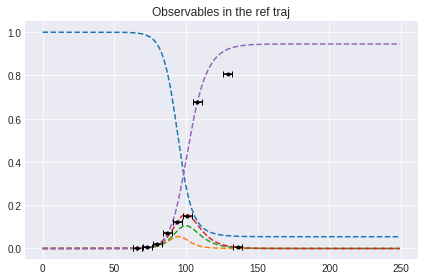

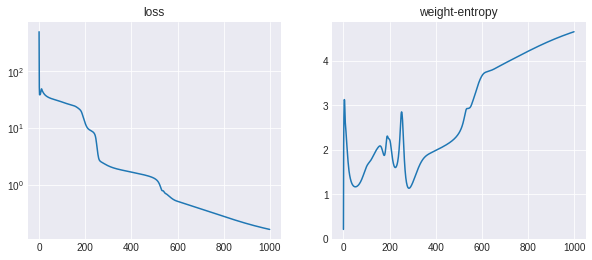

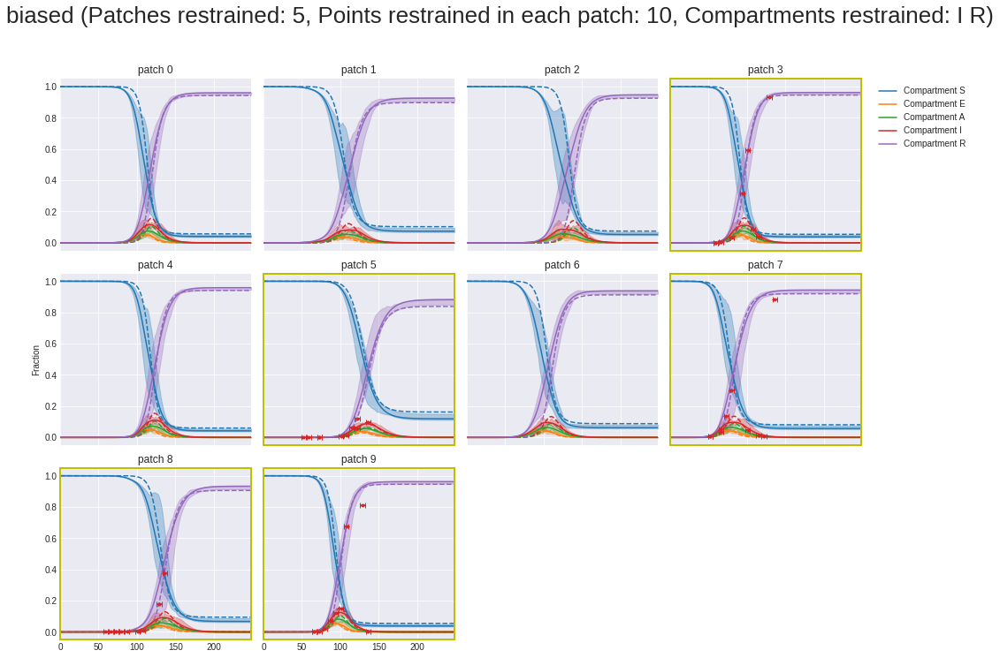

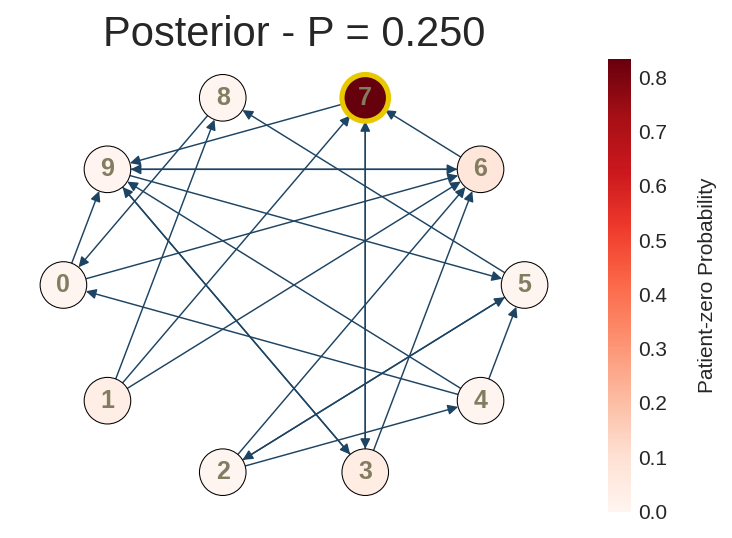

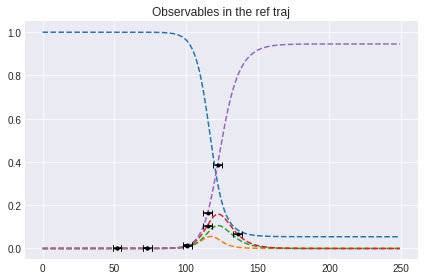

...

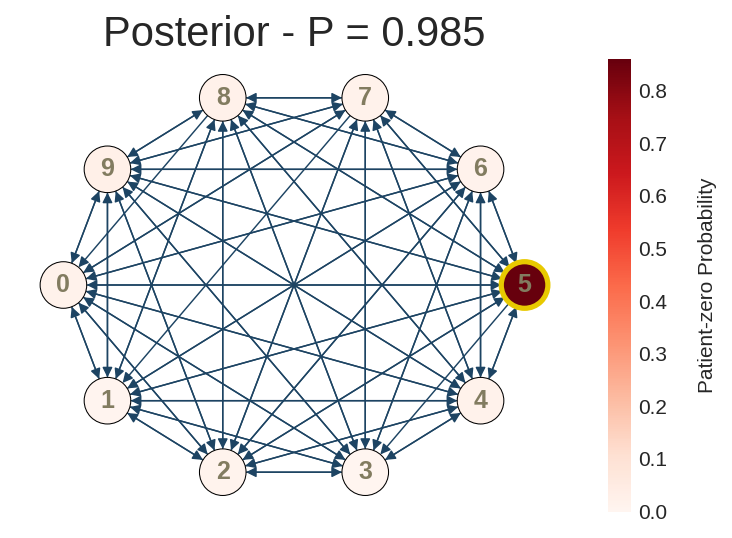

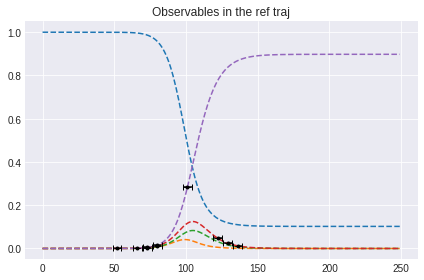

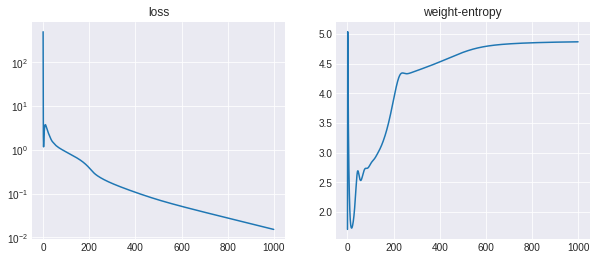

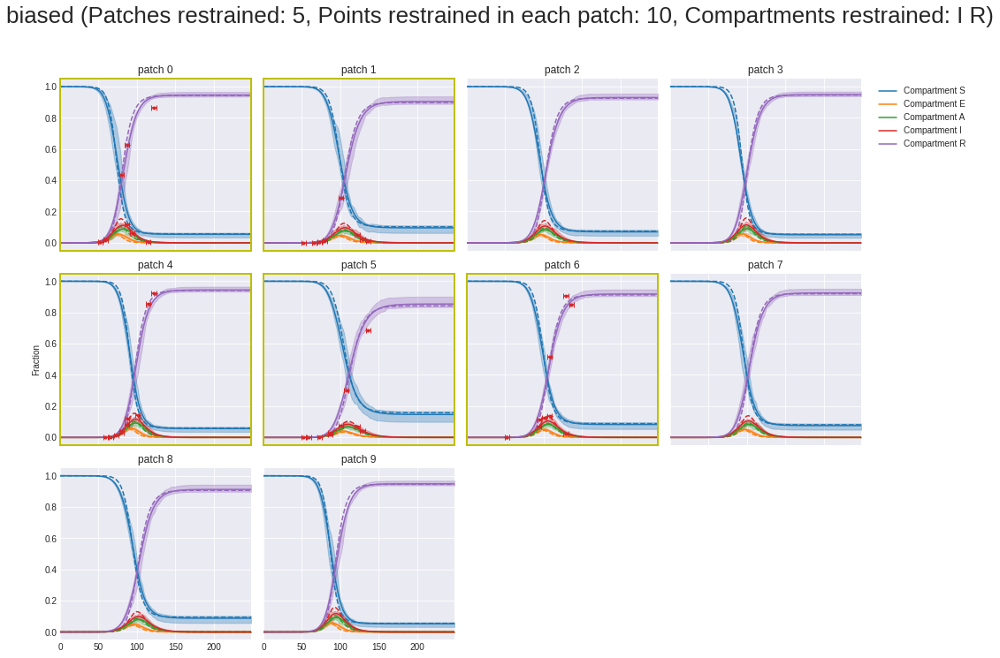

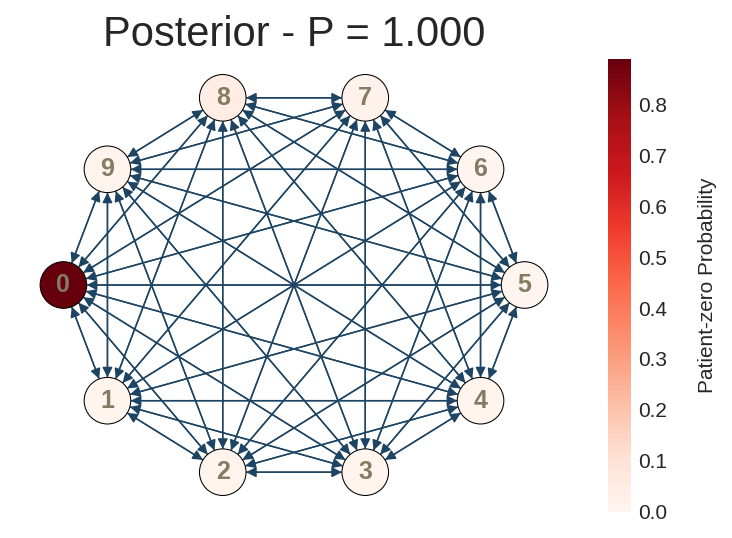

In [36]:
connecting_probability = np.linspace(0.25,1,50)
loss=[]
for i,p in enumerate(connecting_probability):
    M=10
    true_node = np.random.randint(M)
    graph = maxentep.gen_random_graph(M,p)
    ref_traj = gen_ref_traj(graph, timesteps=250, population=population,
                              area=area, true_node=true_node)
    trajs = gen_samples(graph, timesteps =250, area = area, populations = population)
    npoints = 5
    number_of_restrained_patches = 5
    restrained_compartments = [3,4] #(infected patch and recovered)
    number_of_restrained_compartments = len(restrained_compartments) 
    restrained_compartments_names = [full_compartments[m] for m in restrained_compartments]
    restrained_compartments_names = " ".join(restrained_compartments_names)
#     plt.figure()
    restraints, plot_fxns_list, restrained_patches = gen_restraints(ref_traj, prior=True, start=50, end=140)
    prior_exposed_patch = maxentep.exposed_finder(trajs)
    me_model = maxent_fit(trajs, restraints)
    weights_dict = {'unbiased':None, 'biased':me_model.traj_weights}
    me_w = me_model.traj_weights
    exposed_prob = maxentep.weighted_exposed_prob_finder(
                                prior_exposed_patch, M)
    weighted_exposed_prob = maxentep.weighted_exposed_prob_finder(
                                prior_exposed_patch, M, weights=me_w)
    traj_loss = maxentep.traj_loss(ref_traj, trajs, me_w)
    p0_loss = maxentep.p0_loss(trajs,me_w, true_node)
    compare_patches(ref_traj, trajs, weights_dict,'biased', restrained_patches, plot_fxns_list,
                patch_names = patches, figsize=(15, 10), alpha=0.3, names=full_compartments)
    fig, ax = plt.subplots()
    maxentep.draw_graph(graph, weights=weighted_exposed_prob, title=f'Posterior - P = {p:.3f}', heatmap=True, true_origin=true_node)
    print(f'P0 cross-entropy : {p0_loss:.3f}, Traj KL : {traj_loss:.3f}')
    print(f'Iteration: {i}, p: {p}, True_node: {true_node}'
          '\nTop 5 posterior probabilities for P0: \n', sorted(zip(weighted_exposed_prob, patches), reverse=True)[:5])
    p0_prediction = sorted(zip(weighted_exposed_prob, patches), reverse=True)[:1][0]
    if p0_prediction[1] == f'patch {true_node}':
        prediction = True
    else:
        prediction = False
    loss.append([traj_loss, p0_loss, p0_prediction[0], prediction])

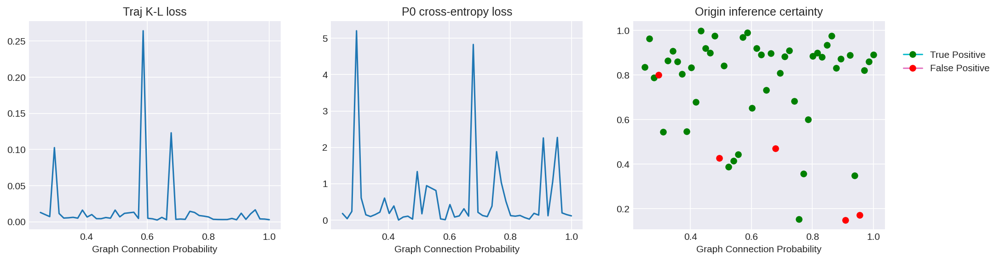

In [37]:
marker_colors = []
for i in range(len(connecting_probability)):
    if np.array(loss)[:,3][i]:
        marker_colors.append('g')
    else:
        marker_colors.append('r')
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,4), dpi=150)
ax[0].plot(connecting_probability,np.array(loss)[:,0])
ax[0].set_xlabel('Graph Connection Probability')
ax[0].set_title('Traj K-L loss')
ax[1].set_xlabel('Graph Connection Probability')
ax[1].set_title('P0 cross-entropy loss')
ax[1].plot(connecting_probability,np.array(loss)[:,1])
ax[2].set_xlabel('Graph Connection Probability')
ax[2].set_title('Origin inference certainty')
for i, mc in enumerate(marker_colors):
    ax[2].plot(connecting_probability[i], np.array(loss)[:,2][i], marker='o', markerfacecolor=mc,
               markeredgecolor=mc, label=f'{ bool(np.array(loss)[:,3][i])} Positive')
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
ax[2].legend(by_label.values(), by_label.keys(),bbox_to_anchor=(0.95, 0.4, 0.5, 0.5))